# Projet n°7 : Implémenter_un_modele_de_scoring

### Exploratory Data Analysis ... (EDA)

- Dans cette partie du projet, on réalisera l'analyse exploratoire des données qui consiste à examiner, résumer et visualiser un jeu de données avant d'appliquer des modèles de machine learning. 
    - Cela permet de comprendre la structure des données (types de variables, distributions, valeurs manquantes, etc.)
    - Identifier les tendances, anomalies et corrélations entre les variables,
    - Détecter les valeurs aberrantes (outliers) et vérifier la qualité des données avant le prétraitement.
- On prendra comme conseillé un ou plusieurs kernels Kaggle pour faciliter cette analyse exploratoire, la préparation des données et enfin le feature engineering nécessaire à l'élaboration du modèle de scoring.

In [1]:
# Import des librairies nécessaires au projet. 

import numpy as np
import pandas as pd 
import missingno as msno
import re
import os
import kaleido
import plotly

from scipy.stats import chi2_contingency

import matplotlib.pyplot as plt
import seaborn as sns
import networkx as nx
import plotly.express as px
import plotly.graph_objects as go
import plotly.io as pio

pio.renderers.default = 'png' #plotly_mimetype vscode


In [2]:
#pio.renderers.default = 'svg'

In [3]:
print(pio.renderers)

Renderers configuration
-----------------------
    Default renderer: 'png'
    Available renderers:
        ['plotly_mimetype', 'jupyterlab', 'nteract', 'vscode',
         'notebook', 'notebook_connected', 'kaggle', 'azure', 'colab',
         'cocalc', 'databricks', 'json', 'png', 'jpeg', 'jpg', 'svg',
         'pdf', 'browser', 'firefox', 'chrome', 'chromium', 'iframe',
         'iframe_connected', 'sphinx_gallery', 'sphinx_gallery_png']



In [4]:
# Liste des fichiers du projet.

print(os.listdir("../Implementer_un_modele_de_scoring/Donnee_kaggle"))

['application_test.csv', 'application_train.csv', 'bureau.csv', 'bureau_balance.csv', 'credit_card_balance.csv', 'home-credit-default-risk.zip', 'HomeCredit_columns_description.csv', 'installments_payments.csv', 'POS_CASH_balance.csv', 'previous_application.csv', 'sample_submission.csv']


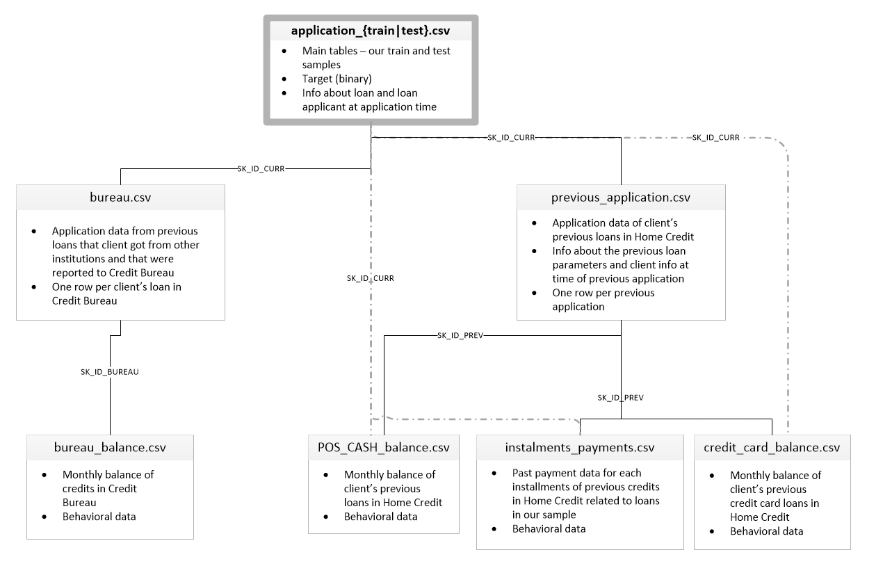

- Cette image que l'on peut retrouver dans le kernel le mieux noté du concours Kaggle, permet de visualiser les liens entre les différents fichiers du projet.
- Cela nous permet d'avoir une meilleur compréhension des données et de leur utilité les unes par rapport aux autres. De plus parmis les données disponibles, on a un fichier qui donne une description de chaque variable pour l'ensemble des fichiers ci-dessus.

#### Dataframe "HomeCredit_columns_description"

In [5]:
# Importation des descriptions liées aux différents fichiers du projet.

df_description = pd.read_csv(r"C:\Users\Caomghin\Desktop\Implementer_un_modele_de_scoring\Donnee_kaggle\HomeCredit_columns_description.csv", encoding="utf-8", encoding_errors="replace")

In [6]:
# Forme du dataframe "description".

df_description.shape

(219, 5)

In [7]:
# Visualisation du dataframe contenant les descriptions.

df_description = df_description.iloc[:, 1:]
df_description

,Table,Row,Description,Special
0,application_{train|test}.csv,SK_ID_CURR,ID of loan in our sample,NaN
1,application_{train|test}.csv,TARGET,Target variable (1 - client with payment diffi...,NaN
2,application_{train|test}.csv,NAME_CONTRACT_TYPE,Identification if loan is cash or revolving,NaN
3,application_{train|test}.csv,CODE_GENDER,Gender of the client,NaN
4,application_{train|test}.csv,FLAG_OWN_CAR,Flag if the client owns a car,NaN
...,...,...,...,...
214,installments_payments.csv,NUM_INSTALMENT_NUMBER,On which installment we observe payment,NaN
215,installments_payments.csv,DAYS_INSTALMENT,When the installment of previous credit was su...,time only relative to the application
216,installments_payments.csv,DAYS_ENTRY_PAYMENT,When was the installments of previous credit p...,time only relative to the application
217,installments_payments.csv,AMT_INSTALMENT,What was the prescribed installment amount of ...,NaN


In [8]:
# On visualise le type de chaque variable et la présence potentielle de valeurs nulles.

df_description.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 219 entries, 0 to 218
Data columns (total 4 columns):
 #   Column       Non-Null Count  Dtype 
---  ------       --------------  ----- 
 0   Table        219 non-null    object
 1   Row          219 non-null    object
 2   Description  219 non-null    object
 3   Special      86 non-null     object
dtypes: object(4)
memory usage: 7.0+ KB


- Dans ce fichier, on trouve une variable par ligne avec sa description et des infos supplémentaire dans *"Special"* lorsque cela est spécifié.
- Seule cette dernière variable comportent des valeurs nulles puisque cela apporte des informations complémentaires si besoin. On pourra donc uiliser ce fichier pour déterminer rapidement les variables intéressantes.

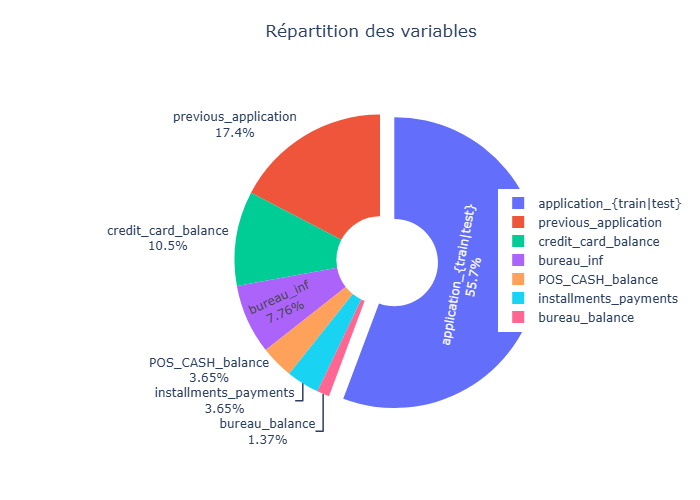

In [9]:
# Répartition des variables pour l'ensemble des fichiers.

fig = go.Figure(data=[go.Pie(
    labels=["application_{train|test}", "previous_application", "credit_card_balance", "bureau_inf", "POS_CASH_balance", "installments_payments", "bureau_balance"], 
    values=df_description.Table.value_counts(),
    hole=0.3,
    textinfo="label+percent",
    pull=[0.1, 0, 0, 0, 0, 0, 0]
)])

# Titre et affichage
fig.update_layout(
    title={
        'text': "Répartition des variables",
        'y': 0.95,  # Position verticale (1 = tout en haut)
        'x': 0.53,   # Centrer le titre
        'xanchor': 'center',
        'yanchor': 'top'
    },
    legend={
        'x': 0.8,  # Ajuste la position de la légende plus proche
        'y': 0.5,
        'xanchor': 'left'
    }
)
fig.show()

- Comme on peut le voir ce sont les fichiers **"application_train"** et **"application_test"** qui contiennent la majorité des informations sur les clients ayant souscris à un ou plusieurs crédits chez "Prêt à dépenser". Ce sont les principales informations qui constituent la base pour notre outil de scoring de crédit qui pourra calculer la probabilité qu'un futur client rembourse sont crédit et classer sa demande en crédit accordé ou refusé.
- On commence donc notre analyse avec le fichier **"application_train"** dans lequel une ligne représente un prêt:

#### Dataframe "Application_train/test"

In [10]:
# Importation du fichier principal "application_train".

df_appli_train = pd.read_csv(r"C:\Users\Caomghin\Desktop\Implementer_un_modele_de_scoring\Donnee_kaggle\application_train.csv")
df_appli_test = pd.read_csv(r"C:\Users\Caomghin\Desktop\Implementer_un_modele_de_scoring\Donnee_kaggle\application_test.csv")

In [11]:
df_appli_train.shape

(307511, 122)

In [12]:
# Visualisation du dataframe. 

df_appli_train

,SK_ID_CURR,TARGET,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,...,FLAG_DOCUMENT_18,FLAG_DOCUMENT_19,FLAG_DOCUMENT_20,FLAG_DOCUMENT_21,AMT_REQ_CREDIT_BUREAU_HOUR,AMT_REQ_CREDIT_BUREAU_DAY,AMT_REQ_CREDIT_BUREAU_WEEK,AMT_REQ_CREDIT_BUREAU_MON,AMT_REQ_CREDIT_BUREAU_QRT,AMT_REQ_CREDIT_BUREAU_YEAR
0,100002,1,Cash loans,M,N,Y,0,202500.0,406597.5,24700.5,...,0,0,0,0,0.0,0.0,0.0,0.0,0.0,1.0
1,100003,0,Cash loans,F,N,N,0,270000.0,1293502.5,35698.5,...,0,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0
2,100004,0,Revolving loans,M,Y,Y,0,67500.0,135000.0,6750.0,...,0,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0
3,100006,0,Cash loans,F,N,Y,0,135000.0,312682.5,29686.5,...,0,0,0,0,NaN,NaN,NaN,NaN,NaN,NaN
4,100007,0,Cash loans,M,N,Y,0,121500.0,513000.0,21865.5,...,0,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
307506,456251,0,Cash loans,M,N,N,0,157500.0,254700.0,27558.0,...,0,0,0,0,NaN,NaN,NaN,NaN,NaN,NaN
307507,456252,0,Cash loans,F,N,Y,0,72000.0,269550.0,12001.5,...,0,0,0,0,NaN,NaN,NaN,NaN,NaN,NaN
307508,456253,0,Cash loans,F,N,Y,0,153000.0,677664.0,29979.0,...,0,0,0,0,1.0,0.0,0.0,1.0,0.0,1.0
307509,456254,1,Cash loans,F,N,Y,0,171000.0,370107.0,20205.0,...,0,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0


In [13]:
# Recherche de doublons pour la variable ID "SK_ID_CURR"

df_appli_train['SK_ID_CURR'].duplicated().any()

False

In [14]:
# Nombre de ID unique pour cette variable.

df_appli_train['SK_ID_CURR'].nunique()

307511

In [15]:
# On visualise le type de chaque variable et la présence potentielle de valeurs nulles.

df_appli_train.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 307511 entries, 0 to 307510
Columns: 122 entries, SK_ID_CURR to AMT_REQ_CREDIT_BUREAU_YEAR
dtypes: float64(65), int64(41), object(16)
memory usage: 286.2+ MB


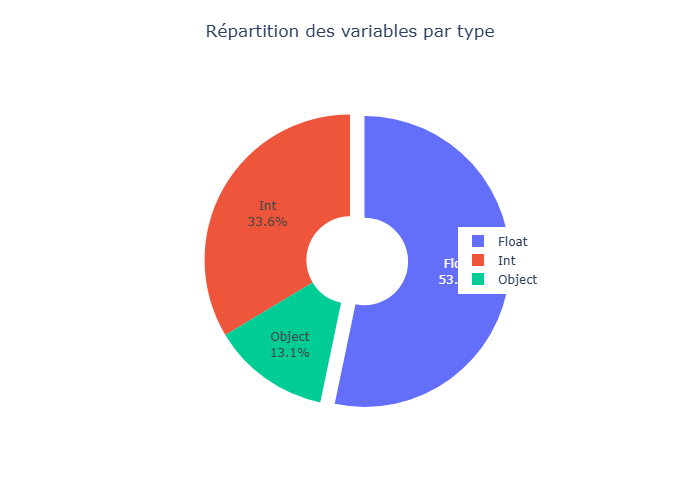

In [16]:
# Représentation graphique des types de variables.

fig = go.Figure(data=[go.Pie(
    labels=["Float", "Int", "Object"], 
    values=df_appli_train.dtypes.value_counts(),
    hole=0.3,
    textinfo="label+percent",
    pull=[0.1, 0, 0]
)])

# Titre et affichage
fig.update_layout(
    title={
        'text': "Répartition des variables par type",
        'y': 0.95,  # Position verticale (1 = tout en haut)
        'x': 0.50,   # Centrer le titre
        'xanchor': 'center',
        'yanchor': 'top'
    },
    legend={
        'x': 0.7,  # Ajuste la position de la légende plus proche
        'y': 0.5,
        'xanchor': 'left'
    }
)
fig.show()

- Comme on peut le voir, près de 90 % des variables sont numériques ce qui est bien puisque les modèles utilisent des entrées numériques pour fonctionner. Il faut donc transformer les variables qualitatives pour pouvoir s'en servir dans notre modèle.
- On doit ensuite vérifier si il y a beaucoup de valeurs nulles présentes dans le fichier.

In [17]:
# Mise en place d'une fonction permettant de calculer le pourcentage de valeurs manquantes pour un dataframe.

def calculate_missing_values(dataframe):
   """
   Calcule le nombre et le pourcentage de valeurs manquantes pour chaque colonne d'un DataFrame.

   Paramètres : dataframe (Le DataFrame à analyser).
   Retourne : Un DataFrame contenant le nombre et le pourcentage de valeurs manquantes par colonne.
   """
   missing_values = pd.DataFrame(columns=['Nbr_valeurs_manquantes', 'Pct_valeurs_manquantes'])
   missing_values['Nbr_valeurs_manquantes'] = dataframe.isnull().sum()
   missing_values['Pct_valeurs_manquantes'] = dataframe.isna().mean() * 100
   
   # Trier les valeurs manquantes par ordre décroissant
   missing_values = missing_values[missing_values['Nbr_valeurs_manquantes'] > 0]
   missing_values = missing_values.sort_values(by='Nbr_valeurs_manquantes', ascending=False)
   missing_values = missing_values.style.background_gradient(subset=['Pct_valeurs_manquantes'],cmap='viridis_r',vmin=0, vmax=1)

   return missing_values


In [18]:
# Calcul du pourcentage de valeurs nulles par variable pour "application_train/test". 
pd.set_option('display.max_rows', None)
calculate_missing_values(df_appli_train)

,Nbr_valeurs_manquantes,Pct_valeurs_manquantes
COMMONAREA_MEDI,214865,69.872297
COMMONAREA_AVG,214865,69.872297
COMMONAREA_MODE,214865,69.872297
NONLIVINGAPARTMENTS_MEDI,213514,69.432963
NONLIVINGAPARTMENTS_MODE,213514,69.432963
NONLIVINGAPARTMENTS_AVG,213514,69.432963
FONDKAPREMONT_MODE,210295,68.386172
LIVINGAPARTMENTS_MODE,210199,68.354953
LIVINGAPARTMENTS_MEDI,210199,68.354953
LIVINGAPARTMENTS_AVG,210199,68.354953


In [19]:
pd.reset_option('display.max_rows')

Text(0, 0.5, 'Loans')

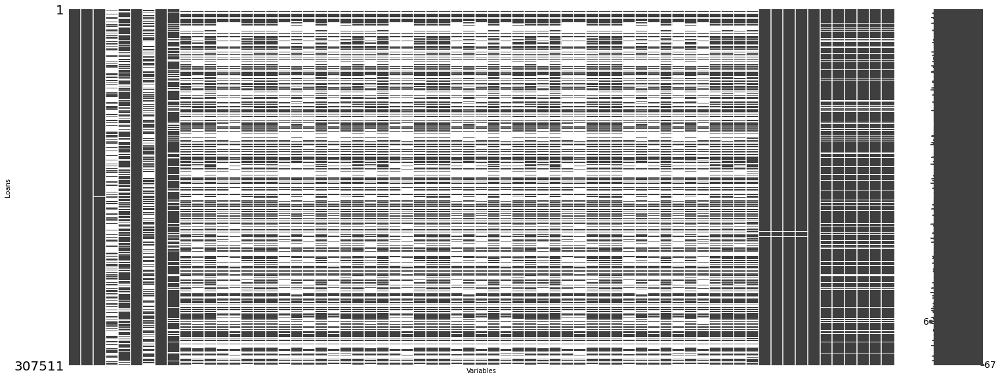

In [20]:
# Utilisation d'un graphique pour avoir une représentation visuelle des valeurs manquantes.

msno.matrix(df_appli_train.loc[:, df_appli_train.isnull().any(axis=0)])

plt.xlabel("Variables")
plt.ylabel("Loans")

- La plupart des variables avec un grand nombre de valeurs manquantes (50% ou +) concernent des informations liées aux habitations des clients (type de bâtiments, année de construction, nbr d'étages etc..).
- En temps normal, pour ces variables au pourcentage elevé on pourrait décider de les supprimer mais il faut voir dans un premier temps si elles ont un impact important par rapport à la variable cible. On choisira donc après analyse de la suppression ou de l'imputation si besoin.
- On peut d'ailleurs s'intéresser aux informations globalement apportées par le fichier.

In [21]:
# Liste des descriptions pour le fichier "application_train/test".

df_description.loc[df_description["Table"] == 'application_{train|test}.csv', "Description"].tolist()

['ID of loan in our sample',
 'Target variable (1 - client with payment difficulties: he/she had late payment more than X days on at least one of the first Y installments of the loan in our sample, 0 - all other cases)',
 'Identification if loan is cash or revolving',
 'Gender of the client',
 'Flag if the client owns a car',
 'Flag if client owns a house or flat',
 'Number of children the client has',
 'Income of the client',
 'Credit amount of the loan',
 'Loan annuity',
 'For consumer loans it is the price of the goods for which the loan is given',
 'Who was accompanying client when he was applying for the loan',
 'Clients income type (businessman, working, maternity leave,�)',
 'Level of highest education the client achieved',
 'Family status of the client',
 'What is the housing situation of the client (renting, living with parents, ...)',
 'Normalized population of region where client lives (higher number means the client lives in more populated region)',
 "Client's age in days a

- Avec le fichier qui partage les informations de chaque variable, on peut en ressortir les informations suivantes:

    - Les informations globales sur les clients (Genre, informations personnelles, éducation, revenus, possessions etc ..),
    - Variable cible mettant en avant les difficultés de remboursement lorsqu'il y en a (binaire avec la valeur 1 pour les défaults de paiments),
    - Des informations relatives aux crédits,
    - Des informations liées à la véracité des informations partagées par le client (documents fournis et vérifications des infos),
    - Des informations liées à la sphére social et géographique du client (lieu de vie, famille etc ..)



- Dans un premier temps, il peut être intéressant de visualiser notre variable cible afin d'avoir une première idée de la répartition des individus entre les deux situations possible (0 - aucun défaut et 1 - défaut de paiement)

In [22]:
# Répartition des clients en fonction de "Target". 

df_appli_train['TARGET'].value_counts()

0    282686
1     24825
Name: TARGET, dtype: int64

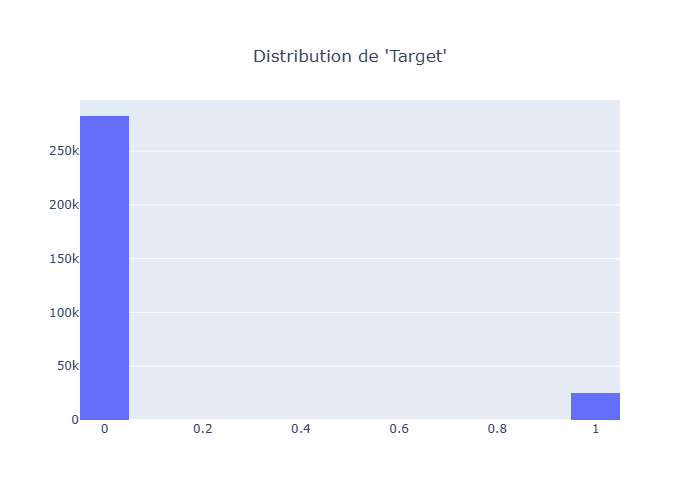

In [23]:
# Visualisation de la répartition pour la variable "Target".

fig = go.Figure(data=[go.Histogram(x=df_appli_train["TARGET"], nbinsx=20)])

fig.update_layout(
    title={
        'text': "Distribution de 'Target'",
        'x': 0.5,
        'xanchor': 'center',
        'yanchor': 'top'
    },
    width=700 
)

fig.show()

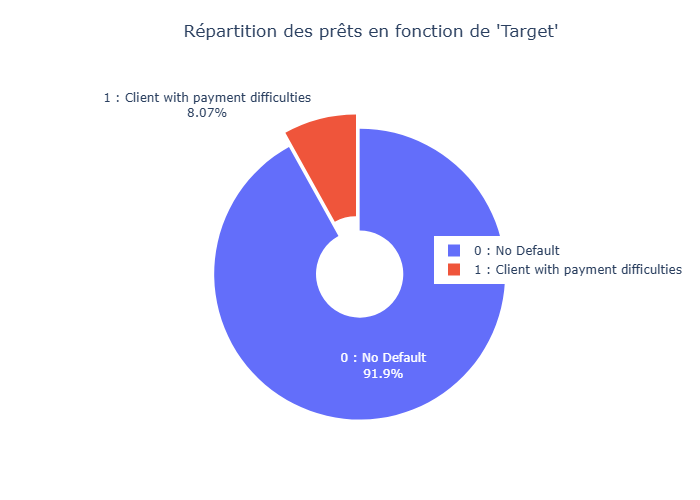

In [24]:
# Répartition en pourcentage de la variable "Target".

fig = go.Figure(data=[go.Pie(
    labels=["0 : No Default", "1 : Client with payment difficulties"], 
    values=df_appli_train['TARGET'].value_counts(),
    hole=0.3,
    textinfo="label+percent",
    pull=[0.1, 0, 0]
)])

# Titre et affichage
fig.update_layout(
    title={
        'text': "Répartition des prêts en fonction de 'Target'",
        'y': 0.95,  # Position verticale (1 = tout en haut)
        'x': 0.53,   # Centrer le titre
        'xanchor': 'center',
        'yanchor': 'top'
    },
    legend={
        'x': 0.7,  # Ajuste la position de la légende plus proche
        'y': 0.5,
        'xanchor': 'left'
    }
)
fig.show()

- Comme on peut le voir, la variable "Target" est très déséquilibré puisque l'on a **282 686** (**91.9%**) prêts qui ne présentent aucunes difficultés, contre **24 824** (**8.07%**) prêts qui ont rencontrés des difficultés de paiments.
- Cette information est importante puisque ce déséquilibre des données est à prendre en compte dans la classification des demandes de crédits. En effet, les données déséquilibrés peuvent fortement influencer les résultats de certains algorithmes indépendamment des informations apportées.
- De plus, pour ce qui est des mesures de performances on ne pourra pas utiliser comme principale métrique la précision, car les résultats seront biaisés par la classe majoritaire (0 - pas de défaillance) et ne permettra pas de répondre à la problèmatique métier qui est de mettre en evidence les prêts qui ont une grande chance d'être défaillant. Pour palier à cela, on peut utiliser par exemple le ROC AUC qui mesure la capacité du modèle à bien classer les cas positifs et négatifs indépendamment du seuil de classification. Il prend en compte à la fois le taux de vrais positifs (Recall) et le taux de faux positifs, ce qui est crucial pour un problème où les faux négatifs (ne pas détecter un prêt risqué) sont coûteux. Cela donne une vision plus complète de la performance du modèle, même lorsque la classe minoritaire est sous-représentée.
- On peut ensuite s'intéresser dans un premier temps aux variables qualitatives :

In [25]:
# Focus sur les variables qualitatives.

df_appli_train.loc[:, df_appli_train.dtypes == 'object']

,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,NAME_TYPE_SUITE,NAME_INCOME_TYPE,NAME_EDUCATION_TYPE,NAME_FAMILY_STATUS,NAME_HOUSING_TYPE,OCCUPATION_TYPE,WEEKDAY_APPR_PROCESS_START,ORGANIZATION_TYPE,FONDKAPREMONT_MODE,HOUSETYPE_MODE,WALLSMATERIAL_MODE,EMERGENCYSTATE_MODE
0,Cash loans,M,N,Y,Unaccompanied,Working,Secondary / secondary special,Single / not married,House / apartment,Laborers,WEDNESDAY,Business Entity Type 3,reg oper account,block of flats,"Stone, brick",No
1,Cash loans,F,N,N,Family,State servant,Higher education,Married,House / apartment,Core staff,MONDAY,School,reg oper account,block of flats,Block,No
2,Revolving loans,M,Y,Y,Unaccompanied,Working,Secondary / secondary special,Single / not married,House / apartment,Laborers,MONDAY,Government,NaN,NaN,NaN,NaN
3,Cash loans,F,N,Y,Unaccompanied,Working,Secondary / secondary special,Civil marriage,House / apartment,Laborers,WEDNESDAY,Business Entity Type 3,NaN,NaN,NaN,NaN
4,Cash loans,M,N,Y,Unaccompanied,Working,Secondary / secondary special,Single / not married,House / apartment,Core staff,THURSDAY,Religion,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
307506,Cash loans,M,N,N,Unaccompanied,Working,Secondary / secondary special,Separated,With parents,Sales staff,THURSDAY,Services,reg oper account,block of flats,"Stone, brick",No
307507,Cash loans,F,N,Y,Unaccompanied,Pensioner,Secondary / secondary special,Widow,House / apartment,NaN,MONDAY,XNA,reg oper account,block of flats,"Stone, brick",No
307508,Cash loans,F,N,Y,Unaccompanied,Working,Higher education,Separated,House / apartment,Managers,THURSDAY,School,reg oper account,block of flats,Panel,No
307509,Cash loans,F,N,Y,Unaccompanied,Commercial associate,Secondary / secondary special,Married,House / apartment,Laborers,WEDNESDAY,Business Entity Type 1,NaN,block of flats,"Stone, brick",No


- Donne un bon nombre d'informations personnelles sur les clients qui ont souscris des prêts.

In [26]:
df_appli_train.select_dtypes(include=['object']).nunique()

NAME_CONTRACT_TYPE             2
CODE_GENDER                    3
FLAG_OWN_CAR                   2
FLAG_OWN_REALTY                2
NAME_TYPE_SUITE                7
NAME_INCOME_TYPE               8
NAME_EDUCATION_TYPE            5
NAME_FAMILY_STATUS             6
NAME_HOUSING_TYPE              6
OCCUPATION_TYPE               18
WEEKDAY_APPR_PROCESS_START     7
ORGANIZATION_TYPE             58
FONDKAPREMONT_MODE             4
HOUSETYPE_MODE                 3
WALLSMATERIAL_MODE             7
EMERGENCYSTATE_MODE            2
dtype: int64

- On a ici un aperçu des valeurs uniques pour les variables qualitatives et comme on peut le voir, on peut transformer assez facilement en variable quantitative la plupart des variables sauf pour les variables *"OCCUPATION_TYPE"* et *"ORGANIZATION_TYPE"* qui se démarquent par un nombre de valeurs uniques assez important.

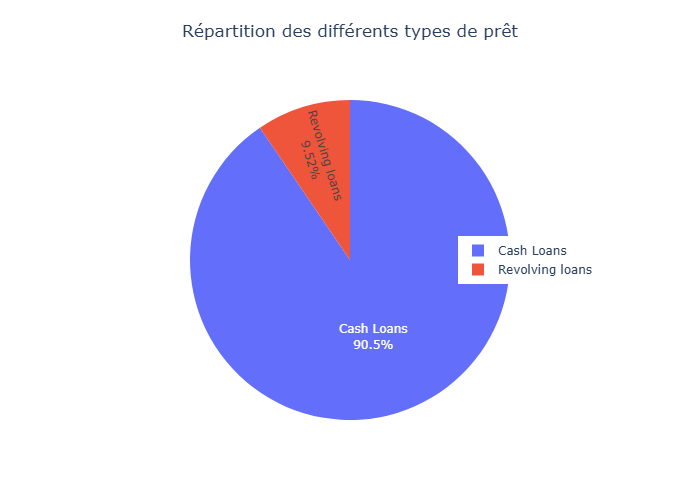

In [27]:
# Visualisation de la répartiton des types de prêt.

fig = go.Figure(data=[go.Pie(
    labels=["Cash Loans", "Revolving loans"], 
    values=df_appli_train['NAME_CONTRACT_TYPE'].value_counts(),
    textinfo="label+percent"
)])

# Titre et affichage
fig.update_layout(
    title={
        'text': "Répartition des différents types de prêt",
        'y': 0.95,  # Position verticale (1 = tout en haut)
        'x': 0.50,   # Centrer le titre
        'xanchor': 'center',
        'yanchor': 'top'
    },
    legend={
        'x': 0.7,  # Ajuste la position de la légende plus proche
        'y': 0.5,
        'xanchor': 'left'
    }
)
fig.show()

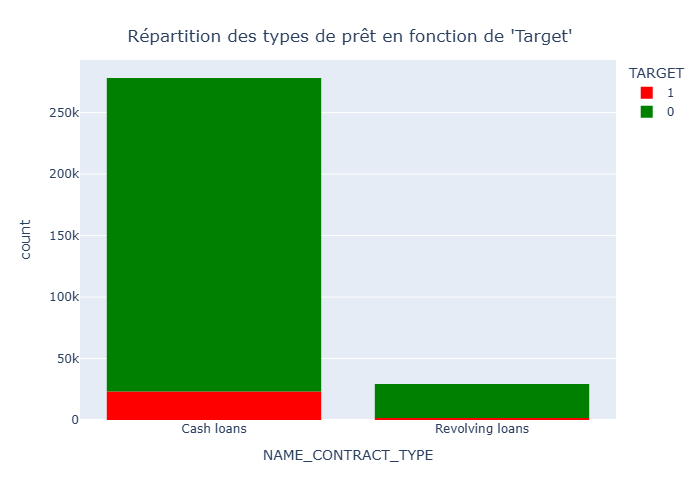

In [28]:
# Visualisation de la répartiton des types de prêt en fonction de la Target.

fig = px.histogram(
    df_appli_train,
    x="NAME_CONTRACT_TYPE",
    color="TARGET",
    color_discrete_map={0: 'green', 1: 'red'}
)

fig.update_layout(
    title={
        'text': "Répartition des types de prêt en fonction de 'Target'",
        'x': 0.5,
        'xanchor': 'center',
        'yanchor': 'top'
    },
    width=700 
)

fig.show()

- La grande majorité des prêts sont des "cash loans" (prêts en espece) pour **90 %** (278K) des prêts totaux contre **10 %** (29K) de prêts de "Revolving loans" (prêts renouvelables).
- Dans le deuxième graphique on met en évidence la variable "Target" avec laquelle, on a environ **8 %** de prêts qui présentent un défaut pour les "cash loans" et **5,5 %** de prêts en défaut pour les "revolving loans".

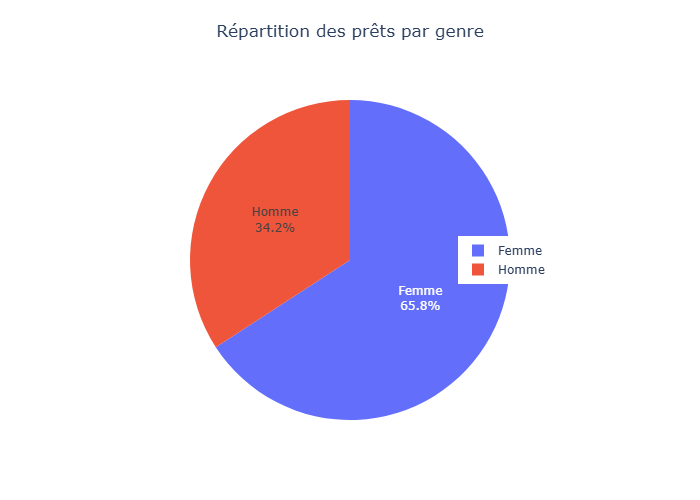

In [29]:
# Visualisation de la répartition pour la variable "CODE_GENDER".

fig = go.Figure(data=[go.Pie(
    labels=["Femme", "Homme"], 
    values=df_appli_train['CODE_GENDER'].value_counts(),
    textinfo="label+percent"
)])

# Titre et affichage
fig.update_layout(
    title={
        'text': "Répartition des prêts par genre",
        'y': 0.95,  # Position verticale (1 = tout en haut)
        'x': 0.50,   # Centrer le titre
        'xanchor': 'center',
        'yanchor': 'top'
    },
    legend={
        'x': 0.7,  # Ajuste la position de la légende plus proche
        'y': 0.5,
        'xanchor': 'left'
    }
)
fig.show()

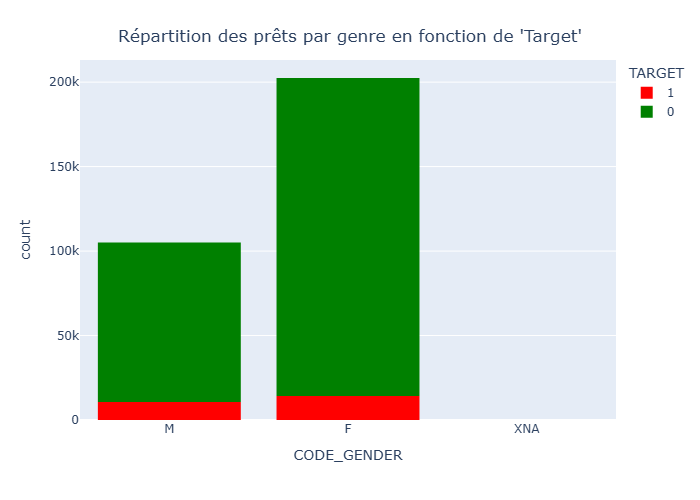

In [30]:
# Visualisation de la répartition pour la variable "CODE_GENDER" en fonction de la Target.

fig = px.histogram(
    df_appli_train,
    x="CODE_GENDER",
    color="TARGET",
    color_discrete_map={0: 'green', 1: 'red'}
)

fig.update_layout(
    title={
        'text': "Répartition des prêts par genre en fonction de 'Target'",
        'x': 0.5,
        'xanchor': 'center',
        'yanchor': 'top'
    },
    width=700 
)

fig.show()

- On a ici la répartition par genre des prêts de la base de données avec 2/3 de femmes et 1/3 d'hommes.
- En prenant en compte la variable "Target", il est intéressant de noter que les hommes ont tendance à avoir plus de difficulté à rembourser leurs prêts que les femmes. En effet, on a **10 %** *(**10 655** prêts)* de défaut chez les hommes contre **7 %** *(**14 170** de prêts)* chez les femmes alors qu'elles sont 2 fois plus nombreuses que les hommes.
- Il y a aussi quelques valeurs XNA qui ne renseignent pas le genre et dont on ne pourra pas réellement utilisées ici, de plus ce sont des clients non défaillants donc il pourrait possible de ne pas les prendre en compte par la suite.

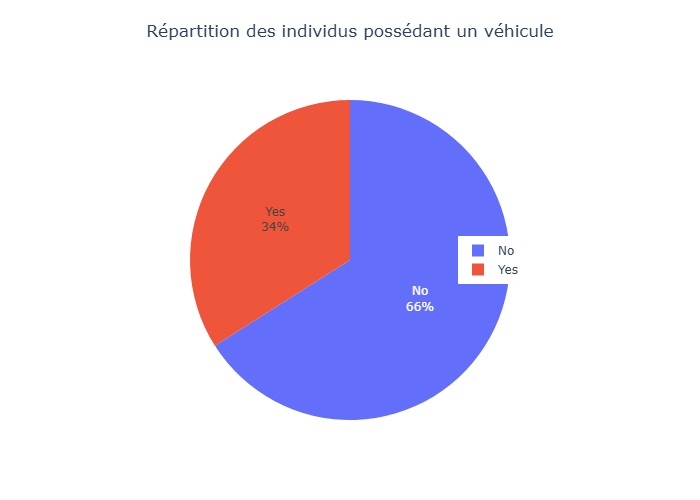

In [31]:
# Visualisation de la répartition pour la variable "FLAG_OWN_CAR".

fig = go.Figure(data=[go.Pie(
    labels=["No", "Yes"], 
    values=df_appli_train['FLAG_OWN_CAR'].value_counts(),
    textinfo="label+percent"
)])

# Titre et affichage
fig.update_layout(
    title={
        'text': "Répartition des individus possédant un véhicule",
        'y': 0.95,  # Position verticale (1 = tout en haut)
        'x': 0.50,   # Centrer le titre
        'xanchor': 'center',
        'yanchor': 'top'
    },
    legend={
        'x': 0.7,  # Ajuste la position de la légende plus proche
        'y': 0.5,
        'xanchor': 'left'
    }
)
fig.show()

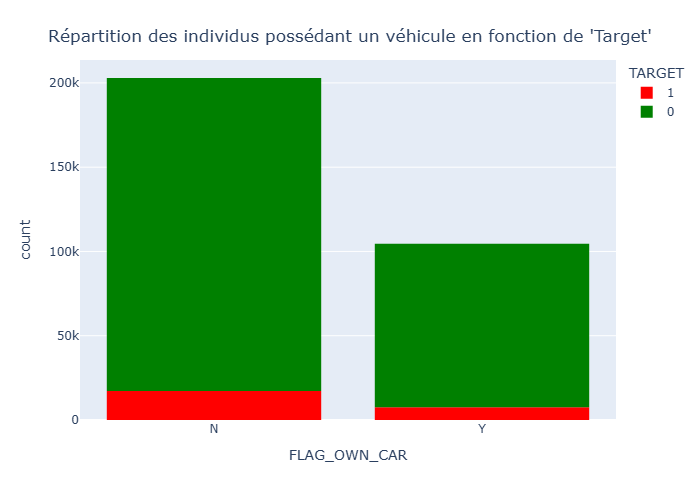

In [32]:
# Visualisation de la répartition pour la variable "FLAG_OWN_CAR" en fonction de la Target.

fig = px.histogram(
    df_appli_train,
    x="FLAG_OWN_CAR",
    color="TARGET",
    color_discrete_map={0: 'green', 1: 'red'}
)

fig.update_layout(
    title={
        'text': "Répartition des individus possédant un véhicule en fonction de 'Target'",
        'x': 0.5,
        'xanchor': 'center',
        'yanchor': 'top'
    },
    width=700 
)

fig.show()

- On a deux fois plus de personnes ne possédant pas de véhicule à la souscription d'un prêt.
- Cela ne semble pas avoir d'impact sur d'éventuels défaut de paiments (**8 %** de défaut pour ceux ne possédant pas de véhicule contre **7 %** pour ceux possédant un véhicule).

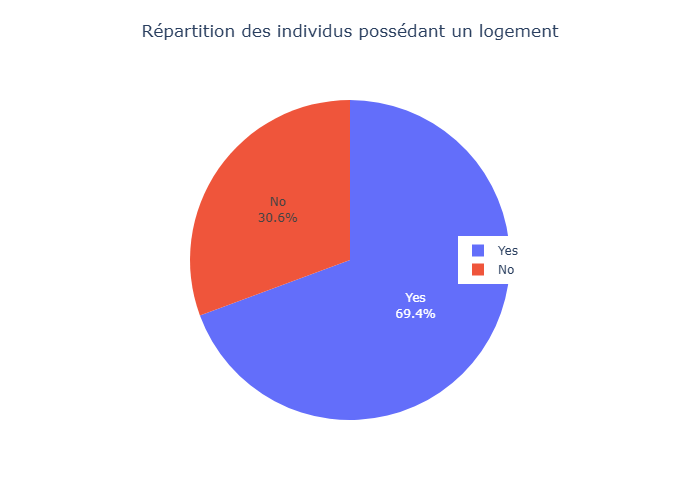

In [33]:
# Visualisation de la répartition pour la variable "FLAG_OWN_REALTY".

fig = go.Figure(data=[go.Pie(
    labels=["Yes", "No"], 
    values=df_appli_train['FLAG_OWN_REALTY'].value_counts(),
    textinfo="label+percent"
)])

# Titre et affichage
fig.update_layout(
    title={
        'text': "Répartition des individus possédant un logement",
        'y': 0.95,  # Position verticale (1 = tout en haut)
        'x': 0.50,   # Centrer le titre
        'xanchor': 'center',
        'yanchor': 'top'
    },
    legend={
        'x': 0.7,  # Ajuste la position de la légende plus proche
        'y': 0.5,
        'xanchor': 'left'
    }
)
fig.show()

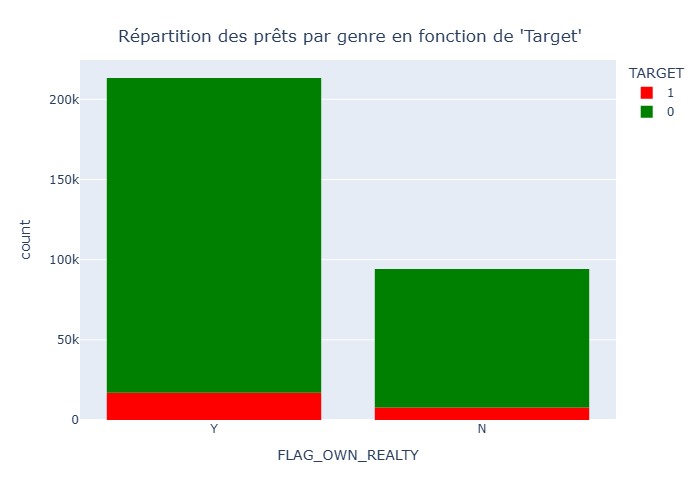

In [34]:
# Visualisation de la répartition pour la variable "FLAG_OWN_REALTY" en fonction de la Target.

fig = px.histogram(
    df_appli_train,
    x="FLAG_OWN_REALTY",
    color="TARGET",
    color_discrete_map={0: 'green', 1: 'red'}
)

fig.update_layout(
    title={
        'text': "Répartition des prêts par genre en fonction de 'Target'",
        'x': 0.5,
        'xanchor': 'center',
        'yanchor': 'top'
    },
    width=700 
)

fig.show()

- Ici on a la répartition des individus possédant un logement (maison ou appartemment) qui montre que **70 %** des souscripteurs possédent un logement.
- Comme précédemment, cela ne parait pas impacter le remboursement des prêts (environ **8 %** dans les deux cas ).

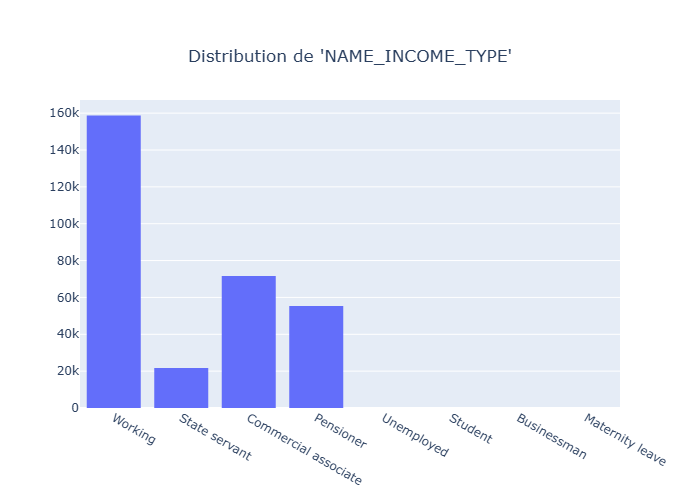

In [35]:
# Visualisation de la répartition pour la variable "NAME_INCOME_TYPE".

fig = go.Figure(data=[go.Histogram(x=df_appli_train["NAME_INCOME_TYPE"], nbinsx=20)])

fig.update_layout(
    title={
        'text': "Distribution de 'NAME_INCOME_TYPE'",
        'x': 0.5,
        'xanchor': 'center',
        'yanchor': 'top'
    },
    width=700 
)

fig.show()

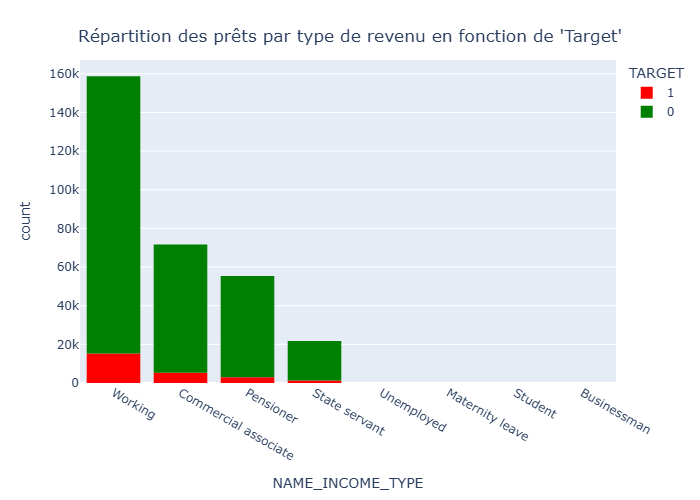

In [36]:
# Visualisation de la répartition pour la variable "NAME_INCOME_TYPE" en fonction de la Target.

fig = px.histogram(
    df_appli_train,
    x="NAME_INCOME_TYPE",
    color="TARGET",
    color_discrete_map={0: 'green', 1: 'red'}
)

fig.update_layout(
    title={
        'text': "Répartition des prêts par type de revenu en fonction de 'Target'",
        'x': 0.5,
        'xanchor': 'center',
        'yanchor': 'top'
    },
    width=700 
)

fig.show()


- La grande majorité des souscripteurs de prêts sont des travailleurs (manque de précision de la part de certains clients ?) pour plus de la moitié des clients de la base de donnée. Suivi des commerçants, de retraités et de fonctionnaires qui représentent à eux trois à peu prés la même proportion.
- Pour ce qui est des défauts de paiement, seul les personnes qui ne travaillent pas se démarquent avec plus de **30 %** de défaut, mais le manque de données sur cette catégorie de personne ne permet d'affirmer que cela à un lien avec la Target (il n'y a que **22** individus dont ***8*** en défaut.). Cas similaire pour les individus en situation de maternité.

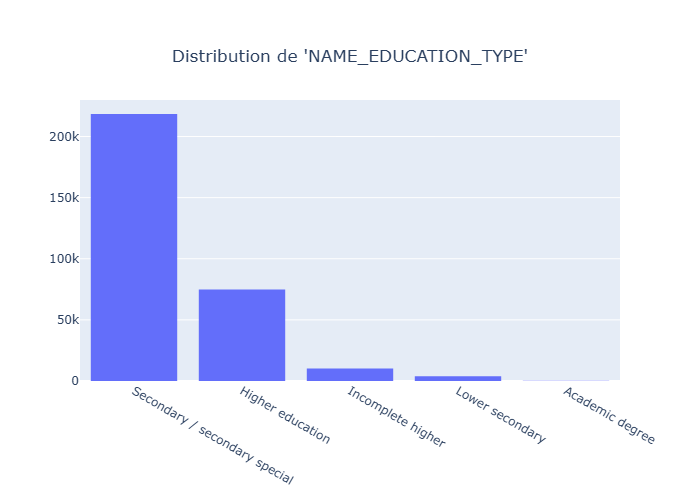

In [37]:
# Visualisation de la répartition pour la variable "NAME_EDUCATION_TYPE".

fig = go.Figure(data=[go.Histogram(x=df_appli_train["NAME_EDUCATION_TYPE"], nbinsx=20)])

fig.update_layout(
    title={
        'text': "Distribution de 'NAME_EDUCATION_TYPE'",
        'x': 0.5,
        'xanchor': 'center',
        'yanchor': 'top'
    },
    width=700 
)

fig.show()

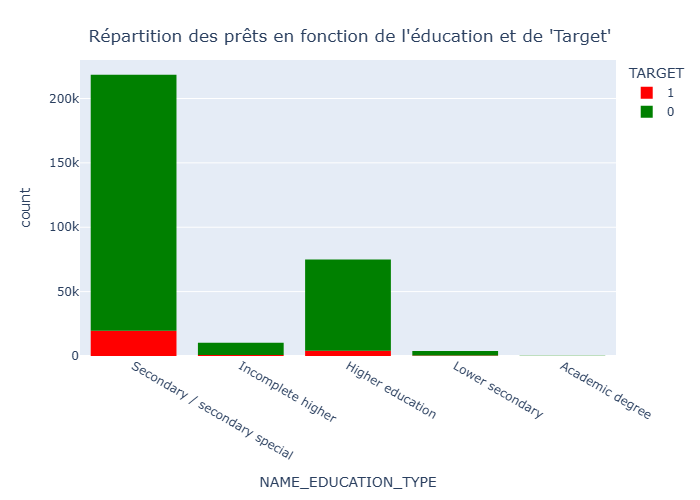

In [38]:
# Visualisation de la répartition pour la variable "NAME_EDUCATION_TYPE" en fonction de la Target.

fig = px.histogram(
    df_appli_train,
    x="NAME_EDUCATION_TYPE",
    color="TARGET",
    color_discrete_map={0: 'green', 1: 'red'}
)

fig.update_layout(
    title={
        'text': "Répartition des prêts en fonction de l'éducation et de 'Target'",
        'x': 0.5,
        'xanchor': 'center',
        'yanchor': 'top'
    },
    width=700 
)

fig.show()

- La grande majorité des souscripteurs (2/3) ont fait des études secondaires (lycée) suivi des clients ayant réalisés des études supérieurs (+ de 20 %).
- Les différentes catégories ne se démarquent pas particuliérement au niveau des défauts de paiments toutefois ceux ayant réalisé des études supérieurs ont tendance à avoir moins de problèmes à rembourser leurs emprunts.

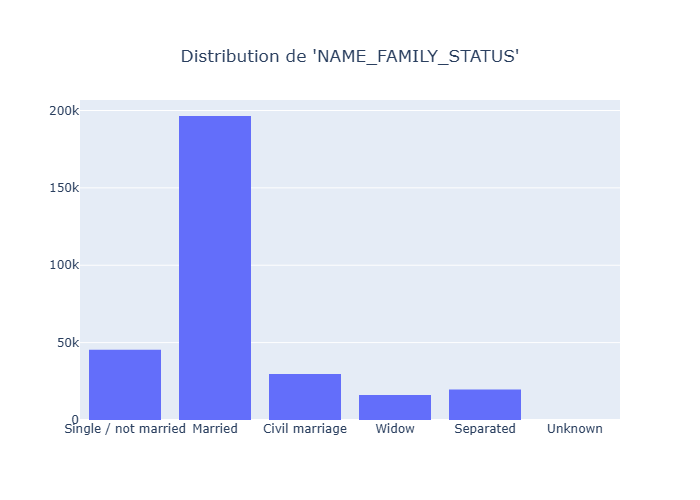

In [39]:
# Visualisation de la répartition pour la variable "NAME_FAMILY_STATUS".

fig = go.Figure(data=[go.Histogram(x=df_appli_train["NAME_FAMILY_STATUS"], nbinsx=20)])

fig.update_layout(
    title={
        'text': "Distribution de 'NAME_FAMILY_STATUS'",
        'x': 0.5,
        'xanchor': 'center',
        'yanchor': 'top'
    },
    width=700 
)

fig.show()

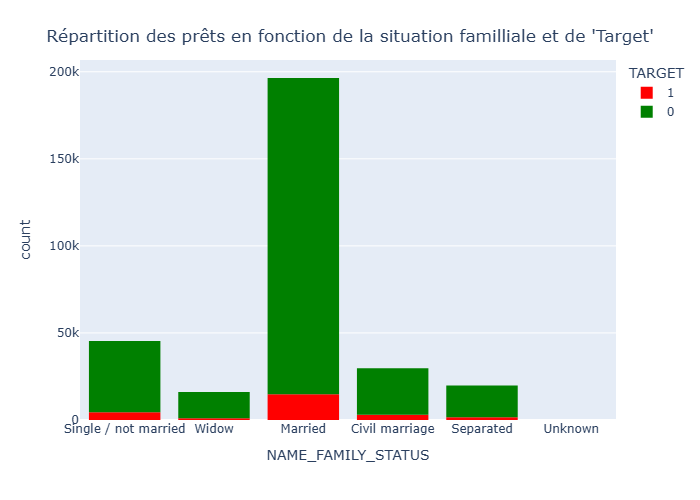

In [40]:
# Visualisation de la répartition pour la variable "NAME_FAMILY_STATUS" en fonction de la Target.

fig = px.histogram(
    df_appli_train,
    x="NAME_FAMILY_STATUS",
    color="TARGET",
    color_discrete_map={0: 'green', 1: 'red'}
)

fig.update_layout(
    title={
        'text': "Répartition des prêts en fonction de la situation familliale et de 'Target'",
        'x': 0.5,
        'xanchor': 'center',
        'yanchor': 'top'
    },
    width=700 
)

fig.show()

- La grande majorité des clients sont marriés pour les 2/3 des prêts totaux de la base de donnée.
- Peu ou pas de différence notable entre les différents groupes et le pourcentage de prêts en défaut dans ces groupes.

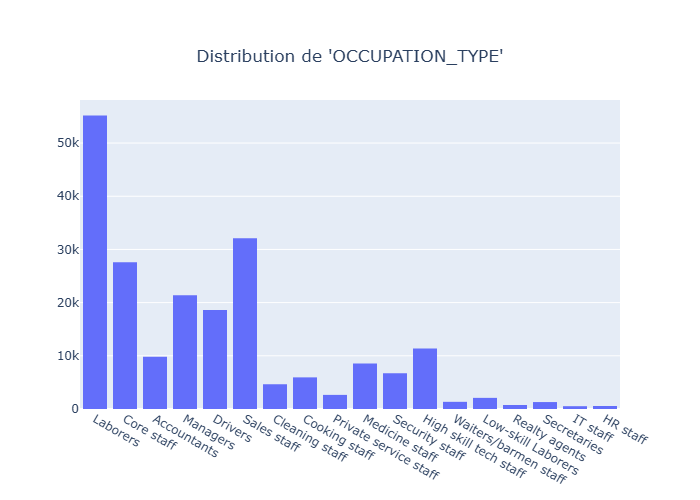

In [41]:
# Visualisation de la répartition pour la variable "OCCUPATION_TYPE".

fig = go.Figure(data=[go.Histogram(x=df_appli_train["OCCUPATION_TYPE"], nbinsx=20)])

fig.update_layout(
    title={
        'text': "Distribution de 'OCCUPATION_TYPE'",
        'x': 0.5,
        'xanchor': 'center',
        'yanchor': 'top'
    },
    width=700 
)

fig.show()

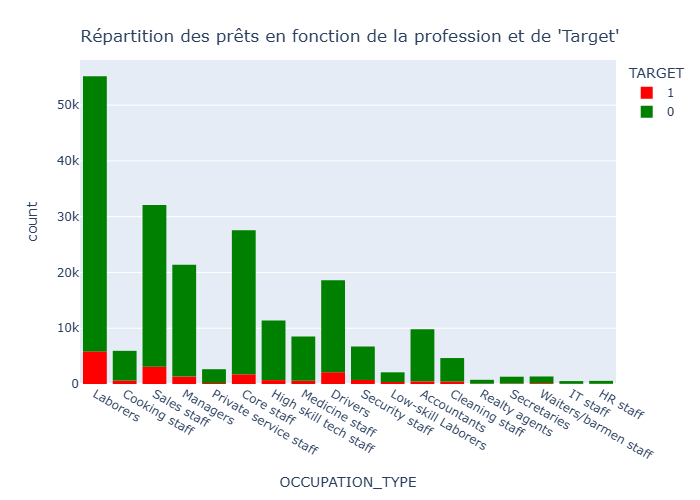

In [42]:
# Visualisation de la répartition pour la variable "OCCUPATION_TYPE" en fonction de la Target.

fig = px.histogram(
    df_appli_train,
    x="OCCUPATION_TYPE",
    color="TARGET",
    color_discrete_map={0: 'green', 1: 'red'}
)

fig.update_layout(
    title={
        'text': "Répartition des prêts en fonction de la profession et de 'Target'",
        'x': 0.5,
        'xanchor': 'center',
        'yanchor': 'top'
    },
    width=700 
)

fig.show()

- On a presque une vingtaine de classes différentes pour les professions des clients de la base de donnée dont la classe dominante est la classe ouvriére.
- Pour ce qui est des défauts de paiments, on tourne autour de 10 % plus ou moins selon les classes.
- On peut ensuite passer aux variables quantitatives puisque l'on a vu ici la majorité des variables intéressantes par rapport à la "Target".

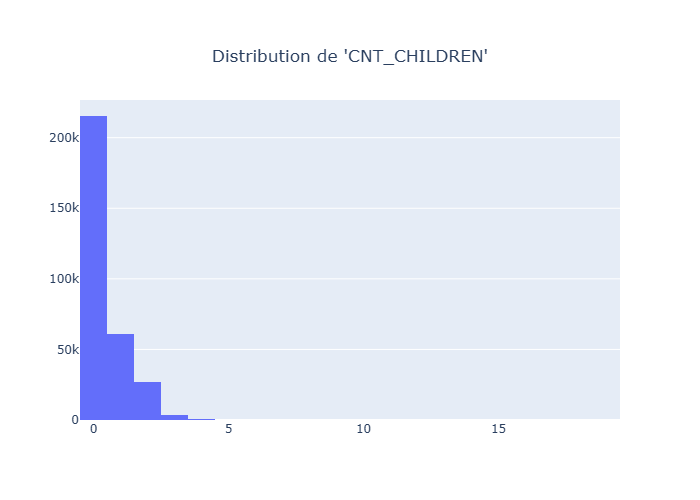

In [43]:
# Visualisation de la répartition pour la variable "CNT_CHILDREN".

fig = go.Figure(data=[go.Histogram(x=df_appli_train["CNT_CHILDREN"], nbinsx=20)])

fig.update_layout(
    title={
        'text': "Distribution de 'CNT_CHILDREN'",
        'x': 0.5,
        'xanchor': 'center',
        'yanchor': 'top'
    },
    width=700 
)

fig.show()

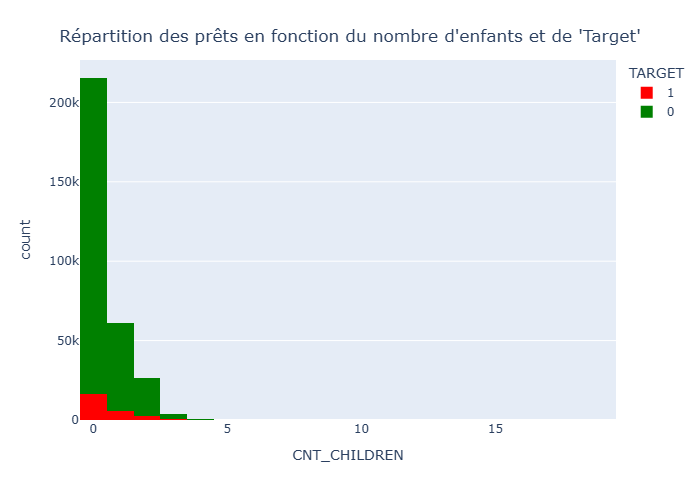

In [44]:
# Visualisation de la répartition pour la variable "CNT_CHILDREN" en fonction de la Target.

fig = px.histogram(
    df_appli_train,
    x="CNT_CHILDREN",
    color="TARGET",
    color_discrete_map={0: 'green', 1: 'red'}
)

fig.update_layout(
    title={
        'text': "Répartition des prêts en fonction du nombre d'enfants et de 'Target'",
        'x': 0.5,
        'xanchor': 'center',
        'yanchor': 'top'
    },
    width=700 
)

fig.show()

- La grande majorité des clients n'ont pas d'enfant et cela ne semble pas être un facteur déterminant au niveau de la Target.

In [45]:
df_appli_train["AMT_INCOME_TOTAL"].describe().round(0)

count       307511.0
mean        168798.0
std         237123.0
min          25650.0
25%         112500.0
50%         147150.0
75%         202500.0
max      117000000.0
Name: AMT_INCOME_TOTAL, dtype: float64

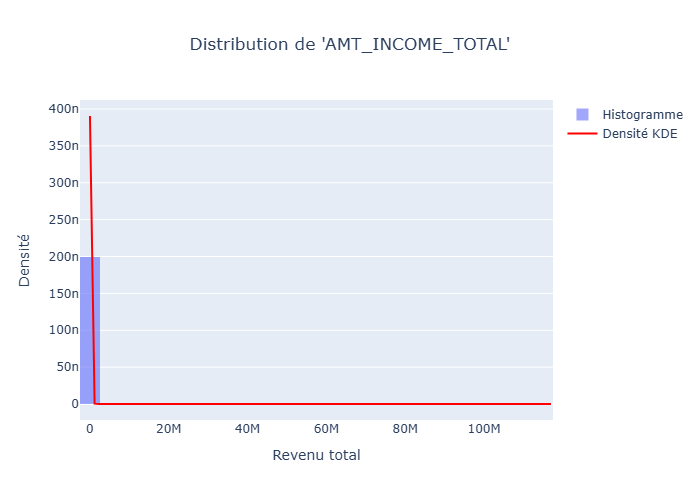

In [46]:
# Visualisation de la répartition pour la variable "AMT_INCOME_TOTAL".

from scipy.stats import gaussian_kde

data = df_appli_train["AMT_INCOME_TOTAL"].dropna()

# Calcul de la densité KDE
kde = gaussian_kde(data)
x_vals = np.linspace(data.min(), data.max(), 100)
y_vals = kde(x_vals)

fig = go.Figure()
fig.add_trace(go.Histogram(x=data, histnorm='probability density', nbinsx=50, name="Histogramme", opacity=0.6))

# Courbe KDE
fig.add_trace(go.Scatter(x=x_vals, y=y_vals, mode='lines', name="Densité KDE", line=dict(color='red', width=2)))

# Mise en page
fig.update_layout(
    title="Distribution de 'AMT_INCOME_TOTAL'",
    title_x=0.5,
    xaxis_title="Revenu total",
    yaxis_title="Densité",
    width=700
)

fig.show()

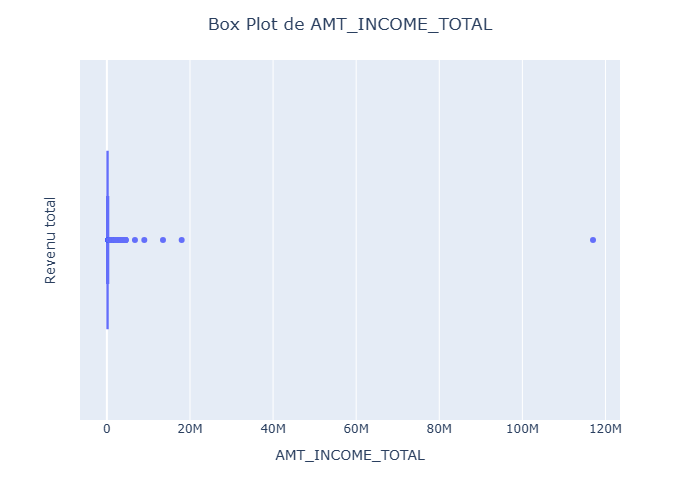

In [47]:
# Visualisation des valeurs aberrantes pour "AMT_INCOME_TOTAL".

fig = px.box(df_appli_train, x="AMT_INCOME_TOTAL")

fig.update_layout(
    title="Box Plot de AMT_INCOME_TOTAL",
    title_x=0.5,
    yaxis_title="Revenu total"
)

fig.show()

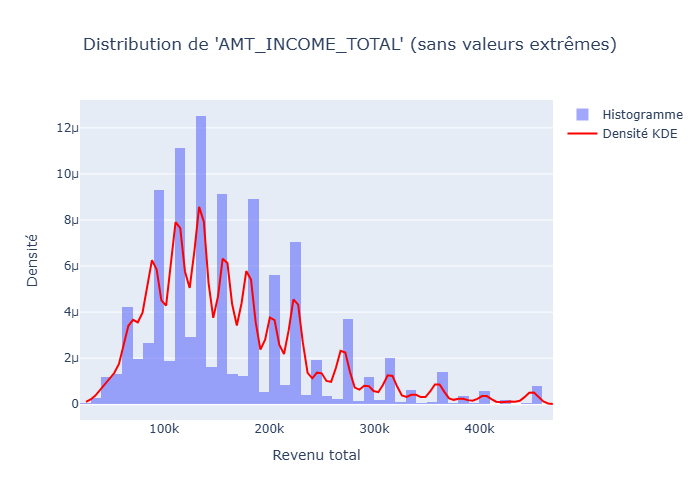

In [48]:
# Visualisation après suppression des valeurs extrêmes (soit suppresion des valeurs les plus élevées)

filtered_data = df_appli_train["AMT_INCOME_TOTAL"]
filtered_data = filtered_data[filtered_data < filtered_data.quantile(0.99)]

# Calcul de la densité KDE
kde = gaussian_kde(filtered_data)
x_vals = np.linspace(filtered_data.min(), filtered_data.max(), 100)
y_vals = kde(x_vals)


fig = go.Figure()
fig.add_trace(go.Histogram(x=filtered_data, histnorm='probability density', nbinsx=50, name="Histogramme", opacity=0.6))

# Courbe KDE
fig.add_trace(go.Scatter(x=x_vals, y=y_vals, mode='lines', name="Densité KDE", line=dict(color='red', width=2)))

# Mise en page
fig.update_layout(
    title="Distribution de 'AMT_INCOME_TOTAL' (sans valeurs extrêmes)",
    title_x=0.5,
    xaxis_title="Revenu total",
    yaxis_title="Densité",
    width=700
)

fig.show()

- On retrouve ici la distribution des revenus des clients avec un zoom dans le deuxième graphique (afin d'avoir une meilleure visibilité de la distribution).
- En effet, la majorité des revenus sont compris entre 0 et 500K et les valeurs aberrantes représentent 1 % des revenus les plus haut (cela va de quelques millions à 117 millions pour la valeur la plus haute).
- Pour la majorité des clients on constate qu'il y a plusieurs seuils de revenus comme on peut le voir avec le graphique ci-dessus avec une concentration entre 100K et 200K. Il y a une distribution asymétrique à droite, avec une queue qui s’étire vers les revenus plus élevés (jusqu'à environ 450 000).

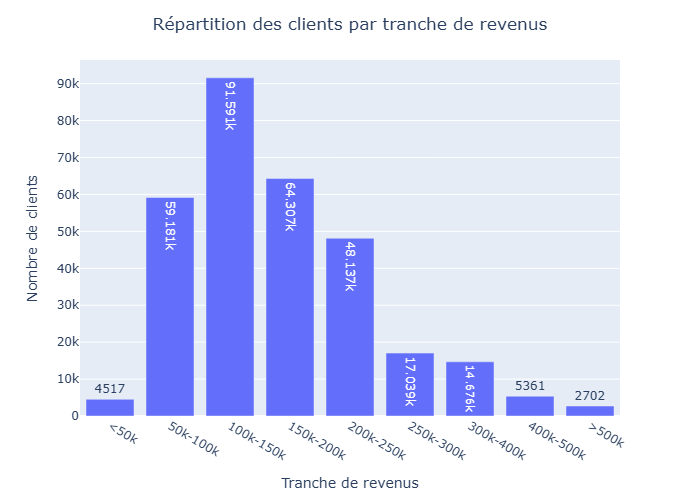

In [49]:
# Visualisation des tranches de revenus de la base de donnée pour plus de lisibilité.

# Définir les intervalles de revenus

bins = [0, 50000, 100000, 150000, 200000, 250000, 300000, 400000, 500000, float("inf")]
labels = ["<50k", "50k-100k", "100k-150k", "150k-200k", "200k-250k", 
          "250k-300k", "300k-400k", "400k-500k", ">500k"]

# Comptage des revenus par tranche sans créer de nouvelle colonne
df_counts = pd.cut(df_appli_train["AMT_INCOME_TOTAL"], bins=bins, labels=labels, include_lowest=True).value_counts().sort_index()

fig = px.bar(x=df_counts.index, y=df_counts.values, 
             labels={"x": "Tranche de revenu", "y": "Nombre de clients"}, text_auto=True)

fig.update_layout(
    title="Répartition des clients par tranche de revenus",
    title_x=0.5,
    xaxis_title="Tranche de revenus",
    yaxis_title="Nombre de clients"
)

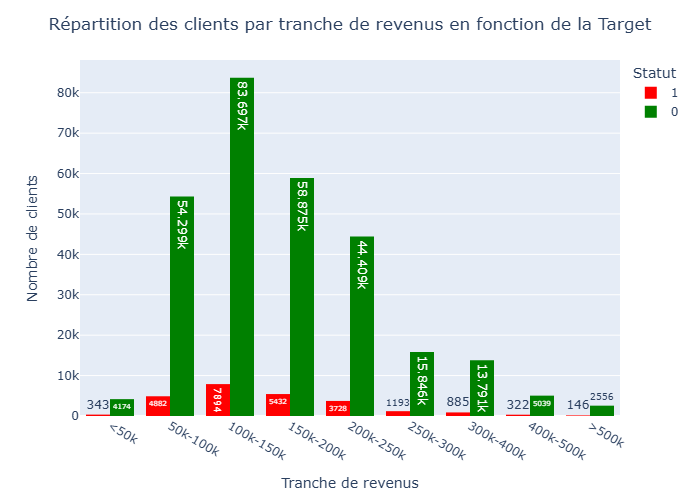

In [50]:
# Visualisation des tranches de revenus en mettant en évidence la Target.

# Création d'un DataFrame contenant uniquement les revenus et la target
df_income_bracket = df_appli_train[["AMT_INCOME_TOTAL", "TARGET"]].copy()

df_income_bracket["Tranche_Revenu"] = pd.cut(df_income_bracket["AMT_INCOME_TOTAL"], bins=bins, labels=labels, include_lowest=True)

fig = px.histogram(df_income_bracket, x="Tranche_Revenu", color="TARGET", color_discrete_map={0: 'green', 1: 'red'},
                   labels={"Tranche_Revenu": "Tranche de revenu", "TARGET": "Statut"},
                   barmode="group", text_auto=True,
                   category_orders={"Tranche_Revenu": ["<50k", "50k-100k", "100k-150k", "150k-200k", 
                                        "200k-250k", "250k-300k", "300k-400k", 
                                        "400k-500k", ">500k"]})

#fig.update_traces(textposition="outside")
fig.update_layout(
    title="Répartition des clients par tranche de revenus en fonction de la Target",
    title_x=0.5,
    xaxis_title="Tranche de revenus",
    yaxis_title="Nombre de clients"
)

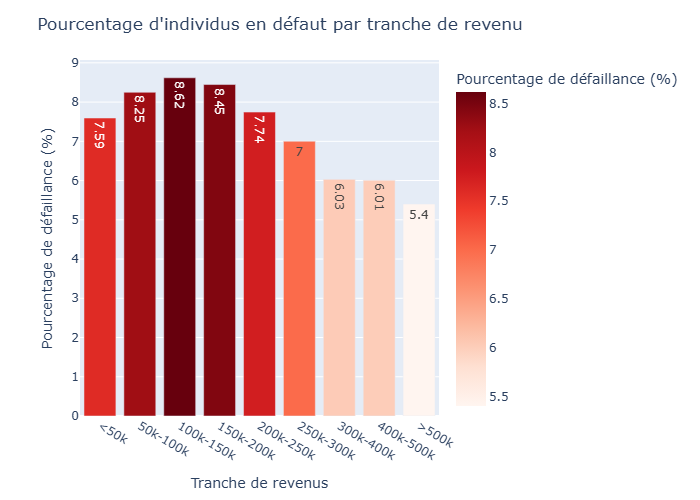

In [51]:
# Visualisation du pourcentage des individus en défaut pour chaque tranche de revenu.

# Calcul du pourcentage d'individus ayant TARGET = 1 par tranche de revenu

df_pourcentage = df_income_bracket.groupby("Tranche_Revenu")["TARGET"].mean().reset_index()
df_pourcentage["TARGET"] *= 100

fig = px.bar(df_pourcentage, 
             x="Tranche_Revenu", 
             y="TARGET", 
             text=df_pourcentage["TARGET"].round(2),
             labels={"TARGET": "Pourcentage de défaillance (%)", "Tranche_Revenu": "Tranche de revenus"},
             color="TARGET", 
             color_continuous_scale="Reds",
             category_orders={"Tranche_Revenu": ["<50k", "50k-100k", "100k-150k", "150k-200k", 
                                                 "200k-250k", "250k-300k", "300k-400k", 
                                                 "400k-500k", ">500k"]}
)

fig.update_layout(
    title="Pourcentage d'individus en défaut par tranche de revenu",
    title_x=0.4,
    xaxis_title="Tranche de revenus",
    yaxis_title="Pourcentage de défaillance (%)"
)

- En regardant les pourcentages de défaillance par tranche de revenu, on remarque que les classes les plus touchées sont celles dont les revenus sont inférieurs à **250K-300K**. Avec un pourcentage supérieur à **8 %** pour les trois classes entre **50K** à **200K**.
- Au delà de **300K**, le pourcentage de défaut semble progressivement diminuer cependant les différences entre les tranches restent relativement mineures (puique la plus grande différence observable est d'environ  **3 %** entre les classes présentant le plus et le moins de défaillances).
- L'impact sur la ***"Target"*** reste donc relativement faible.

In [52]:
df_appli_train["AMT_CREDIT"].describe()

count    3.075110e+05
mean     5.990260e+05
std      4.024908e+05
min      4.500000e+04
25%      2.700000e+05
50%      5.135310e+05
75%      8.086500e+05
max      4.050000e+06
Name: AMT_CREDIT, dtype: float64

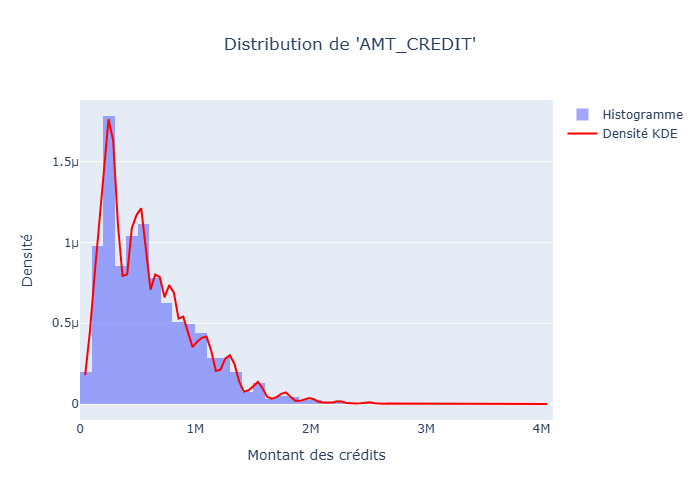

In [53]:
# Visualisation de la répartition pour la variable "AMT_CREDIT".

data = df_appli_train["AMT_CREDIT"].dropna()

# Calcul de la densité KDE
kde = gaussian_kde(data)
x_vals = np.linspace(data.min(), data.max(), 100)
y_vals = kde(x_vals)

fig = go.Figure()
fig.add_trace(go.Histogram(x=data, histnorm='probability density', nbinsx=50, name="Histogramme", opacity=0.6))

# Courbe KDE
fig.add_trace(go.Scatter(x=x_vals, y=y_vals, mode='lines', name="Densité KDE", line=dict(color='red', width=2)))

# Mise en page
fig.update_layout(
    title="Distribution de 'AMT_CREDIT'",
    title_x=0.5,
    xaxis_title="Montant des crédits",
    yaxis_title="Densité",
    width=700
)

fig.show()

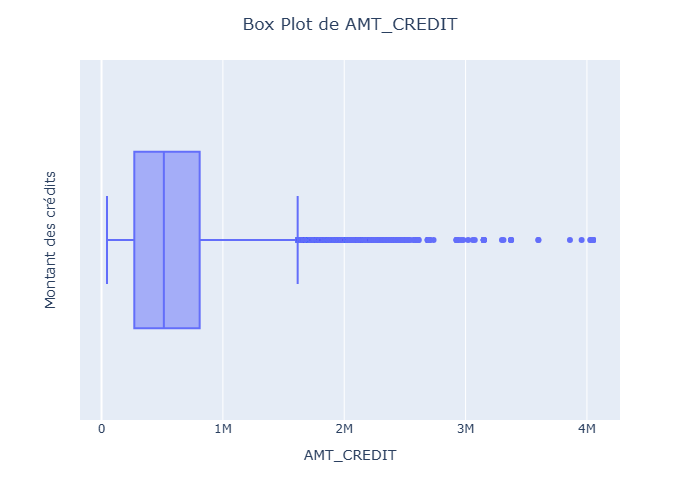

In [54]:
# Visualisation des valeurs aberrantes pour "AMT_CREDIT".

fig = px.box(df_appli_train, x="AMT_CREDIT")

fig.update_layout(
    title="Box Plot de AMT_CREDIT",
    title_x=0.5,
    yaxis_title="Montant des crédits"
)

fig.show()

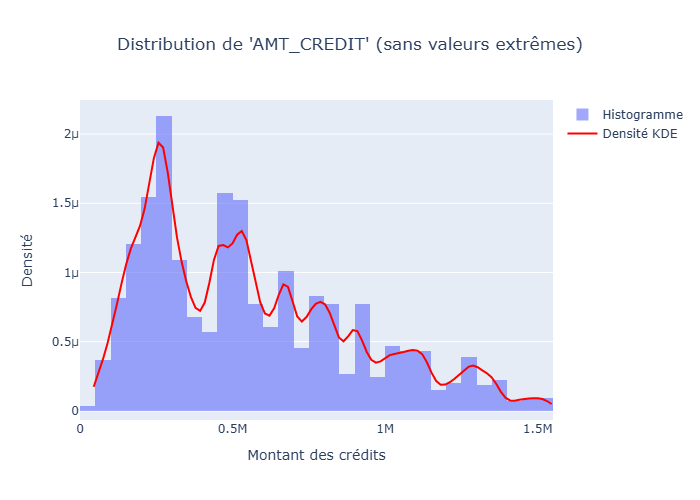

In [55]:
# Visualisation après suppression des valeurs extrêmes (soit suppresion des valeurs les plus élevées)

filtered_data = df_appli_train["AMT_CREDIT"]
filtered_data = filtered_data[filtered_data < filtered_data.quantile(0.97)]

# Calcul de la densité KDE
kde = gaussian_kde(filtered_data)
x_vals = np.linspace(filtered_data.min(), filtered_data.max(), 100)
y_vals = kde(x_vals)


fig = go.Figure()
fig.add_trace(go.Histogram(x=filtered_data, histnorm='probability density', nbinsx=50, name="Histogramme", opacity=0.6))

# Courbe KDE
fig.add_trace(go.Scatter(x=x_vals, y=y_vals, mode='lines', name="Densité KDE", line=dict(color='red', width=2)))

# Mise en page
fig.update_layout(
    title="Distribution de 'AMT_CREDIT' (sans valeurs extrêmes)",
    title_x=0.5,
    xaxis_title="Montant des crédits",
    yaxis_title="Densité",
    width=700
)

fig.show()

- Pour les montants des crédits octroyés, on a une diversité assez importante de montant de 45K à 4M cependant il y a pas mal d'outliers qui crée une asymétrie à droite de la distribution.

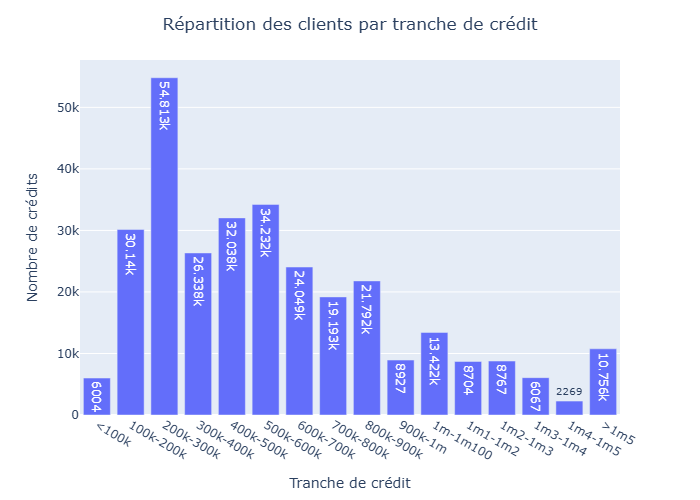

In [56]:
# Visualisation des tranches de crédits de la base de donnée pour plus de lisibilité.

# Définir les intervalles de revenus
bins = [0, 100000, 200000, 300000, 400000, 500000, 600000, 700000, 800000, 900000, 1000000, 1100000, 1200000, 1300000, 1400000, 1500000, float("inf")]
labels = ["<100k", "100k-200k", "200k-300k", "300k-400k", "400k-500k", 
          "500k-600k", "600k-700k", "700k-800k", "800k-900k", "900k-1m", "1m-1m100",
          "1m1-1m2", "1m2-1m3", "1m3-1m4", "1m4-1m5", ">1m5"]

# Comptage des revenus par tranche sans créer de nouvelle colonne
df_counts = pd.cut(df_appli_train["AMT_CREDIT"], bins=bins, labels=labels, include_lowest=True).value_counts().sort_index()

fig = px.bar(x=df_counts.index, y=df_counts.values, text_auto=True)

fig.update_layout(
    title="Répartition des clients par tranche de crédit",
    title_x=0.5,
    xaxis_title="Tranche de crédit",
    yaxis_title="Nombre de crédits"
)


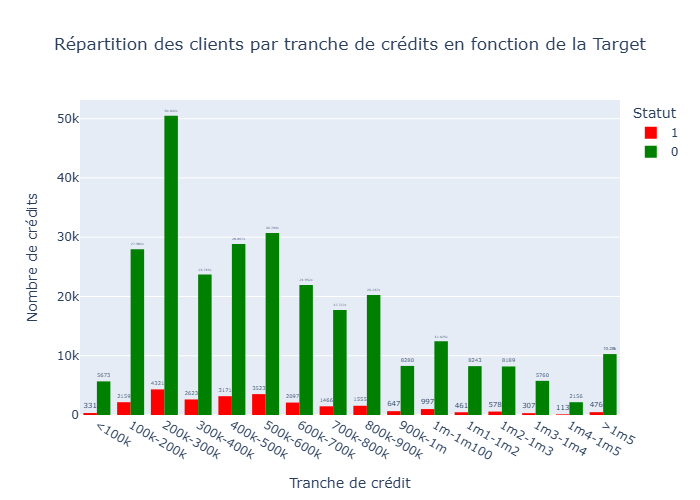

In [57]:
# Visualisation des tranches de crédits en mettant en évidence la Target.

# Création d'un DataFrame contenant uniquement les revenus et la target
df_credit_bracket = df_appli_train[["AMT_CREDIT", "TARGET"]].copy()

df_credit_bracket["Credit_bracket"] = pd.cut(df_credit_bracket["AMT_CREDIT"], bins=bins, labels=labels, include_lowest=True)

fig = px.histogram(df_credit_bracket, x="Credit_bracket", color="TARGET", color_discrete_map={0: 'green', 1: 'red'},
                   labels={"Credit_bracket": "Tranche de crédit", "TARGET": "Statut"},
                   title="Répartition des clients par tranche de crédit en fonction de la Target",
                   barmode="group", text_auto=True,
                   category_orders={"Credit_bracket": ["<100k", "100k-200k", "200k-300k", "300k-400k", "400k-500k", 
          "500k-600k", "600k-700k", "700k-800k", "800k-900k", "900k-1m", "1m-1m100",
          "1m1-1m2", "1m2-1m3", "1m3-1m4", "1m4-1m5", ">1m5"]})

# Affichage du graphique

fig.update_traces(textposition="outside")
fig.update_layout(
    title="Répartition des clients par tranche de crédits en fonction de la Target",
    title_x=0.5,
    xaxis_title="Tranche de crédit",
    yaxis_title="Nombre de crédits"
)

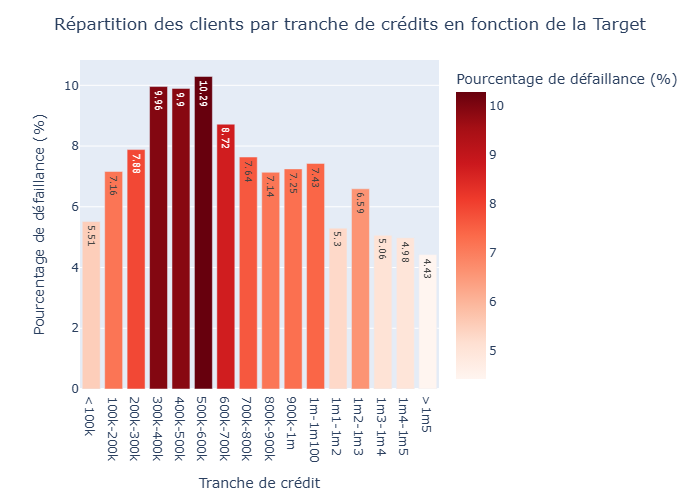

In [58]:
# Visualisation du pourcentage des individus en défaut pour chaque tranche de crédits.

# Calcul du pourcentage d'individus ayant TARGET = 1 par tranche de revenu

df_pourcentage = df_credit_bracket.groupby("Credit_bracket")["TARGET"].mean().reset_index()
df_pourcentage["TARGET"] *= 100

fig = px.bar(df_pourcentage, 
             x="Credit_bracket", 
             y="TARGET", 
             text=df_pourcentage["TARGET"].round(2),
             labels={"TARGET": "Pourcentage de défaillance (%)", "Credit_bracket": "Tranche de revenu"},
             color="TARGET", 
             color_continuous_scale="Reds",
             category_orders={"Credit_bracket": ["<100k", "100k-200k", "200k-300k", "300k-400k", "400k-500k", 
          "500k-600k", "600k-700k", "700k-800k", "800k-900k", "900k-1m", "1m-1m100",
          "1m1-1m2", "1m2-1m3", "1m3-1m4", "1m4-1m5", ">1m5"]}
)

fig.update_layout(
    title="Répartition des clients par tranche de crédits en fonction de la Target",
    title_x=0.5,
    xaxis_title="Tranche de crédit",
    yaxis_title="Pourcentage de défaillance (%)"
)

- La majorité des crédits octroyés sont inférieurs à 1M et la tranche la plus importante comprends les crédits compris entre 200K et 300K.
- Pour ce qui est de la target entre 300K et 600K on est aux alentours de 10 % de défauts, cependant cela semble diminuer plus les montants de crédits augmentent (on est aux alentours de 5 % pour les dernières tranches)
- Le montant des crédits ne semblent donc pas influencer la variable **"Target"**.

In [59]:
df_appli_train["AMT_ANNUITY"].describe()

count    307499.000000
mean      27108.573909
std       14493.737315
min        1615.500000
25%       16524.000000
50%       24903.000000
75%       34596.000000
max      258025.500000
Name: AMT_ANNUITY, dtype: float64

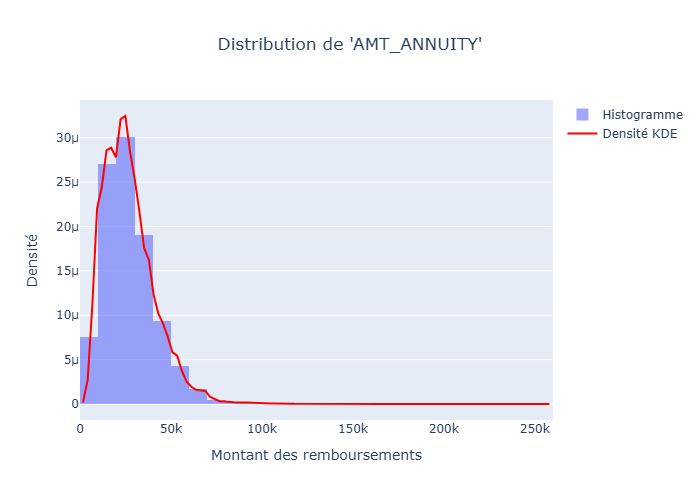

In [60]:
# Visualisation de la répartition pour la variable "AMT_ANNUITY".

data = df_appli_train["AMT_ANNUITY"].dropna()

# Calcul de la densité KDE
kde = gaussian_kde(data)
x_vals = np.linspace(data.min(), data.max(), 100)
y_vals = kde(x_vals)

fig = go.Figure()
fig.add_trace(go.Histogram(x=data, histnorm='probability density', nbinsx=50, name="Histogramme", opacity=0.6))

# Courbe KDE
fig.add_trace(go.Scatter(x=x_vals, y=y_vals, mode='lines', name="Densité KDE", line=dict(color='red', width=2)))

# Mise en page
fig.update_layout(
    title="Distribution de 'AMT_ANNUITY'",
    title_x=0.5,
    xaxis_title="Montant des remboursements",
    yaxis_title="Densité",
    width=700
)

fig.show()

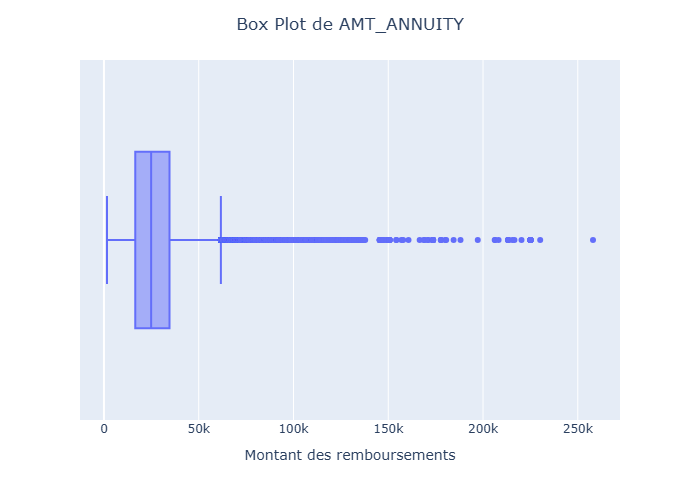

In [61]:
# Visualisation des valeurs aberrantes pour "AMT_ANNUITY".

fig = px.box(df_appli_train, x="AMT_ANNUITY")

fig.update_layout(
    title="Box Plot de AMT_ANNUITY",
    title_x=0.5,
    xaxis_title="Montant des remboursements"
)

fig.show()

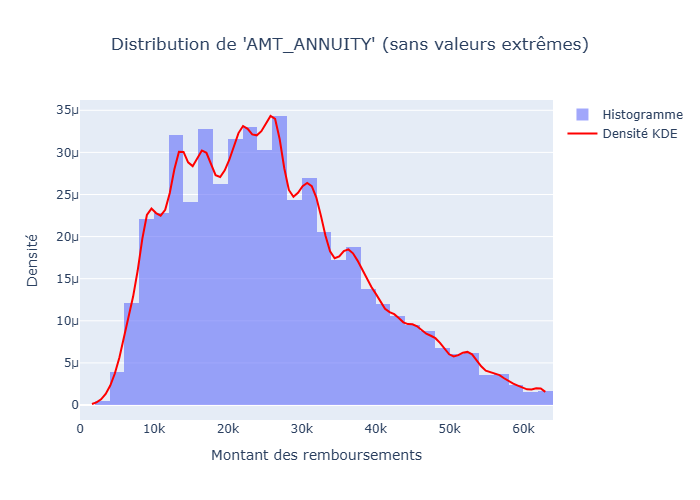

In [62]:
# Visualisation après suppression des valeurs extrêmes (soit suppresion des valeurs les plus élevées)

filtered_data = df_appli_train["AMT_ANNUITY"]
filtered_data = filtered_data[filtered_data < filtered_data.quantile(0.98)]

# Calcul de la densité KDE
kde = gaussian_kde(filtered_data)
x_vals = np.linspace(filtered_data.min(), filtered_data.max(), 100)
y_vals = kde(x_vals)


fig = go.Figure()
fig.add_trace(go.Histogram(x=filtered_data, histnorm='probability density', nbinsx=50, name="Histogramme", opacity=0.6))

# Courbe KDE
fig.add_trace(go.Scatter(x=x_vals, y=y_vals, mode='lines', name="Densité KDE", line=dict(color='red', width=2)))

# Mise en page
fig.update_layout(
    title="Distribution de 'AMT_ANNUITY' (sans valeurs extrêmes)",
    title_x=0.5,
    xaxis_title="Montant des remboursements",
    yaxis_title="Densité",
    width=700
)

fig.show()

- Comme précédemment avec les montants des revenus et des crédits, on retrouve des outliers positifs pour le montant des remboursements de certains clients (ce qui corrobore bien avec les chiffres précédemment observés).

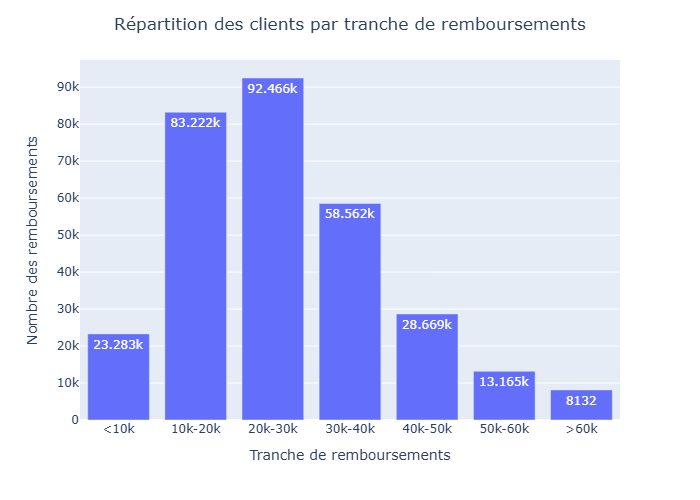

In [63]:
# Visualisation des tranches de crédits de la base de donnée pour plus de lisibilité.

# Définir les intervalles de revenus
bins = [0, 10000, 20000, 30000, 40000, 50000, 60000, float("inf")]
labels = ["<10k", "10k-20k", "20k-30k", "30k-40k", "40k-50k", 
          "50k-60k",">60k"]

# Comptage des revenus par tranche sans créer de nouvelle colonne
df_counts = pd.cut(df_appli_train["AMT_ANNUITY"], bins=bins, labels=labels, include_lowest=True).value_counts().sort_index()

fig = px.bar(x=df_counts.index, y=df_counts.values, text_auto=True)

fig.update_layout(
    title="Répartition des clients par tranche de remboursements",
    title_x=0.5,
    xaxis_title="Tranche de remboursements",
    yaxis_title="Nombre des remboursements"
)

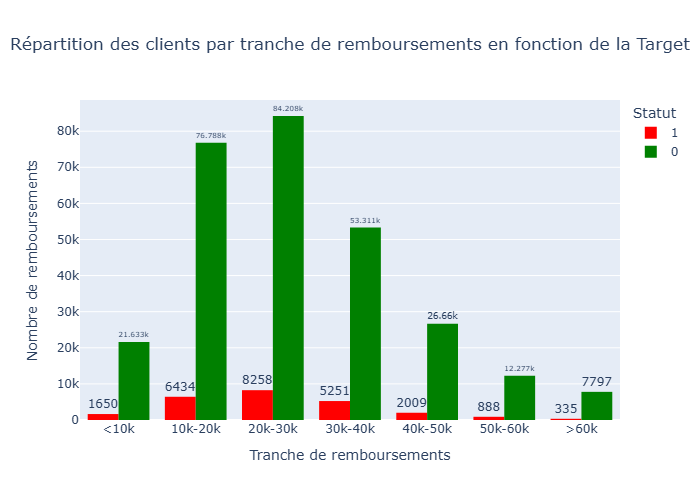

In [64]:
# Visualisation des tranches de crédits en mettant en évidence la Target.

# Création d'un DataFrame contenant uniquement les revenus et la target
df_annuity_bracket = df_appli_train[["AMT_ANNUITY", "TARGET"]].copy()

df_annuity_bracket["Annuity_bracket"] = pd.cut(df_annuity_bracket["AMT_ANNUITY"], bins=bins, labels=labels, include_lowest=True)

fig = px.histogram(df_annuity_bracket, x="Annuity_bracket", color="TARGET", color_discrete_map={0: 'green', 1: 'red'},
                   labels={"Annuity_bracket": "Tranche de crédit", "TARGET": "Statut"},
                   title="Répartition des clients par tranche de crédit en fonction de la Target",
                   barmode="group", text_auto=True,
                   category_orders={"Annuity_bracket": ["<10k", "10k-20k", "20k-30k", "30k-40k", "40k-50k", 
          "50k-60k",">60k"]})

# Affichage du graphique

fig.update_traces(textposition="outside")
fig.update_layout(
    title="Répartition des clients par tranche de remboursements en fonction de la Target",
    title_x=0.5,
    xaxis_title="Tranche de remboursements",
    yaxis_title="Nombre de remboursements"
)

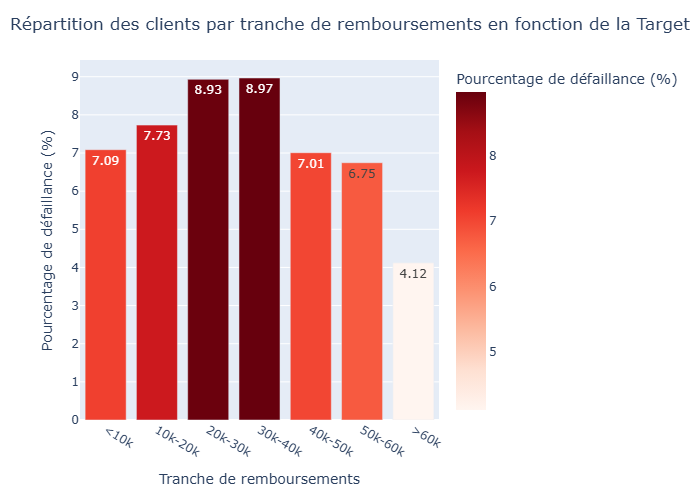

In [65]:
# Visualisation du pourcentage des individus en défaut pour chaque tranche de crédits.

df_pourcentage = df_annuity_bracket.groupby("Annuity_bracket")["TARGET"].mean().reset_index()
df_pourcentage["TARGET"] *= 100

fig = px.bar(df_pourcentage, 
             x="Annuity_bracket", 
             y="TARGET", 
             text=df_pourcentage["TARGET"].round(2),
             labels={"TARGET": "Pourcentage de défaillance (%)", "Annuity_bracket": "Tranche de remboursements"},
             color="TARGET", 
             color_continuous_scale="Reds",
             category_orders={"Annuity_bracket": ["<10k", "10k-20k", "20k-30k", "30k-40k", "40k-50k", 
          "50k-60k",">60k"]}
)

fig.update_layout(
    title="Répartition des clients par tranche de remboursements en fonction de la Target",
    title_x=0.5,
    xaxis_title="Tranche de remboursements",
    yaxis_title="Pourcentage de défaillance (%)"
)

- Lorsque l'on regarde les pourcentages de défaillance, on constate que les clients dont les remboursements périodiques sont compris entre 20K ET 40k présentent le plus de défauts. Cela semble diminuer plus ce montant augmente.
- De nouveau, l'augmentation du montant des remboursements périodiques ne semblent pas impacter dans le même sens la Target.

In [66]:
df_appli_train["REGION_POPULATION_RELATIVE"].describe()


count    307511.000000
mean          0.020868
std           0.013831
min           0.000290
25%           0.010006
50%           0.018850
75%           0.028663
max           0.072508
Name: REGION_POPULATION_RELATIVE, dtype: float64

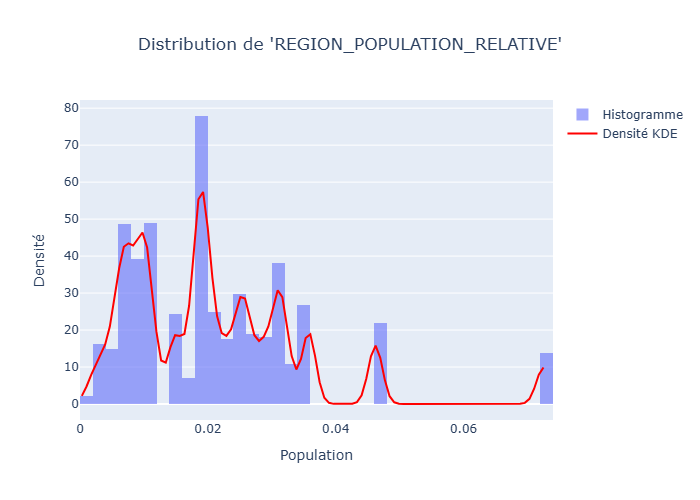

In [67]:
# Visualisation de la répartition pour la variable "REGION_POPULATION_RELATIVE".

data = df_appli_train["REGION_POPULATION_RELATIVE"].dropna()

# Calcul de la densité KDE
kde = gaussian_kde(data)
x_vals = np.linspace(data.min(), data.max(), 100)
y_vals = kde(x_vals)

fig = go.Figure()
fig.add_trace(go.Histogram(x=data, histnorm='probability density', nbinsx=50, name="Histogramme", opacity=0.6))

# Courbe KDE
fig.add_trace(go.Scatter(x=x_vals, y=y_vals, mode='lines', name="Densité KDE", line=dict(color='red', width=2)))

# Mise en page
fig.update_layout(
    title="Distribution de 'REGION_POPULATION_RELATIVE'",
    title_x=0.5,
    xaxis_title="Population",
    yaxis_title="Densité",
    width=700
)

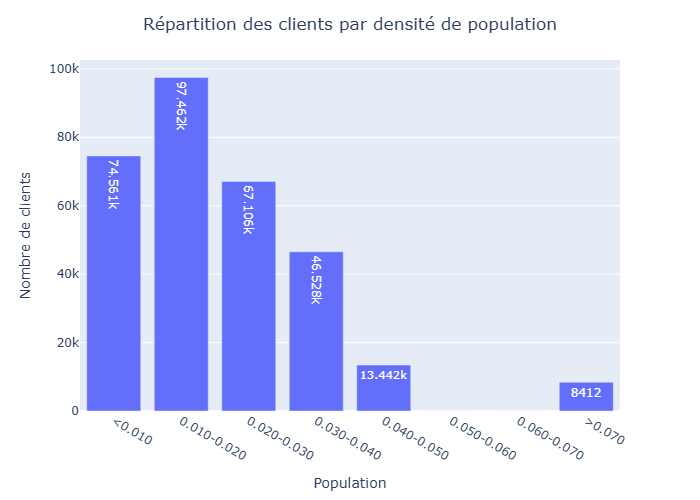

In [68]:
# Visualisation des tranches de densité de population pour plus de lisibilité.

# Définir les intervalles de revenus
bins = [0, 0.010, 0.020, 0.030, 0.040, 0.050, 0.060, 0.070, float("inf")]
labels = ["<0.010", "0.010-0.020", "0.020-0.030", "0.030-0.040", "0.040-0.050", 
          "0.050-0.060","0.060-0.070",">0.070"]

# Comptage des revenus par tranche sans créer de nouvelle colonne
df_counts = pd.cut(df_appli_train["REGION_POPULATION_RELATIVE"], bins=bins, labels=labels, include_lowest=True).value_counts().sort_index()

fig = px.bar(x=df_counts.index, y=df_counts.values, text_auto=True)

fig.update_layout(
    title="Répartition des clients par densité de population",
    title_x=0.5,
    xaxis_title="Population",
    yaxis_title="Nombre de clients"
)

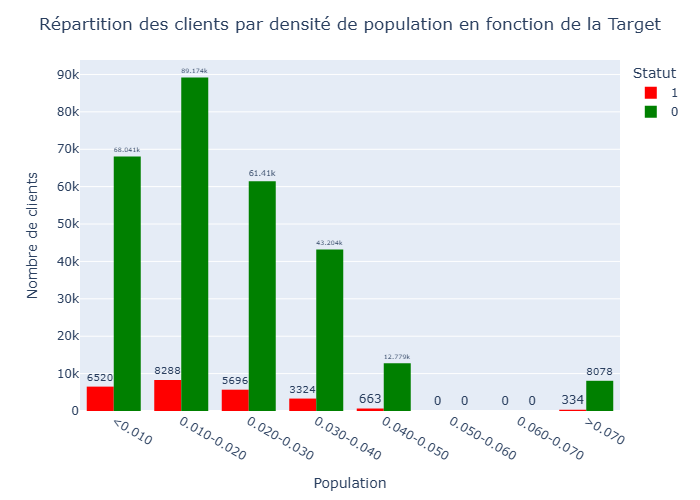

In [69]:
# Visualisation des tranches de densité de population en mettant en évidence la Target.

# Création d'un DataFrame contenant uniquement les revenus et la target
df_pop_bracket = df_appli_train[["REGION_POPULATION_RELATIVE", "TARGET"]].copy()

df_pop_bracket["pop_bracket"] = pd.cut(df_pop_bracket["REGION_POPULATION_RELATIVE"], bins=bins, labels=labels, include_lowest=True)

fig = px.histogram(df_pop_bracket, x="pop_bracket", color="TARGET", color_discrete_map={0: 'green', 1: 'red'},
                   labels={"pop_bracket": "Population", "TARGET": "Statut"},
                   barmode="group", text_auto=True,
                   category_orders={"pop_bracket": ["<0.010", "0.010-0.020", "0.020-0.030", "0.030-0.040", "0.040-0.050", 
          "0.050-0.060","0.060-0.070",">0.070"]})

# Affichage du graphique

fig.update_traces(textposition="outside")
fig.update_layout(
    title="Répartition des clients par densité de population en fonction de la Target",
    title_x=0.5,
    xaxis_title="Population",
    yaxis_title="Nombre de clients"
)

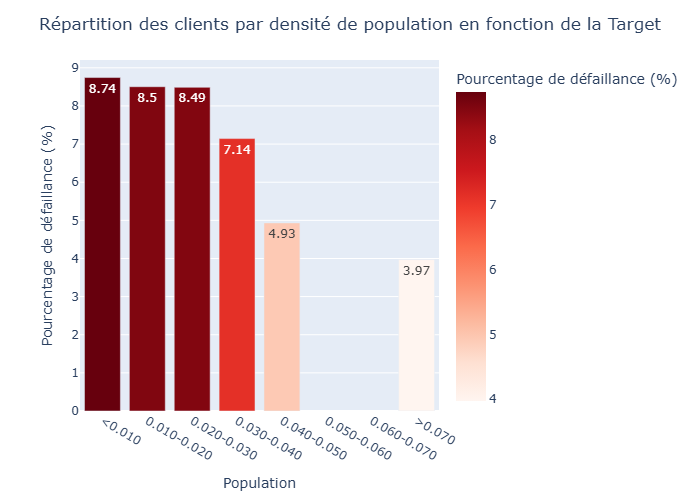

In [70]:
# Visualisation du pourcentage des individus en défaut par densité de population.

# Calcul du pourcentage d'individus ayant TARGET = 1 par tranche de revenu

df_pourcentage = df_pop_bracket.groupby("pop_bracket")["TARGET"].mean().reset_index()
df_pourcentage["TARGET"] *= 100

fig = px.bar(df_pourcentage, 
             x="pop_bracket", 
             y="TARGET", 
             text=df_pourcentage["TARGET"].round(2),
             labels={"TARGET": "Pourcentage de défaillance (%)", "pop_bracket": "Population"},
             color="TARGET", 
             color_continuous_scale="Reds",
             category_orders={"pop_bracket": ["<10k", "10k-20k", "20k-30k", "30k-40k", "40k-50k", 
          "50k-60k",">60k"]}
)

fig.update_layout(
    title="Répartition des clients par densité de population en fonction de la Target",
    title_x=0.5,
    xaxis_title="Population",
    yaxis_title="Pourcentage de défaillance (%)"
)

- Cette variable semble plus intéressante en prenant en compte la Target puiqsue ici il semble y avoir une corrélation entre la densité de population de la région dans laquelle habite un client et le pourcentage de defaut. 
- En effet, ce pourcentage semble diminuer lorsque la région est plus densément peuplé. Donc il y a une corrélation négative avec la target.

In [71]:
df_appli_train["DAYS_BIRTH"].describe()

count    307511.000000
mean     -16036.995067
std        4363.988632
min      -25229.000000
25%      -19682.000000
50%      -15750.000000
75%      -12413.000000
max       -7489.000000
Name: DAYS_BIRTH, dtype: float64

- On peut ici modifier la variable directement puisque on a ici l'âge des clients mais en nombre de jour (de plus nombre négatif)

In [72]:
df_appli_train["DAYS_BIRTH"] = df_appli_train['DAYS_BIRTH'] / -365

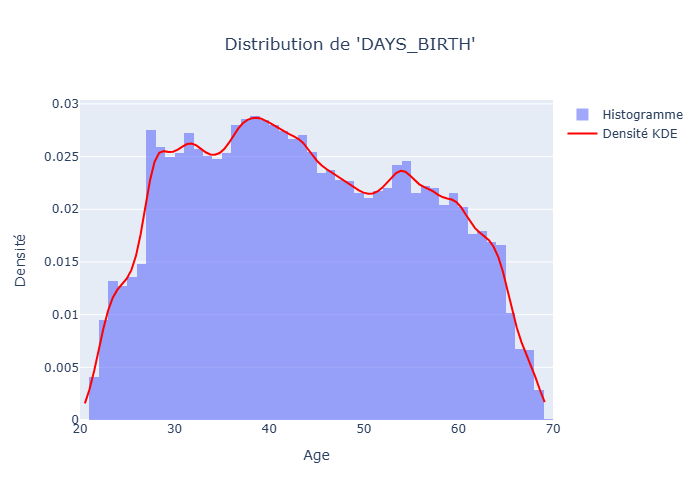

In [73]:
# Visualisation de la répartition pour la variable "DAYS_BIRTH".

data = df_appli_train["DAYS_BIRTH"].dropna()

# Calcul de la densité KDE
kde = gaussian_kde(data)
x_vals = np.linspace(data.min(), data.max(), 100)
y_vals = kde(x_vals)

fig = go.Figure()
fig.add_trace(go.Histogram(x=data, histnorm='probability density', nbinsx=50, name="Histogramme", opacity=0.6))

# Courbe KDE
fig.add_trace(go.Scatter(x=x_vals, y=y_vals, mode='lines', name="Densité KDE", line=dict(color='red', width=2)))

# Mise en page
fig.update_layout(
    title="Distribution de 'DAYS_BIRTH'",
    title_x=0.5,
    xaxis_title="Age",
    yaxis_title="Densité",
    width=700
)

fig.show()

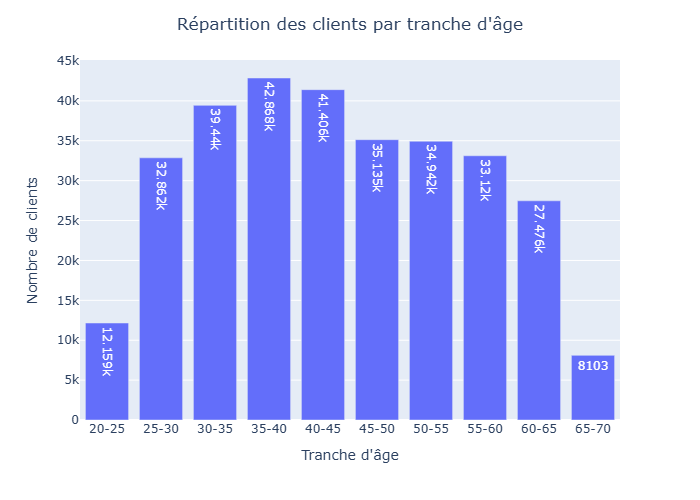

In [74]:
# Visualisation des tranches d'âge de la base de donnée pour plus de lisibilité.

# Définir les intervalles de revenus
bins = [20, 25, 30, 35, 40, 45, 50, 55, 60, 65, 70]
labels = ["20-25", "25-30", "30-35", "35-40", 
          "40-45", "45-50", "50-55", "55-60", "60-65", "65-70"]

# Comptage des revenus par tranche sans créer de nouvelle colonne
df_counts = pd.cut(df_appli_train["DAYS_BIRTH"], bins=bins, labels=labels, include_lowest=True).value_counts().sort_index()

fig = px.bar(x=df_counts.index, y=df_counts.values, text_auto=True)

fig.update_traces(textposition="inside")
fig.update_layout(
    title="Répartition des clients par tranche d'âge",
    title_x=0.5,
    xaxis_title="Tranche d'âge",
    yaxis_title="Nombre de clients"
)

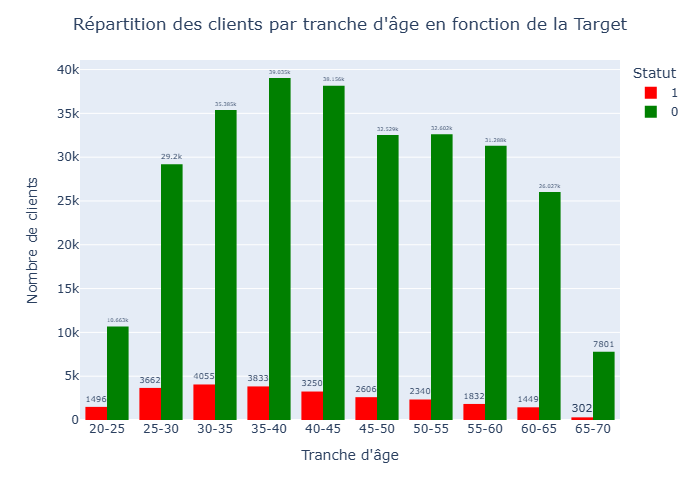

In [75]:
# Visualisation des tranches d'âge en mettant en évidence la Target.

# Création d'un DataFrame contenant uniquement les revenus et la target
df_age_bracket = df_appli_train[["DAYS_BIRTH", "TARGET"]].copy()

df_age_bracket["Age_bracket"] = pd.cut(df_age_bracket["DAYS_BIRTH"], bins=bins, labels=labels, include_lowest=True)

fig = px.histogram(df_age_bracket, x="Age_bracket", color="TARGET", color_discrete_map={0: 'green', 1: 'red'},
                   labels={"Age_bracket": "Tranche d'âge", "TARGET": "Statut"},
                   barmode="group", text_auto=True,
                   category_orders={"Age_bracket": ["20-25", "25-30", "30-35", "35-40", 
          "40-45", "45-50", "50-55", "55-60", "60-65", "65-70"]})

# Affichage du graphique

fig.update_traces(textposition="outside")
fig.update_layout(
    title="Répartition des clients par tranche d'âge en fonction de la Target",
    title_x=0.5,
    xaxis_title="Tranche d'âge",
    yaxis_title="Nombre de clients"
)

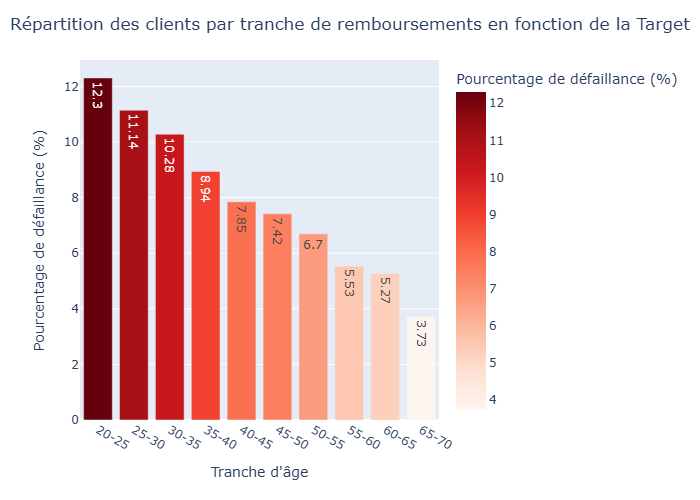

In [76]:
# Visualisation du pourcentage des individus en défaut pour chaque tranche d'âge.

df_pourcentage = df_age_bracket.groupby("Age_bracket")["TARGET"].mean().reset_index()
df_pourcentage["TARGET"] *= 100

fig = px.bar(df_pourcentage, 
             x="Age_bracket", 
             y="TARGET", 
             text=df_pourcentage["TARGET"].round(2),
             labels={"TARGET": "Pourcentage de défaillance (%)", "Age_bracket": "Tranche d'âge"},
             color="TARGET", 
             color_continuous_scale="Reds",
             category_orders={"Age_bracket": ["20-25", "25-30", "30-35", "35-40", 
          "40-45", "45-50", "50-55", "55-60", "60-65", "65-70"]}
)

fig.update_layout(
    title="Répartition des clients par tranche de remboursements en fonction de la Target",
    title_x=0.5,
    xaxis_title="Tranche d'âge",
    yaxis_title="Pourcentage de défaillance (%)"
)

- Pour la variable âge on a une nouvelle fois une relation intéressante puisque ici on remarque assez facilement que le pourcentage de défaillance diminue avec l'âge.
- En effet, même si les 20-25 ans sont minoritaires ce qui pourrait expliquer ce résultat, entre 25 et 60 ans on a peu près le même effectif entre les tranches et cela n'impacte pas cette tendance à la baisse à mesure que l'âge augmente.

In [77]:
df_appli_train["DAYS_EMPLOYED"].describe()

count    307511.000000
mean      63815.045904
std      141275.766519
min      -17912.000000
25%       -2760.000000
50%       -1213.000000
75%        -289.000000
max      365243.000000
Name: DAYS_EMPLOYED, dtype: float64

In [78]:
df_appli_train["DAYS_EMPLOYED"] = df_appli_train["DAYS_EMPLOYED"].abs()
df_appli_train["DAYS_EMPLOYED"] = df_appli_train["DAYS_EMPLOYED"] / 365

In [79]:
df_appli_train["DAYS_EMPLOYED"].describe()

count    307511.000000
mean        185.547239
std         382.037676
min           0.000000
25%           2.556164
50%           6.079452
75%          15.635616
max        1000.665753
Name: DAYS_EMPLOYED, dtype: float64

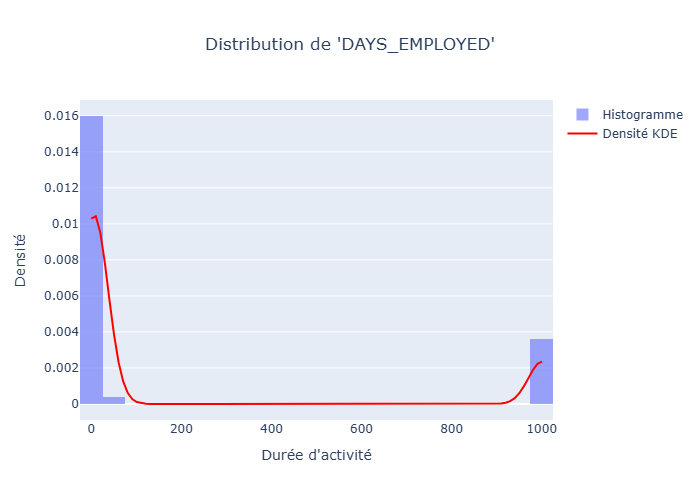

In [80]:
# Visualisation de la répartition pour la variable "DAYS_EMPLOYED".

data = df_appli_train["DAYS_EMPLOYED"].dropna()

# Calcul de la densité KDE
kde = gaussian_kde(data)
x_vals = np.linspace(data.min(), data.max(), 100)
y_vals = kde(x_vals)

fig = go.Figure()
fig.add_trace(go.Histogram(x=data, histnorm='probability density', nbinsx=50, name="Histogramme", opacity=0.6))

# Courbe KDE
fig.add_trace(go.Scatter(x=x_vals, y=y_vals, mode='lines', name="Densité KDE", line=dict(color='red', width=2)))

# Mise en page
fig.update_layout(
    title="Distribution de 'DAYS_EMPLOYED'",
    title_x=0.5,
    xaxis_title="Durée d'activité",
    yaxis_title="Densité",
    width=700
)

fig.show()

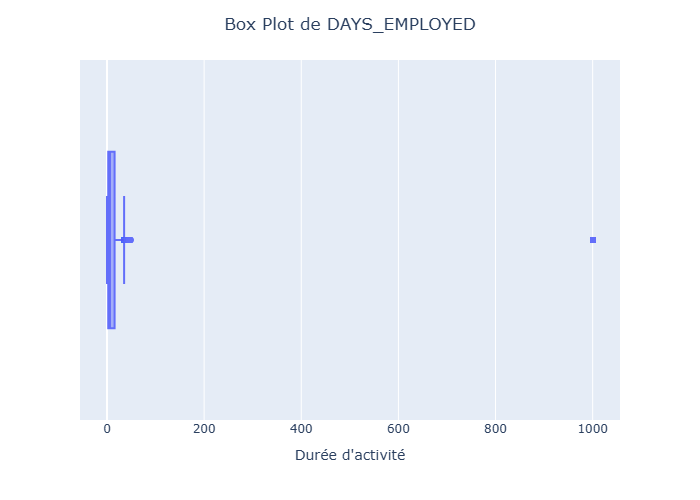

In [81]:
# Visualisation des valeurs aberrantes pour "DAYS_EMPLOYED".

fig = px.box(df_appli_train, x="DAYS_EMPLOYED")

fig.update_layout(
    title="Box Plot de DAYS_EMPLOYED",
    title_x=0.5,
    xaxis_title="Durée d'activité"
)

fig.show()

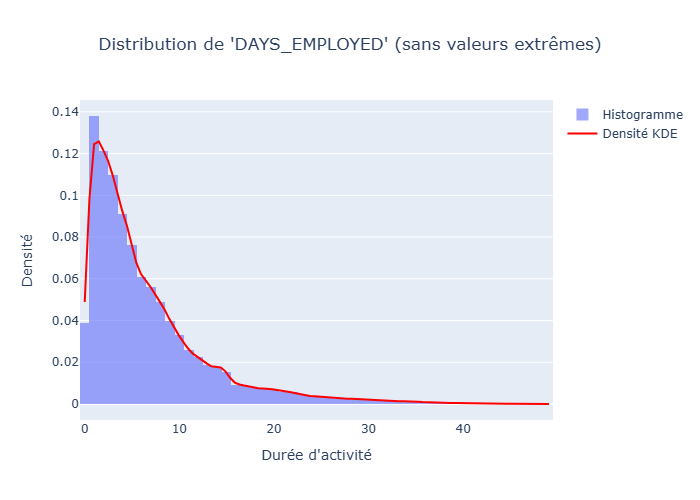

In [82]:
# Visualisation après suppression des valeurs extrêmes (soit suppresion des valeurs les plus élevées)

filtered_data = df_appli_train["DAYS_EMPLOYED"]
filtered_data = filtered_data[filtered_data < filtered_data.quantile(0.99)]

# Calcul de la densité KDE
kde = gaussian_kde(filtered_data)
x_vals = np.linspace(filtered_data.min(), filtered_data.max(), 100)
y_vals = kde(x_vals)


fig = go.Figure()
fig.add_trace(go.Histogram(x=filtered_data, histnorm='probability density', nbinsx=50, name="Histogramme", opacity=0.6))

# Courbe KDE
fig.add_trace(go.Scatter(x=x_vals, y=y_vals, mode='lines', name="Densité KDE", line=dict(color='red', width=2)))

# Mise en page
fig.update_layout(
    title="Distribution de 'DAYS_EMPLOYED' (sans valeurs extrêmes)",
    title_x=0.5,
    xaxis_title="Durée d'activité",
    yaxis_title="Densité",
    width=700
)

fig.show()

In [84]:
df_appli_train.loc[df_appli_train["DAYS_EMPLOYED"] > 55]['DAYS_EMPLOYED'].value_counts()

1000.665753    55374
Name: DAYS_EMPLOYED, dtype: int64

- On a ici pas mal de valeurs aberrantes sur la durée d'activité de certains clients qui atteint les 1000 ans ce qu'il faudra changer par la suite (**55 374** lignes affichent cette valeur aberrante).

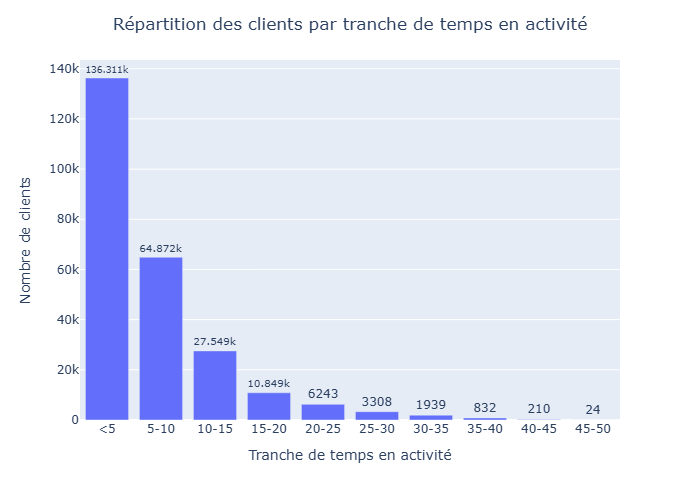

In [85]:
# Visualisation des tranches d'activité de la base de donnée pour plus de lisibilité.

# Définir les intervalles de revenus
bins = [0, 5, 10, 15, 20, 25, 30, 35, 40, 45, 50]
labels = ["<5", "5-10", "10-15", "15-20", "20-25", 
          "25-30","30-35", "35-40", "40-45", "45-50"]

# Comptage des revenus par tranche sans créer de nouvelle colonne
df_counts = pd.cut(filtered_data, bins=bins, labels=labels, include_lowest=True).value_counts().sort_index()

fig = px.bar(x=df_counts.index, y=df_counts.values, text_auto=True)

fig.update_traces(textposition="outside")
fig.update_layout(
    title="Répartition des clients par tranche de temps en activité",
    title_x=0.5,
    xaxis_title="Tranche de temps en activité",
    yaxis_title="Nombre de clients"
)

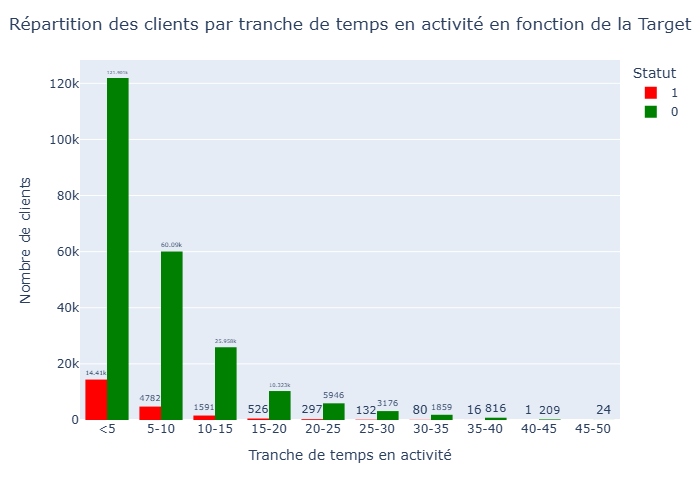

In [86]:
# Visualisation des tranches d'activité en mettant en évidence la Target.

# Création d'un DataFrame contenant uniquement les revenus et la target
df_activity_bracket = df_appli_train[["DAYS_EMPLOYED", "TARGET"]].copy()

df_activity_bracket["Activity_bracket"] = pd.cut(df_activity_bracket["DAYS_EMPLOYED"], bins=bins, labels=labels, include_lowest=True)

fig = px.histogram(df_activity_bracket, x="Activity_bracket", color="TARGET", color_discrete_map={0: 'green', 1: 'red'},
                   labels={"Activity_bracket": "Tranche de temps en activité", "TARGET": "Statut"},
                   barmode="group", text_auto=True,
                   category_orders={"Activity_bracket": ["<5", "5-10", "10-15", "15-20", "20-25", 
          "25-30","30-35", "35-40", "40-45", "45-50"]})

# Affichage du graphique

fig.update_traces(textposition="outside")
fig.update_layout(
    title="Répartition des clients par tranche de temps en activité en fonction de la Target",
    title_x=0.5,
    xaxis_title="Tranche de temps en activité",
    yaxis_title="Nombre de clients"
)

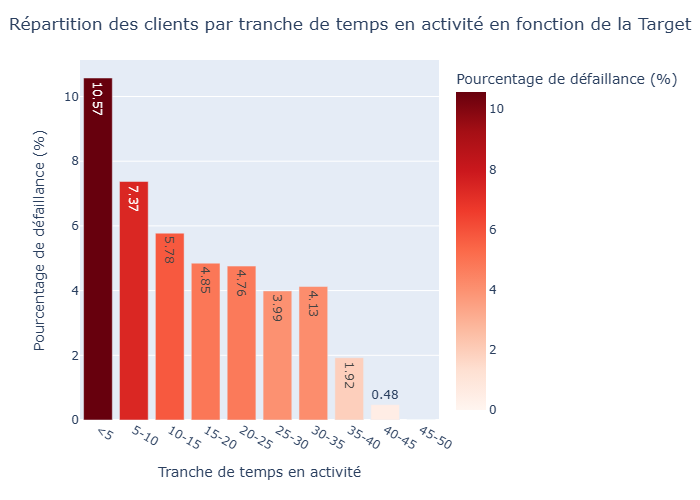

In [87]:
# Visualisation du pourcentage des individus en défaut pour chaque tranche de temps en activité.

df_pourcentage = df_activity_bracket.groupby("Activity_bracket")["TARGET"].mean().reset_index()
df_pourcentage["TARGET"] *= 100

fig = px.bar(df_pourcentage, 
             x="Activity_bracket", 
             y="TARGET", 
             text=df_pourcentage["TARGET"].round(2),
             labels={"TARGET": "Pourcentage de défaillance (%)", "Activity_bracket": "Tranche de temps en activité"},
             color="TARGET", 
             color_continuous_scale="Reds",
             category_orders={"Activity_bracket": ["<5", "5-10", "10-15", "15-20", "20-25", 
          "25-30","30-35", "35-40", "40-45", "45-50"]}
)

fig.update_layout(
    title="Répartition des clients par tranche de temps en activité en fonction de la Target",
    title_x=0.5,
    xaxis_title="Tranche de temps en activité",
    yaxis_title="Pourcentage de défaillance (%)"
)

- Comme on peut le voir ici, il y a une tendance à la baisse du pourcentage de défaillance en paralléle à la durée d'activité professionnelle des clients neanmoins il faut prendre en compte que les effectifs sont très déséquilbré puisque la grande majorité des clients se situent dans la tranche "0-5" (quasiment la moitié de l'effectif total) ce qui est à prendre en compte.

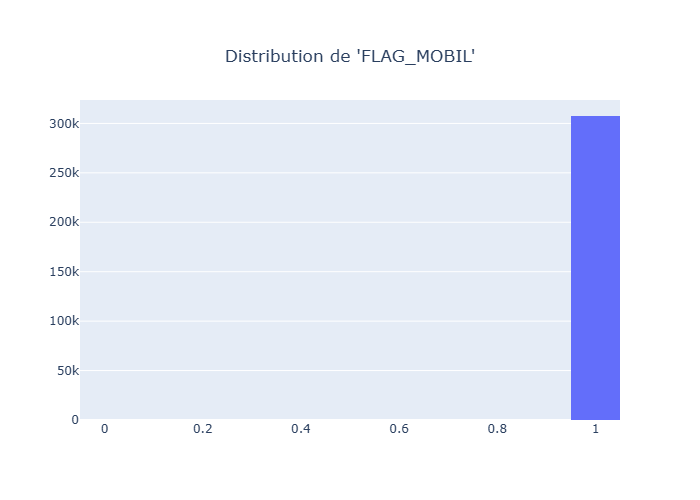

In [88]:
# Visualisation de la distribution pour la variable "FLAG_MOBIL".

fig = go.Figure(data=[go.Histogram(x=df_appli_train["FLAG_MOBIL"], nbinsx=20)])

fig.update_layout(
    title={
        'text': "Distribution de 'FLAG_MOBIL'",
        'x': 0.5,
        'xanchor': 'center',
        'yanchor': 'top'
    },
    width=700 
)

fig.show()

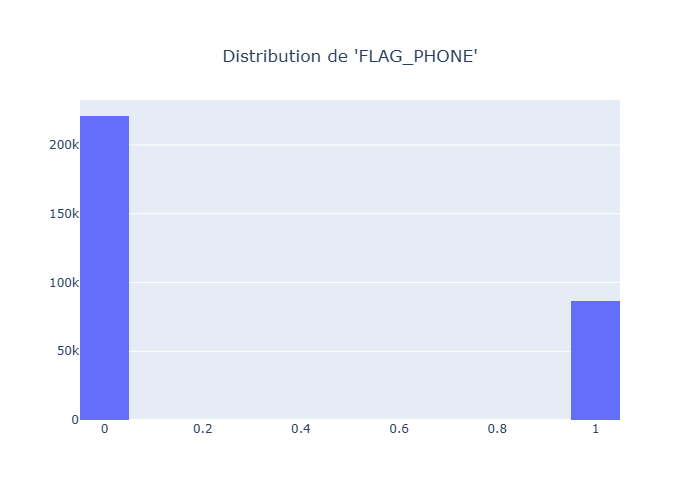

In [89]:
# Visualisation de la distribution pour la variable "FLAG_PHONE".

fig = go.Figure(data=[go.Histogram(x=df_appli_train["FLAG_PHONE"], nbinsx=20)])

fig.update_layout(
    title={
        'text': "Distribution de 'FLAG_PHONE'",
        'x': 0.5,
        'xanchor': 'center',
        'yanchor': 'top'
    },
    width=700 
)

fig.show()

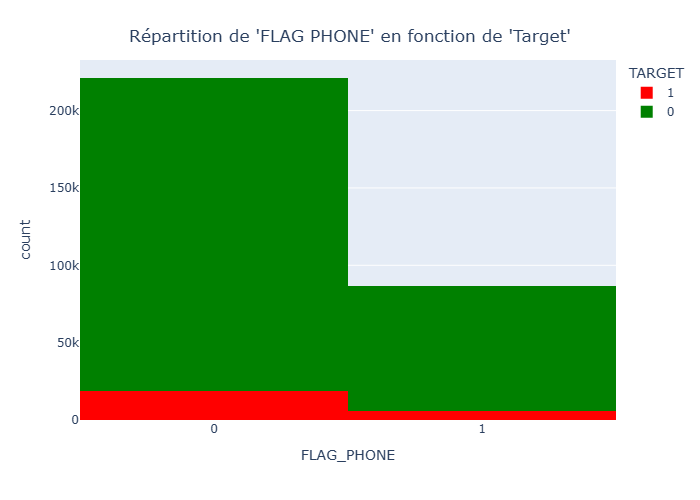

In [90]:
# Visualisation de la répartition pour la variable "FLAG_EMP_PHONE" en fonction de la Target.

fig = px.histogram(
    df_appli_train,
    x="FLAG_PHONE",
    color="TARGET",
    color_discrete_map={0: 'green', 1: 'red'}
)

fig.update_layout(
    title={
        'text': "Répartition de 'FLAG PHONE' en fonction de 'Target'",
        'x': 0.5,
        'xanchor': 'center',
        'yanchor': 'top'
    },
    width=700 
)

fig.show()

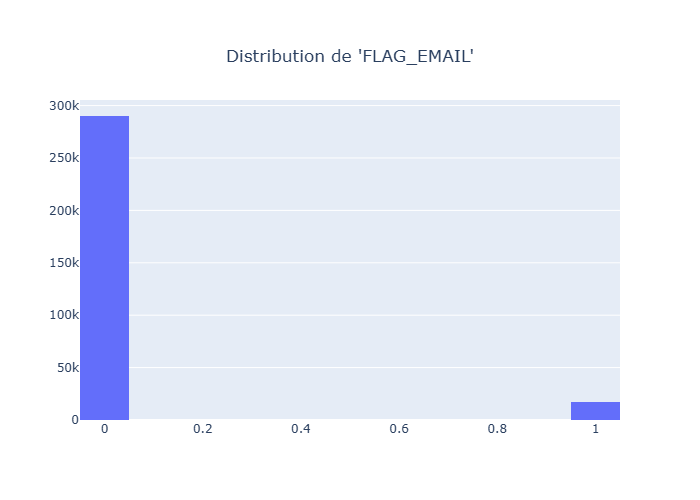

In [91]:
# Visualisation de la distribution pour la variable "FLAG_EMAIL".

fig = go.Figure(data=[go.Histogram(x=df_appli_train["FLAG_EMAIL"], nbinsx=20)])

fig.update_layout(
    title={
        'text': "Distribution de 'FLAG_EMAIL'",
        'x': 0.5,
        'xanchor': 'center',
        'yanchor': 'top'
    },
    width=700 
)

fig.show()

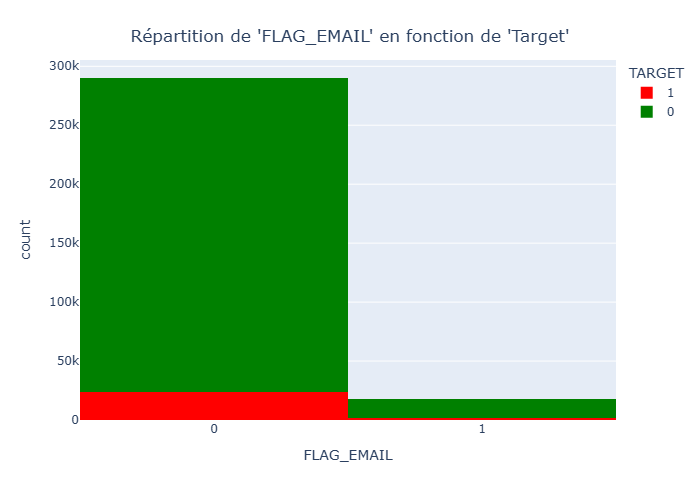

In [92]:
# Visualisation de la répartition pour la variable "FLAG_EMAIL" en fonction de la Target.

fig = px.histogram(
    df_appli_train,
    x="FLAG_EMAIL",
    color="TARGET",
    color_discrete_map={0: 'green', 1: 'red'}
)

fig.update_layout(
    title={
        'text': "Répartition de 'FLAG_EMAIL' en fonction de 'Target'",
        'x': 0.5,
        'xanchor': 'center',
        'yanchor': 'top'
    },
    width=700 
)

fig.show()

- En regardant un peu les informations liées aux différents moyens de joindre un client par téléphone, tous les clients ont fourni au minimum un numéro de téléphone (principalement un numéro mobile et un mail pour presque tous les clients).
- Cela ne semble pas impacter directement la variable "Target".

In [93]:
df_appli_train["REGION_RATING_CLIENT"].describe()

count    307511.000000
mean          2.052463
std           0.509034
min           1.000000
25%           2.000000
50%           2.000000
75%           2.000000
max           3.000000
Name: REGION_RATING_CLIENT, dtype: float64

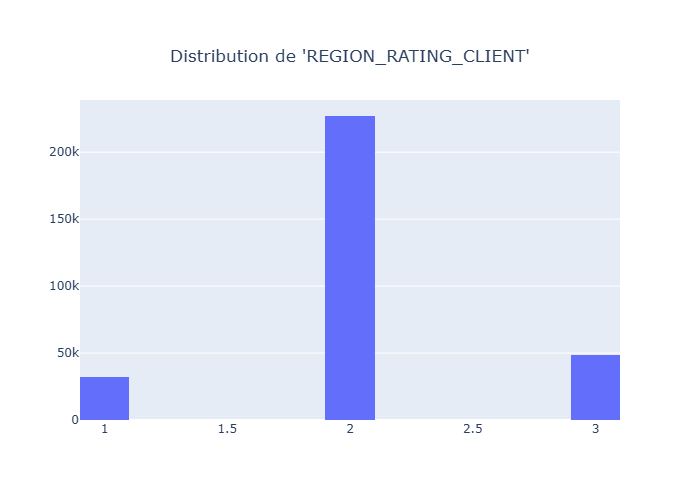

In [94]:
# Visualisation de la distribution pour la variable "REGION_RATING_CLIENT".

fig = go.Figure(data=[go.Histogram(x=df_appli_train["REGION_RATING_CLIENT"], nbinsx=20)])

fig.update_layout(
    title={
        'text': "Distribution de 'REGION_RATING_CLIENT'",
        'x': 0.5,
        'xanchor': 'center',
        'yanchor': 'top'
    },
    width=700 
)

fig.show()

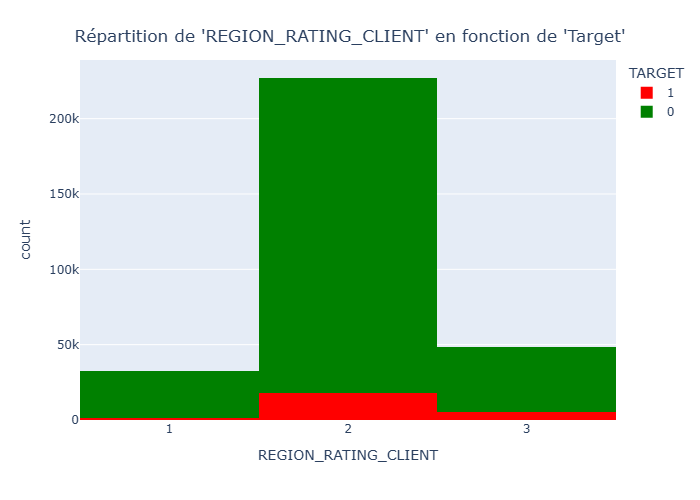

In [95]:
# Visualisation de la répartition pour la variable "REGION_RATING_CLIENT" en fonction de la Target.

fig = px.histogram(
    df_appli_train,
    x="REGION_RATING_CLIENT",
    color="TARGET",
    color_discrete_map={0: 'green', 1: 'red'}
)

fig.update_layout(
    title={
        'text': "Répartition de 'REGION_RATING_CLIENT' en fonction de 'Target'",
        'x': 0.5,
        'xanchor': 'center',
        'yanchor': 'top'
    },
    width=700 
)

fig.show()

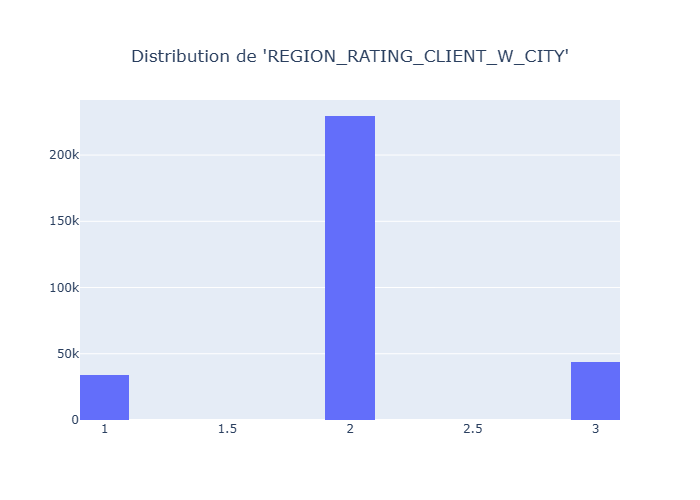

In [96]:
# Visualisation de la distribution pour la variable "REGION_RATING_CLIENT_W_CITY".

fig = go.Figure(data=[go.Histogram(x=df_appli_train["REGION_RATING_CLIENT_W_CITY"], nbinsx=20)])

fig.update_layout(
    title={
        'text': "Distribution de 'REGION_RATING_CLIENT_W_CITY'",
        'x': 0.5,
        'xanchor': 'center',
        'yanchor': 'top'
    },
    width=700 
)

fig.show()

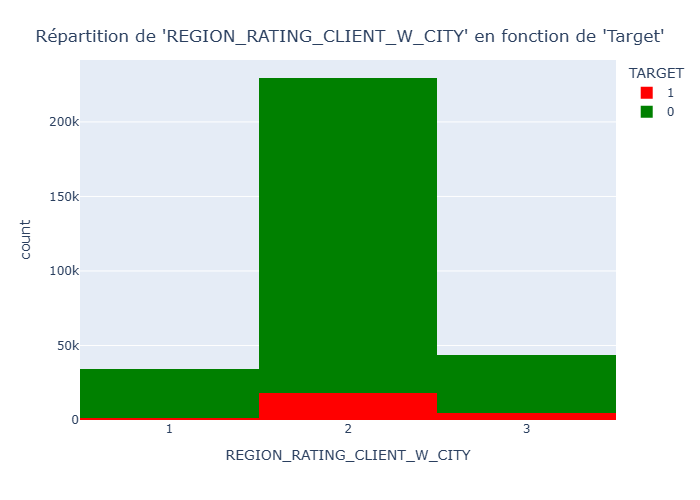

In [97]:
# Visualisation de la répartition pour la variable "REGION_RATING_CLIENT_W_CITY" en fonction de la Target.

fig = px.histogram(
    df_appli_train,
    x="REGION_RATING_CLIENT_W_CITY",
    color="TARGET",
    color_discrete_map={0: 'green', 1: 'red'}
)

fig.update_layout(
    title={
        'text': "Répartition de 'REGION_RATING_CLIENT_W_CITY' en fonction de 'Target'",
        'x': 0.5,
        'xanchor': 'center',
        'yanchor': 'top'
    },
    width=700 
)

fig.show()

- Pour ces deux variables, on a une notation des clients par l'entreprise en se basant sur leur situation géographique. Ici la notation majeur est la note 2 qui doit être la notation moyenne puisque cela va de 1 à 3.
- A mesure que la note augmente le pourcentage de défaillance semble augmenter donc il semble y avoir une correlation avec la target.

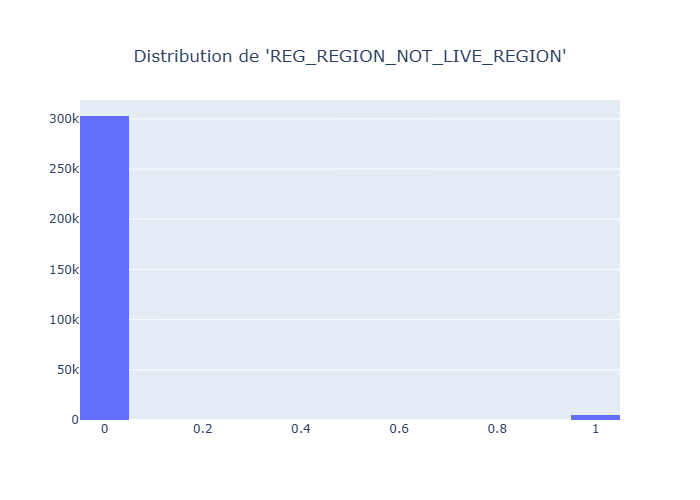

In [98]:
# Visualisation de la distribution pour la variable "REG_REGION_NOT_LIVE_REGION".

fig = go.Figure(data=[go.Histogram(x=df_appli_train["REG_REGION_NOT_LIVE_REGION"], nbinsx=20)])

fig.update_layout(
    title={
        'text': "Distribution de 'REG_REGION_NOT_LIVE_REGION'",
        'x': 0.5,
        'xanchor': 'center',
        'yanchor': 'top'
    },
    width=700 
)

fig.show()

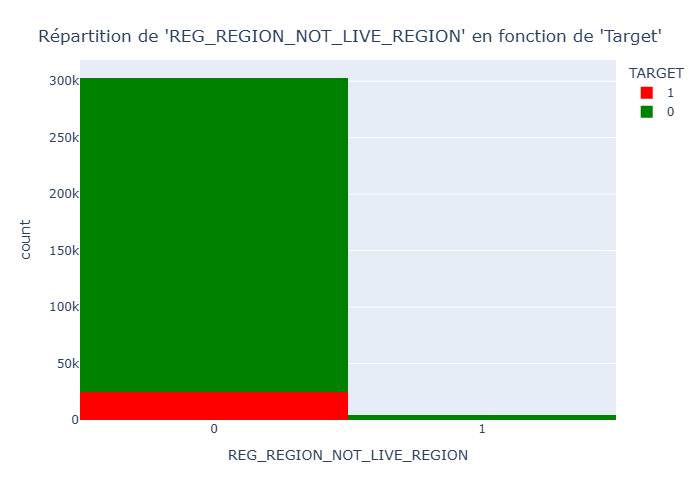

In [99]:
# Visualisation de la répartition pour la variable "REG_REGION_NOT_LIVE_REGION" en fonction de la Target.

fig = px.histogram(
    df_appli_train,
    x="REG_REGION_NOT_LIVE_REGION",
    color="TARGET",
    color_discrete_map={0: 'green', 1: 'red'}
)

fig.update_layout(
    title={
        'text': "Répartition de 'REG_REGION_NOT_LIVE_REGION' en fonction de 'Target'",
        'x': 0.5,
        'xanchor': 'center',
        'yanchor': 'top'
    },
    width=700 
)

fig.show()

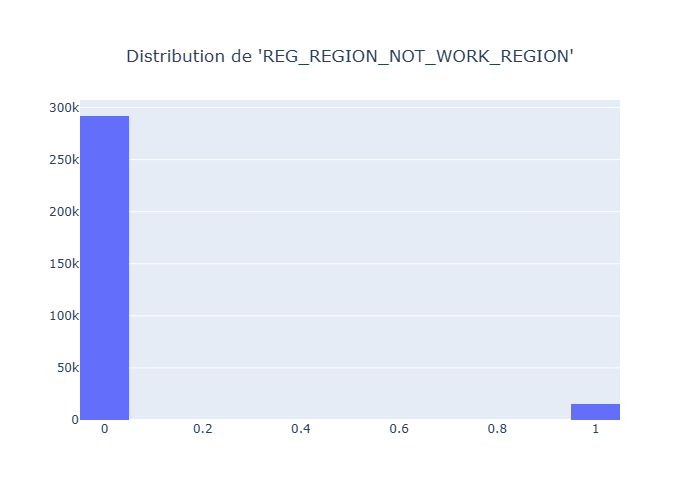

In [100]:
# Visualisation de la distribution pour la variable "REG_REGION_NOT_WORK_REGION".

fig = go.Figure(data=[go.Histogram(x=df_appli_train["REG_REGION_NOT_WORK_REGION"], nbinsx=20)])

fig.update_layout(
    title={
        'text': "Distribution de 'REG_REGION_NOT_WORK_REGION'",
        'x': 0.5,
        'xanchor': 'center',
        'yanchor': 'top'
    },
    width=700 
)

fig.show()

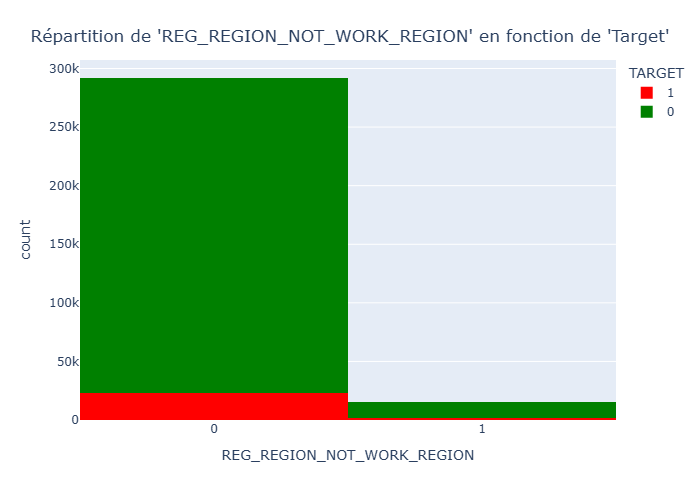

In [101]:
# Visualisation de la répartition pour la variable "REG_REGION_NOT_WORK_REGION" en fonction de la Target.

fig = px.histogram(
    df_appli_train,
    x="REG_REGION_NOT_WORK_REGION",
    color="TARGET",
    color_discrete_map={0: 'green', 1: 'red'}
)

fig.update_layout(
    title={
        'text': "Répartition de 'REG_REGION_NOT_WORK_REGION' en fonction de 'Target'",
        'x': 0.5,
        'xanchor': 'center',
        'yanchor': 'top'
    },
    width=700 
)

fig.show()

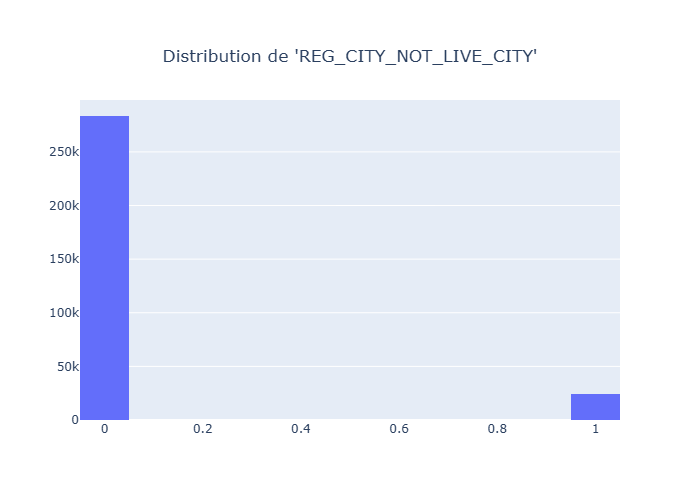

In [102]:
# Visualisation de la distribution pour la variable "REG_CITY_NOT_LIVE_CITY".

fig = go.Figure(data=[go.Histogram(x=df_appli_train["REG_CITY_NOT_LIVE_CITY"], nbinsx=20)])

fig.update_layout(
    title={
        'text': "Distribution de 'REG_CITY_NOT_LIVE_CITY'",
        'x': 0.5,
        'xanchor': 'center',
        'yanchor': 'top'
    },
    width=700 
)

fig.show()

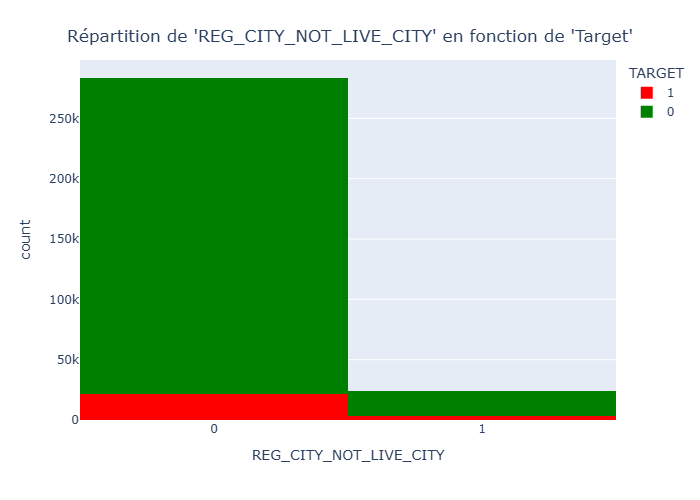

In [103]:
# Visualisation de la répartition pour la variable "REG_CITY_NOT_LIVE_CITY" en fonction de la Target.

fig = px.histogram(
    df_appli_train,
    x="REG_CITY_NOT_LIVE_CITY",
    color="TARGET",
    color_discrete_map={0: 'green', 1: 'red'}
)

fig.update_layout(
    title={
        'text': "Répartition de 'REG_CITY_NOT_LIVE_CITY' en fonction de 'Target'",
        'x': 0.5,
        'xanchor': 'center',
        'yanchor': 'top'
    },
    width=700 
)

fig.show()

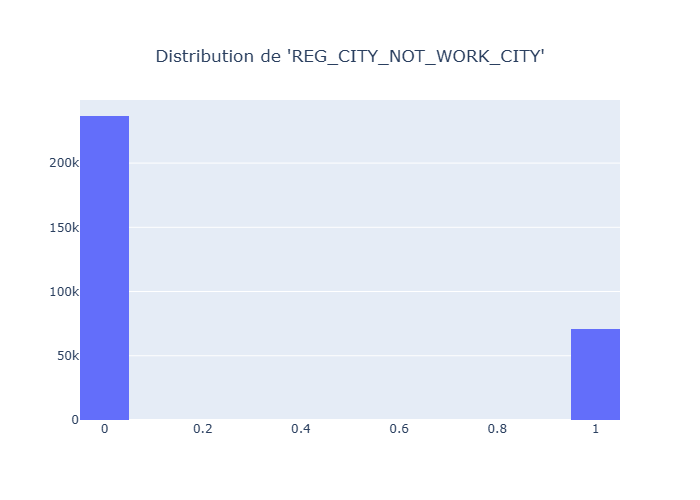

In [104]:
# Visualisation de la distribution pour la variable "REG_CITY_NOT_WORK_CITY".

fig = go.Figure(data=[go.Histogram(x=df_appli_train["REG_CITY_NOT_WORK_CITY"], nbinsx=20)])

fig.update_layout(
    title={
        'text': "Distribution de 'REG_CITY_NOT_WORK_CITY'",
        'x': 0.5,
        'xanchor': 'center',
        'yanchor': 'top'
    },
    width=700 
)

fig.show()

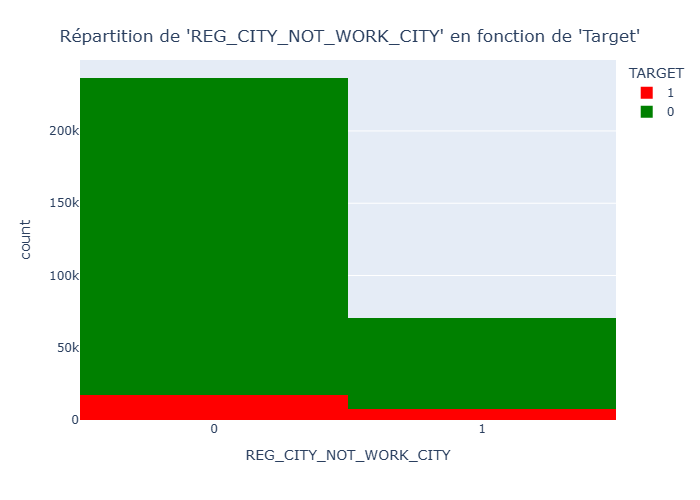

In [105]:
# Visualisation de la répartition pour la variable "REG_CITY_NOT_WORK_CITY" en fonction de la Target.

fig = px.histogram(
    df_appli_train,
    x="REG_CITY_NOT_WORK_CITY",
    color="TARGET",
    color_discrete_map={0: 'green', 1: 'red'}
)

fig.update_layout(
    title={
        'text': "Répartition de 'REG_CITY_NOT_WORK_CITY' en fonction de 'Target'",
        'x': 0.5,
        'xanchor': 'center',
        'yanchor': 'top'
    },
    width=700 
)

fig.show()

- Ici on a quelques variables qui vérifie la pertinence des informations géographiques des clients. Dans l'ensemble la majorité des informations sont correctes (même si il y a aux alentour de 10% de données erronées pour chacune de ces variable toutefois cela ne semble pas impacter la Target).

In [106]:
df_appli_train["EXT_SOURCE_1"].describe()

count    134133.000000
mean          0.502130
std           0.211062
min           0.014568
25%           0.334007
50%           0.505998
75%           0.675053
max           0.962693
Name: EXT_SOURCE_1, dtype: float64

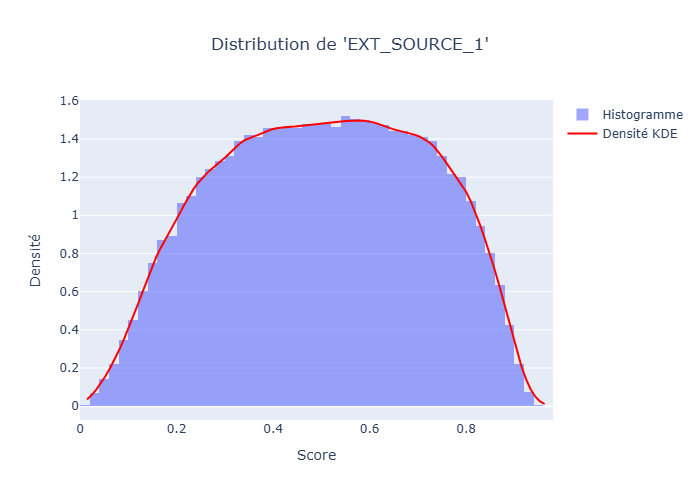

In [107]:
# Visualisation de la répartition pour la variable "EXT_SOURCE_1".

data = df_appli_train["EXT_SOURCE_1"].dropna()

# Calcul de la densité KDE
kde = gaussian_kde(data)
x_vals = np.linspace(data.min(), data.max(), 100)
y_vals = kde(x_vals)

fig = go.Figure()
fig.add_trace(go.Histogram(x=data, histnorm='probability density', nbinsx=50, name="Histogramme", opacity=0.6))

# Courbe KDE
fig.add_trace(go.Scatter(x=x_vals, y=y_vals, mode='lines', name="Densité KDE", line=dict(color='red', width=2)))

# Mise en page
fig.update_layout(
    title="Distribution de 'EXT_SOURCE_1'",
    title_x=0.5,
    xaxis_title="Score",
    yaxis_title="Densité",
    width=700
)

fig.show()

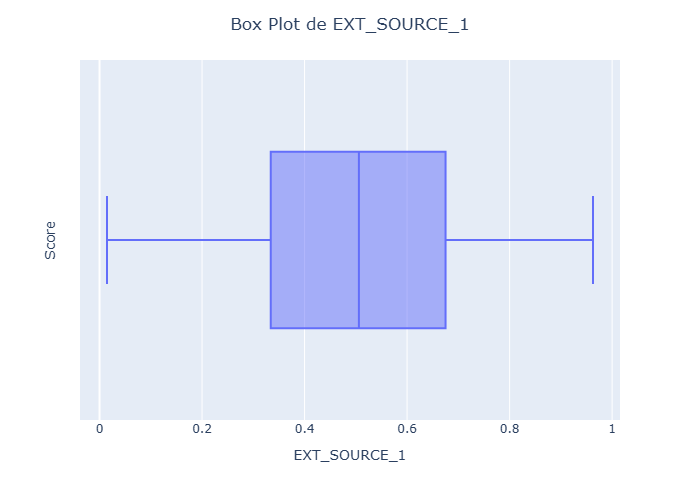

In [108]:
# Visualisation des valeurs aberrantes pour "EXT_SOURCE_1".

fig = px.box(df_appli_train, x="EXT_SOURCE_1")

fig.update_layout(
    title="Box Plot de EXT_SOURCE_1",
    title_x=0.5,
    yaxis_title="Score"
)

fig.show()

- Pas d'outliers pour cette variable

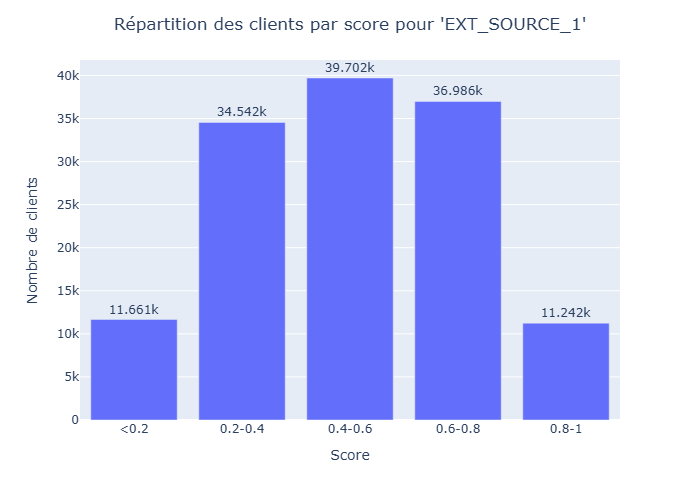

In [109]:
# Visualisation des tranches de score de la base de donnée pour plus de lisibilité.

# Définir les intervalles de revenus
bins = [0, 0.2, 0.4, 0.6, 0.8, 1]
labels = ["<0.2", "0.2-0.4", "0.4-0.6", "0.6-0.8", "0.8-1"]

# Comptage des revenus par tranche sans créer de nouvelle colonne
df_counts = pd.cut(df_appli_train["EXT_SOURCE_1"], bins=bins, labels=labels, include_lowest=True).value_counts().sort_index()

fig = px.bar(x=df_counts.index, y=df_counts.values, text_auto=True)

fig.update_traces(textposition="outside")
fig.update_layout(
    title="Répartition des clients par score pour 'EXT_SOURCE_1'",
    title_x=0.5,
    xaxis_title="Score",
    yaxis_title="Nombre de clients"
)

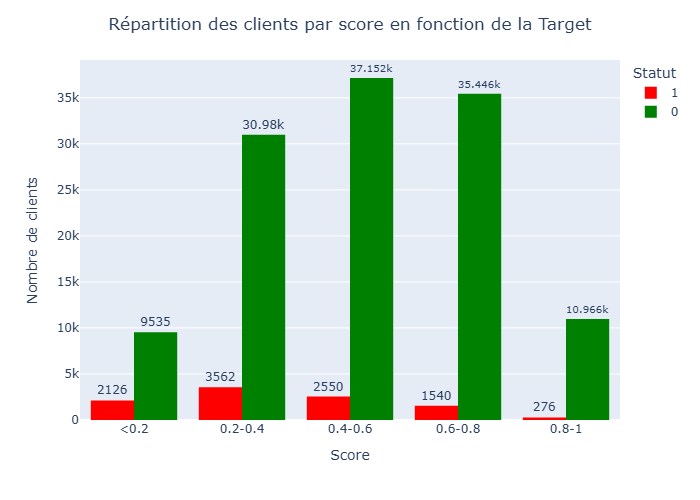

In [110]:
# Visualisation des tranches de score en mettant en évidence la Target.

# Création d'un DataFrame contenant uniquement les revenus et la target
df_score_bracket = df_appli_train[["EXT_SOURCE_1", "TARGET"]].copy()

df_score_bracket["Score_bracket"] = pd.cut(df_score_bracket["EXT_SOURCE_1"], bins=bins, labels=labels, include_lowest=True)

fig = px.histogram(df_score_bracket, x="Score_bracket", color="TARGET", color_discrete_map={0: 'green', 1: 'red'},
                   labels={"Score_bracket": "Score", "TARGET": "Statut"},
                   barmode="group", text_auto=True,
                   category_orders={"Score_bracket": ["<0.2", "0.2-0.4", "0.4-0.6", "0.6-0.8", "0.8-1"]})

# Affichage du graphique

fig.update_traces(textposition="outside")
fig.update_layout(
    title="Répartition des clients par score en fonction de la Target",
    title_x=0.5,
    xaxis_title="Score",
    yaxis_title="Nombre de clients"
)

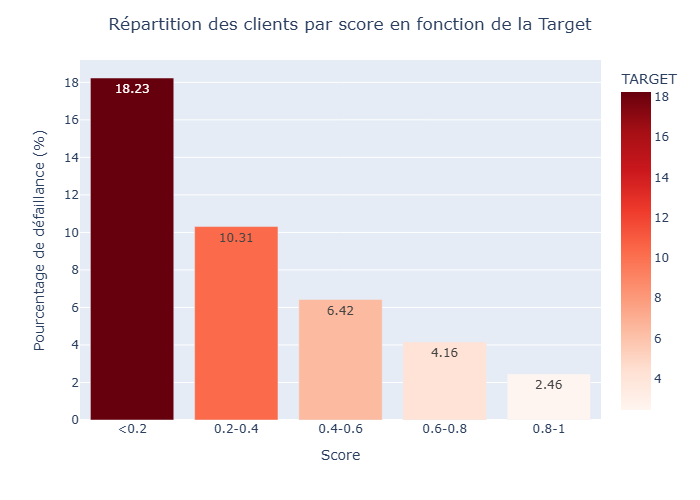

In [111]:
# Visualisation du pourcentage des individus en défaut pour chaque tranche de temps de score.

df_pourcentage = df_score_bracket.groupby("Score_bracket")["TARGET"].mean().reset_index()
df_pourcentage["TARGET"] *= 100

fig = px.bar(df_pourcentage, 
             x="Score_bracket", 
             y="TARGET", 
             text=df_pourcentage["TARGET"].round(2),
             color="TARGET", 
             color_continuous_scale="Reds",
             category_orders={"Score_bracket": ["<0.2", "0.2-0.4", "0.4-0.6", "0.6-0.8", "0.8-1"]}
)

fig.update_layout(
    title="Répartition des clients par score en fonction de la Target",
    title_x=0.5,
    xaxis_title="Score",
    yaxis_title="Pourcentage de défaillance (%)"
)

- Pour cette variable qui donne un premier score normalisé d'une source de donnée externe, on constate que il y a une corrélation négative évidente entre ce score et la Target en effet, lorsque l'on regarde les effectifs des clients pour chaque tranche de score, celle représentant un score inférieur à **0.2** est la plus faible (**11 660 clients**) pourtant on atteint presque **20 %** de défaut alors qu'entre **0.4** et **0.8** on a des effectifs bien plus important et pourtant un taux de défaillance qui ne fait que diminuer (aux alentour de **30000 clients** avec des taux allant de **10 % à 4 %**)

In [112]:
df_appli_train["EXT_SOURCE_2"].describe()

count    3.068510e+05
mean     5.143927e-01
std      1.910602e-01
min      8.173617e-08
25%      3.924574e-01
50%      5.659614e-01
75%      6.636171e-01
max      8.549997e-01
Name: EXT_SOURCE_2, dtype: float64

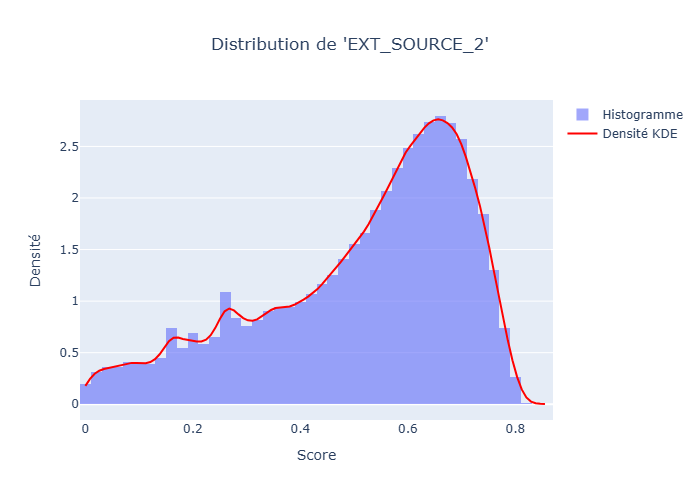

In [113]:
# Visualisation de la répartition pour la variable "EXT_SOURCE_2".

data = df_appli_train["EXT_SOURCE_2"].dropna()

# Calcul de la densité KDE
kde = gaussian_kde(data)
x_vals = np.linspace(data.min(), data.max(), 100)
y_vals = kde(x_vals)

fig = go.Figure()
fig.add_trace(go.Histogram(x=data, histnorm='probability density', nbinsx=50, name="Histogramme", opacity=0.6))

# Courbe KDE
fig.add_trace(go.Scatter(x=x_vals, y=y_vals, mode='lines', name="Densité KDE", line=dict(color='red', width=2)))

# Mise en page
fig.update_layout(
    title="Distribution de 'EXT_SOURCE_2'",
    title_x=0.5,
    xaxis_title="Score",
    yaxis_title="Densité",
    width=700
)

fig.show()

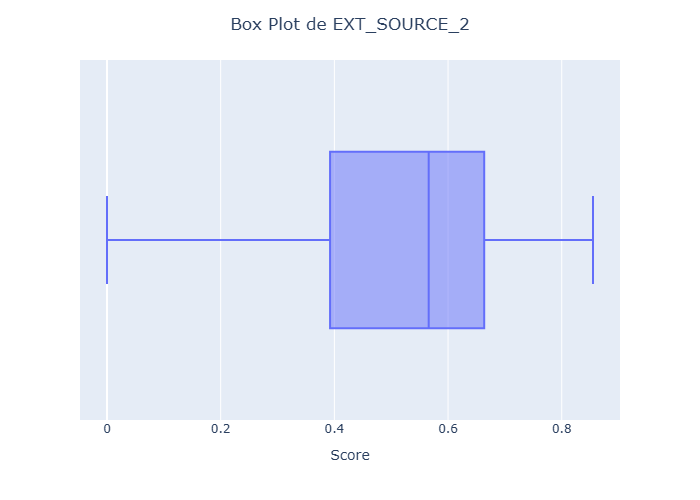

In [114]:
# Visualisation des valeurs aberrantes pour "EXT_SOURCE_2".

fig = px.box(df_appli_train, x="EXT_SOURCE_2")

fig.update_layout(
    title="Box Plot de EXT_SOURCE_2",
    title_x=0.5,
    xaxis_title="Score"
)

fig.show()

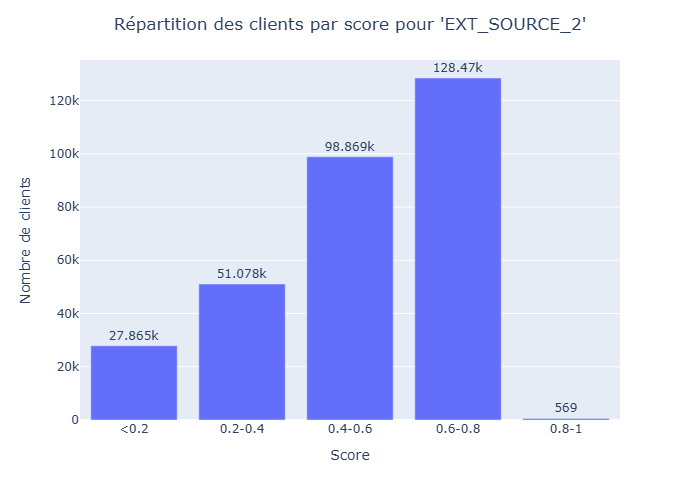

In [115]:
# Visualisation des tranches de score de la base de donnée pour plus de lisibilité.

# Définir les intervalles de revenus
bins = [0, 0.2, 0.4, 0.6, 0.8, 1]
labels = ["<0.2", "0.2-0.4", "0.4-0.6", "0.6-0.8", "0.8-1"]

# Comptage des revenus par tranche sans créer de nouvelle colonne
df_counts = pd.cut(df_appli_train["EXT_SOURCE_2"], bins=bins, labels=labels, include_lowest=True).value_counts().sort_index()

fig = px.bar(x=df_counts.index, y=df_counts.values, text_auto=True)

fig.update_traces(textposition="outside")
fig.update_layout(
    title="Répartition des clients par score pour 'EXT_SOURCE_2'",
    title_x=0.5,
    xaxis_title="Score",
    yaxis_title="Nombre de clients"
)

- Distribution différente de celle pour EXT_SOURCE_1 qui est plus concentré au niveau des scores 0.6 à 0.8

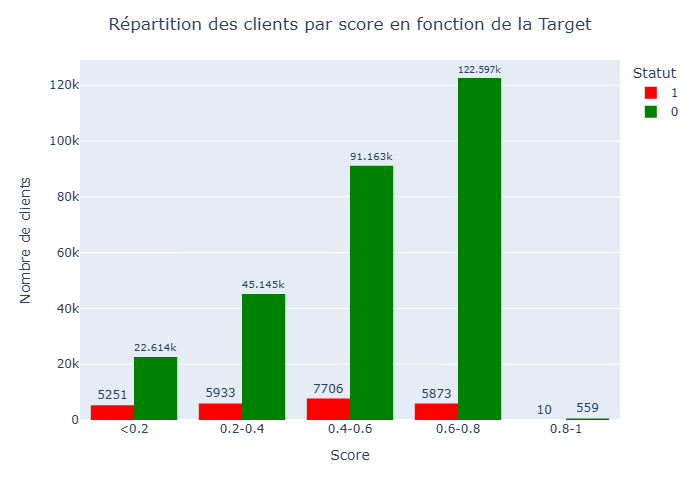

In [116]:
# Visualisation des tranches de score en mettant en évidence la Target.

# Création d'un DataFrame contenant uniquement les revenus et la target
df_score_bracket = df_appli_train[["EXT_SOURCE_2", "TARGET"]].copy()

df_score_bracket["Score_bracket"] = pd.cut(df_score_bracket["EXT_SOURCE_2"], bins=bins, labels=labels, include_lowest=True)

fig = px.histogram(df_score_bracket, x="Score_bracket", color="TARGET", color_discrete_map={0: 'green', 1: 'red'},
                   labels={"Score_bracket": "Score", "TARGET": "Statut"},
                   barmode="group", text_auto=True,
                   category_orders={"Score_bracket": ["<0.2", "0.2-0.4", "0.4-0.6", "0.6-0.8", "0.8-1"]})

# Affichage du graphique

fig.update_traces(textposition="outside")
fig.update_layout(
    title="Répartition des clients par score en fonction de la Target",
    title_x=0.5,
    xaxis_title="Score",
    yaxis_title="Nombre de clients"
)

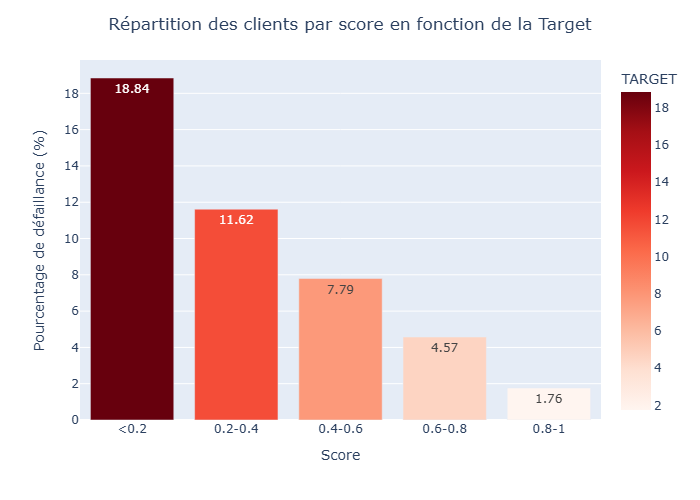

In [117]:
# Visualisation du pourcentage des individus en défaut pour chaque tranche de score.

df_pourcentage = df_score_bracket.groupby("Score_bracket")["TARGET"].mean().reset_index()
df_pourcentage["TARGET"] *= 100

fig = px.bar(df_pourcentage, 
             x="Score_bracket", 
             y="TARGET", 
             text=df_pourcentage["TARGET"].round(2),
             color="TARGET", 
             color_continuous_scale="Reds",
             category_orders={"Score_bracket": ["<0.2", "0.2-0.4", "0.4-0.6", "0.6-0.8", "0.8-1"]}
)

fig.update_layout(
    title="Répartition des clients par score en fonction de la Target",
    title_x=0.5,
    xaxis_title="Score",
    yaxis_title="Pourcentage de défaillance (%)"
)

- Même constat que pour la variable "EXT_SOURCE_1".

In [118]:
df_appli_train["EXT_SOURCE_3"].describe()

count    246546.000000
mean          0.510853
std           0.194844
min           0.000527
25%           0.370650
50%           0.535276
75%           0.669057
max           0.896010
Name: EXT_SOURCE_3, dtype: float64

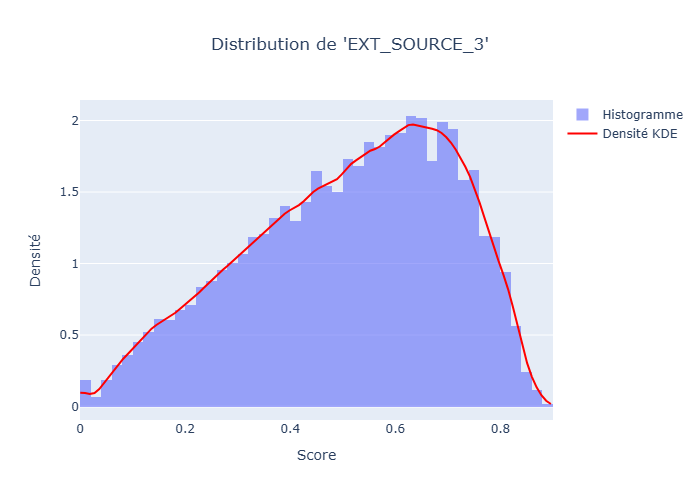

In [119]:
# Visualisation de la répartition pour la variable "EXT_SOURCE_3".

data = df_appli_train["EXT_SOURCE_3"].dropna()

# Calcul de la densité KDE
kde = gaussian_kde(data)
x_vals = np.linspace(data.min(), data.max(), 100)
y_vals = kde(x_vals)

fig = go.Figure()
fig.add_trace(go.Histogram(x=data, histnorm='probability density', nbinsx=50, name="Histogramme", opacity=0.6))

# Courbe KDE
fig.add_trace(go.Scatter(x=x_vals, y=y_vals, mode='lines', name="Densité KDE", line=dict(color='red', width=2)))

# Mise en page
fig.update_layout(
    title="Distribution de 'EXT_SOURCE_3'",
    title_x=0.5,
    xaxis_title="Score",
    yaxis_title="Densité",
    width=700
)

fig.show()

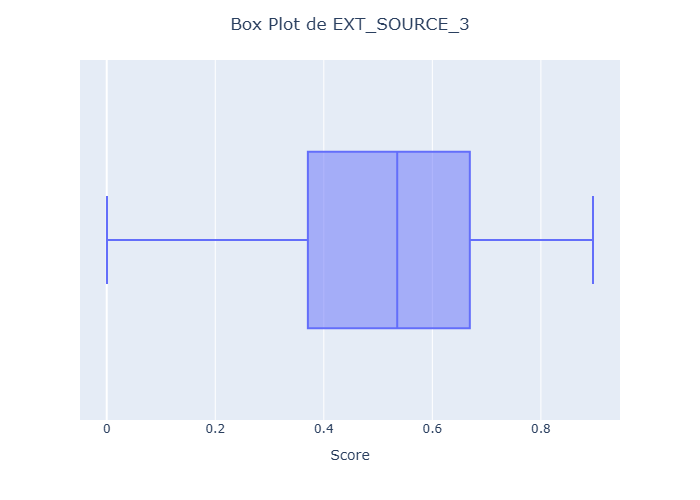

In [120]:
# Visualisation des valeurs aberrantes pour "EXT_SOURCE_3".

fig = px.box(df_appli_train, x="EXT_SOURCE_3")

fig.update_layout(
    title="Box Plot de EXT_SOURCE_3",
    title_x=0.5,
    xaxis_title="Score"
)

fig.show()

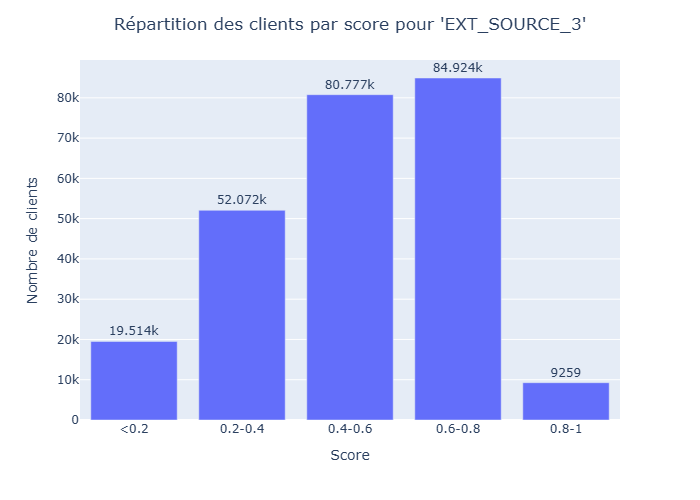

In [121]:
# Visualisation des tranches de score de la base de donnée pour plus de lisibilité.

# Définir les intervalles de revenus
bins = [0, 0.2, 0.4, 0.6, 0.8, 1]
labels = ["<0.2", "0.2-0.4", "0.4-0.6", "0.6-0.8", "0.8-1"]

# Comptage des revenus par tranche sans créer de nouvelle colonne
df_counts = pd.cut(df_appli_train["EXT_SOURCE_3"], bins=bins, labels=labels, include_lowest=True).value_counts().sort_index()

fig = px.bar(x=df_counts.index, y=df_counts.values, text_auto=True)

fig.update_traces(textposition="outside")
fig.update_layout(
    title="Répartition des clients par score pour 'EXT_SOURCE_3'",
    title_x=0.5,
    xaxis_title="Score",
    yaxis_title="Nombre de clients"
)

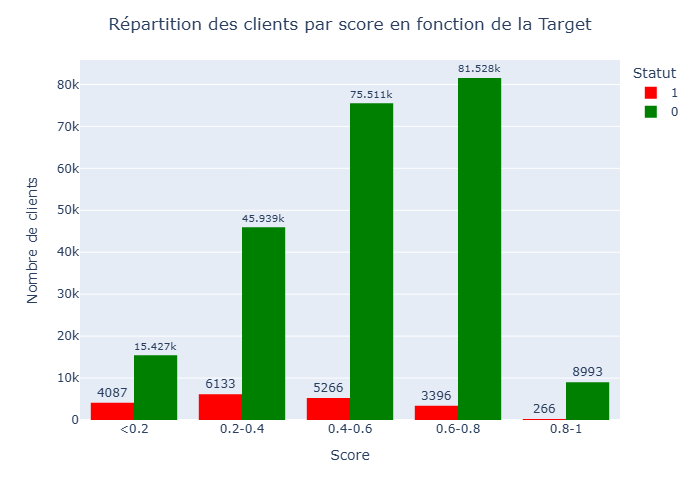

In [122]:
# Visualisation des tranches de score en mettant en évidence la Target.

# Création d'un DataFrame contenant uniquement les revenus et la target
df_score_bracket = df_appli_train[["EXT_SOURCE_3", "TARGET"]].copy()

df_score_bracket["Score_bracket"] = pd.cut(df_score_bracket["EXT_SOURCE_3"], bins=bins, labels=labels, include_lowest=True)

fig = px.histogram(df_score_bracket, x="Score_bracket", color="TARGET", color_discrete_map={0: 'green', 1: 'red'},
                   labels={"Score_bracket": "Score", "TARGET": "Statut"},
                   barmode="group", text_auto=True,
                   category_orders={"Score_bracket": ["<0.2", "0.2-0.4", "0.4-0.6", "0.6-0.8", "0.8-1"]})

# Affichage du graphique

fig.update_traces(textposition="outside")
fig.update_layout(
    title="Répartition des clients par score en fonction de la Target",
    title_x=0.5,
    xaxis_title="Score",
    yaxis_title="Nombre de clients"
)

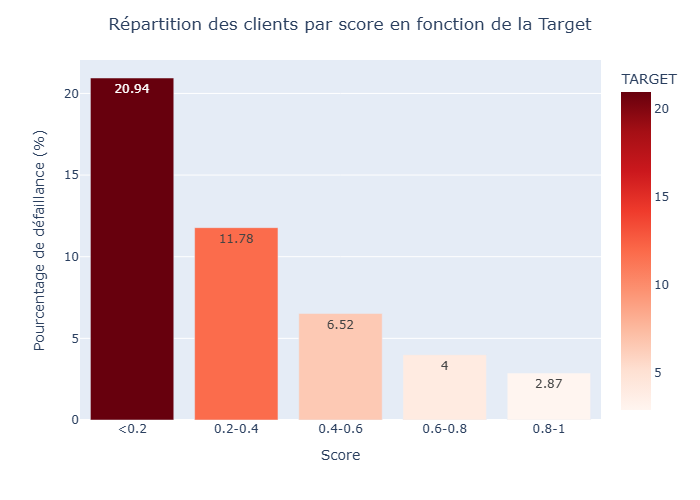

In [123]:
# Visualisation du pourcentage des individus en défaut pour chaque tranche de score.

df_pourcentage = df_score_bracket.groupby("Score_bracket")["TARGET"].mean().reset_index()
df_pourcentage["TARGET"] *= 100

fig = px.bar(df_pourcentage, 
             x="Score_bracket", 
             y="TARGET", 
             text=df_pourcentage["TARGET"].round(2),
             color="TARGET", 
             color_continuous_scale="Reds",
             category_orders={"Score_bracket": ["<0.2", "0.2-0.4", "0.4-0.6", "0.6-0.8", "0.8-1"]}
)

fig.update_layout(
    title="Répartition des clients par score en fonction de la Target",
    title_x=0.5,
    xaxis_title="Score",
    yaxis_title="Pourcentage de défaillance (%)"
)

- Avec cette derniére variable portant sur un troisième score d'une source de donnée externe, on peut dire que ces trois variables sont corrélées négativement à la variable "Target" et seront sans doute intéressante à utiliser pour la modélisation.
- Il reste encore beaucoup de variable dans ce fichier mais la plupart sont des information spécifiques aux clients sur leur habitations notamment (MODE, MOYENNE et MEDIANE sur les différentes mesures des habitations) ou encore des informations liées aux documents fournis par les clients.
- On passera donc à une vue d'ensemble des corrélations entre nos différentes variables.

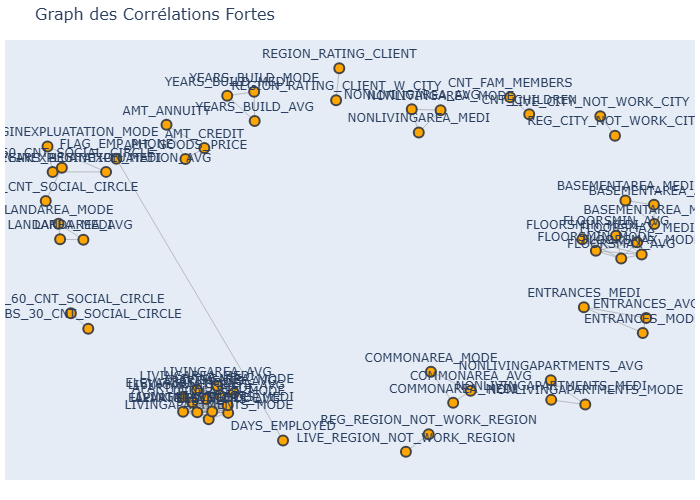

In [124]:
# Calcul de la matrice de corrélation
corr_matrix = df_appli_train.corr()

# Seuil de corrélation
threshold = 0.7

# Création du graphe NetworkX
G = nx.Graph()

# Ajout des arêtes selon le seuil
for i in corr_matrix.columns:
    for j in corr_matrix.columns:
        if i != j and abs(corr_matrix.loc[i, j]) >= threshold:
            G.add_edge(i, j, weight=corr_matrix.loc[i, j])

# Positionnement des nœuds (disposition circulaire ou spring layout)
pos = nx.spring_layout(G, k=0.3)

# Préparation des données pour Plotly
edge_x = []
edge_y = []
for edge in G.edges():
    x0, y0 = pos[edge[0]]
    x1, y1 = pos[edge[1]]
    edge_x.extend([x0, x1, None])
    edge_y.extend([y0, y1, None])

# Dessin des arêtes
edge_trace = go.Scatter(
    x=edge_x, y=edge_y,
    line=dict(width=0.5, color='#888'),
    hoverinfo='none',
    mode='lines')

# Dessin des nœuds
node_x = []
node_y = []
node_text = []

for node in G.nodes():
    x, y = pos[node]
    node_x.append(x)
    node_y.append(y)
    node_text.append(node)

node_trace = go.Scatter(
    x=node_x, y=node_y,
    mode='markers+text',
    text=node_text,
    textposition="top center",
    hoverinfo='text',
    marker=dict(
        showscale=False,
        color='#FFA500',
        size=10,
        line_width=2))

# Affichage avec Plotly
fig = go.Figure(data=[edge_trace, node_trace],
                layout=go.Layout(
                    title=dict(
                        text='Graph des Corrélations Fortes',
                        font=dict(size=16)
                    ),
                    showlegend=False,
                    hovermode='closest',
                    margin=dict(b=20, l=5, r=5, t=40),
                    xaxis=dict(showgrid=False, zeroline=False, showticklabels=False),
                    yaxis=dict(showgrid=False, zeroline=False, showticklabels=False)
                ))

fig.show()

- Ce graphique permet d'avoir une première idée des différents liens entre les variables de ce fichier.
- Ce graphe de réseau (network graph) représente les relations fortes entre les variables du jeu de données. Chaque nœud correspond à une variable, et chaque lien (arête) relie deux variables dont la corrélation absolue dépasse un certain seuil (ici |corr| > 0.7). Plus deux variables sont fortement corrélées, plus elles ont de chances d’être reliées.

In [125]:
# Matrice de corrélation et masque pour ne garder que les plus grandes corrélations pour tout le jeu de donnée.

corr_matrix = df_appli_train.corr()

# Seuil de corrélation
threshold = 0.6
strong_corr = corr_matrix[(corr_matrix.abs() > threshold) & (corr_matrix != 1)]

# On garde les variables qui ont au moins une forte corrélation
filtered_corr = strong_corr.dropna(how='all', axis=0).dropna(how='all', axis=1)

In [126]:
# On masque les valeurs en-dessous du seuil et les 1 (diagonale)
mask = (corr_matrix.abs() > threshold) & (corr_matrix != 1)

# Extraction des paires fortement corrélées
strong_corr_pairs = corr_matrix[mask].stack().reset_index()
strong_corr_pairs.columns = ['Variable 1', 'Variable 2', 'Corrélation']

# Créer une colonne avec le nom des deux variables ensemble
strong_corr_pairs['Variables corrélées'] = strong_corr_pairs['Variable 1'] + ' / ' + strong_corr_pairs['Variable 2']

# On garde uniquement les colonnes voulues
strong_corr_df = strong_corr_pairs[['Variables corrélées', 'Corrélation']]

# On supprime les doublons (ex: A/B et B/A) en triant les noms
strong_corr_df['Sorted Pair'] = strong_corr_pairs.apply(lambda row: ' / '.join(sorted([row['Variable 1'], row['Variable 2']])), axis=1)
strong_corr_df = strong_corr_df.drop_duplicates(subset='Sorted Pair').drop(columns='Sorted Pair')

# Trier par ordre décroissant de la corrélation
strong_corr_df = strong_corr_df.sort_values(by='Corrélation', ascending=False).reset_index(drop=True)

# Affichage du résultat
pd.set_option('display.max_rows', None)

strong_corr_df_styled = strong_corr_df.style.background_gradient(
    subset=['Corrélation'],
    cmap='coolwarm',
    vmin=-1, vmax=1
)
strong_corr_df_styled

C:\Users\Caomghin\AppData\Local\Temp/ipykernel_26564/415832284.py:15: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



,Variables corrélées,Corrélation
0,YEARS_BUILD_AVG / YEARS_BUILD_MEDI,0.998495
1,OBS_30_CNT_SOCIAL_CIRCLE / OBS_60_CNT_SOCIAL_CIRCLE,0.998490
2,FLOORSMIN_AVG / FLOORSMIN_MEDI,0.997241
3,FLOORSMAX_AVG / FLOORSMAX_MEDI,0.997034
4,ENTRANCES_AVG / ENTRANCES_MEDI,0.996886
5,ELEVATORS_AVG / ELEVATORS_MEDI,0.996099
6,COMMONAREA_AVG / COMMONAREA_MEDI,0.995978
7,LIVINGAREA_AVG / LIVINGAREA_MEDI,0.995596
8,APARTMENTS_AVG / APARTMENTS_MEDI,0.995081
9,BASEMENTAREA_AVG / BASEMENTAREA_MEDI,0.994317


In [127]:
pd.reset_option('display.max_rows')

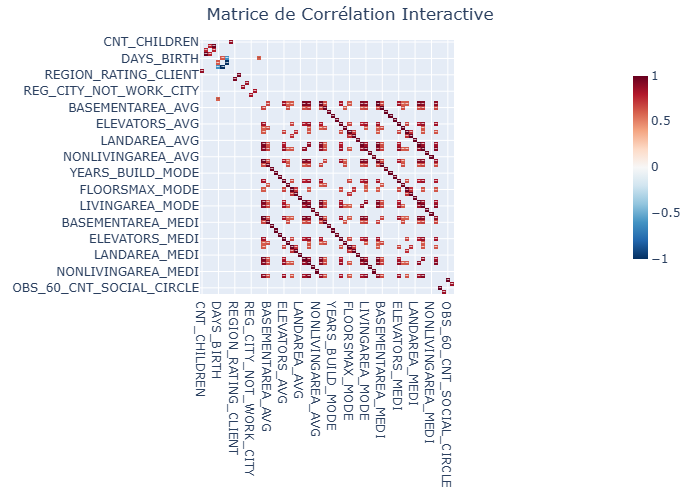

In [128]:
# Visualisation de la matrice de corrélation pour les variables les plus corrélées (+ 0.6)

fig = px.imshow(
    filtered_corr,
    text_auto=".2f",
    color_continuous_scale='RdBu_r',
    zmin=-1,
    zmax=1
)

fig.update_layout(
    title="Matrice de Corrélation Interactive",
    title_x=0.5,
    width=1750,
    height=1750,
    margin=dict(l=20, r=20, t=40, b=20)
)

fig.update_coloraxes(colorbar=dict(thickness=15, x=1.02, len=0.8))
fig.show()

In [129]:
# Affichage de la matrice de corrélation sous forme de heatmap (matplotlib)
fig = plt.figure(figsize=(36,36), dpi = 300)
sns.heatmap(filtered_corr, annot=True, cmap='coolwarm')
plt.title('Matrice de Corrélation')
plt.show()

- Globalement dans l'ensemble, on constate qu'il y a pas mal de fortes corrélations positives et très peu négatives.
- La grande majorité des corrélations concernent les caractéristiques des logements ou des lieux de vie des clients de la base de données sans grande surprise.
- On peut aussi se concentrer sur les corrélation entre la variable cible et les autres variables quantitatives de ce jeu de donnée.

In [130]:
strong_corr_target = df_appli_train.corr()['TARGET'].drop('TARGET')

In [131]:
corr_matrix_target = strong_corr_target.to_frame(name='Corrélation en fonction de la target').sort_values(by='Corrélation en fonction de la target', ascending=False)
corr_matrix_target

,Corrélation en fonction de la target
REGION_RATING_CLIENT_W_CITY,0.060893
REGION_RATING_CLIENT,0.058899
DAYS_LAST_PHONE_CHANGE,0.055218
DAYS_ID_PUBLISH,0.051457
REG_CITY_NOT_WORK_CITY,0.050994
...,...
DAYS_EMPLOYED,-0.047046
DAYS_BIRTH,-0.078239
EXT_SOURCE_1,-0.155317
EXT_SOURCE_2,-0.160472


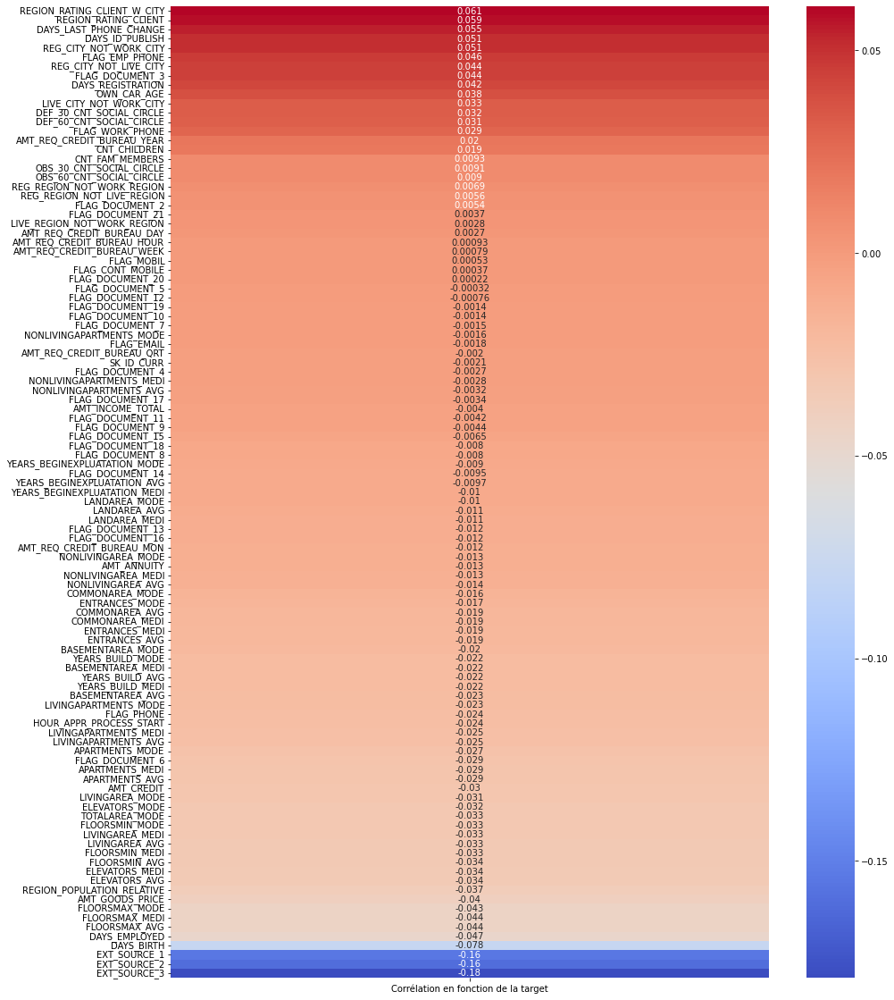

In [132]:
# Visualisation de la matrice de corrélation des variables quantitative par rapport à la Target.

plt.figure(figsize=(15,20))
sns.heatmap(corr_matrix_target, annot=True, cmap='coolwarm')
plt.show()

- Dans l'ensemble la variable cible est assez peu corrélé à l'ensemble des variables quantitatives de ce premier jeu de donnée puisque pour les variables positivement corrélées, la relation la plus importante est de 0.06 pour la variable ***"REGION_RATING_CLIENT_W_CITY"*** ce qui est très faible et à l'inverse pour les corrélations négatives, on atteint les -0.18 pour la variable ***"EXT_SOURCE_3"*** ce qui est plus significatif et peut être intéressant à prendre en compte.
- Ensuite on peut s'intéresser aux corrélations entre les variables qualitatives pour cela, on utilise ici le coefficient Phi-K qui peut être utilisé avec une paire de caractéristiques catégorielles pour vérifier l’association entre deux variables. Sa valeur est comprise entre 0 (pas de relation) et 1 (relation parfaite).

In [133]:
# Mise en place de fonctions permettant la création d'une matrice de corrélation (coefficient Phi-K )

def cramers_v(x, y):
    confusion_matrix = pd.crosstab(x, y)
    chi2 = chi2_contingency(confusion_matrix)[0]
    n = confusion_matrix.sum().sum()
    phi2 = chi2 / n
    r, k = confusion_matrix.shape
    # Bias correction (optional)
    phi2corr = max(0, phi2 - ((k-1)*(r-1))/(n-1))
    rcorr = r - ((r-1)**2)/(n-1)
    kcorr = k - ((k-1)**2)/(n-1)
    return np.sqrt(phi2corr / min((kcorr-1), (rcorr-1)))

def cramers_v_matrix(df, include_target=False, target_col='TARGET'):
    df_copy = df.copy()
    
    if include_target:
        # S'assurer que la target est bien considérée comme une variable catégorielle
        df_copy[target_col] = df_copy[target_col].astype(str)  # ou 'category'
        categorical_cols = df_copy.select_dtypes(include=['object', 'category']).columns
    else:
        categorical_cols = df_copy.select_dtypes(include=['object', 'category']).columns
        categorical_cols = categorical_cols.drop(target_col, errors='ignore')

    matrix = pd.DataFrame(index=categorical_cols, columns=categorical_cols, dtype=float)

    for col1 in categorical_cols:
        for col2 in categorical_cols:
            matrix.loc[col1, col2] = cramers_v(df_copy[col1], df_copy[col2])

    return matrix


In [134]:
# Création de la matrice de corréaltion de variables catégorielles.

cramer_matrix = cramers_v_matrix(df_appli_train, include_target=False)

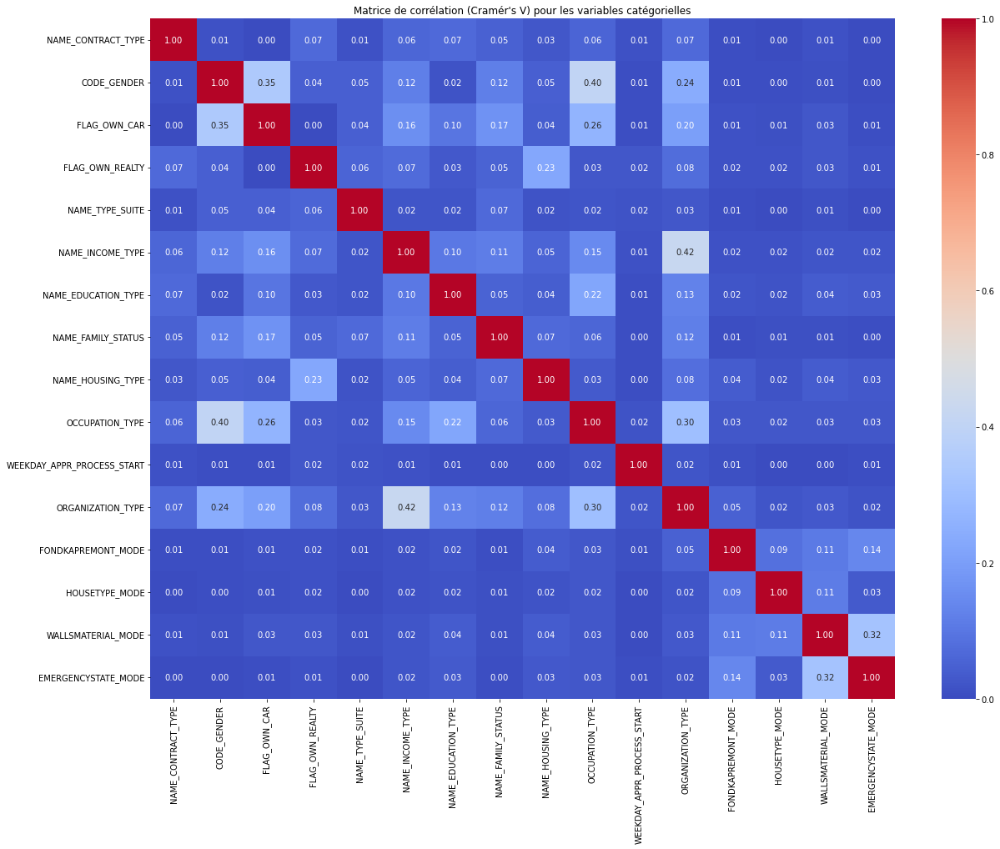

In [135]:
# Visualisation de la matrice de corrélation des variables qualitatives.

plt.figure(figsize=(20,15))
sns.heatmap(cramer_matrix, annot=True, fmt=".2f", cmap="coolwarm")
plt.title("Matrice de corrélation (Cramér's V) pour les variables catégorielles")
plt.show()

- Pas de grande corrélation entre les différentes variables puisque l'on ne dépasse pas les 0.50 que ce soit positivement ou négativement.
- Il est intéressant de réaliser le même travail en incluant la variable cible afin de voir si on a peut être des variables corrélées à celle-ci.

In [136]:
# Inclure TARGET dans la matrice
cramer_matrix = cramers_v_matrix(df_appli_train, include_target=True, target_col='TARGET')

# Extraire la ligne/colonne de TARGET
target_corr = cramer_matrix['TARGET'].drop('TARGET').sort_values(ascending=False)

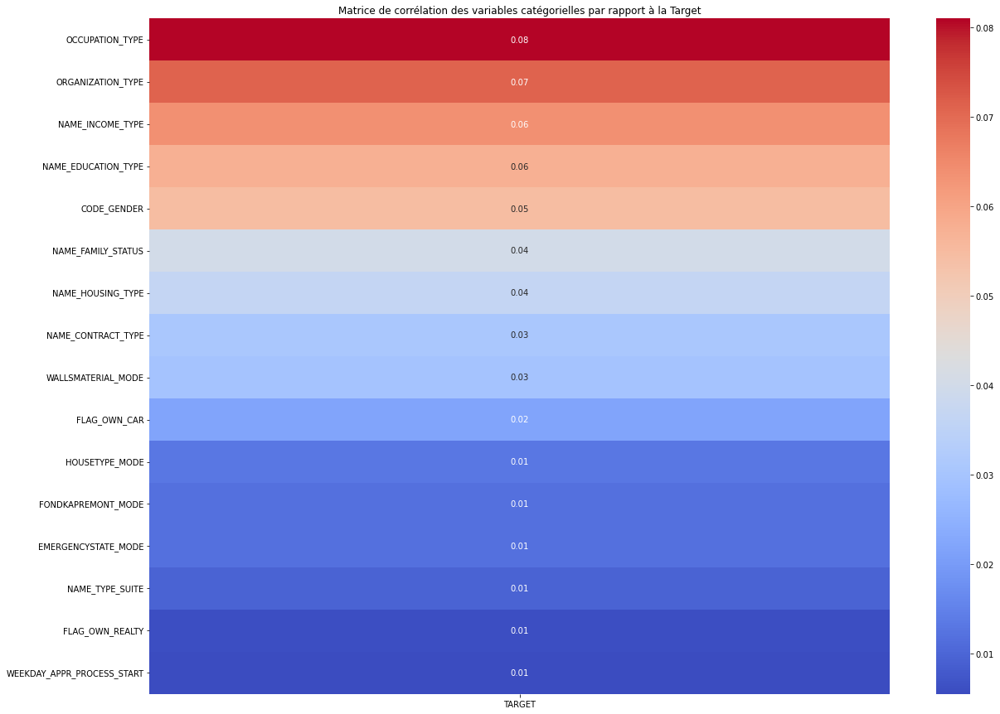

In [137]:
# Visualisation de la matrice de corrélation des variables qualitatives par rapport à la Target.

plt.figure(figsize=(20,15))
sns.heatmap(target_corr.to_frame(), annot=True, fmt=".2f", cmap="coolwarm")
plt.title("Matrice de corrélation des variables catégorielles par rapport à la Target")
plt.show()

- Pour les variables catégorielles, seules les relation positives sont à peine plus importante avec ***"OCCUPATION_TYPE"*** qui atteint par exemple les 0.08 mais c'est à peine supérieur aux relations précédentes.
- On ne fera pas ce même travail sur **application_test** car c'est le même fichier avec des individus différents afin de pouvoir tester le travail de modélisation plus tard.
- On peut maintenant s'intéresser au prochain jeu de donnée **bureau.csv**

#### Dataframe "Bureau"

In [138]:
# Importation du fichier qui s'intitule "bureau.csv".

df_bureau = pd.read_csv(r"C:\Users\Caomghin\Desktop\Implementer_un_modele_de_scoring\Donnee_kaggle\bureau.csv")

In [139]:
# Forme du dataframe "bureau".

df_bureau.shape

(1716428, 17)

In [140]:
# Visualisation du dataframe.

df_bureau

,SK_ID_CURR,SK_ID_BUREAU,CREDIT_ACTIVE,CREDIT_CURRENCY,DAYS_CREDIT,CREDIT_DAY_OVERDUE,DAYS_CREDIT_ENDDATE,DAYS_ENDDATE_FACT,AMT_CREDIT_MAX_OVERDUE,CNT_CREDIT_PROLONG,AMT_CREDIT_SUM,AMT_CREDIT_SUM_DEBT,AMT_CREDIT_SUM_LIMIT,AMT_CREDIT_SUM_OVERDUE,CREDIT_TYPE,DAYS_CREDIT_UPDATE,AMT_ANNUITY
0,215354,5714462,Closed,currency 1,-497,0,-153.0,-153.0,NaN,0,91323.00,0.0,NaN,0.0,Consumer credit,-131,NaN
1,215354,5714463,Active,currency 1,-208,0,1075.0,NaN,NaN,0,225000.00,171342.0,NaN,0.0,Credit card,-20,NaN
2,215354,5714464,Active,currency 1,-203,0,528.0,NaN,NaN,0,464323.50,NaN,NaN,0.0,Consumer credit,-16,NaN
3,215354,5714465,Active,currency 1,-203,0,NaN,NaN,NaN,0,90000.00,NaN,NaN,0.0,Credit card,-16,NaN
4,215354,5714466,Active,currency 1,-629,0,1197.0,NaN,77674.5,0,2700000.00,NaN,NaN,0.0,Consumer credit,-21,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1716423,259355,5057750,Active,currency 1,-44,0,-30.0,NaN,0.0,0,11250.00,11250.0,0.0,0.0,Microloan,-19,NaN
1716424,100044,5057754,Closed,currency 1,-2648,0,-2433.0,-2493.0,5476.5,0,38130.84,0.0,0.0,0.0,Consumer credit,-2493,NaN
1716425,100044,5057762,Closed,currency 1,-1809,0,-1628.0,-970.0,NaN,0,15570.00,NaN,NaN,0.0,Consumer credit,-967,NaN
1716426,246829,5057770,Closed,currency 1,-1878,0,-1513.0,-1513.0,NaN,0,36000.00,0.0,0.0,0.0,Consumer credit,-1508,NaN


In [141]:
# On visualise le type de chaque variable et la présence potentielle de valeurs nulles.

df_bureau.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1716428 entries, 0 to 1716427
Data columns (total 17 columns):
 #   Column                  Dtype  
---  ------                  -----  
 0   SK_ID_CURR              int64  
 1   SK_ID_BUREAU            int64  
 2   CREDIT_ACTIVE           object 
 3   CREDIT_CURRENCY         object 
 4   DAYS_CREDIT             int64  
 5   CREDIT_DAY_OVERDUE      int64  
 6   DAYS_CREDIT_ENDDATE     float64
 7   DAYS_ENDDATE_FACT       float64
 8   AMT_CREDIT_MAX_OVERDUE  float64
 9   CNT_CREDIT_PROLONG      int64  
 10  AMT_CREDIT_SUM          float64
 11  AMT_CREDIT_SUM_DEBT     float64
 12  AMT_CREDIT_SUM_LIMIT    float64
 13  AMT_CREDIT_SUM_OVERDUE  float64
 14  CREDIT_TYPE             object 
 15  DAYS_CREDIT_UPDATE      int64  
 16  AMT_ANNUITY             float64
dtypes: float64(8), int64(6), object(3)
memory usage: 222.6+ MB


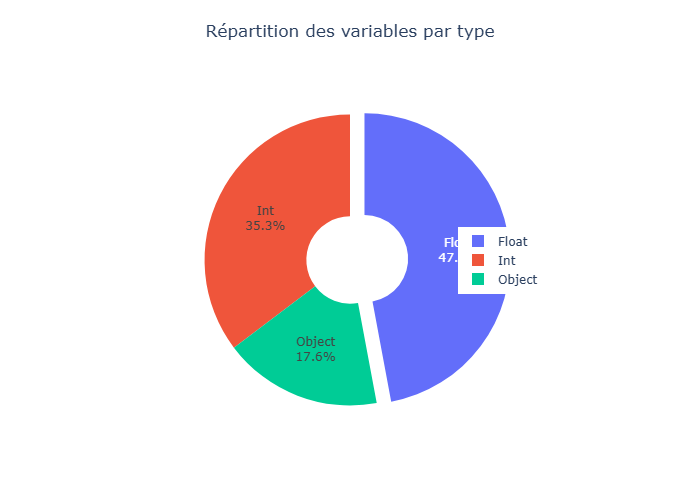

In [142]:
# Représentation graphique des types de variables.

fig = go.Figure(data=[go.Pie(
    labels=["Float", "Int", "Object"], 
    values=df_bureau.dtypes.value_counts(),
    hole=0.3,
    textinfo="label+percent",
    pull=[0.1, 0, 0]
)])

# Titre et affichage
fig.update_layout(
    title={
        'text': "Répartition des variables par type",
        'y': 0.95,  # Position verticale (1 = tout en haut)
        'x': 0.50,   # Centrer le titre
        'xanchor': 'center',
        'yanchor': 'top'
    },
    legend={
        'x': 0.7,  # Ajuste la position de la légende plus proche
        'y': 0.5,
        'xanchor': 'left'
    }
)
fig.show()

- Pour ce fichier, on a **1 716 428** lignes et **17** variables majoritairement quantitatives et qui regroupent des informations concernant les prêts antérieurs de nos clients dans d'autres institutions et qui ont été recensés au Bureau de crédit.
- On sait aussi que ce fichier met en avant 1 ligne pour chaque crédit contracté par un client (présent dans notre échantillon de donnée).

In [143]:
# Visualisation des description liées à ce jeu de données.

pd.set_option('display.max_colwidth', None)
df_description.loc[df_description['Table'] == 'bureau.csv'][['Row','Description']]


,Row,Description
122,SK_ID_CURR,"ID of loan in our sample - one loan in our sample can have 0,1,2 or more related previous credits in credit bureau"
123,SK_BUREAU_ID,Recoded ID of previous Credit Bureau credit related to our loan (unique coding for each loan application)
124,CREDIT_ACTIVE,Status of the Credit Bureau (CB) reported credits
125,CREDIT_CURRENCY,Recoded currency of the Credit Bureau credit
126,DAYS_CREDIT,How many days before current application did client apply for Credit Bureau credit
127,CREDIT_DAY_OVERDUE,Number of days past due on CB credit at the time of application for related loan in our sample
128,DAYS_CREDIT_ENDDATE,Remaining duration of CB credit (in days) at the time of application in Home Credit
129,DAYS_ENDDATE_FACT,Days since CB credit ended at the time of application in Home Credit (only for closed credit)
130,AMT_CREDIT_MAX_OVERDUE,Maximal amount overdue on the Credit Bureau credit so far (at application date of loan in our sample)
131,CNT_CREDIT_PROLONG,How many times was the Credit Bureau credit prolonged


In [144]:
pd.reset_option('display.max_colwidth')

- Globalement il y a pas mal d'informations intéressantes dans ce jeu de données puisque l'on a pas mal d'informations les crédits passés comme par exemple le type et le statut d'un crédit, la situation globale autour de celui-ci (échéance de remboursement, dépassement de la date limite, plafond etc..), la récence des informations au sujet du crédit...
- Cela donne pas mal d'éléments qui pourrait être pris en compte dans le modèle pour déterminer la capacité de remboursement d'un client.
- On peut donc maintenant s'intéresser à nos différentes variables :

In [145]:
# Statistique des données du fichier bureau.

df_bureau.describe().round(2)

,SK_ID_CURR,SK_ID_BUREAU,DAYS_CREDIT,CREDIT_DAY_OVERDUE,DAYS_CREDIT_ENDDATE,DAYS_ENDDATE_FACT,AMT_CREDIT_MAX_OVERDUE,CNT_CREDIT_PROLONG,AMT_CREDIT_SUM,AMT_CREDIT_SUM_DEBT,AMT_CREDIT_SUM_LIMIT,AMT_CREDIT_SUM_OVERDUE,DAYS_CREDIT_UPDATE,AMT_ANNUITY
count,1716428.00,1716428.00,1716428.00,1716428.00,1610875.00,1082775.00,5.919400e+05,1716428.00,1.716415e+06,1.458759e+06,1124648.00,1716428.00,1716428.00,4.896370e+05
mean,278214.93,5924434.49,-1142.11,0.82,510.52,-1017.44,3.825420e+03,0.01,3.549946e+05,1.370851e+05,6229.51,37.91,-593.75,1.571276e+04
std,102938.56,532265.73,795.16,36.54,4994.22,714.01,2.060316e+05,0.10,1.149811e+06,6.774011e+05,45032.03,5937.65,720.75,3.258270e+05
min,100001.00,5000000.00,-2922.00,0.00,-42060.00,-42023.00,0.000000e+00,0.00,0.000000e+00,-4.705600e+06,-586406.12,0.00,-41947.00,0.000000e+00
25%,188866.75,5463953.75,-1666.00,0.00,-1138.00,-1489.00,0.000000e+00,0.00,5.130000e+04,0.000000e+00,0.00,0.00,-908.00,0.000000e+00
50%,278055.00,5926303.50,-987.00,0.00,-330.00,-897.00,0.000000e+00,0.00,1.255185e+05,0.000000e+00,0.00,0.00,-395.00,0.000000e+00
75%,367426.00,6385681.25,-474.00,0.00,474.00,-425.00,0.000000e+00,0.00,3.150000e+05,4.015350e+04,0.00,0.00,-33.00,1.350000e+04
max,456255.00,6843457.00,0.00,2792.00,31199.00,0.00,1.159872e+08,9.00,5.850000e+08,1.701000e+08,4705600.32,3756681.00,372.00,1.184534e+08


- Hormis les deux variables ID, on constate déjà avec cette aperçu des statistiques de nos variables catégorielles qu'il y a des variables qui présentent potentiellement des valeurs aberrantes comme par exemple pour les variables **"ENDDATE"** qui affichent pour les valeurs minimales plus de 42K jours ce qui représente plus de 100 ans ce qui est donc improbable.
- Certaines valeurs négatives semblent aussi erronées surtout en ce qui concerne les variables temporelles.
- Certains montants sont extrêmement élevés ce qui pourrait aussi être des valeurs aberrantes.

In [146]:
# Calcul du pourcentage de valeurs nulles par variable pour "bureau.csv". 
pd.set_option('display.max_rows', None)
calculate_missing_values(df_bureau)

,Nbr_valeurs_manquantes,Pct_valeurs_manquantes
AMT_ANNUITY,1226791,71.473490
AMT_CREDIT_MAX_OVERDUE,1124488,65.513264
DAYS_ENDDATE_FACT,633653,36.916958
AMT_CREDIT_SUM_LIMIT,591780,34.477415
AMT_CREDIT_SUM_DEBT,257669,15.011932
DAYS_CREDIT_ENDDATE,105553,6.149573
AMT_CREDIT_SUM,13,0.000757


In [147]:
pd.reset_option('display.max_rows')

Text(0, 0.5, 'Loans')

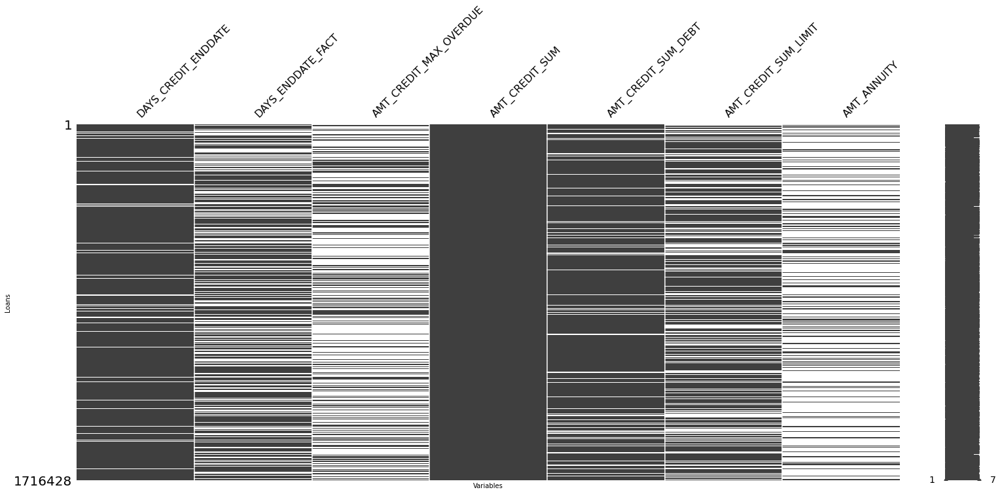

In [148]:
# Utilisation d'un graphique pour avoir une représentation visuelle des valeurs manquantes.

msno.matrix(df_bureau.loc[:, df_bureau.isnull().any(axis=0)])

plt.xlabel("Variables")
plt.ylabel("Loans")

- On retrouve ici ***7*** variables avec des valeurs nulles dont ***4*** qui ont plus de **30%** de valeurs manquantes pour atteindre  jusque **70%** pour la variable **"AMT_ANNUITY"**.
- Il faudra donc trouver une solution pour palier à ce problème. On peut maintenant s'intéresser à nos variables au cas par cas.

In [149]:
# Recherche de doublons pour la variable ID "SK_ID_CURR"

df_bureau['SK_ID_CURR'].duplicated().any()

True

In [150]:
# Nombre de lignes présentant au moins un doublon et celles n'en présentant pas.

df_bureau['SK_ID_CURR'].duplicated(keep=False).value_counts()

True     1674908
False      41520
Name: SK_ID_CURR, dtype: int64

In [151]:
# Nombre de ID unique pour cette variable.

df_bureau['SK_ID_CURR'].nunique()

305811

In [152]:
# On compare les ID présents à la fois dans df_bureau et dans df_appli_train/df_appli_test.

print(f" Il y a {pd.Series(df_bureau['SK_ID_CURR'].unique()).isin(df_appli_train['SK_ID_CURR']).sum()} ID présents au moins une fois dans bureau et dans le fichier application train.")
print(f" Il y a {pd.Series(df_bureau['SK_ID_CURR'].unique()).isin(df_appli_test['SK_ID_CURR']).sum()} ID présents au moins une fois dans bureau et dans le fichier application test.")

 Il y a 263491 ID présents au moins une fois dans bureau et dans le fichier application train.
 Il y a 42320 ID présents au moins une fois dans bureau et dans le fichier application test.


- Cette variable reprend la variable ID du fichier principal qui constitue la base de notre échantillon de donnée.
- Comme on peut le voir, il y a des doublons puisque un client peut avoir un ou plusieurs crédit dans une autre institution de crédit.
- Ce qui est intéressant de souligner ici c'est qu'il y a **305 811** clients de notre échantillon qui ont au moins un crédit dans une autre institution et ces derniers sont répartis entre les fichiers ***train*** (**263 491**) et ***test*** (**42 320**) qui serviront à entrainer et tester le modèle. Il y a donc des client sans antécédents de crédit. 

In [153]:
# Recherche de doublons pour la variable ID "SK_ID_BUREAU"

df_bureau['SK_ID_BUREAU'].duplicated().any()

False

- On ne retrouve pas de doublons ce qui constitue notre clé primaire pour ce dataframe.
- Cette variable est associé à chaque demande de crédit passée, on a donc une ligne pour chaque crédit demandé par un client de notre échantillon.
- Ensuite intéressons nous aux variables catégorielles :

In [154]:
df_bureau.select_dtypes(include=['object']).nunique()

CREDIT_ACTIVE       4
CREDIT_CURRENCY     4
CREDIT_TYPE        15
dtype: int64

In [155]:
def plot_categorical_histogram(df, x, color=None, color_map=None, nbins=None,
                                title=None, width=800, height=500,
                                orientation='v', barmode='group', use_plotly_express=False,
                                title_layout=None, xaxis_title=None, yaxis_title=None,
                                legend_layout=None, tickangle=0, title_font_size=18, 
                                legend_font_size=14, margin=None, percent=False, rare_threshold=None):


    df = df.copy()
    total_count = len(df)

    # Supprimer les valeurs manquantes dans la variable color
    if color is not None:
        df = df[df[color].notna()]

    # Regrouper les modalités rares si seuil spécifié
    other_label = "Autre"
    if rare_threshold is not None:
        freq = df[x].value_counts(normalize=True)
        rare_categories = freq[freq < rare_threshold].index.tolist()

        if rare_categories:
            other_label = f"Autre ({len(rare_categories)})"
            df[x] = df[x].apply(lambda val: other_label if val in rare_categories else val)

    # Réordonner les catégories
    cat_order = df[x].value_counts().index.tolist()
    df[x] = pd.Categorical(df[x], categories=cat_order, ordered=True)

    if use_plotly_express:
        fig = px.histogram(df, x=x, color=color, nbins=nbins, color_discrete_map=color_map,
                           category_orders={x: cat_order}, barnorm='percent' if percent else '')
    else:
        if color is None:
            counts = df[x].value_counts().sort_values(ascending=False)
            y_vals = (counts / total_count * 100) if percent else counts
            y_text = [f"{v:.2f}%" if percent else f"{int(v):,}" for v in y_vals]

            fig = go.Figure(data=[go.Bar(
                x=counts.index,
                y=y_vals,
                text=y_text,
                textposition='outside'
            )])
        else:
            grouped = df.groupby([x, color]).size().reset_index(name='count')
            grouped[x] = pd.Categorical(grouped[x], categories=cat_order, ordered=True)
            grouped = grouped.sort_values(by=[x, color])

            if percent:
                grouped["percent"] = grouped["count"] / total_count * 100
                y_vals = "percent"
                y_text_func = lambda v: f"{v:.2f}%"
            else:
                y_vals = "count"
                y_text_func = lambda v: f"{int(v):,}"

            fig = go.Figure()
            for col_val in grouped[color].unique():
                data = grouped[grouped[color] == col_val]
                fig.add_bar(
                    x=data[x],
                    y=data[y_vals],
                    name=str(col_val),
                    text=[y_text_func(v) for v in data[y_vals]],
                    textposition="outside",
                    marker_color=color_map[col_val] if color_map and col_val in color_map else None
                )

    fig.update_layout(
        barmode=barmode,
        title=dict(
            text=title or f"Répartition de {x}" + (" (%)" if percent else ""),
            x=title_layout.get("x", 0.5) if title_layout else 0.5,
            y=title_layout.get("y", 0.95) if title_layout else 0.95,
            xanchor=title_layout.get("xanchor", "center") if title_layout else "center",
            font=dict(size=title_font_size)
        ),
        width=width,
        height=height,
        margin=margin or dict(l=50, r=50, t=80, b=50),
        legend=dict(
            x=legend_layout.get("x", 1.02) if legend_layout else 1.02,
            y=legend_layout.get("y", 1) if legend_layout else 1,
            xanchor=legend_layout.get("xanchor", "left") if legend_layout else "left",
            font=dict(size=legend_font_size)
        ),
        xaxis=dict(
            title=xaxis_title or x,
            tickangle=tickangle
        ),
        yaxis=dict(
            title=yaxis_title or ("Pourcentage d'observations" if percent else "Nombre d'observations")
        )
    )

    fig.show()

In [156]:
# Nombre d'occurence pour chacune des valeurs de cette variable.

df_bureau['CREDIT_ACTIVE'].value_counts()

Closed      1079273
Active       630607
Sold           6527
Bad debt         21
Name: CREDIT_ACTIVE, dtype: int64

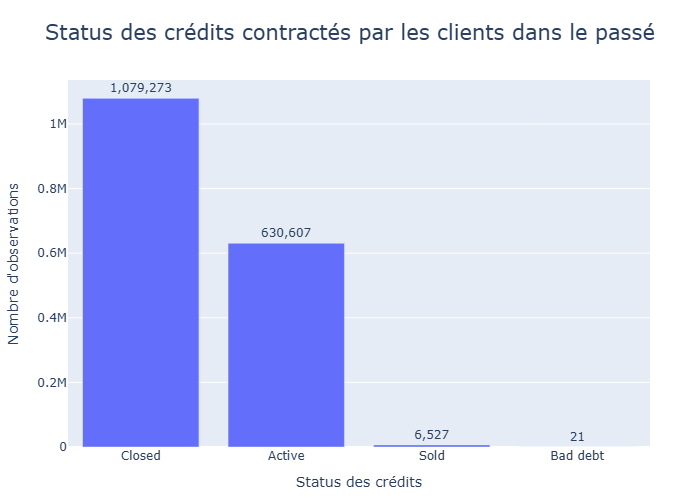

In [157]:
# Visualisation de la répartition pour la variable "CREDIT_ACTIVE"

plot_categorical_histogram(
    df=df_bureau,
    x="CREDIT_ACTIVE",
    title="Status des crédits contractés par les clients dans le passé",
    xaxis_title= 'Status des crédits',
    title_font_size=21
)

In [158]:
def plot_pie_chart(df, column, title=None, hole=0.0, pull_auto=True,
                   textinfo="label+percent", title_layout=None, legend_layout=None, width=700,
                   height=500, margin=dict(l=50, r=50, t=50, b=50)):

    """
    Affiche un graphique circulaire (Pie Chart) basé sur une variable catégorielle d'un DataFrame.
    
    Paramètres :
    - df : DataFrame source
    - column : nom de la colonne catégorielle à représenter
    - title : titre du graphique (si non précisé, généré automatiquement à partir du nom de la colonne)
    - hole : taille du trou central (0 = pie classique, 0.3 = donut)
    - pull_auto : met automatiquement en avant la valeur la plus fréquente (True par défaut)
    - textinfo : informations à afficher sur chaque segment ('label', 'percent', 'value', etc.)
    - title_layout : dictionnaire pour personnaliser le placement et le style du titre (x, y, anchor, font, etc.)
    - legend_layout : dictionnaire pour personnaliser le placement de la légende
    - width, height : dimensions du graphique
    - margin : dictionnaire des marges du graphique (haut, bas, gauche, droite)
    """

    # Compter les occurrences des valeurs
    counts = df[column].value_counts()
    labels = counts.index.astype(str)
    values = counts.values

    # Définir le titre
    final_title = title or f"Répartition de {column}"

    # Titre layout par défaut
    if title_layout is None:
        title_layout = {
            'text': final_title,
            'x': 0.5,
            'xanchor': 'center',
            'y': 0.95,
            'yanchor': 'top',
            'font': {'size': 20}
        }
    else:
        title_layout = title_layout.copy()
        title_layout.setdefault('text', final_title)
        title_layout.setdefault('font', {'size': 20})

    # Legend layout par défaut
    if legend_layout is None:
        legend_layout = {
            'x': 1,
            'y': 1,
            'xanchor': 'left'
        }

    # Auto pull: met légèrement en avant le segment majoritaire
    if pull_auto:
        pull = [0.1 if i == 0 else 0 for i in range(len(labels))]
    else:
        pull = [0] * len(labels)

    # Créer la figure
    fig = go.Figure(
        data=[go.Pie(
            labels=labels,
            values=values,
            hole=hole,
            textinfo=textinfo,
            pull=pull
        )]
    )

    # Layout
    fig.update_layout(
        title=title_layout,
        legend=legend_layout,
        width=width,
        height=height,
        margin=margin
    )

    fig.show()

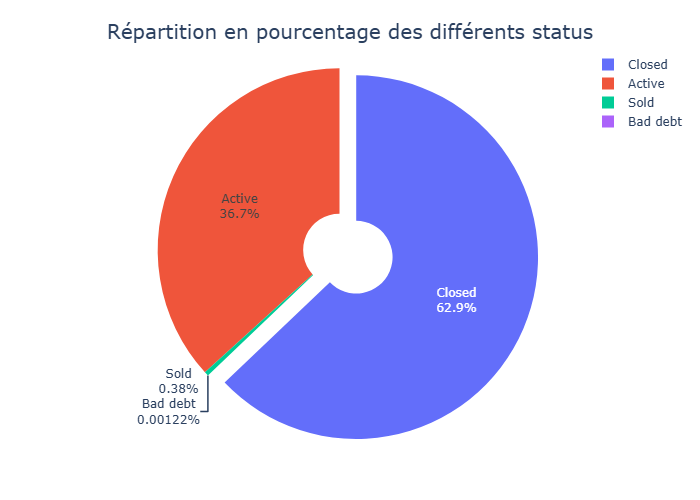

In [159]:
# Visualisation de la répartition en pourcentage pour la variable "CREDIT_ACTIVE"

plot_pie_chart(
    df=df_bureau,
    column="CREDIT_ACTIVE",
    hole=0.2,
    title="Répartition en pourcentage des différents status",
    pull_auto=True
)

- La grande majorité des crédits contractés dans le passé par nos clients sont terminés (62.9%)
- Il reste encore un tiers de crédit actif ce qui peut être un facteur influençant la solvabilité d'un client.
- On a aussi 2 autres status, un premier qui peut être des crédits rachetés et donc que l'on pourrait considérer comme terminés et un dernier qui représente sans doute les crédits en défaut (même sil il y en a qu'une vingtaine)
- On peut donc ajouter notre variable 'Target' pour tester si l'état d'un crédit influence la capacité de remboursement des clients pour les données d'entrainement.

In [160]:
# Ajout de la variable 'TARGET' au dataframe df_bureau

df_bureau['TARGET'] = df_bureau['SK_ID_CURR'].map(df_appli_train.set_index('SK_ID_CURR')['TARGET'])

In [161]:
# Nombre d'occurence pour chacune des valeurs de cette variable.

df_bureau['TARGET'].value_counts(dropna=False)

0.0    1350805
NaN     251103
1.0     114520
Name: TARGET, dtype: int64

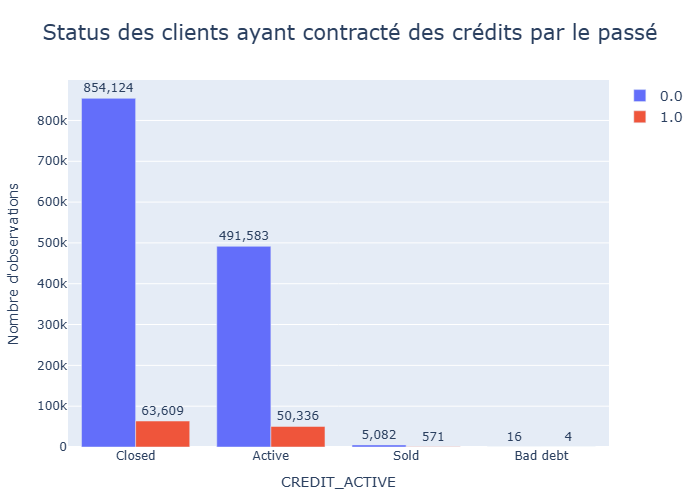

In [162]:
# Visualisation de la répartition pour la variable "CREDIT_ACTIVE" en fonction de la Target.

plot_categorical_histogram(
    df=df_bureau,
    x="CREDIT_ACTIVE",
    color= 'TARGET',
    title="Status des clients ayant contracté des crédits par le passé",
    title_font_size=21
)

- On rappellera que le nombres de crédits a diminué en raison du fait que ce jeu de donnée comprend à la fois des clients du jeu de donnée d'entrainement mais aussi de test comme on l'a constaté plus haut d'où cette différence.

In [163]:
def plot_defaillance_rate_per_category(df, cat_var, target_var='TARGET', title=None, color_scale='Reds',
                                       width=800, height=500, title_layout=None, legend_layout=None,
                                       margin=None, xaxis_title=None, yaxis_title=None, 
                                       tickangle=0, title_font_size=18, show_legend=False):

    """
    Affiche le taux de défaillance (TARGET=1) pour chaque modalité d'une variable catégorielle.

    Paramètres :
    - df : DataFrame source
    - cat_var : nom de la variable catégorielle
    - target_var : nom de la variable cible binaire (ex: 'TARGET')
    - title : titre du graphique
    - color_scale : palette de couleurs pour les barres
    - width, height : dimensions du graphique
    - title_layout : dict pour positionner le titre (x, y, anchor, etc.)
    - legend_layout : dict pour positionner la légende (x, y, anchor, etc.)
    - margin : dict de marges (haut, bas, gauche, droite)
    - tickangle : angle des labels en abscisse
    - title_font_size : taille de la police du titre
    - show_legend : afficher ou non la légende
    - xaxis_title : titre personnalisé pour l’axe X
    - yaxis_title : titre personnalisé pour l’axe Y
    """

    # Nettoyage des données
    df_clean = df[[cat_var, target_var]].dropna()

    # Calcul du taux de défaillance
    grouped = df_clean.groupby(cat_var)[target_var]
    def_rate = (grouped.sum() / grouped.count() * 100).sort_values(ascending=False)

    # Création du graphique
    fig = go.Figure(data=[
        go.Bar(
            x=def_rate.index,
            y=def_rate.values,
            text=[f"{v:.2f}%" for v in def_rate.values],
            textposition='auto',
            marker=dict(color=def_rate.values, colorscale=color_scale),
            showlegend=show_legend
        )
    ])

    # Définition du titre
    title = title or f"Pourcentage de défaillants par modalité de '{cat_var}'"
    title_dict = {"text": title, "font": dict(size=title_font_size)}
    if title_layout:
        title_dict.update(title_layout)

    # Mise à jour du layout
    fig.update_layout(
        title=title_dict,
        xaxis=dict(
            title=xaxis_title or cat_var,
            tickangle=tickangle
        ),
        yaxis=dict(
            title=yaxis_title or f"{target_var} (%)"
        ),
        width=width,
        height=height,
        margin=margin or dict(t=80, b=60, l=60, r=60),
        showlegend=show_legend
    )

    if legend_layout:
        fig.update_layout(legend=legend_layout)

    fig.show()

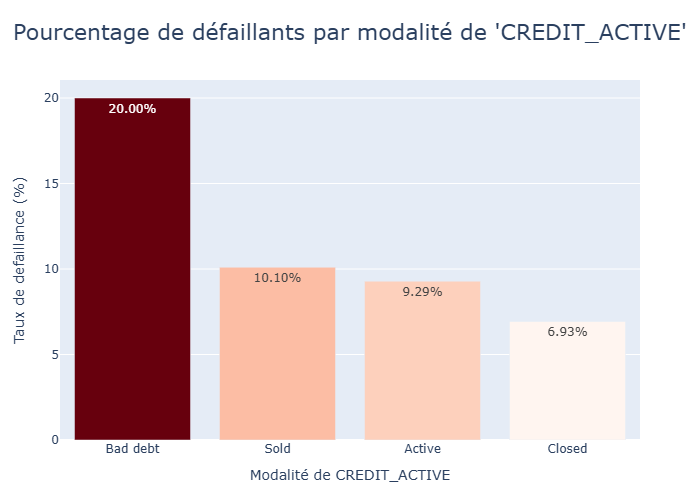

In [164]:
# Visualisation du pourcentage de prêts défaillants pour la variable de CREDIT_ACTIVE.

plot_defaillance_rate_per_category(
    df_bureau,
    cat_var='CREDIT_ACTIVE',
    title_layout={"x": 0.5},
    xaxis_title = "Modalité de CREDIT_ACTIVE",
    yaxis_title = "Taux de defaillance (%)",
    title_font_size=22
)

- En prenant en compte la variable cible, on a des résultats plutôt intéressant puisque les crédits "bad debt" ont **20 %** de clients défaillants ce qui est plutôt attendu étant donné la nature de la catégorie (toutefois on a assez peu de data concernant cette catégorie puisque qu'il faut rapeller qu'il y a peu d'individus dans cette situation).
- Ensuite, on a les crédit vendus et actifs qui totalise chacun **10 %** de prêt défaillant ce qui n'est pas négligeable et en particulier la catégorie active car cette catégorie comprend plus d'un tier des prêts répertoriés. 
- En effet, si l'on compare aux prêts terminés qui représente quasiment 2 tiers des prêts totaux mais affichant le taux le plus faible de défaillance (**~7%**), on peut dire que cette variable a son importance et influe la capacité de remboursement d'un client.

On peut ensuite passer à la variable catégorielle suivante (CREDIT_CURRENCY) :

In [165]:
# Nombre d'occurence pour chacune des valeurs de cette variable.

df_bureau['CREDIT_CURRENCY'].value_counts()

currency 1    1715020
currency 2       1224
currency 3        174
currency 4         10
Name: CREDIT_CURRENCY, dtype: int64

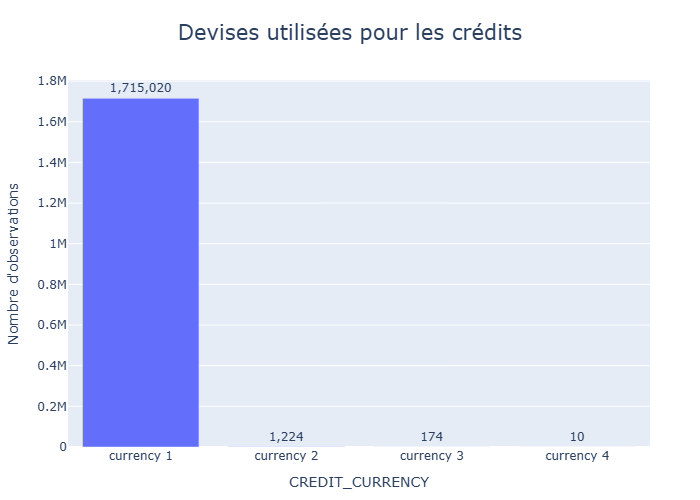

In [166]:
# Visualisation de la répartition pour la variable "CREDIT_CURRENCY"

plot_categorical_histogram(
    df=df_bureau,
    x="CREDIT_CURRENCY",
    title="Devises utilisées pour les crédits",
    title_font_size=21
)

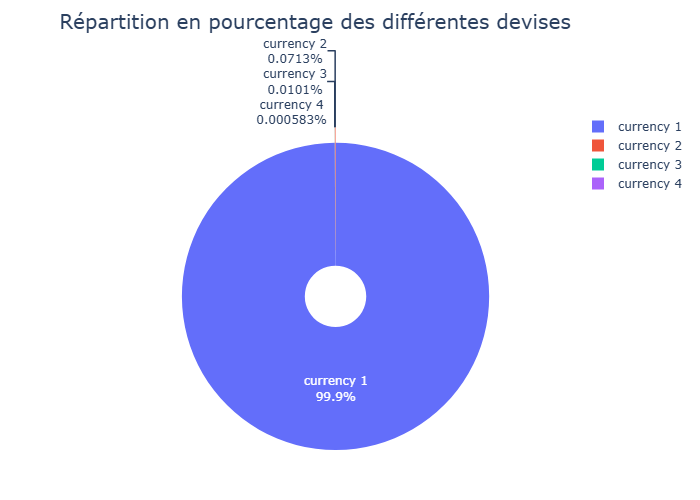

In [167]:
# Visualisation de la répartition en pourcentage pour la variable "CREDIT_CURRENCY"

plot_pie_chart(
    df=df_bureau,
    column="CREDIT_CURRENCY",
    hole=0.2,
    title="Répartition en pourcentage des différentes devises",
    title_layout = {'x':0.45, 'y':0.97},
    height=600,
    pull_auto=True
)

- La grande majorité des devises utilisées est la *"currency 1"* pour près de **99.9 %** des credits du Bureau.

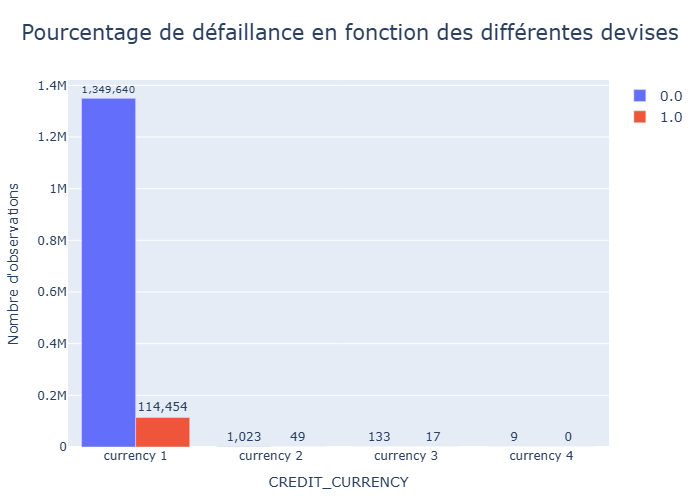

In [168]:
# Visualisation de la répartition pour la variable "CREDIT_CURRENCY" en fonction de la Target.

plot_categorical_histogram(
    df=df_bureau,
    x="CREDIT_CURRENCY",
    color= 'TARGET',
    title="Pourcentage de défaillance en fonction des différentes devises",
    title_font_size=21
)

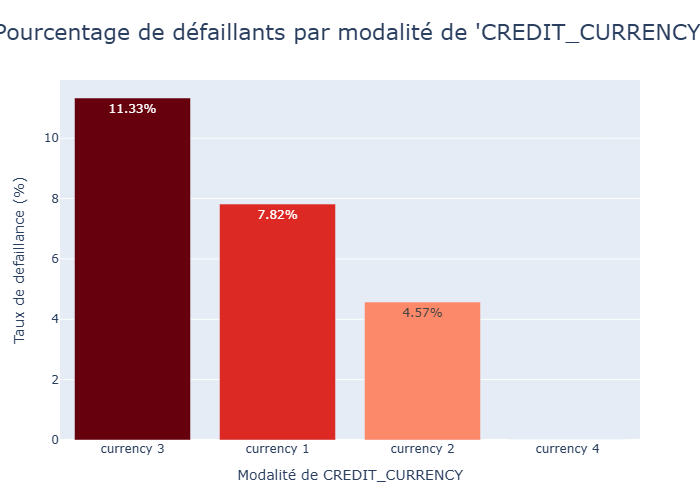

In [169]:
# Visualisation du pourcentage de prêts défaillants pour la variable de CREDIT_CURRENCY.

plot_defaillance_rate_per_category(
    df_bureau,
    cat_var='CREDIT_CURRENCY',
    title_layout={"x": 0.5},
    xaxis_title = "Modalité de CREDIT_CURRENCY",
    yaxis_title = "Taux de defaillance (%)",
    title_font_size=22
)

- La "currency 3" est celle qui présente le plus de défaillance (**~11%**) néanmoins il y a peu de data pour les currency 2, 3 et 4 donc il est difficile d'affirmer que les devises ont un impact significatif sur  la Target.
- La "currency 1" représente la quasi totalité de la devise utilisée et affiche **~8%** de défauts toutefois on a aucune autre devise bien représentée pour pouvoir comparer.

On peut ensuite passer à la variable catégorielle suivante (CREDIT_TYPE) :

In [170]:
# Nombre d'occurence pour chacune des valeurs de cette variable.

df_bureau['CREDIT_TYPE'].value_counts()

Consumer credit                                 1251615
Credit card                                      402195
Car loan                                          27690
Mortgage                                          18391
Microloan                                         12413
Loan for business development                      1975
Another type of loan                               1017
Unknown type of loan                                555
Loan for working capital replenishment              469
Cash loan (non-earmarked)                            56
Real estate loan                                     27
Loan for the purchase of equipment                   19
Loan for purchase of shares (margin lending)          4
Mobile operator loan                                  1
Interbank credit                                      1
Name: CREDIT_TYPE, dtype: int64

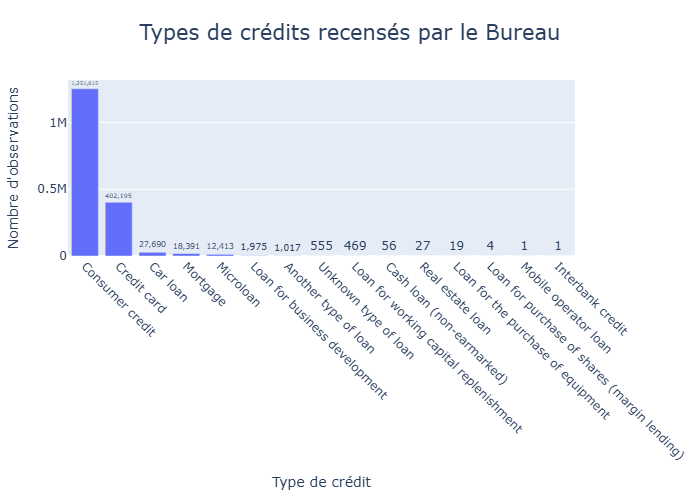

In [171]:
# Visualisation de la répartition pour la variable "CREDIT_TYPE"

plot_categorical_histogram(
    df=df_bureau,
    x="CREDIT_TYPE",
    title="Types de crédits recensés par le Bureau ",
    xaxis_title= 'Type de crédit',
    tickangle=45,
    title_font_size=21,
    height=700,
    width=900
)

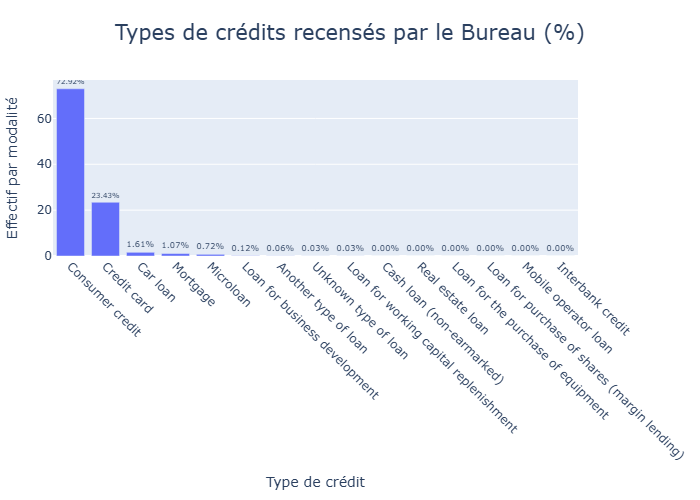

In [172]:
# Visualisation de la répartition en pourcentage pour la variable "CREDIT_TYPE"

plot_categorical_histogram(
    df=df_bureau,
    color_map = 'rainbow',
    x="CREDIT_TYPE",
    title="Types de crédits recensés par le Bureau (%) ",
    xaxis_title= 'Type de crédit',
    yaxis_title= 'Effectif par modalité',
    tickangle=45,
    title_font_size=21,
    height=700,
    width=900, 
    percent=True
)

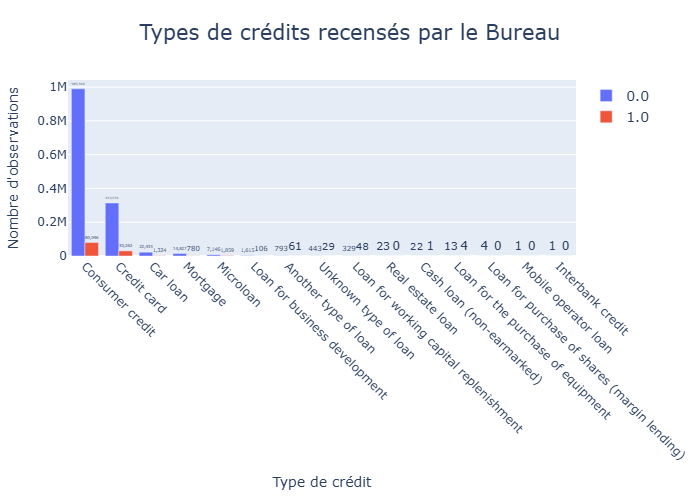

In [173]:
# Visualisation de la répartition en pourcentage pour la variable "CREDIT_TYPE"

plot_categorical_histogram(
    df=df_bureau,
    x="CREDIT_TYPE",
    color="TARGET",
    title="Types de crédits recensés par le Bureau ",
    xaxis_title= 'Type de crédit',
    tickangle=45,
    title_font_size=21,
    height=800,
    width=1200
)

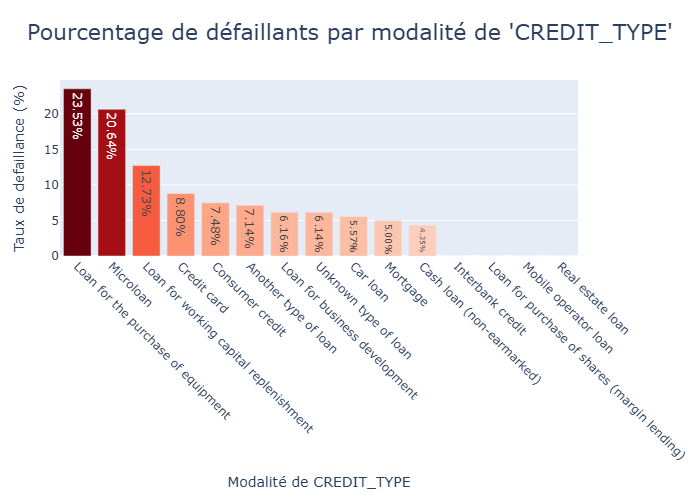

In [174]:
# Visualisation du pourcentage de prêts défaillants pour la variable de "CREDIT_TYPE".

plot_defaillance_rate_per_category(
    df_bureau,
    cat_var='CREDIT_TYPE',
    title_layout={"x": 0.5},
    xaxis_title = "Modalité de CREDIT_TYPE",
    yaxis_title = "Taux de defaillance (%)",
    tickangle=45,
    title_font_size=22,
    height=800,
    width=1200
)

- Pour cette variable, on a 95 % des types de crédits qui se partagent entre *"Consumer credit"* (**72%**) et *"Credit Card"* (**23%**) puis on a diverses autres types qui représentent un faible pourcentage (jusque un seul crédit pour 2 types de crédits).
- Pour ce qui des crédits défaillants, les deux grands types de crédits ont environ 8% de défaillance. Mais ce nombre atteint plus de 20% pour 2 catégories ce qui n'est pas négligeable même si leur effectif global est bien plus faible (moins de 1% du total). Donc le **type de crédit** pourrait constituer un élément à prendre en compte dans la modélisation.

On peut maintenant passer aux variables quantitatives en commençant par la variable "DAYS_CREDIT" :

In [175]:
df_bureau.select_dtypes(include=['float', "int"]).columns.tolist()

['SK_ID_CURR',
 'SK_ID_BUREAU',
 'DAYS_CREDIT',
 'CREDIT_DAY_OVERDUE',
 'DAYS_CREDIT_ENDDATE',
 'DAYS_ENDDATE_FACT',
 'AMT_CREDIT_MAX_OVERDUE',
 'CNT_CREDIT_PROLONG',
 'AMT_CREDIT_SUM',
 'AMT_CREDIT_SUM_DEBT',
 'AMT_CREDIT_SUM_LIMIT',
 'AMT_CREDIT_SUM_OVERDUE',
 'DAYS_CREDIT_UPDATE',
 'AMT_ANNUITY',
 'TARGET']

In [176]:
df_bureau['DAYS_CREDIT'].describe().round(0)

count    1716428.0
mean       -1142.0
std          795.0
min        -2922.0
25%        -1666.0
50%         -987.0
75%         -474.0
max            0.0
Name: DAYS_CREDIT, dtype: float64

- Cette variable donne le nombre de jours qui précéde la demande de crédit actuelle au Bureau. Toutefois celle-ci est majoritairement négative donc il faut remédier à cela.

In [177]:
df_bureau['DAYS_CREDIT'] = df_bureau['DAYS_CREDIT'] * -1

In [178]:
df_bureau['DAYS_CREDIT'].describe().round(0)

count    1716428.0
mean        1142.0
std          795.0
min            0.0
25%          474.0
50%          987.0
75%         1666.0
max         2922.0
Name: DAYS_CREDIT, dtype: float64

In [ ]:
# Création d'une fonction permettant la visualisation d'un histogramme pour des variables quantitatives.

'''def format_number(n):
    if n >= 1_000_000_000:
        return f"{n/1_000_000_000:.1f} Md"
    elif n >= 1_000_000:
        return f"{n/1_000_000:.1f} M"
    elif n >= 1_000:
        return f"{n/1_000:.0f} k"
    else:
        return f"{int(n)}"

def plot_quantitative_histogram(df, x, color=None, color_map=None, nbins=None,
                                title=None, width=800, height=500,
                                use_plotly_express=False,
                                title_layout=None, xaxis_title=None, yaxis_title=None,
                                legend_layout=None, title_font_size=18, 
                                legend_font_size=14, margin=None, percent=False,
                                density=False, min_quantile=0.0, max_quantile=1.0,
                                show_mean=False, show_median=False,
                                bin_as_category=False):

    df = df.copy()
    df = df[df[x].notna()]
    if color is not None:
        df = df[df[color].notna()]

    # Limitation selon quantiles
    q_low = df[x].quantile(min_quantile)
    q_high = df[x].quantile(max_quantile)
    df = df[(df[x] >= q_low) & (df[x] <= q_high)]

    total_count = len(df)
    nbins = nbins or 15
    fig = go.Figure()

    if bin_as_category:
        # Binning discret en labels clairs (ex : 50–100k)
        bins = np.linspace(df[x].min(), df[x].max(), nbins + 1)
        labels = [f"{format_number(bins[i])} - {format_number(bins[i+1])}" for i in range(len(bins) - 1)]
        df["x_binned"] = pd.cut(df[x], bins=bins, labels=labels, include_lowest=True, ordered=False)

        cat_order = df["x_binned"].value_counts().sort_index().index.tolist()

        if color is None:
            counts = df["x_binned"].value_counts().reindex(cat_order)
            y_vals = (counts / total_count * 100) if percent else counts
            y_text = [f"{v:.2f}%" if percent else f"{int(v):,}" for v in y_vals]

            fig.add_bar(
                x=counts.index.astype(str),
                y=y_vals,
                text=y_text,
                textposition="outside",
                name="Histogramme"
            )
        else:
            grouped = df.groupby(["x_binned", color]).size().reset_index(name="count")
            grouped["x_binned"] = pd.Categorical(grouped["x_binned"], categories=cat_order, ordered=True)
            grouped = grouped.sort_values(by=["x_binned", color])

            if percent:
                grouped["percent"] = grouped["count"] / total_count * 100
                y_col = "percent"
                y_text_func = lambda v: f"{v:.2f}%"
            else:
                y_col = "count"
                y_text_func = lambda v: f"{int(v):,}"

            for val in grouped[color].unique():
                sub = grouped[grouped[color] == val]
                fig.add_bar(
                    x=sub["x_binned"].astype(str),
                    y=sub[y_col],
                    name=str(val),
                    text=[y_text_func(v) for v in sub[y_col]],
                    textposition="outside",
                    marker_color=color_map[val] if color_map and val in color_map else None
                )

    else:
        # Histogramme classique
        if use_plotly_express:
            fig = px.histogram(
                df, x=x, color=color, nbins=nbins, color_discrete_map=color_map,
                barnorm='percent' if percent else None,
                opacity=0.75
            )
        else:
            if color is None:
                counts, bins = np.histogram(df[x], bins=nbins)
                y_vals = (counts / total_count * 100) if percent else counts
                bin_centers = 0.5 * (bins[1:] + bins[:-1])
                y_text = [f"{v:.2f}%" if percent else f"{int(v):,}" for v in y_vals]
                fig.add_bar(
                    x=bin_centers,
                    y=y_vals,
                    text=y_text,
                    textposition='outside',
                    name='Histogramme'
                )
            else:
                for val in df[color].unique():
                    subset = df[df[color] == val]
                    counts, bins = np.histogram(subset[x], bins=nbins)
                    y_vals = (counts / total_count * 100) if percent else counts
                    bin_centers = 0.5 * (bins[1:] + bins[:-1])
                    y_text = [f"{v:.2f}%" if percent else f"{int(v):,}" for v in y_vals]
                    fig.add_bar(
                        x=bin_centers,
                        y=y_vals,
                        name=str(val),
                        text=y_text,
                        textposition='outside',
                        marker_color=color_map[val] if color_map and val in color_map else None
                    )

        # Densité (classique uniquement, pas en bin_as_category)
        if density:
            if color is None:
                kde = gaussian_kde(df[x])
                x_dens = np.linspace(df[x].min(), df[x].max(), 500)
                y_dens = kde(x_dens)

                # Ajuster à la hauteur de l’histogramme
                counts, bins = np.histogram(df[x], bins=nbins)
                bin_width = bins[1] - bins[0]
                y_dens_scaled = y_dens * len(df[x]) * bin_width  # remise à l’échelle

                fig.add_trace(go.Scatter(
                    x=x_dens,
                    y=y_dens_scaled,
                    mode='lines',
                    name='Densité',
                    line=dict(color='black', width=2, dash='dash')
                ))
            else:
                for val in df[color].unique():
                    subset = df[df[color] == val][x]
                    if len(subset) < 2:
                        continue
                    kde = gaussian_kde(subset)
                    x_dens = np.linspace(subset.min(), subset.max(), 500)
                    y_dens = kde(x_dens)
                    if percent:
                        y_dens = y_dens / y_dens.sum() * 100
                    fig.add_trace(go.Scatter(
                        x=x_dens,
                        y=y_dens,
                        mode='lines',
                        name=f'Densité - {val}',
                        line=dict(
                            width=2,
                            color=color_map[val] if color_map and val in color_map else None
                        )
                    ))

    # Lignes verticales : moyenne et médiane (uniquement si pas de bin_as_category)

        if show_mean:
            mean = df[x].mean()
            fig.add_vline(x=mean, line=dict(color='orange', width=4, dash='dot'))
            fig.add_annotation(
                x=mean,
                y=max(counts),
                text="Moyenne",
                showarrow=False,
                textangle=-90,
                xshift=10,
                font=dict(color="orange")
            )

        if show_median:
            median = df[x].median()
            fig.add_vline(x=median, line=dict(color='red', width=4, dash='dot'))
            fig.add_annotation(
                x=median,
                y=max(counts),
                text="Médiane",
                showarrow=False,
                textangle=-90,
                xshift=10,
                font=dict(color="red")
            )

    # Layout
    fig.update_layout(
        barmode='overlay' if density and not bin_as_category else 'group',
        title=dict(
            text=title or f"Distribution de {x}" + (" (%)" if percent else ""),
            x=title_layout.get("x", 0.5) if title_layout else 0.5,
            y=title_layout.get("y", 0.95) if title_layout else 0.95,
            xanchor=title_layout.get("xanchor", "center") if title_layout else "center",
            font=dict(size=title_font_size)
        ),
        width=width,
        height=height,
        margin=margin or dict(l=50, r=50, t=80, b=50),
        legend=dict(
            x=legend_layout.get("x", 1.02) if legend_layout else 1.02,
            y=legend_layout.get("y", 1) if legend_layout else 1,
            xanchor=legend_layout.get("xanchor", "left") if legend_layout else "left",
            font=dict(size=legend_font_size)
        ),
        xaxis=dict(title=xaxis_title or x),
        yaxis=dict(title=yaxis_title or ("Pourcentage d'observations" if percent else "Nombre d'observations"))
    )

    fig.show()'''

In [180]:
# Création d'une fonction permettant la visualisation d'un histogramme pour des variables quantitatives.

def format_number(n):
    n_abs = abs(float(n))
    # grands nombres : k / M / Md
    if n_abs >= 1_000_000_000:
        return f"{n/1_000_000_000:.1f} Md"
    elif n_abs >= 1_000_000:
        return f"{n/1_000_000:.1f} M"
    elif n_abs >= 1_000:
        return f"{n/1_000:.0f} k"
    # petits nombres : garder des décimales
    elif n_abs >= 1:
        return f"{n:.0f}"
    else:
        return f"{n:.4f}".rstrip("0").rstrip(".")

def plot_quantitative_histogram(df, x, color=None, color_map=None, nbins=None,
                                title=None, width=800, height=500,
                                use_plotly_express=False,
                                title_layout=None, xaxis_title=None, yaxis_title=None,
                                legend_layout=None, title_font_size=18, 
                                legend_font_size=14, margin=None, percent=False,
                                density=False, min_quantile=0.0, max_quantile=1.0,
                                show_mean=False, show_median=False,
                                bin_as_category=False, bin_range=None):

    df = df.copy()
    df = df[df[x].notna()]
    if color is not None:
        df = df[df[color].notna()]

    # Limitation selon quantiles
    q_low = df[x].quantile(min_quantile)
    q_high = df[x].quantile(max_quantile)
    df = df[(df[x] >= q_low) & (df[x] <= q_high)]

    total_count = len(df)
    nbins = nbins or 15
    fig = go.Figure()

    if bin_as_category:
        # 1) bornes des bins (option bin_range pour forcer une plage)
        lo = df[x].min() if bin_range is None else bin_range[0]
        hi = df[x].max() if bin_range is None else bin_range[1]
        bins = np.linspace(lo, hi, nbins + 1)
        bins = np.unique(bins)  # au cas où

        # 2) nb de décimales adapté à la largeur du bin -> labels toujours uniques
        if len(bins) > 1:
            step = np.min(np.diff(bins))
            if step >= 1:
                decimals = 0
            else:
                # assez de décimales pour distinguer deux bords consécutifs
                decimals = max(1, int(np.ceil(-np.log10(step))))
        else:
            decimals = 2

        def fmt_edge(v):
            # grands nombres : k/M/Md ; sinon décimales adaptées
            if abs(v) >= 1000:
                return format_number(v)
            return f"{v:.{min(decimals, 6)}f}".rstrip("0").rstrip(".")

        labels = [f"{fmt_edge(bins[i])} - {fmt_edge(bins[i+1])}"
                  for i in range(len(bins) - 1)]

        df["x_binned"] = pd.cut(
            df[x], bins=bins, labels=labels, include_lowest=True,
            ordered=True, precision=max(decimals + 1, 3)
        )

        cat_order = df["x_binned"].value_counts().sort_index().index.tolist()

        if color is None:
            counts = df["x_binned"].value_counts().reindex(cat_order)
            y_vals = (counts / total_count * 100) if percent else counts
            y_text = [f"{v:.2f}%" if percent else f"{int(v):,}" for v in y_vals]

            fig.add_bar(
                x=counts.index.astype(str),
                y=y_vals,
                text=y_text,
                textposition="outside",
                name="Histogramme"
            )
        else:
            grouped = df.groupby(["x_binned", color]).size().reset_index(name="count")
            grouped["x_binned"] = pd.Categorical(grouped["x_binned"], categories=cat_order, ordered=True)
            grouped = grouped.sort_values(by=["x_binned", color])

            if percent:
                grouped["percent"] = grouped["count"] / total_count * 100
                y_col = "percent"
                y_text_func = lambda v: f"{v:.2f}%"
            else:
                y_col = "count"
                y_text_func = lambda v: f"{int(v):,}"

            for val in grouped[color].unique():
                sub = grouped[grouped[color] == val]
                fig.add_bar(
                    x=sub["x_binned"].astype(str),
                    y=sub[y_col],
                    name=str(val),
                    text=[y_text_func(v) for v in sub[y_col]],
                    textposition="outside",
                    marker_color=color_map[val] if color_map and val in color_map else None
                )

    else:
        # Histogramme classique
        if use_plotly_express:
            fig = px.histogram(
                df, x=x, color=color, nbins=nbins, color_discrete_map=color_map,
                barnorm='percent' if percent else None,
                opacity=0.75
            )
        else:
            if color is None:
                counts, bins = np.histogram(df[x], bins=nbins)
                y_vals = (counts / total_count * 100) if percent else counts
                bin_centers = 0.5 * (bins[1:] + bins[:-1])
                y_text = [f"{v:.2f}%" if percent else f"{int(v):,}" for v in y_vals]
                fig.add_bar(
                    x=bin_centers,
                    y=y_vals,
                    text=y_text,
                    textposition='outside',
                    name='Histogramme'
                )
            else:
                for val in df[color].unique():
                    subset = df[df[color] == val]
                    counts, bins = np.histogram(subset[x], bins=nbins)
                    y_vals = (counts / total_count * 100) if percent else counts
                    bin_centers = 0.5 * (bins[1:] + bins[:-1])
                    y_text = [f"{v:.2f}%" if percent else f"{int(v):,}" for v in y_vals]
                    fig.add_bar(
                        x=bin_centers,
                        y=y_vals,
                        name=str(val),
                        text=y_text,
                        textposition='outside',
                        marker_color=color_map[val] if color_map and val in color_map else None
                    )

        # Densité (classique uniquement, pas en bin_as_category)
        if density:
            if color is None:
                kde = gaussian_kde(df[x])
                x_dens = np.linspace(df[x].min(), df[x].max(), 500)
                y_dens = kde(x_dens)

                # Ajuster à la hauteur de l’histogramme
                counts, bins = np.histogram(df[x], bins=nbins)
                bin_width = bins[1] - bins[0]
                y_dens_scaled = y_dens * len(df[x]) * bin_width  # remise à l’échelle

                fig.add_trace(go.Scatter(
                    x=x_dens,
                    y=y_dens_scaled,
                    mode='lines',
                    name='Densité',
                    line=dict(color='black', width=2, dash='dash')
                ))
            else:
                for val in df[color].unique():
                    subset = df[df[color] == val][x]
                    if len(subset) < 2:
                        continue
                    kde = gaussian_kde(subset)
                    x_dens = np.linspace(subset.min(), subset.max(), 500)
                    y_dens = kde(x_dens)
                    if percent:
                        y_dens = y_dens / y_dens.sum() * 100
                    fig.add_trace(go.Scatter(
                        x=x_dens,
                        y=y_dens,
                        mode='lines',
                        name=f'Densité - {val}',
                        line=dict(
                            width=2,
                            color=color_map[val] if color_map and val in color_map else None
                        )
                    ))

    # Lignes verticales : moyenne et médiane (uniquement si pas de bin_as_category)

        if show_mean:
            mean = df[x].mean()
            fig.add_vline(x=mean, line=dict(color='orange', width=4, dash='dot'))
            fig.add_annotation(
                x=mean,
                y=max(counts),
                text="Moyenne",
                showarrow=False,
                textangle=-90,
                xshift=10,
                font=dict(color="orange")
            )

        if show_median:
            median = df[x].median()
            fig.add_vline(x=median, line=dict(color='red', width=4, dash='dot'))
            fig.add_annotation(
                x=median,
                y=max(counts),
                text="Médiane",
                showarrow=False,
                textangle=-90,
                xshift=10,
                font=dict(color="red")
            )

    # Layout
    fig.update_layout(
        barmode='overlay' if density and not bin_as_category else 'group',
        title=dict(
            text=title or f"Distribution de {x}" + (" (%)" if percent else ""),
            x=title_layout.get("x", 0.5) if title_layout else 0.5,
            y=title_layout.get("y", 0.95) if title_layout else 0.95,
            xanchor=title_layout.get("xanchor", "center") if title_layout else "center",
            font=dict(size=title_font_size)
        ),
        width=width,
        height=height,
        margin=margin or dict(l=50, r=50, t=80, b=50),
        legend=dict(
            x=legend_layout.get("x", 1.02) if legend_layout else 1.02,
            y=legend_layout.get("y", 1) if legend_layout else 1,
            xanchor=legend_layout.get("xanchor", "left") if legend_layout else "left",
            font=dict(size=legend_font_size)
        ),
        xaxis=dict(title=xaxis_title or x),
        yaxis=dict(title=yaxis_title or ("Pourcentage d'observations" if percent else "Nombre d'observations"))
    )

    fig.show()

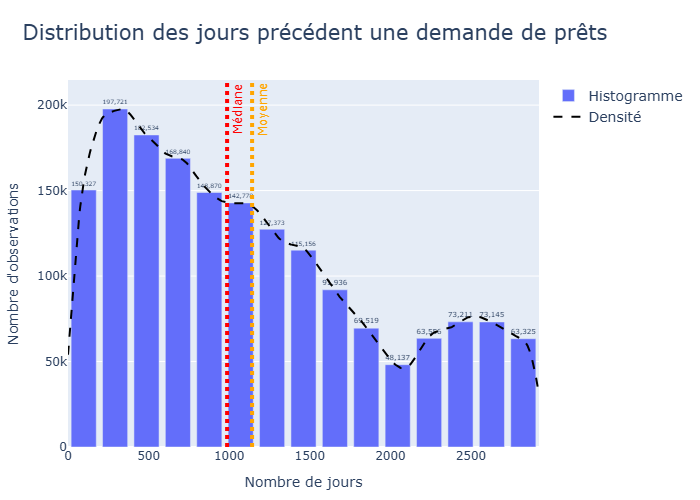

In [181]:
# Visualisation de la répartition pour la variable "DAYS_CREDIT".

plot_quantitative_histogram(
    df_bureau,
    x='DAYS_CREDIT',
    title="Distribution des jours précédent une demande de prêts",
    title_layout={"x": 0.45},
    title_font_size=21,
    xaxis_title="Nombre de jours",
    yaxis_title="Nombre d'observations",
    density=True,
    show_mean=True,
    show_median=True,
    width=1000,
    height=600
)

In [182]:
# Création d'une fonction permettant la visualisation d'un Violin/Box plot. 

def plot_quantitative_box_violin(df, x, y=None, color=None, 
                             plot_type="violin", orientation="v",
                             min_quantile=0.0, max_quantile=1.0,
                             show_mean=False, show_median=False,
                             combine=False,
                             color_map=None,
                             title=None,
                             width=800, height=500,
                             xaxis_title=None, yaxis_title=None,
                             title_font_size=18, legend_font_size=14,
                             margin=None, legend_layout=None, title_layout=None,
                             return_fig=False):
    """
    Affiche un violin plot ou un box plot avec des options avancées.
    """

    df = df.copy()

    # Nettoyage
    df = df[df[x].notna()]
    if color:
        df = df[df[color].notna()]

    # Limitation selon les quantiles
    q_min = df[x].quantile(min_quantile)
    q_max = df[x].quantile(max_quantile)
    df = df[(df[x] >= q_min) & (df[x] <= q_max)]

    # Déterminer axes selon orientation
    axis_main, axis_other = (x, y) if orientation == "v" else (y, x)

    # Choix du type de graphique
    if plot_type == "violin":
        fig = px.violin(
            df,
            y=axis_main if orientation == "v" else None,
            x=axis_other if orientation == "v" else axis_main,
            color=color,
            box=combine,
            points=False,  # plus léger
            orientation=orientation,
            color_discrete_map=color_map
        )
    elif plot_type == "box":
        fig = px.box(
            df,
            y=axis_main if orientation == "v" else None,
            x=axis_other if orientation == "v" else axis_main,
            color=color,
            points="outliers",
            orientation=orientation,
            color_discrete_map=color_map
        )
    else:
        raise ValueError("plot_type doit être 'violin' ou 'box'.")

    # Moyenne / médiane si pas de color
    if color is None:
        if show_mean:
            mean_val = df[x].mean()
            fig.add_hline(
                y=mean_val if orientation == "v" else None,
                x=mean_val if orientation == "h" else None,
                line=dict(color="blue", dash="dash"),
                annotation_text="Moyenne",
                annotation_position="top right" if orientation == "v" else "bottom right",
                annotation=dict(font=dict(color="blue"))
            )
        if show_median:
            median_val = df[x].median()
            fig.add_hline(
                y=median_val if orientation == "v" else None,
                x=median_val if orientation == "h" else None,
                line=dict(color="red", dash="dot"),
                annotation_text="Médiane",
                annotation_position="bottom right" if orientation == "v" else "top right",
                annotation=dict(font=dict(color="red"))
            )

    # Mise en page
    fig.update_layout(
        title=dict(
            text=title or f"{plot_type.capitalize()} plot de {x}",
            x=title_layout.get("x", 0.5) if title_layout else 0.5,
            y=title_layout.get("y", 0.95) if title_layout else 0.95,
            xanchor=title_layout.get("xanchor", "center") if title_layout else "center",
            font=dict(size=title_font_size)
        ),
        width=width,
        height=height,
        margin=margin or dict(l=50, r=50, t=80, b=50),
        legend=dict(
            x=legend_layout.get("x", 1.02) if legend_layout else 1.02,
            y=legend_layout.get("y", 1) if legend_layout else 1,
            xanchor=legend_layout.get("xanchor", "left") if legend_layout else "left",
            font=dict(size=legend_font_size)
        ),
        xaxis_title=xaxis_title or (axis_other if orientation == "v" else axis_main),
        yaxis_title=yaxis_title or (axis_main if orientation == "v" else axis_other)
    )

    if return_fig:
        return fig
    else:
        fig.show()

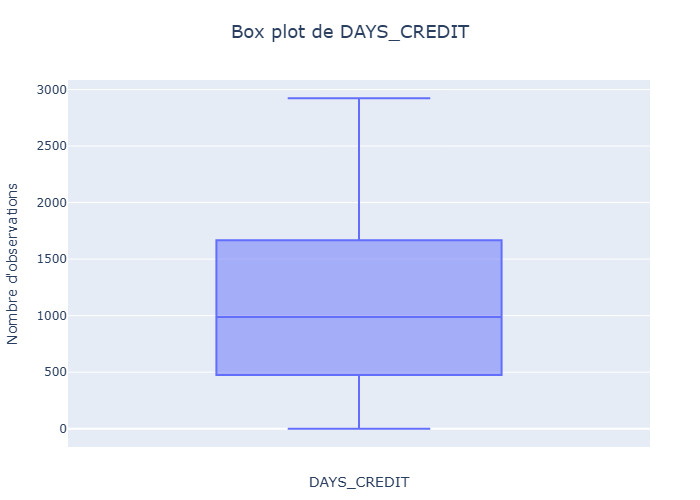

In [183]:
# Visualisation de la répartition pour la variable "DAYS_CREDIT".

plot_quantitative_box_violin(df_bureau, 
                            x="DAYS_CREDIT",
                            plot_type="box",
                            width=800,
                            height=700,
                            xaxis_title="DAYS_CREDIT",
                            yaxis_title="Nombre d'observations"
                            )

- Comme on peut le voir les valeurs vont de 0 à 3000 dans l'ensemble ce qui peut être compliqué à se représenter en terme de chiffre donc on pourrait changer l'échelle en année pour cette variable puisque une grande partie des demandes antérieures à la demande actuelle se chiffrent en une ou plusieurs années.

In [184]:
# Conversion en année de la variable "DAYS_CREDIT"

df_bureau['YEARS_CREDIT'] = df_bureau['DAYS_CREDIT'] / 365

In [185]:
df_bureau['YEARS_CREDIT'].describe().round(1)

count    1716428.0
mean           3.1
std            2.2
min            0.0
25%            1.3
50%            2.7
75%            4.6
max            8.0
Name: YEARS_CREDIT, dtype: float64

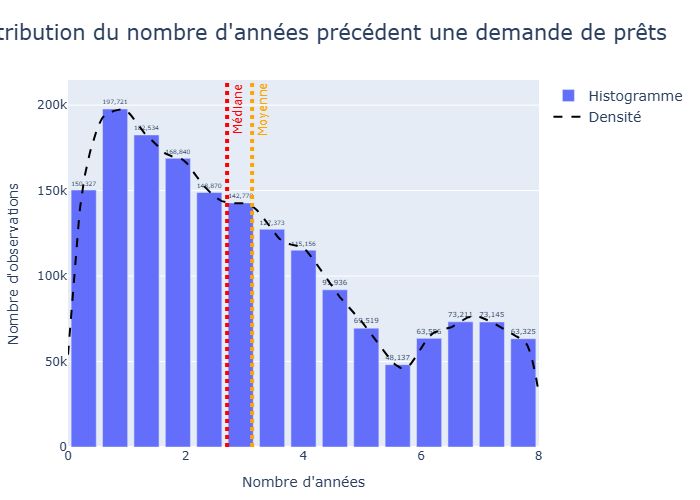

In [186]:
# Visualisation de la répartition pour la variable "YEARS_CREDIT".

plot_quantitative_histogram(
    df_bureau,
    x='YEARS_CREDIT',
    title="Distribution du nombre d'années précédent une demande de prêts",
    title_layout={"x": 0.45},
    title_font_size=21,
    xaxis_title="Nombre d'années",
    yaxis_title="Nombre d'observations",
    density=True,
    show_mean=True,
    show_median=True,
    width=1000,
    height=600
)

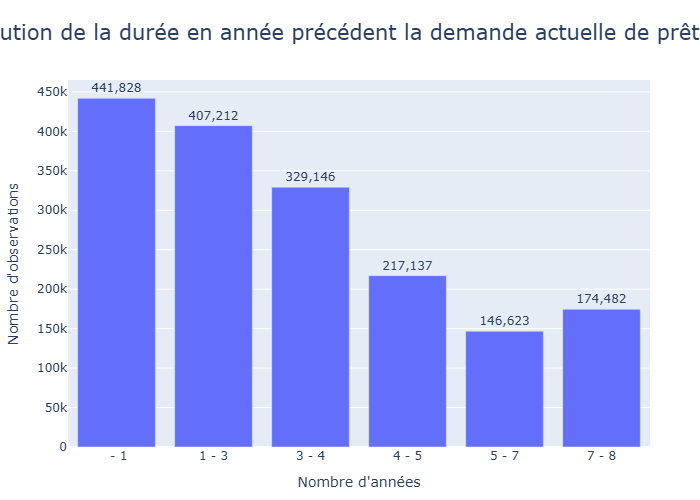

In [187]:
# Visualisation de la répartition pour la variable "YEARS_CREDIT".

plot_quantitative_histogram(
    df_bureau,
    x='YEARS_CREDIT',
    nbins= 6,
    title="Distribution de la durée en année précédent la demande actuelle de prêt",
    title_layout={"x": 0.45},
    title_font_size=21,
    xaxis_title="Nombre d'années",
    yaxis_title="Nombre d'observations",
    density=True,
    show_mean=True,
    show_median=True,
    bin_as_category=True,
    width=1000,
    height=600
)

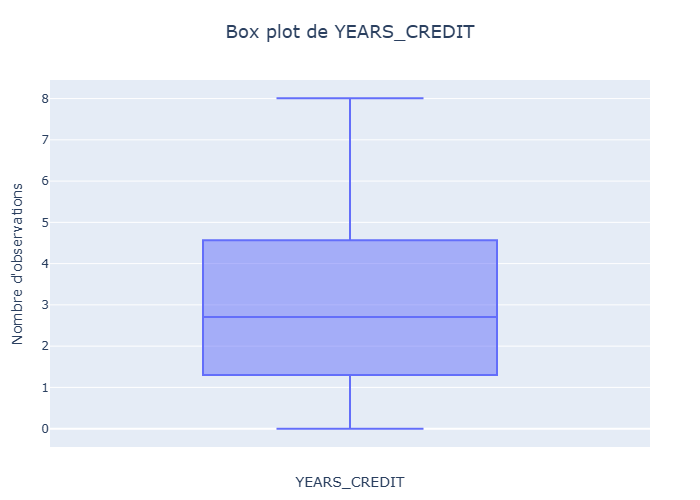

In [188]:
# Visualisation de la répartition pour la variable "YEARS_CREDIT".

plot_quantitative_box_violin(df_bureau, 
                            x="YEARS_CREDIT",
                            plot_type="box",
                            width=800,
                            height=700,
                            xaxis_title="YEARS_CREDIT",
                            yaxis_title="Nombre d'observations"
                            )

- Il est maintenant plus facile de se représenter les durées précédent la demande de prêt actuelle. En effet, on peut voir que cela va de **0** a **8** ans.
- On peut voir que près de *75 %* des demandes mettent entre **0** et **4.5** ans pour aboutir et que la moustache supérieure est étalé sur plage de valeur quasiment aussi importante qui va de **4.5** à **8** ans ce qui est assez conséquent pour les plus longues durées.
- Il est donc intéressant de comparer par rapport à la variable "Target" pour voir si il y a une relation entre ces deux variables.

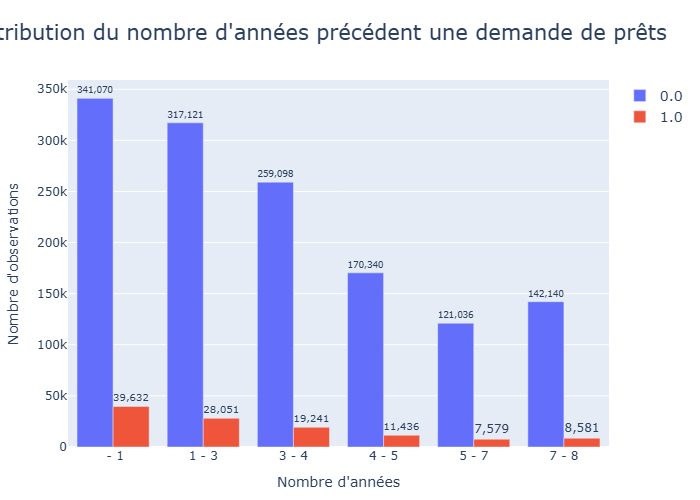

In [189]:
# Visualisation de la répartition pour la variable "YEARS_CREDIT" avec la Target.

plot_quantitative_histogram(
    df_bureau,
    x='YEARS_CREDIT',
    color='TARGET',
    nbins= 6,
    title="Distribution du nombre d'années précédent une demande de prêts",
    title_layout={"x": 0.45},
    title_font_size=21,
    xaxis_title="Nombre d'années",
    yaxis_title="Nombre d'observations",
    density=True,
    show_mean=True,
    show_median=True,
    bin_as_category=True,
    width=1000,
    height=600
)

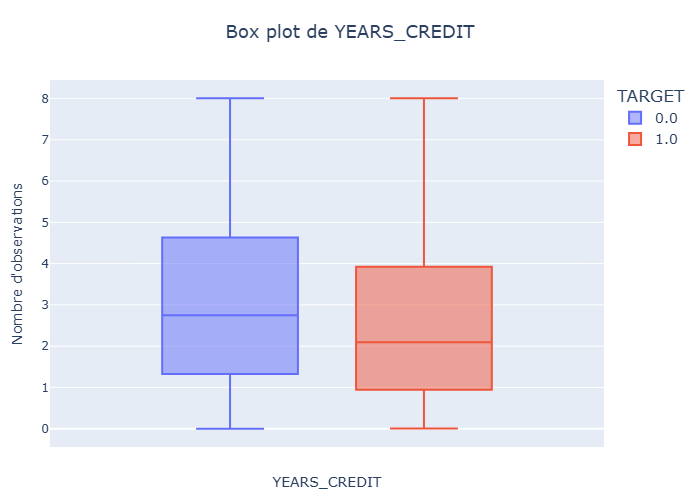

In [190]:
# Visualisation de la répartition pour la variable "YEARS_CREDIT" avec la Target.

plot_quantitative_box_violin(df_bureau, 
                            x="YEARS_CREDIT",
                            plot_type="box",
                            color='TARGET',
                            width=800,
                            height=700,
                            xaxis_title="YEARS_CREDIT",
                            yaxis_title="Nombre d'observations"
                            )

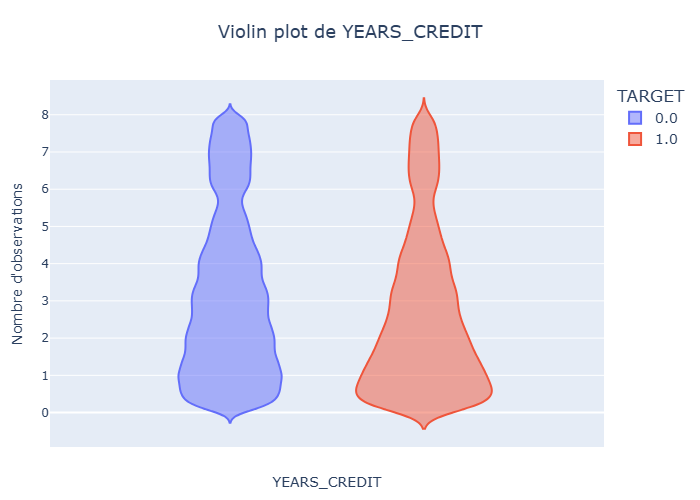

In [191]:
# Visualisation de la répartition pour la variable "YEARS_CREDIT" avec la Target.

plot_quantitative_box_violin(df_bureau, 
                            x="YEARS_CREDIT",
                            plot_type="violin",
                            color='TARGET',
                            width=800,
                            height=700,
                            xaxis_title="YEARS_CREDIT",
                            yaxis_title="Nombre d'observations"
                            )

- On observe assez logiquement une concentration de prêt defaillant plus importante pour les durées les plus faibles. Toutefois dans l'ensemble on retrouve des clients defaillant sur la même plage de valeurs que pour les clients non défaillants sans observer d'outliers pour Target = 1.

In [ ]:
# Création d'une fonction pour visualiser le taux de défaillance pour des variables quantitatives.

'''def plot_defaillance_rate_per_quantitative(df, quant_var, target_var='TARGET', nbins=10,
                                           title=None, width=800, height=500,
                                           title_layout=None, legend_layout=None,
                                           xaxis_title=None, yaxis_title=None,
                                           color_scale='Reds', show_legend=False,
                                           title_font_size=18, tickangle=0,
                                           margin=None, min_quantile=0.0, max_quantile=1.0):
    """
    Affiche le taux de défaillance (TARGET=1) en divisant une variable quantitative en tranches (bins).
    """

    def format_number(n):
        if n >= 1_000_000_000:
            return f"{n/1_000_000_000:.1f} Md"
        elif n >= 1_000_000:
            return f"{n/1_000_000:.1f} M"
        elif n >= 1_000:
            return f"{n/1_000:.0f} k"
        else:
            return f"{int(n)}"

    df = df[[quant_var, target_var]].dropna().copy()

    # Limitation selon quantiles
    q_min = df[quant_var].quantile(min_quantile)
    q_max = df[quant_var].quantile(max_quantile)
    df = df[(df[quant_var] >= q_min) & (df[quant_var] <= q_max)]

    # Binning avec libellés formatés
    bins = np.linspace(df[quant_var].min(), df[quant_var].max(), nbins + 1)
    labels = [f"{format_number(bins[i])} - {format_number(bins[i+1])}" for i in range(len(bins) - 1)]
    df["bin"] = pd.cut(df[quant_var], bins=bins, labels=labels, include_lowest=True)

    # Taux de défaillance
    grouped = df.groupby("bin")[target_var]
    def_rate = (grouped.sum() / grouped.count() * 100).sort_index()

    # Bar plot
    fig = go.Figure(data=[
        go.Bar(
            x=def_rate.index.astype(str),
            y=def_rate.values,
            text=[f"{v:.2f}%" for v in def_rate.values],
            textposition='auto',
            marker=dict(color=def_rate.values, colorscale=color_scale),
            showlegend=show_legend
        )
    ])

    # Mise en page
    title = title or f"Taux de défaillance par tranche de '{quant_var}'"
    title_dict = {"text": title, "font": dict(size=title_font_size)}
    if title_layout:
        title_dict.update(title_layout)

    fig.update_layout(
        title=title_dict,
        xaxis=dict(
            title=xaxis_title or f"Tranches de {quant_var}",
            tickangle=tickangle
        ),
        yaxis=dict(
            title=yaxis_title or f"Taux de {target_var} (%)"
        ),
        width=width,
        height=height,
        margin=margin or dict(t=80, b=60, l=60, r=60),
        showlegend=show_legend
    )

    if legend_layout:
        fig.update_layout(legend=legend_layout)

    fig.show()'''

In [193]:
def plot_defaillance_rate_per_quantitative(df, quant_var, target_var='TARGET', nbins=10,
                                           title=None, width=800, height=500,
                                           title_layout=None, legend_layout=None,
                                           xaxis_title=None, yaxis_title=None,
                                           color_scale='Reds', show_legend=False,
                                           title_font_size=18, tickangle=0,
                                           margin=None, min_quantile=0.0, max_quantile=1.0,
                                           bin_range=None):
    """
    Affiche le taux de défaillance (TARGET=1) en divisant une variable quantitative en tranches (bins).
    """

    df = df[[quant_var, target_var]].dropna().copy()

    # Limitation selon quantiles
    q_min = df[quant_var].quantile(min_quantile)
    q_max = df[quant_var].quantile(max_quantile)
    df = df[(df[quant_var] >= q_min) & (df[quant_var] <= q_max)]

    # Définir plage des bins
    lo = df[quant_var].min() if bin_range is None else bin_range[0]
    hi = df[quant_var].max() if bin_range is None else bin_range[1]
    bins = np.linspace(lo, hi, nbins + 1)
    bins = np.unique(bins)  # sécurité contre les doublons

    # Déterminer précision nécessaire
    if len(bins) > 1:
        step = np.min(np.diff(bins))
        decimals = 0 if step >= 1 else max(1, int(np.ceil(-np.log10(step))))
    else:
        decimals = 2

    def fmt_edge(v):
        if abs(v) >= 1000:
            if v >= 1_000_000_000:
                return f"{v/1_000_000_000:.1f} Md"
            elif v >= 1_000_000:
                return f"{v/1_000_000:.1f} M"
            elif v >= 1000:
                return f"{v/1000:.0f} k"
        return f"{v:.{min(decimals,6)}f}".rstrip("0").rstrip(".")

    labels = [f"{fmt_edge(bins[i])} - {fmt_edge(bins[i+1])}" for i in range(len(bins) - 1)]

    df["bin"] = pd.cut(df[quant_var], bins=bins, labels=labels, include_lowest=True, ordered=True)

    # Taux de défaillance
    grouped = df.groupby("bin")[target_var]
    def_rate = (grouped.sum() / grouped.count() * 100).sort_index()

    # Bar plot
    fig = go.Figure(data=[
        go.Bar(
            x=def_rate.index.astype(str),
            y=def_rate.values,
            text=[f"{v:.2f}%" for v in def_rate.values],
            textposition='auto',
            marker=dict(color=def_rate.values, colorscale=color_scale),
            showlegend=show_legend
        )
    ])

    # Mise en page
    title = title or f"Taux de défaillance par tranche de '{quant_var}'"
    title_dict = {"text": title, "font": dict(size=title_font_size)}
    if title_layout:
        title_dict.update(title_layout)

    fig.update_layout(
        title=title_dict,
        xaxis=dict(
            title=xaxis_title or f"Tranches de {quant_var}",
            tickangle=tickangle
        ),
        yaxis=dict(
            title=yaxis_title or f"Taux de {target_var} (%)"
        ),
        width=width,
        height=height,
        margin=margin or dict(t=80, b=60, l=60, r=60),
        showlegend=show_legend
    )

    if legend_layout:
        fig.update_layout(legend=legend_layout)

    fig.show()

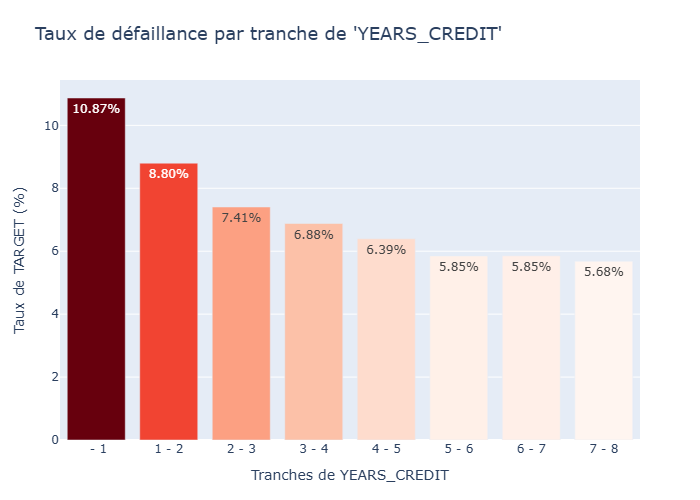

In [194]:
# Visualisation du taux de défaillance pour la variable "YEARS_CREDIT".

plot_defaillance_rate_per_quantitative(df_bureau, 
                                       "YEARS_CREDIT",
                                       target_var="TARGET",
                                       nbins=8)

- Avec ce graphique, on peut confirmer que plus la durée précédent la demande actuelle de prêt est courte plus le taux de défaillance est important d'autant plus qu'il y a plus de durée courte que longue comme on l'a vu précédemment. Cela peut constituer un élément intéressant pour la suite.
- On peut maintenant passer à la variable suivante :

In [195]:
df_bureau['CREDIT_DAY_OVERDUE'].describe().round(0)

count    1716428.0
mean           1.0
std           37.0
min            0.0
25%            0.0
50%            0.0
75%            0.0
max         2792.0
Name: CREDIT_DAY_OVERDUE, dtype: float64

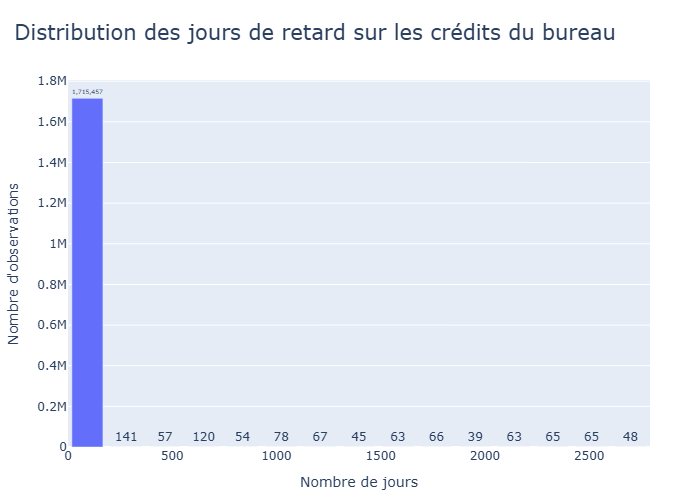

In [196]:
# Visualisation de la distribution pour la variable "CREDIT_DAY_OVERDUE".

plot_quantitative_histogram(
    df_bureau,
    x='CREDIT_DAY_OVERDUE',
    title="Distribution des jours de retard sur les crédits du bureau",
    title_layout={"x": 0.45},
    title_font_size=21,
    xaxis_title="Nombre de jours",
    yaxis_title="Nombre d'observations",
    width=1000,
    height=600
)

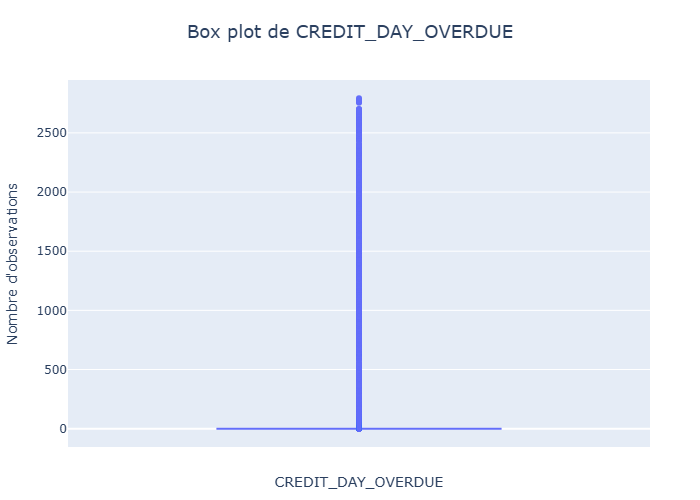

In [197]:
# Visualisation de la distribution pour la variable "CREDIT_DAY_OVERDUE".

plot_quantitative_box_violin(df_bureau, 
                            x="CREDIT_DAY_OVERDUE",
                            plot_type="box",
                            width=800,
                            height=700,
                            xaxis_title="CREDIT_DAY_OVERDUE",
                            yaxis_title="Nombre d'observations"
                            )

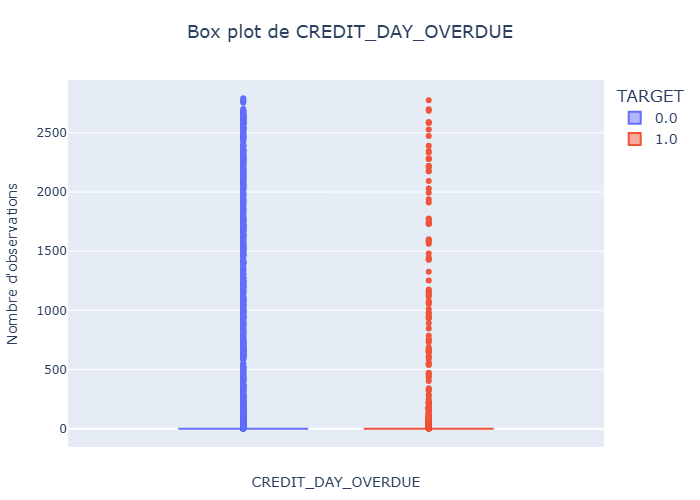

In [198]:
# Visualisation de la distribution pour la variable "CREDIT_DAY_OVERDUE".

plot_quantitative_box_violin(df_bureau, 
                            x="CREDIT_DAY_OVERDUE",
                            plot_type="box",
                            color='TARGET',
                            width=800,
                            height=700,
                            xaxis_title="CREDIT_DAY_OVERDUE",
                            yaxis_title="Nombre d'observations"
                            )

- Cette variable est peu intéressante puisque la quasi totalité des crédits ne présentent pas de valeurs supérieures à 0 donc il est difficile de mettre un lien entre la Target et la variable "CREDIT_DAY_OVERDUE".

In [199]:
df_bureau['DAYS_ENDDATE_FACT'].describe().round(0)

count    1082775.0
mean       -1017.0
std          714.0
min       -42023.0
25%        -1489.0
50%         -897.0
75%         -425.0
max            0.0
Name: DAYS_ENDDATE_FACT, dtype: float64

In [200]:
df_bureau['DAYS_ENDDATE_FACT'] = df_bureau['DAYS_ENDDATE_FACT'] * -1

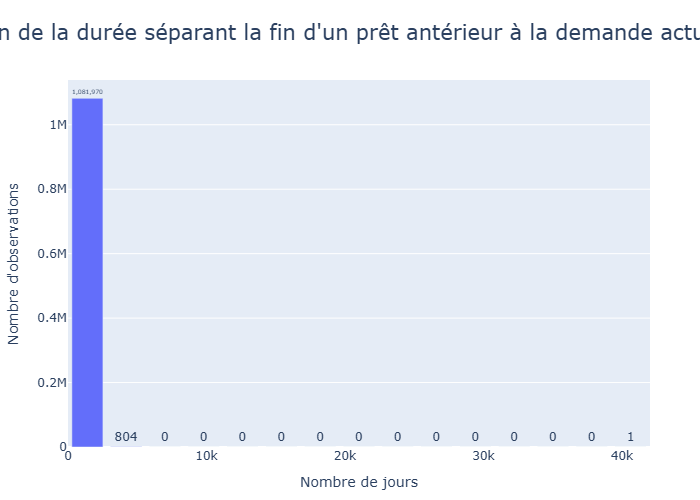

In [201]:
# Visualisation de la répartition pour la variable "DAYS_ENDDATE_FACT".

plot_quantitative_histogram(
    df_bureau,
    x='DAYS_ENDDATE_FACT',
    title="Distribution de la durée séparant la fin d'un prêt antérieur à la demande actuelle",
    title_layout={"x": 0.45},
    title_font_size=21,
    xaxis_title="Nombre de jours",
    yaxis_title="Nombre d'observations",
    width=1000,
    height=600
)

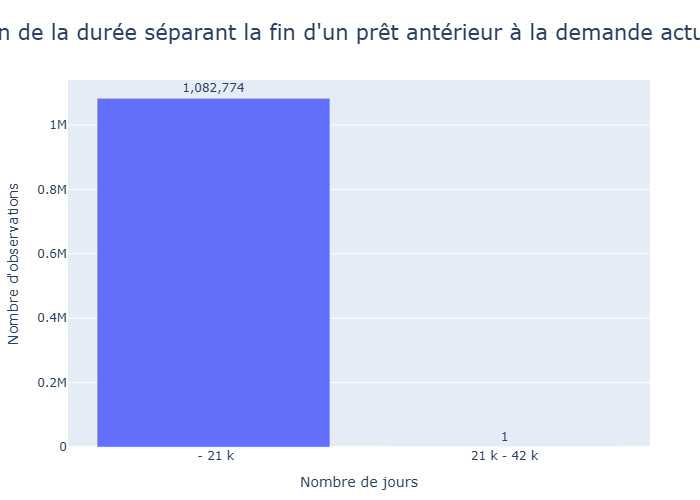

In [202]:
# Visualisation de la répartition pour la variable "YEARS_CREDIT".

plot_quantitative_histogram(
    df_bureau,
    x='DAYS_ENDDATE_FACT',
    nbins= 2,
    title="Distribution de la durée séparant la fin d'un prêt antérieur à la demande actuelle",
    title_layout={"x": 0.45},
    title_font_size=21,
    xaxis_title="Nombre de jours",
    yaxis_title="Nombre d'observations",
    density=True,
    show_mean=True,
    show_median=True,
    bin_as_category=True,
    width=1000,
    height=600
)

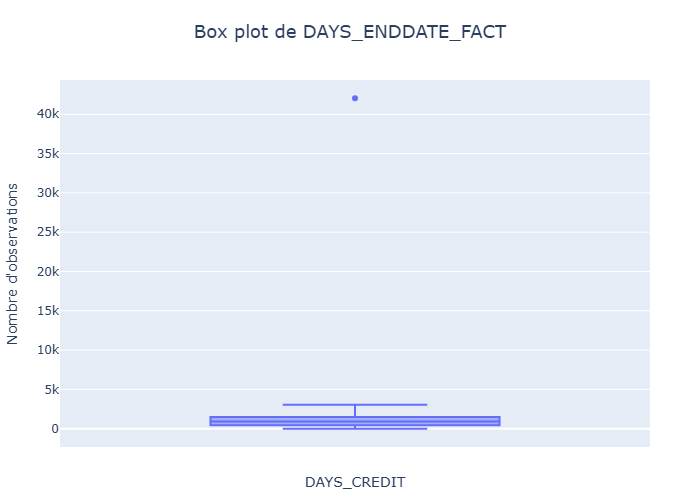

In [203]:
plot_quantitative_box_violin(df_bureau, 
                            x="DAYS_ENDDATE_FACT",
                            plot_type="box",
                            width=800,
                            height=700,
                            xaxis_title="DAYS_CREDIT",
                            yaxis_title="Nombre d'observations"
                            )

- Comme on peut le voir il y a un petit soucis puisque l'on atteint plus de 100 ans pour cetaines durées ce qui n'est pas possible donc il faudra arranger cela plus tard.
- Pour avoir une meilleure visibilité, on ne prendra pas en compte les valeurs extrêmes.

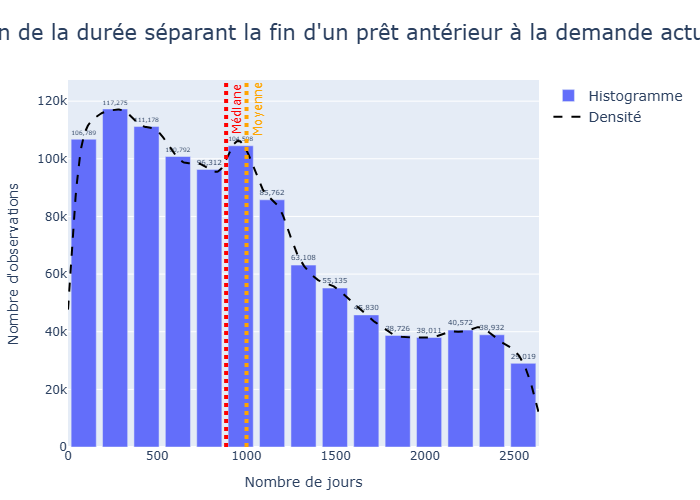

In [204]:
# Visualisation de la répartition pour la variable "YEARS_CREDIT".

plot_quantitative_histogram(
    df_bureau,
    x='DAYS_ENDDATE_FACT',
    title="Distribution de la durée séparant la fin d'un prêt antérieur à la demande actuelle",
    title_layout={"x": 0.45},
    title_font_size=21,
    xaxis_title="Nombre de jours",
    yaxis_title="Nombre d'observations",
    density=True,
    show_mean=True,
    show_median=True,
    max_quantile= 0.99,
    width=1000,
    height=600
)

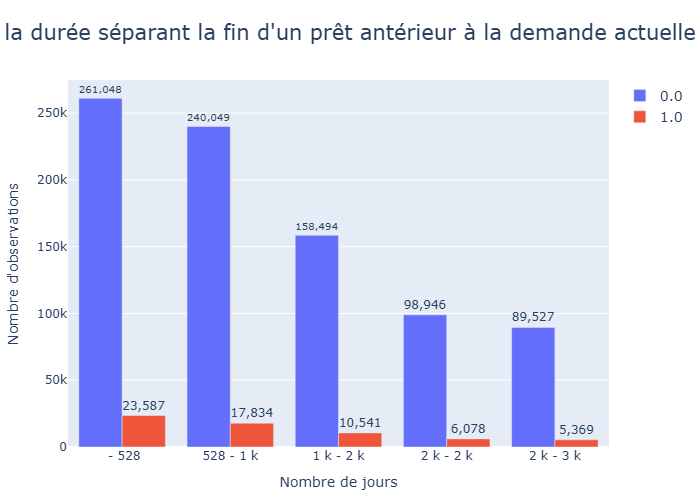

In [205]:
# Visualisation de la répartition pour la variable "YEARS_CREDIT" avec la Target.

plot_quantitative_histogram(
    df_bureau,
    x='DAYS_ENDDATE_FACT',
    color='TARGET',
    nbins= 5,
    title="Distribution de la durée séparant la fin d'un prêt antérieur à la demande actuelle (Target)",
    title_layout={"x": 0.45},
    title_font_size=21,
    xaxis_title="Nombre de jours",
    yaxis_title="Nombre d'observations",
    bin_as_category=True,
    max_quantile= 0.99,
    width=1000,
    height=600
)

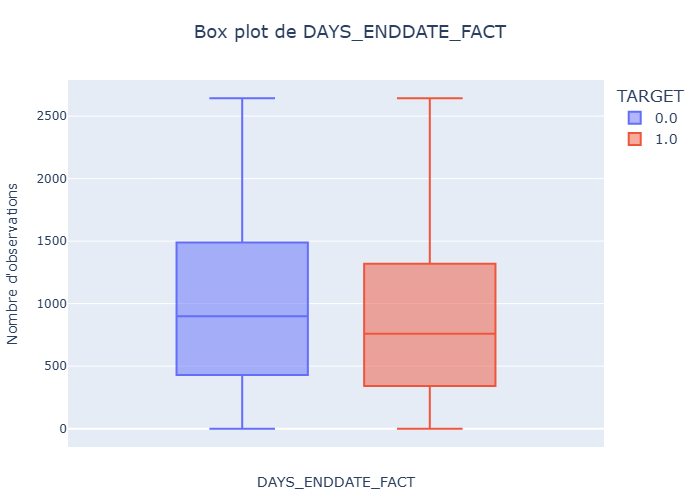

In [206]:
# Visualisation de la répartition pour la variable "DAYS_ENDDATE_FACT"

plot_quantitative_box_violin(df_bureau, 
                            x="DAYS_ENDDATE_FACT",
                            plot_type="box",
                            color='TARGET',
                            width=800,
                            height=700,
                            xaxis_title="DAYS_ENDDATE_FACT",
                            yaxis_title="Nombre d'observations",
                            max_quantile=0.99
                            )

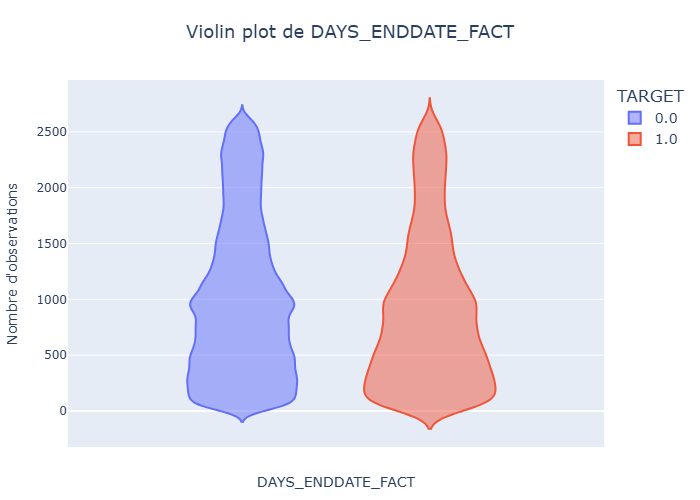

In [207]:
# Visualisation de la répartition pour la variable "YEARS_CREDIT" avec la Target.

plot_quantitative_box_violin(df_bureau, 
                            x="DAYS_ENDDATE_FACT",
                            plot_type="violin",
                            color='TARGET',
                            max_quantile=0.99,
                            width=800,
                            height=700,
                            xaxis_title="DAYS_ENDDATE_FACT",
                            yaxis_title="Nombre d'observations"
                            )

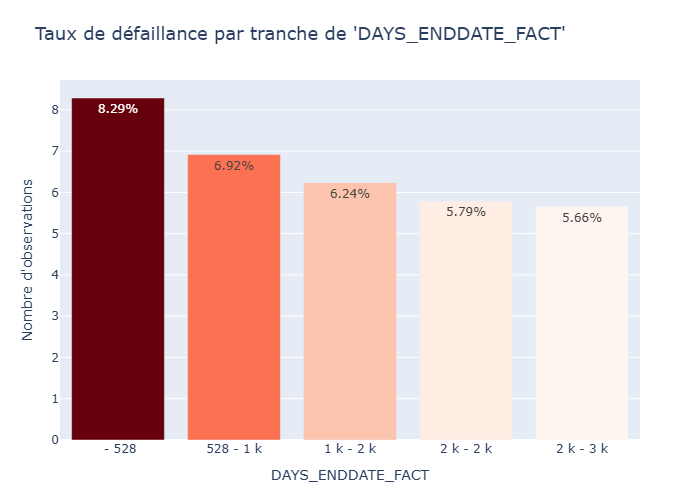

In [208]:
# Visualisation du taux de défaillance pour la variable "DAYS_ENDDATE_FACT".

plot_defaillance_rate_per_quantitative(df_bureau, 
                                       "DAYS_ENDDATE_FACT",
                                       target_var="TARGET",
                                       nbins=5,
                                       width=800,
                                       height=700,
                                       xaxis_title="DAYS_ENDDATE_FACT",
                                       yaxis_title="Nombre d'observations",
                                       max_quantile=0.99)

- Globalement on constate que les clients qui ont terminé de rembourser un prêt plus récemment sont plus souvent dans une situation de défaillance.

In [209]:
df_bureau['AMT_CREDIT_MAX_OVERDUE'].describe().round(0) 

count       591940.0
mean          3825.0
std         206032.0
min              0.0
25%              0.0
50%              0.0
75%              0.0
max      115987185.0
Name: AMT_CREDIT_MAX_OVERDUE, dtype: float64

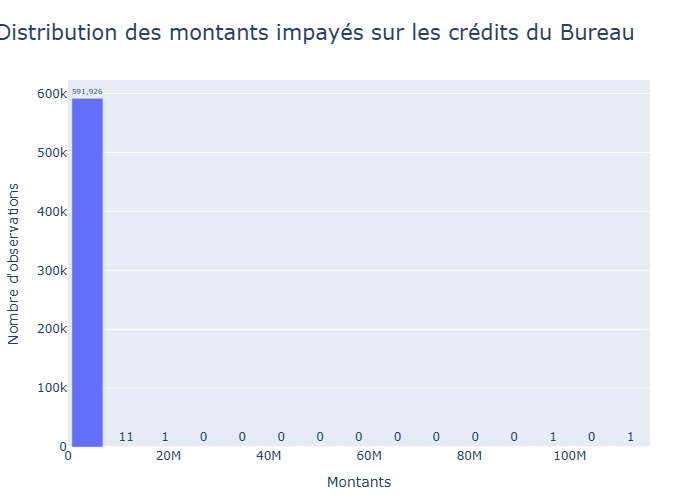

In [210]:
# Visualisation de la répartition pour la variable "AMT_CREDIT_MAX_OVERDUE".

plot_quantitative_histogram(
    df_bureau,
    x='AMT_CREDIT_MAX_OVERDUE',
    title="Distribution des montants impayés sur les crédits du Bureau",
    title_layout={"x": 0.45},
    title_font_size=21,
    xaxis_title="Montants",
    yaxis_title="Nombre d'observations",
    width=1000,
    height=600
)

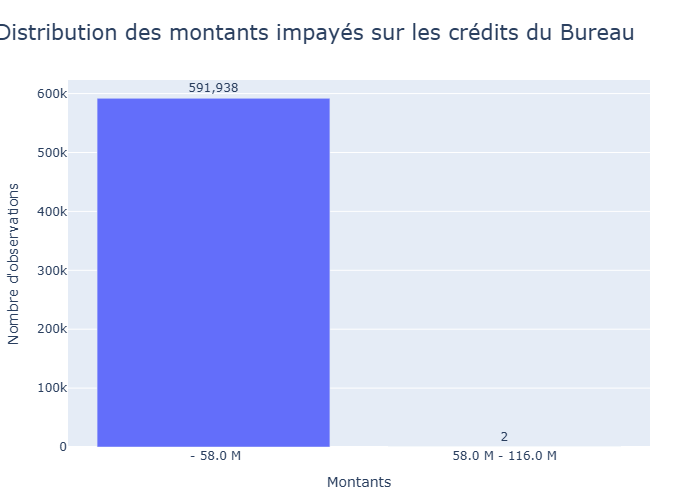

In [211]:
# Visualisation de la répartition pour la variable "AMT_CREDIT_MAX_OVERDUE".

plot_quantitative_histogram(
    df_bureau,
    x='AMT_CREDIT_MAX_OVERDUE',
    nbins= 2,
    title="Distribution des montants impayés sur les crédits du Bureau",
    title_layout={"x": 0.45},
    title_font_size=21,
    xaxis_title="Montants",
    yaxis_title="Nombre d'observations",
    bin_as_category=True,
    width=1000,
    height=600
)

In [212]:
len(df_bureau.loc[df_bureau["AMT_CREDIT_MAX_OVERDUE"] > 0])

121290

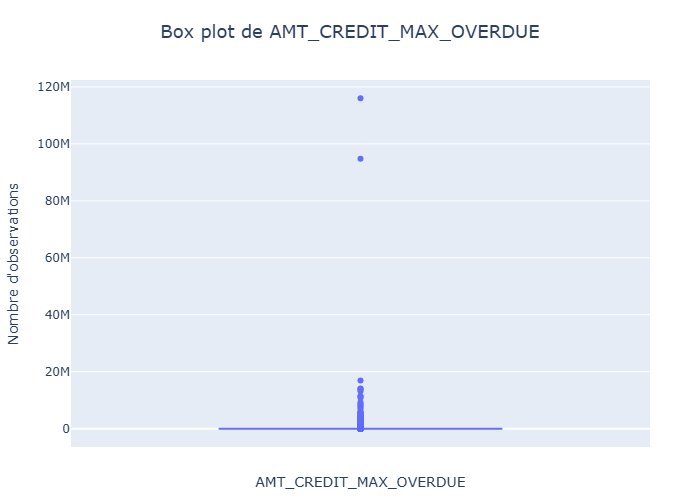

In [213]:
plot_quantitative_box_violin(df_bureau, 
                            x="AMT_CREDIT_MAX_OVERDUE",
                            plot_type="box",
                            width=800,
                            height=700,
                            xaxis_title="AMT_CREDIT_MAX_OVERDUE",
                            yaxis_title="Nombre d'observations"
                            )

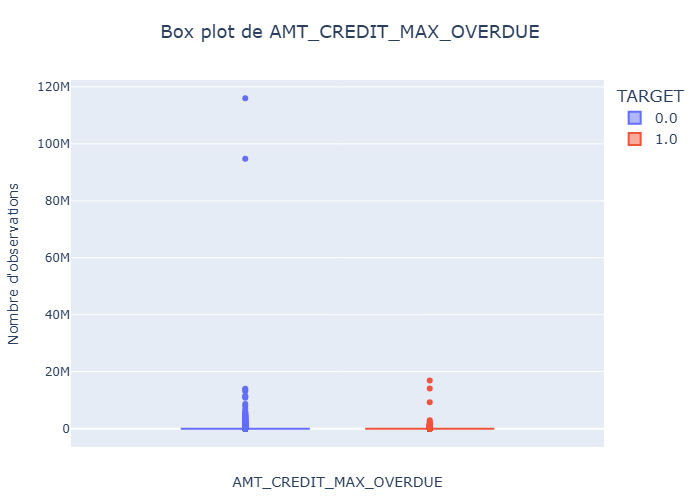

In [214]:
plot_quantitative_box_violin(df_bureau, 
                            x="AMT_CREDIT_MAX_OVERDUE",
                            plot_type="box",
                            color="TARGET",
                            width=800,
                            height=700,
                            xaxis_title="AMT_CREDIT_MAX_OVERDUE",
                            yaxis_title="Nombre d'observations"
                            )

- Globalement, la grande majorité des clients n'a pas de montants impayés toutefois on retrouve tout de même un certains nombre d'outliers dont les sommes sont très importantes (pour atteindre près de 120M)

In [215]:
df_bureau['CNT_CREDIT_PROLONG'].describe().round(1)

count    1716428.0
mean           0.0
std            0.1
min            0.0
25%            0.0
50%            0.0
75%            0.0
max            9.0
Name: CNT_CREDIT_PROLONG, dtype: float64

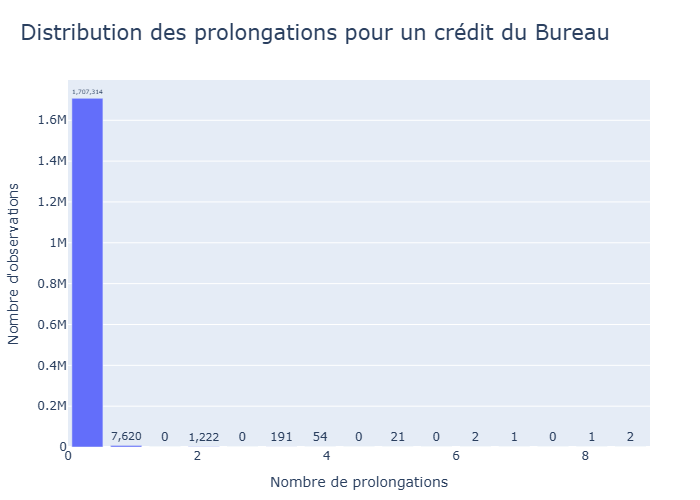

In [216]:
# Visualisation de la répartition pour la variable "CNT_CREDIT_PROLONG".

plot_quantitative_histogram(
    df_bureau,
    x='CNT_CREDIT_PROLONG',
    title="Distribution des prolongations pour un crédit du Bureau",
    title_layout={"x": 0.45},
    title_font_size=21,
    xaxis_title="Nombre de prolongations",
    yaxis_title="Nombre d'observations",
    width=1000,
    height=600
)

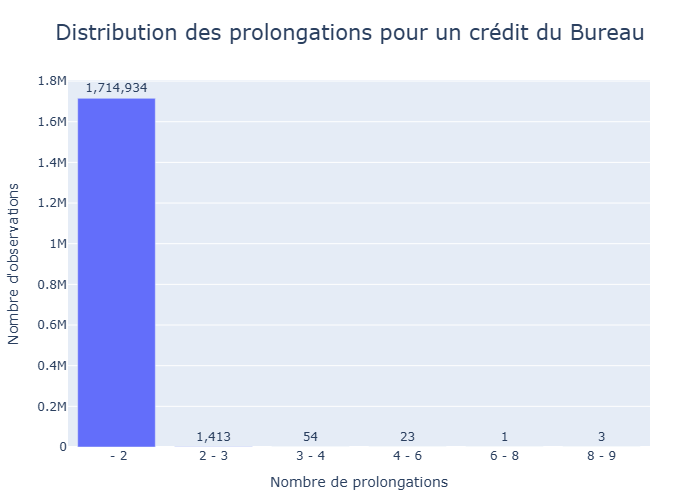

In [217]:
# Visualisation de la répartition pour la variable "CNT_CREDIT_PROLONG".

plot_quantitative_histogram(
    df_bureau,
    x='CNT_CREDIT_PROLONG',
    nbins= 6,
    title="Distribution des prolongations pour un crédit du Bureau",
    title_layout={"x": 0.5},
    title_font_size=21,
    xaxis_title="Nombre de prolongations",
    yaxis_title="Nombre d'observations",
    bin_as_category=True,
    width=1000,
    height=600
)

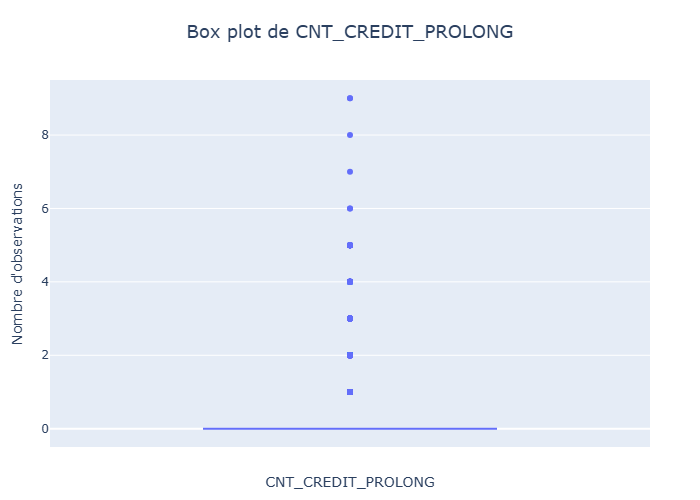

In [218]:
# Visualisation de la répartition pour la variable "CNT_CREDIT_PROLONG".

plot_quantitative_box_violin(df_bureau, 
                            x="CNT_CREDIT_PROLONG",
                            plot_type="box",
                            width=800,
                            height=700,
                            xaxis_title="CNT_CREDIT_PROLONG",
                            yaxis_title="Nombre d'observations"
                            )

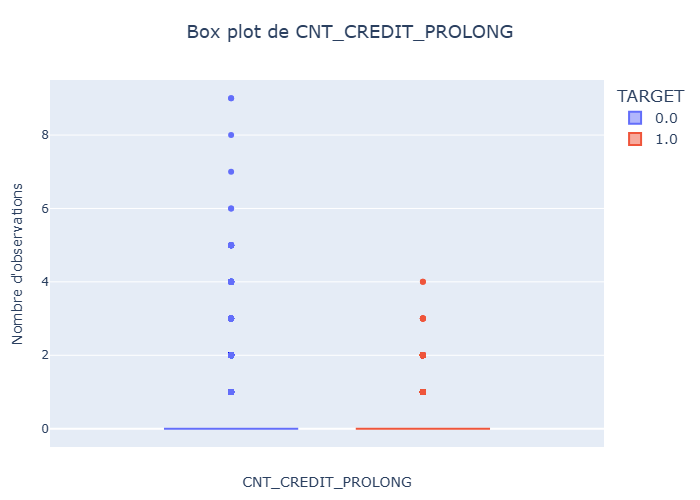

In [219]:
# Visualisation de la répartition pour la variable "CNT_CREDIT_PROLONG" avec la Target.

plot_quantitative_box_violin(df_bureau, 
                            x="CNT_CREDIT_PROLONG",
                            plot_type="box",
                            color='TARGET',
                            width=800,
                            height=700,
                            xaxis_title="CNT_CREDIT_PROLONG",
                            yaxis_title="Nombre d'observations"
                            )

- Il y a très peu de prolongations de crédit dans notre échantillon et lorsque l'on compare les clients défaillants et non défaillants, on remarque que les défaillants bénéficient peut être moins souvent de prolongations.

In [220]:
df_bureau['AMT_CREDIT_SUM'].describe().round(0)

count      1716415.0
mean        354995.0
std        1149811.0
min              0.0
25%          51300.0
50%         125518.0
75%         315000.0
max      585000000.0
Name: AMT_CREDIT_SUM, dtype: float64

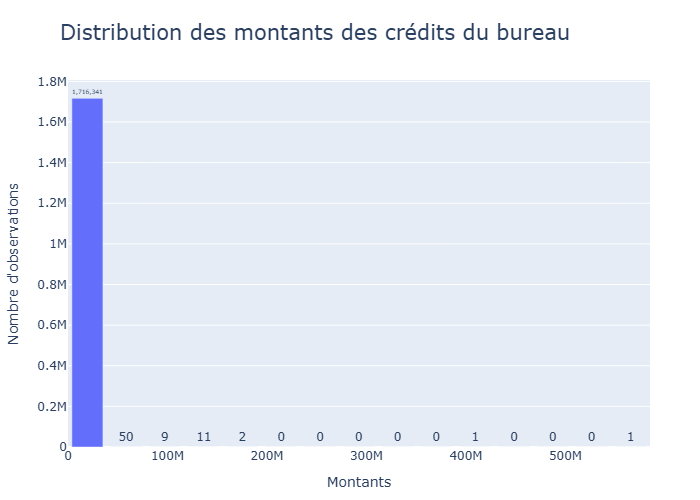

In [221]:
# Visualisation de la répartition pour la variable "AMT_CREDIT_SUM".

plot_quantitative_histogram(
    df_bureau,
    x='AMT_CREDIT_SUM',
    title="Distribution des montants des crédits du bureau",
    title_layout={"x": 0.45},
    title_font_size=21,
    xaxis_title="Montants",
    yaxis_title="Nombre d'observations",
    width=1000,
    height=600
)

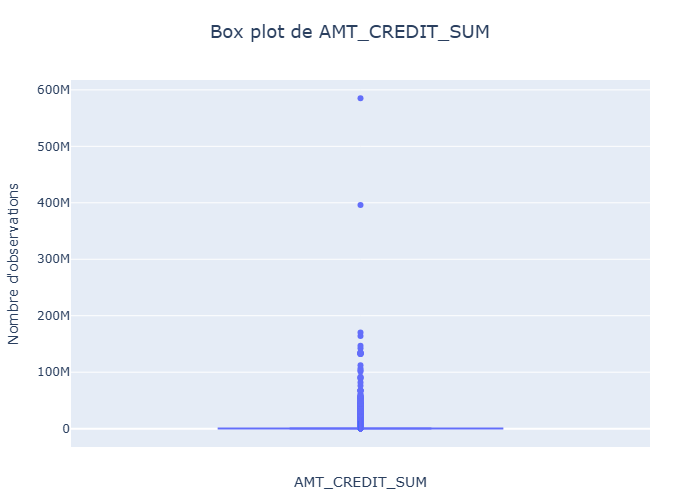

In [222]:
plot_quantitative_box_violin(df_bureau, 
                            x="AMT_CREDIT_SUM",
                            plot_type="box",
                            width=800,
                            height=700,
                            xaxis_title="AMT_CREDIT_SUM",
                            yaxis_title="Nombre d'observations"
                            )

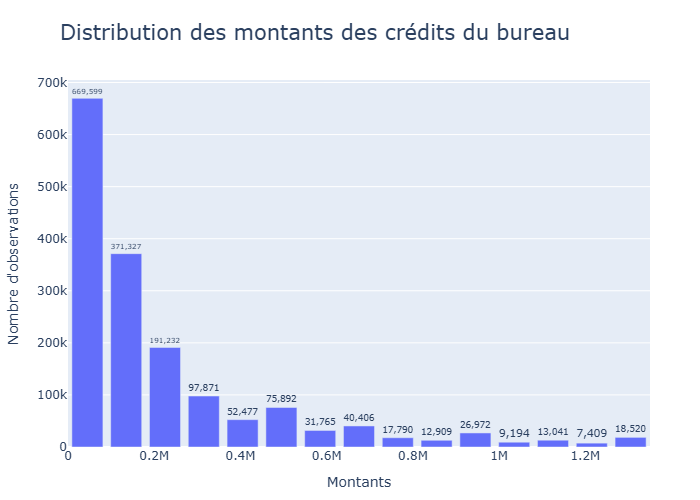

In [223]:
# Visualisation de la répartition pour la variable "AMT_CREDIT_SUM".

plot_quantitative_histogram(
    df_bureau,
    x='AMT_CREDIT_SUM',
    max_quantile=0.95,
    title="Distribution des montants des crédits du bureau",
    title_layout={"x": 0.45},
    title_font_size=21,
    xaxis_title="Montants",
    yaxis_title="Nombre d'observations",
    width=1000,
    height=600
)

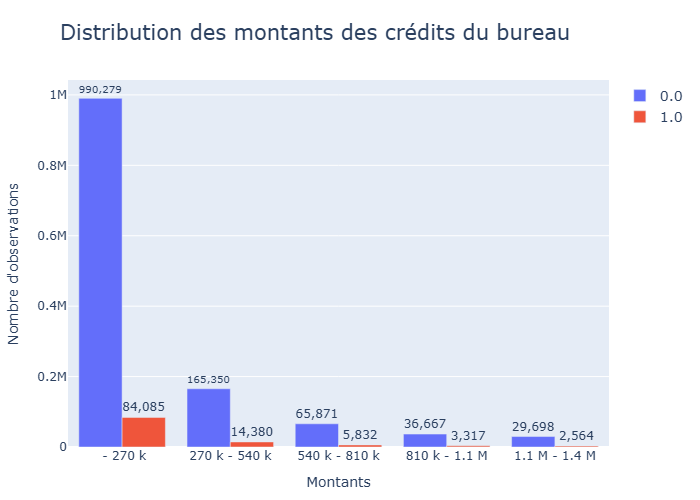

In [224]:
# Visualisation de la répartition pour la variable "AMT_CREDIT_SUM" (95% inf).

plot_quantitative_histogram(
    df_bureau,
    x='AMT_CREDIT_SUM',
    color='TARGET',
    nbins=5,
    max_quantile=0.95,
    title="Distribution des montants des crédits du bureau",
    title_layout={"x": 0.45},
    title_font_size=21,
    xaxis_title="Montants",
    yaxis_title="Nombre d'observations",
    bin_as_category=True,
    width=1000,
    height=600
)

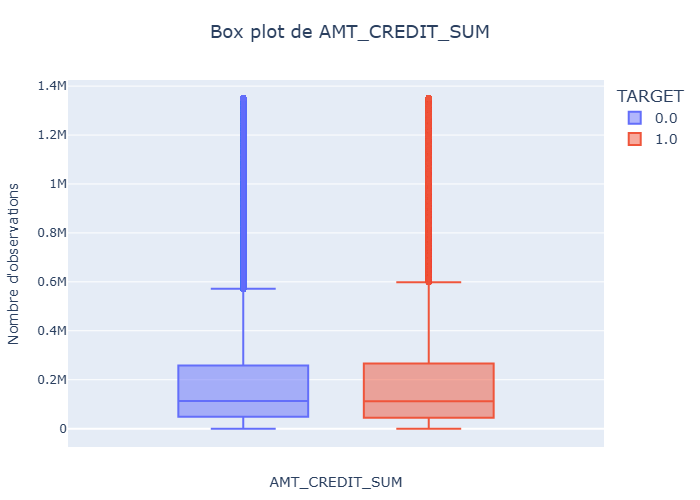

In [225]:
# Visualisation de la répartition pour la variable "AMT_CREDIT_SUM"

plot_quantitative_box_violin(df_bureau, 
                            x="AMT_CREDIT_SUM",
                            plot_type="box",
                            color='TARGET',
                            width=800,
                            height=700,
                            xaxis_title="AMT_CREDIT_SUM",
                            yaxis_title="Nombre d'observations",
                            max_quantile=0.95
                            )

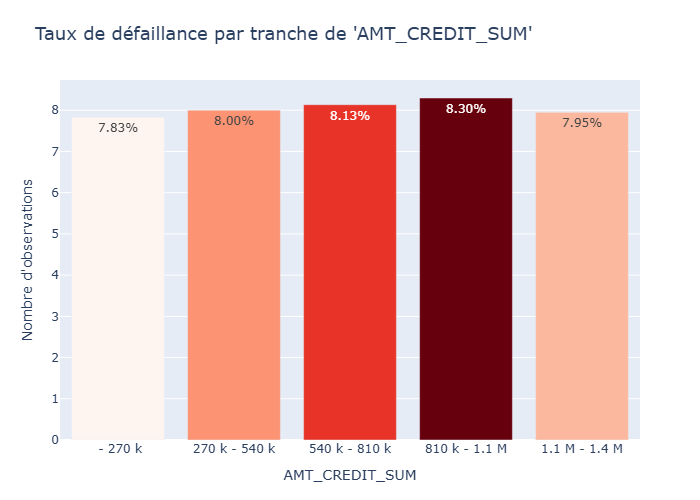

In [226]:
# Visualisation du taux de défaillance pour la variable "AMT_CREDIT_SUM".

plot_defaillance_rate_per_quantitative(df_bureau, 
                                       "AMT_CREDIT_SUM",
                                       target_var="TARGET",
                                       nbins=5,
                                       width=800,
                                       height=700,
                                       xaxis_title="AMT_CREDIT_SUM",
                                       yaxis_title="Nombre d'observations",
                                       max_quantile=0.95)

- On observe des distributions assez similaires et il ne semble pas y avoir de lien évident entre le montant des crédits et la défaillance observée.

In [227]:
df_bureau['AMT_CREDIT_SUM_DEBT'].describe().round(1)

count      1458759.0
mean        137085.1
std         677401.1
min       -4705600.3
25%              0.0
50%              0.0
75%          40153.5
max      170100000.0
Name: AMT_CREDIT_SUM_DEBT, dtype: float64

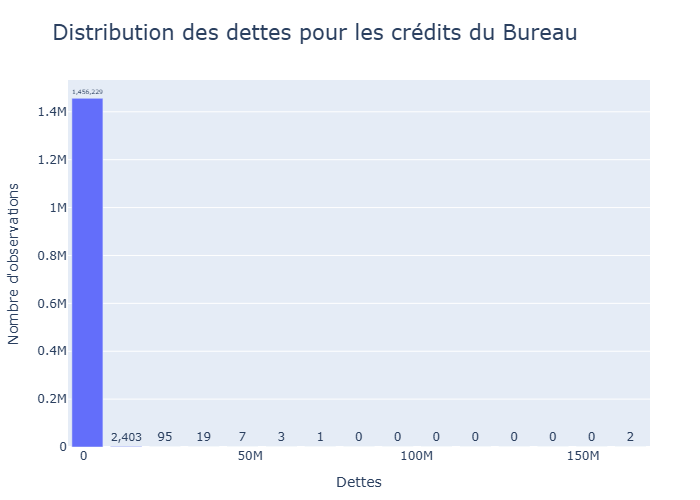

In [228]:
# Visualisation de la répartition pour la variable "AMT_CREDIT_SUM_DEBT".

plot_quantitative_histogram(
    df_bureau,
    x='AMT_CREDIT_SUM_DEBT',
    title="Distribution des dettes pour les crédits du Bureau",
    title_layout={"x": 0.45},
    title_font_size=21,
    xaxis_title="Dettes",
    yaxis_title="Nombre d'observations",
    width=1000,
    height=600
)

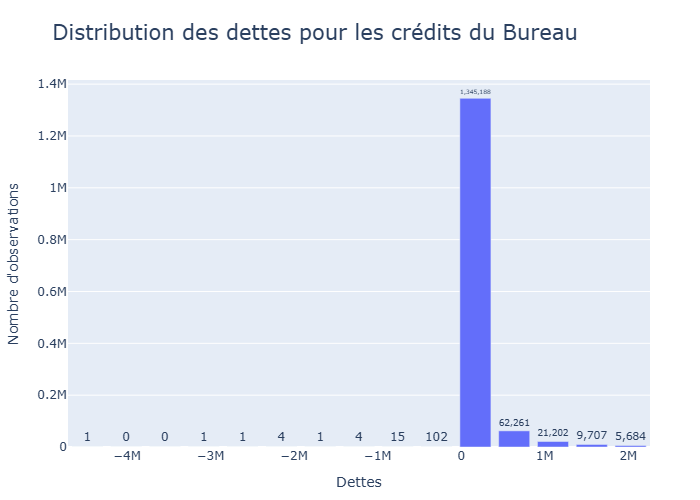

In [229]:
# Visualisation de la répartition pour la variable "AMT_CREDIT_SUM_DEBT".

plot_quantitative_histogram(
    df_bureau,
    x='AMT_CREDIT_SUM_DEBT',
    title="Distribution des dettes pour les crédits du Bureau",
    title_layout={"x": 0.45},
    title_font_size=21,
    xaxis_title="Dettes",
    yaxis_title="Nombre d'observations",
    max_quantile= 0.99,
    width=1000,
    height=600
)

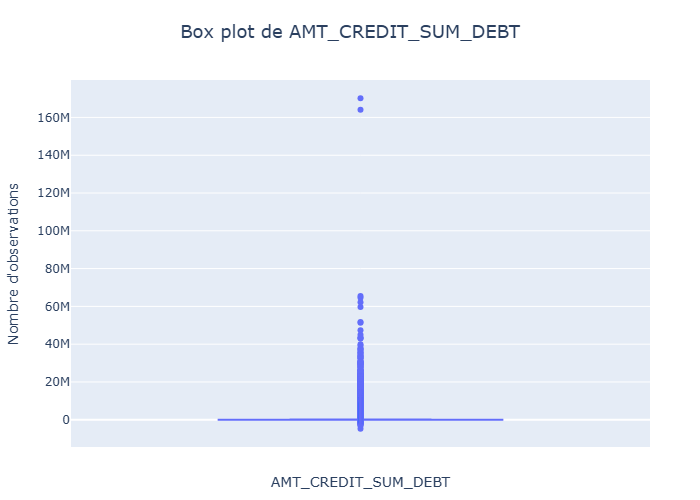

In [230]:
# Visualisation de la répartition pour la variable "AMT_CREDIT_SUM_DEBT".

plot_quantitative_box_violin(df_bureau, 
                            x="AMT_CREDIT_SUM_DEBT",
                            plot_type="box",
                            width=800,
                            height=700,
                            xaxis_title="AMT_CREDIT_SUM_DEBT",
                            yaxis_title="Nombre d'observations"
                            )

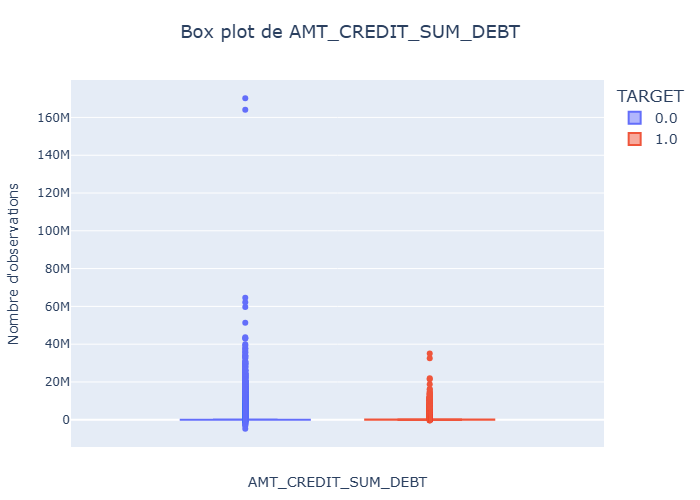

In [231]:
# Visualisation de la répartition pour la variable "AMT_CREDIT_SUM_DEBT".

plot_quantitative_box_violin(df_bureau, 
                            x="AMT_CREDIT_SUM_DEBT",
                            color="TARGET",
                            plot_type="box",
                            width=800,
                            height=700,
                            xaxis_title="AMT_CREDIT_SUM_DEBT",
                            yaxis_title="Nombre d'observations"
                            )

- Cette variable ne parait pas influencer de manière déterminante notre variable TARGET, on pourra sans doute la supprimer plus tard.

In [232]:
df_bureau['AMT_CREDIT_SUM_LIMIT'].describe().round(1)

count    1124648.0
mean        6229.5
std        45032.0
min      -586406.1
25%            0.0
50%            0.0
75%            0.0
max      4705600.3
Name: AMT_CREDIT_SUM_LIMIT, dtype: float64

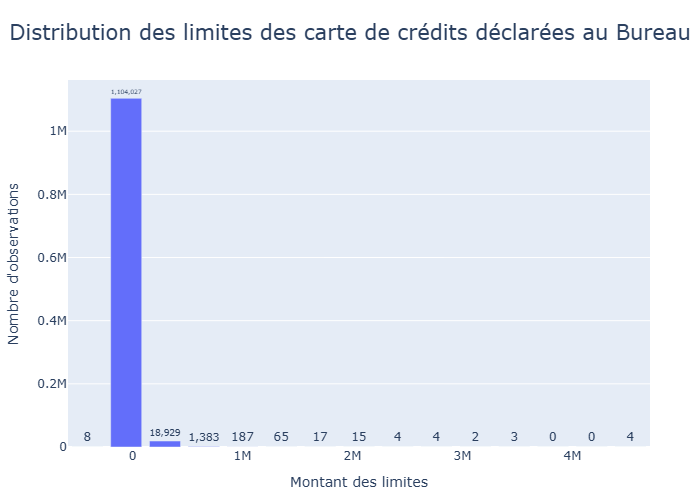

In [233]:
# Visualisation de la distribution pour la variable "AMT_CREDIT_SUM_LIMIT".

plot_quantitative_histogram(
    df_bureau,
    x='AMT_CREDIT_SUM_LIMIT',
    title="Distribution des limites des carte de crédits déclarées au Bureau",
    title_layout={"x": 0.5},
    title_font_size=21,
    xaxis_title="Montant des limites",
    yaxis_title="Nombre d'observations",
    width=1000,
    height=600
)

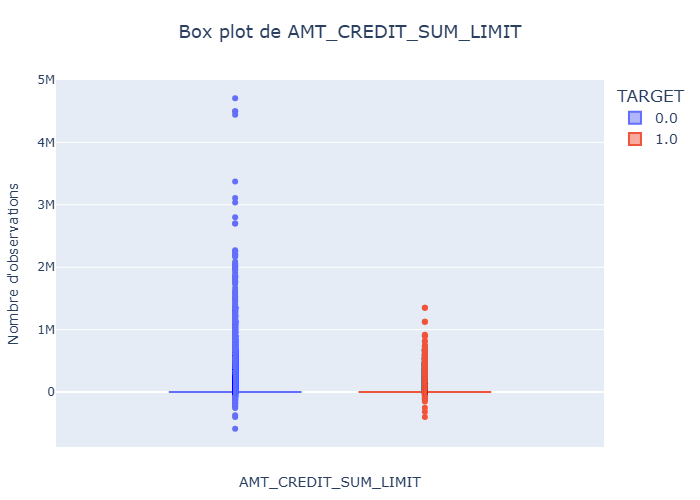

In [234]:
# Visualisation de la distribution pour la variable "CREDIT_DAY_OVERDUE".

plot_quantitative_box_violin(df_bureau, 
                            x="AMT_CREDIT_SUM_LIMIT",
                            plot_type="box",
                            color='TARGET',
                            width=800,
                            height=700,
                            xaxis_title="AMT_CREDIT_SUM_LIMIT",
                            yaxis_title="Nombre d'observations"
                            )

- On a encore quelques valeurs négatives qui paraissent suspectes pour ce type de variable qu'il faut supprimer si on garde cette variable.
- Malgré le fait que la majorité des valeurs sont autour de 0, il est intéressant de remarquer que les clients défaillants ont des limites de crédit moins importantes pour les valeurs extrêmes.

##### 'AMT_CREDIT_SUM_OVERDUE'

In [235]:
df_bureau['AMT_CREDIT_SUM_OVERDUE'].describe().round(0)

count    1716428.0
mean          38.0
std         5938.0
min            0.0
25%            0.0
50%            0.0
75%            0.0
max      3756681.0
Name: AMT_CREDIT_SUM_OVERDUE, dtype: float64

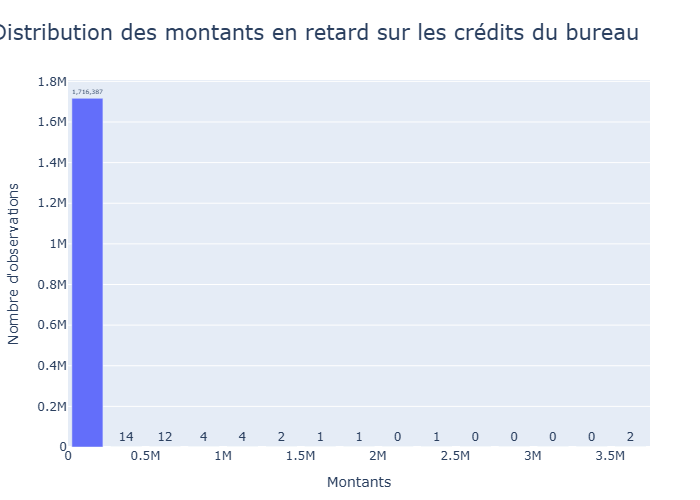

In [236]:
# Visualisation de la distribution pour la variable "AMT_CREDIT_SUM_OVERDUE".

plot_quantitative_histogram(
    df_bureau,
    x='AMT_CREDIT_SUM_OVERDUE',
    title="Distribution des montants en retard sur les crédits du bureau",
    title_layout={"x": 0.45},
    title_font_size=21,
    xaxis_title="Montants",
    yaxis_title="Nombre d'observations",
    width=1000,
    height=600
)

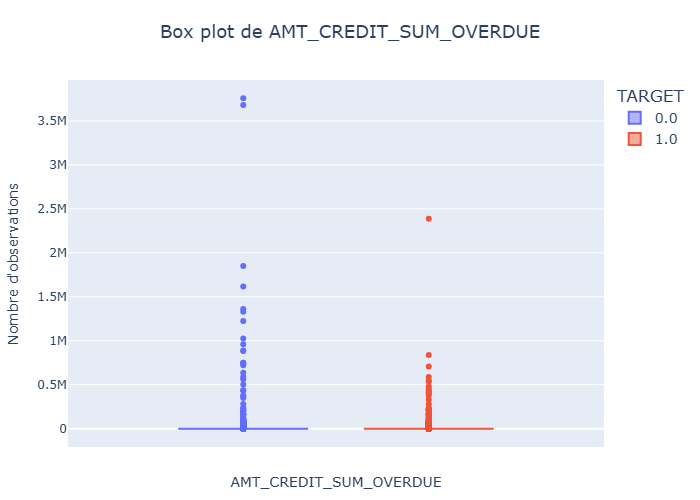

In [237]:
# Visualisation de la distribution pour la variable "AMT_CREDIT_SUM_OVERDUE".

plot_quantitative_box_violin(df_bureau, 
                            x="AMT_CREDIT_SUM_OVERDUE",
                            plot_type="box",
                            color='TARGET',
                            width=800,
                            height=700,
                            xaxis_title="AMT_CREDIT_SUM_OVERDUE",
                            yaxis_title="Nombre d'observations"
                            )

Dans l'ensemble on constate que la quasi totalité des clients n'ont pas de retards et on observe des distributions similaires pour les deux groupes (sauf outliers en général moins élevé pour les défaillants).

In [238]:
df_bureau['DAYS_CREDIT_UPDATE'].describe().round(0)

count    1716428.0
mean        -594.0
std          721.0
min       -41947.0
25%         -908.0
50%         -395.0
75%          -33.0
max          372.0
Name: DAYS_CREDIT_UPDATE, dtype: float64

In [239]:
df_bureau['DAYS_CREDIT_UPDATE'] = df_bureau['DAYS_CREDIT_UPDATE'] * -1

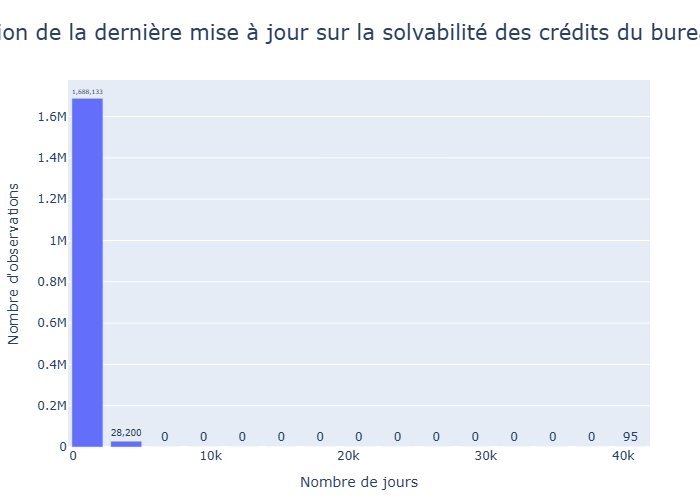

In [240]:
# Visualisation de la distribution pour la variable "DAYS_CREDIT_UPDATE".

plot_quantitative_histogram(
    df_bureau,
    x='DAYS_CREDIT_UPDATE',
    title="Distribution de la dernière mise à jour sur la solvabilité des crédits du bureau",
    title_layout={"x": 0.45},
    title_font_size=21,
    xaxis_title="Nombre de jours",
    yaxis_title="Nombre d'observations",
    width=1000,
    height=600
)

On constate le même problème au niveau des valeurs extrêmes qu'il faudra corriger

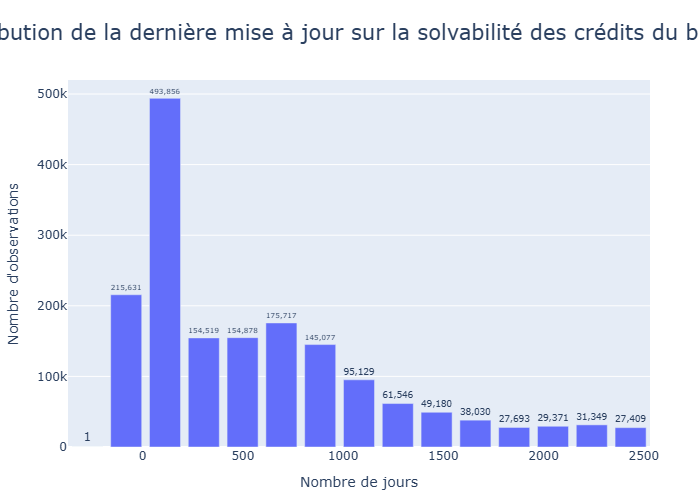

In [241]:
# Visualisation de la distribution pour la variable "DAYS_CREDIT_UPDATE".

plot_quantitative_histogram(
    df_bureau,
    x='DAYS_CREDIT_UPDATE',
    title="Distribution de la dernière mise à jour sur la solvabilité des crédits du bureau",
    title_layout={"x": 0.5},
    title_font_size=21,
    xaxis_title="Nombre de jours",
    yaxis_title="Nombre d'observations",
    max_quantile=0.99,
    width=1000,
    height=600
)

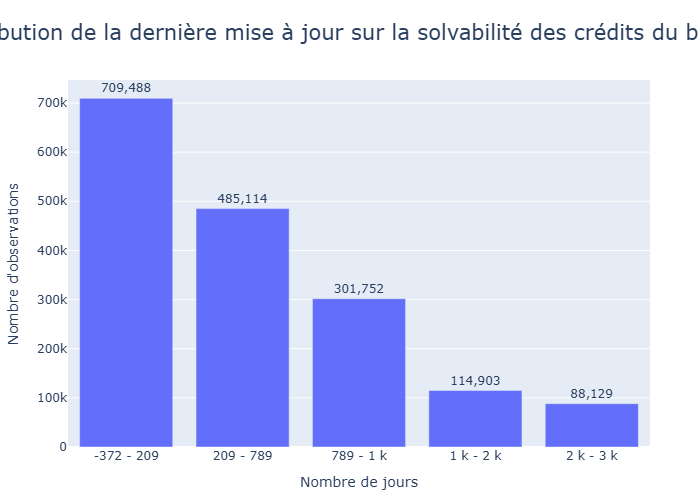

In [ ]:
# Visualisation de la distribution pour la variable "DAYS_CREDIT_UPDATE".

plot_quantitative_histogram(
    df_bureau,
    x='DAYS_CREDIT_UPDATE',
    nbins= 5,
    title="Distribution de la dernière mise à jour sur la solvabilité des crédits du bureau",
    title_layout={"x": 0.5},
    title_font_size=18,
    xaxis_title="Nombre de jours",
    yaxis_title="Nombre d'observations",
    max_quantile=0.99,
    bin_as_category=True,
    width=1000,
    height=600
)

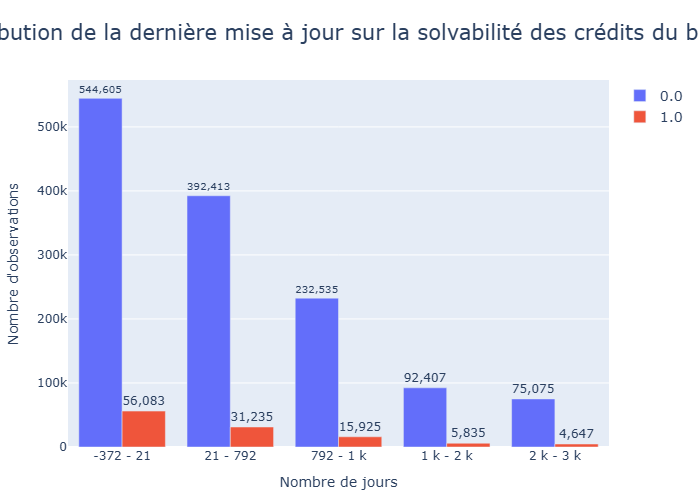

In [ ]:
# Visualisation de la distribution pour la variable "DAYS_CREDIT_UPDATE".

plot_quantitative_histogram(
    df_bureau,
    x='DAYS_CREDIT_UPDATE',
    color='TARGET',
    nbins= 5,
    title="Distribution de la dernière mise à jour sur la solvabilité des crédits du bureau",
    title_layout={"x": 0.5},
    title_font_size=18,
    xaxis_title="Nombre de jours",
    yaxis_title="Nombre d'observations",
    max_quantile=0.99,
    bin_as_category=True,
    width=1000,
    height=600
)

c:\Users\Caomghin\anaconda3\lib\site-packages\choreographer\utils\_tmpfile.py:137: TmpDirWarning:

The temporary directory could not be deleted, execution will continue. errors: [(WindowsPath('C:/Users/Caomghin/AppData/Local/Temp/tmpkwpn0cvx/CrashpadMetrics-active.pma'), PermissionError(13, 'Accès refusé')), (WindowsPath('C:/Users/Caomghin/AppData/Local/Temp/tmpkwpn0cvx'), OSError(41, 'Le répertoire n’est pas vide'))]

WARNING	Thread(Thread-303) choreographer.utils._tmpfile:_tmpfile.py:clean()- Temporary dictory couldn't be removed manually.


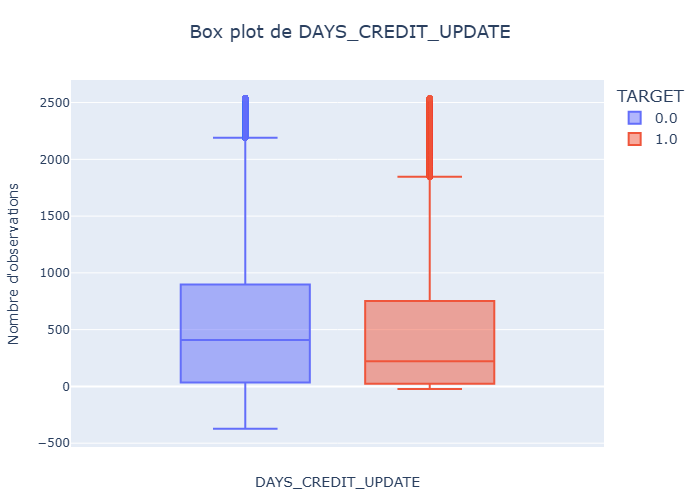

In [244]:
# Visualisation de la répartition pour la variable "DAYS_CREDIT_UPDATE"

plot_quantitative_box_violin(df_bureau, 
                            x="DAYS_CREDIT_UPDATE",
                            plot_type="box",
                            color='TARGET',
                            width=800,
                            height=700,
                            xaxis_title="DAYS_CREDIT_UPDATE",
                            yaxis_title="Nombre d'observations",
                            max_quantile=0.99
                            )

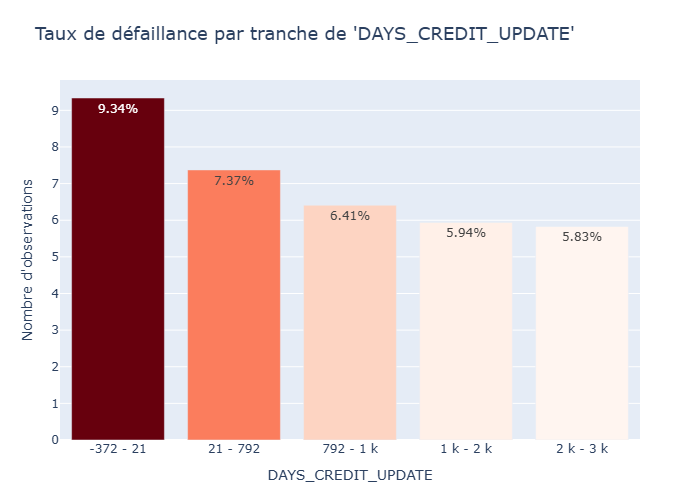

In [245]:
# Visualisation du taux de défaillance pour la variable "DAYS_CREDIT_UPDATE".

plot_defaillance_rate_per_quantitative(df_bureau, 
                                       "DAYS_CREDIT_UPDATE",
                                       target_var="TARGET",
                                       nbins=5,
                                       width=800,
                                       height=700,
                                       xaxis_title="DAYS_CREDIT_UPDATE",
                                       yaxis_title="Nombre d'observations",
                                       max_quantile=0.99)

- Comme on peut le voir avec les box plots et le dernier graphique, on remarque que les mises à jours semblent être plus récentes pour les clients défaillants (box plus petite, médiane et 3éme quartile plus basse que les non défaillants).

In [246]:
df_bureau['AMT_ANNUITY'].describe().round(0) 

count       489637.0
mean         15713.0
std         325827.0
min              0.0
25%              0.0
50%              0.0
75%          13500.0
max      118453424.0
Name: AMT_ANNUITY, dtype: float64

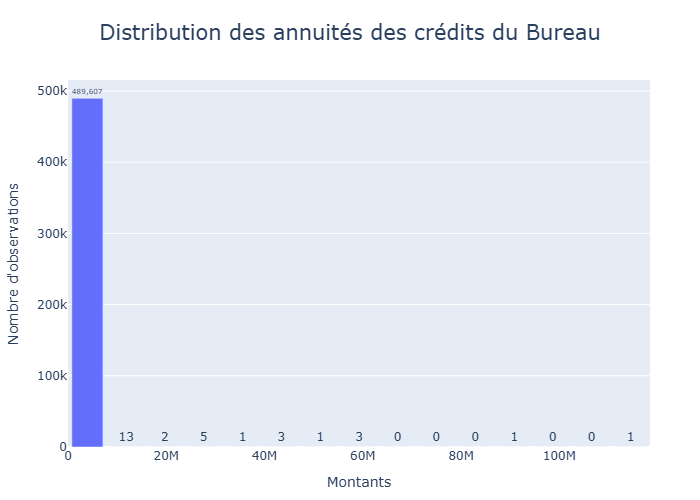

In [247]:
# Visualisation de la répartition pour la variable "AMT_ANNUITY".

plot_quantitative_histogram(
    df_bureau,
    x='AMT_ANNUITY',
    title="Distribution des annuités des crédits du Bureau",
    title_layout={"x": 0.5},
    title_font_size=21,
    xaxis_title="Montants",
    yaxis_title="Nombre d'observations",
    width=1000,
    height=600
)

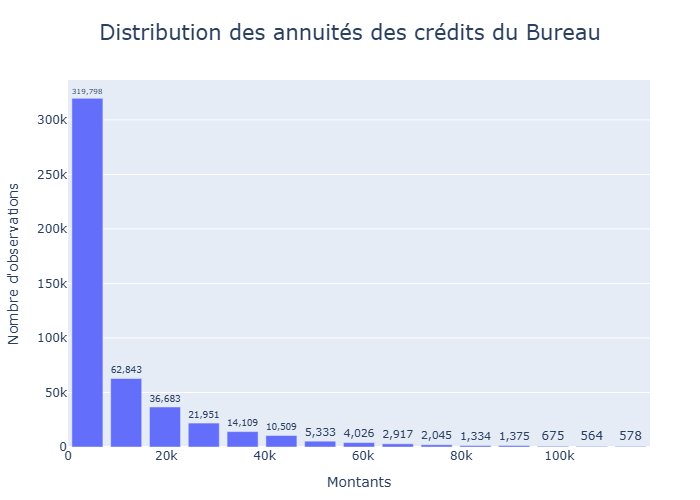

In [248]:
# Visualisation de la répartition pour la variable "AMT_ANNUITY".

plot_quantitative_histogram(
    df_bureau,
    x='AMT_ANNUITY',
    max_quantile=0.99,
    title="Distribution des annuités des crédits du Bureau",
    title_layout={"x": 0.5},
    title_font_size=21,
    xaxis_title="Montants",
    yaxis_title="Nombre d'observations",
    width=1000,
    height=600
)

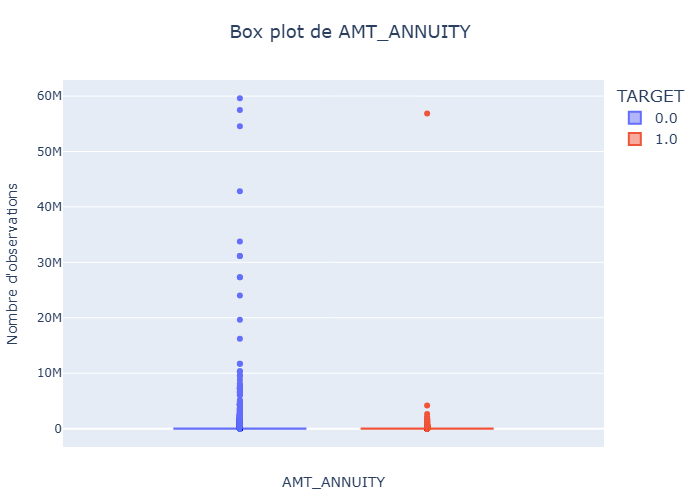

In [249]:
# Visualisation de la répartition pour la variable "AMT_ANNUITY"

plot_quantitative_box_violin(df_bureau, 
                            x="AMT_ANNUITY",
                            plot_type="box",
                            color='TARGET',
                            width=800,
                            height=700,
                            xaxis_title="AMT_ANNUITY",
                            yaxis_title="Nombre d'observations",
                            )

- Pour cette dernière variable, on a de nouveau des distributions similaires sauf pour les outliers. Comme pour les variables précédentes présentant un constat similaire il est peu probable que l'on puisse les utiliser pour la modélisation plus tard.
- On peut ensuite réaliser une analyse multivariée pour les variables de ce dataframe pour visualiser les corrélations entre elles et avec la Target:

In [250]:
# Calcul de la matrice de corrélation
corr_matrix = df_bureau.corr()

# Masque pour exclure la diagonale (corrélations de 1)
mask = corr_matrix != 1

# Extraction des paires (en supprimant la diagonale)
corr_pairs = corr_matrix[mask].stack().reset_index()
corr_pairs.columns = ['Variable 1', 'Variable 2', 'Corrélation']

# Créer une paire triée pour éviter les doublons (A / B == B / A)
corr_pairs['Sorted Pair'] = corr_pairs.apply(
    lambda row: ' / '.join(sorted([row['Variable 1'], row['Variable 2']])), axis=1
)

# Supprimer les doublons
corr_pairs = corr_pairs.drop_duplicates(subset='Sorted Pair')

# Ajouter une colonne lisible avec les deux noms de variables
corr_pairs['Variables corrélées'] = corr_pairs['Sorted Pair']

# Garder uniquement les colonnes voulues
corr_df = corr_pairs[['Variables corrélées', 'Corrélation']]

# Trier par valeur absolue de corrélation (facultatif)
corr_df = corr_df.sort_values(by='Corrélation', ascending=False).reset_index(drop=True)

# Affichage stylisé
pd.set_option('display.max_rows', None)

corr_df_styled = corr_df.style.background_gradient(
    subset=['Corrélation'],
    cmap='coolwarm',
    vmin=-1, vmax=1
)

corr_df_styled

,Variables corrélées,Corrélation
0,DAYS_CREDIT / YEARS_CREDIT,1.000000
1,DAYS_CREDIT / DAYS_ENDDATE_FACT,0.875359
2,DAYS_ENDDATE_FACT / YEARS_CREDIT,0.875359
3,DAYS_CREDIT_UPDATE / DAYS_ENDDATE_FACT,0.751294
4,DAYS_CREDIT / DAYS_CREDIT_UPDATE,0.688771
5,DAYS_CREDIT_UPDATE / YEARS_CREDIT,0.688771
6,AMT_CREDIT_SUM / AMT_CREDIT_SUM_DEBT,0.683419
7,CNT_CREDIT_PROLONG / DAYS_CREDIT_ENDDATE,0.113683
8,AMT_CREDIT_SUM_LIMIT / DAYS_CREDIT_ENDDATE,0.095421
9,AMT_CREDIT_SUM_OVERDUE / CREDIT_DAY_OVERDUE,0.090951


In [251]:
pd.reset_option('display.max_rows')

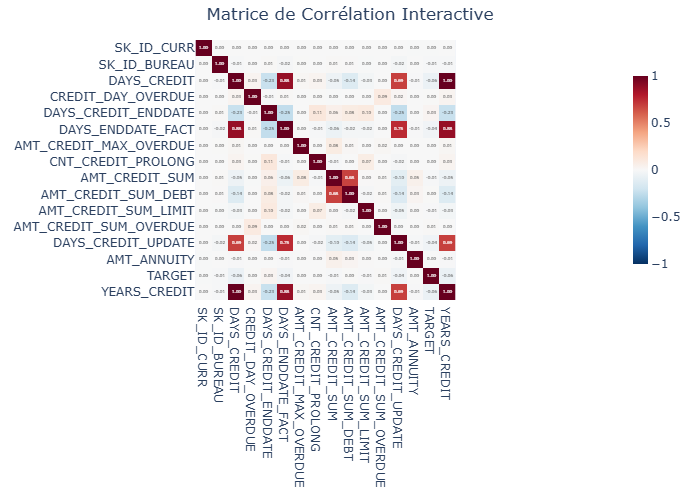

In [252]:
# Visualisation de la matrice de corrélation pour les variables quantitatives.

fig = px.imshow(
    corr_matrix,
    text_auto=".2f",
    color_continuous_scale='RdBu_r',
    zmin=-1,
    zmax=1
)

fig.update_layout(
    title="Matrice de Corrélation Interactive",
    title_x=0.5,
    width=1750,
    height=1750,
    margin=dict(l=20, r=20, t=40, b=20)
)

fig.update_coloraxes(colorbar=dict(thickness=15, x=1.02, len=0.8))
fig.show()

- On a quelques corrélations assez importantes tel que par exemple les variables de durée de crédit ou encore liée aux montants des crédits néanmoins selon leur corrélation avec la Target, il faudra faire un choix ou un travail de synthétisation pour éviter un problème de colinéarité notamment.

In [253]:
strong_corr_target = df_bureau.corr()['TARGET'].drop('TARGET')

corr_matrix_target = strong_corr_target.to_frame(name='Corrélation en fonction de la target').sort_values(by='Corrélation en fonction de la target', ascending=False)
corr_matrix_target

,Corrélation en fonction de la target
DAYS_CREDIT_ENDDATE,0.026497
AMT_CREDIT_SUM_OVERDUE,0.006253
CREDIT_DAY_OVERDUE,0.002652
AMT_CREDIT_SUM_DEBT,0.002539
AMT_CREDIT_MAX_OVERDUE,0.001587
CNT_CREDIT_PROLONG,0.001523
AMT_ANNUITY,0.000117
SK_ID_CURR,-0.003024
AMT_CREDIT_SUM_LIMIT,-0.005990
SK_ID_BUREAU,-0.009018


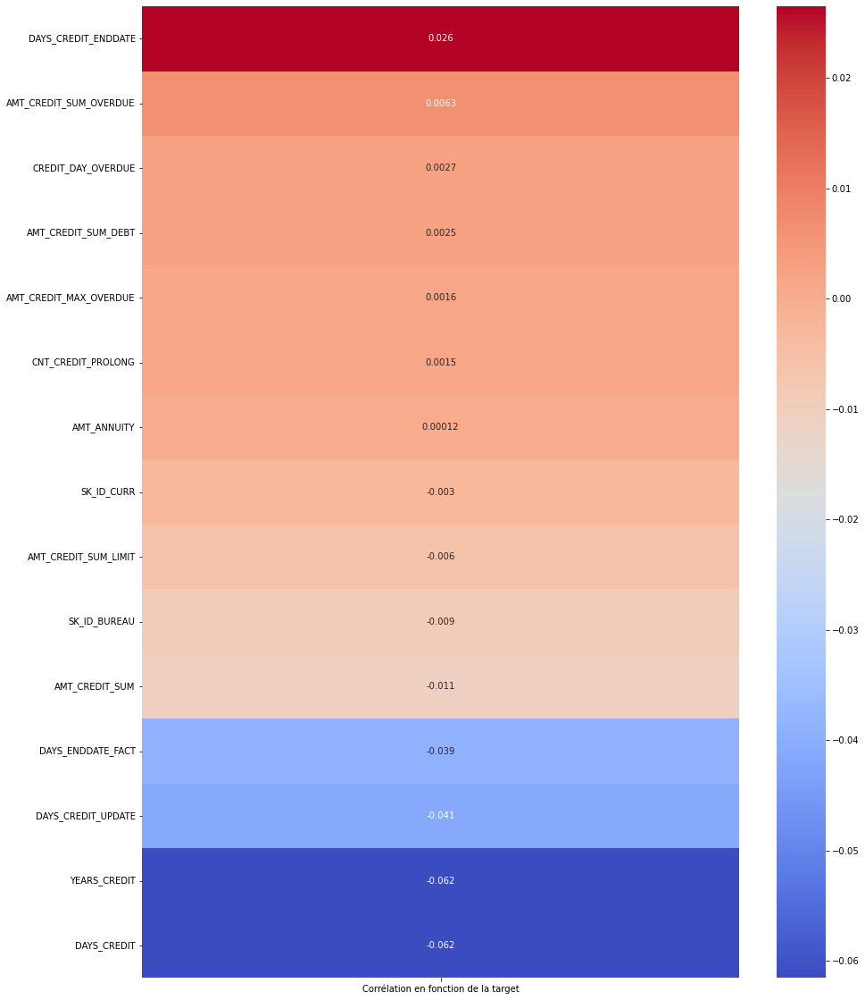

In [254]:
# Visualisation de la matrice de corrélation des variables quantitative par rapport à la Target.

plt.figure(figsize=(15,20))
sns.heatmap(corr_matrix_target, annot=True, cmap='coolwarm')
plt.show()

- Globalement les relations entre ces variables quantitatives et la TARGET sont très faibles pour ce dataframe (seuls les durées de crédit sont potentiellement utilisables).

In [255]:
# Création de la matrice de corréaltion de variables catégorielles.

cramer_matrix_bureau = cramers_v_matrix(df_bureau, include_target=False)

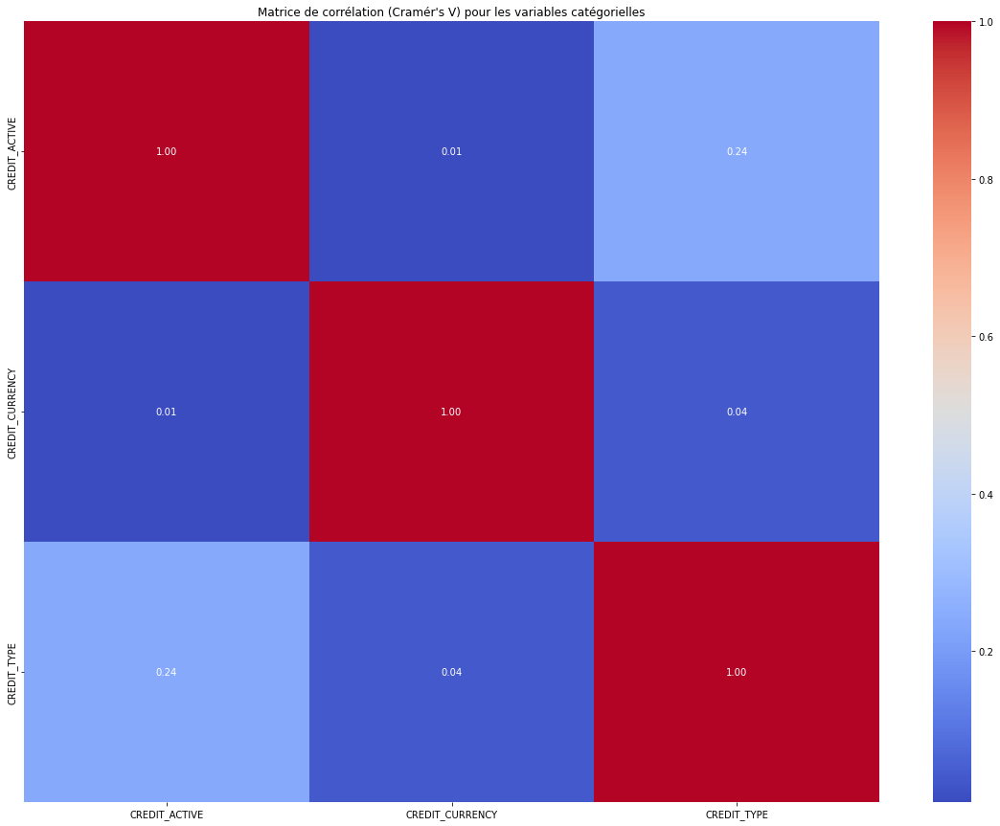

In [256]:
# Visualisation de la matrice de corrélation des variables qualitatives.

plt.figure(figsize=(20,15))
sns.heatmap(cramer_matrix_bureau, annot=True, fmt=".2f", cmap="coolwarm")
plt.title("Matrice de corrélation (Cramér's V) pour les variables catégorielles")
plt.show()

In [257]:
# Inclure TARGET dans la matrice
cramer_matrix_bureau = cramers_v_matrix(df_bureau, include_target=True, target_col='TARGET')

# Extraire la ligne/colonne de TARGET
target_corr = cramer_matrix_bureau['TARGET'].drop('TARGET').sort_values(ascending=False)

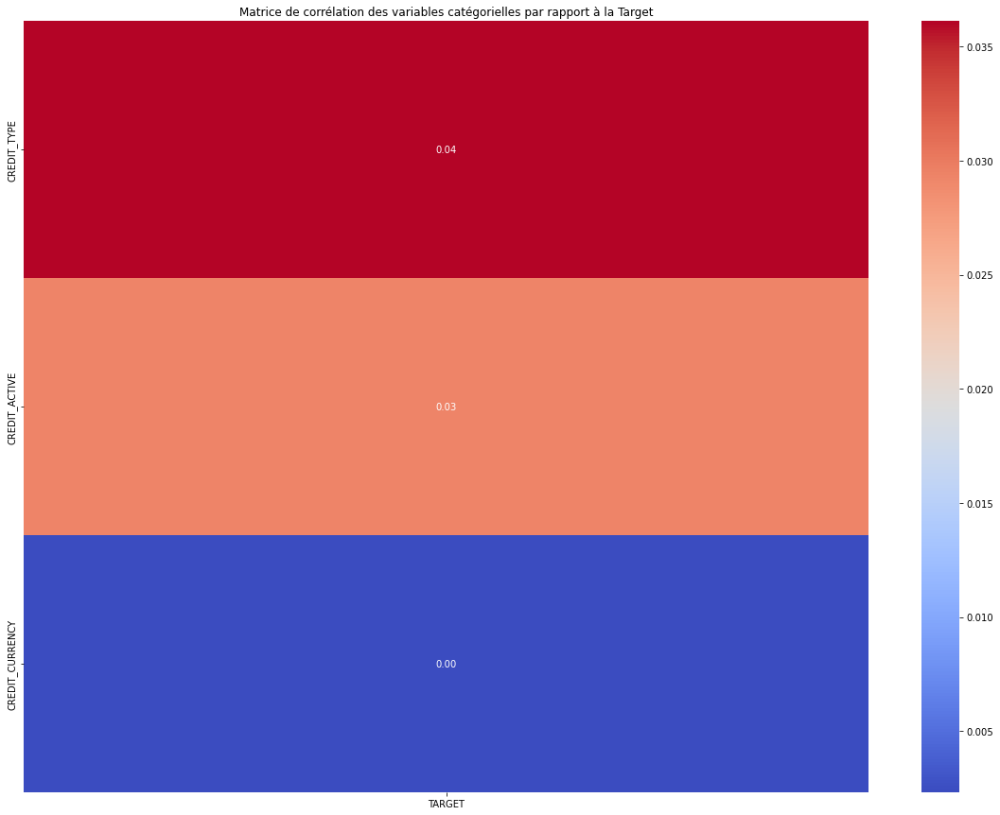

In [258]:
# Visualisation de la matrice de corrélation des variables qualitatives par rapport à la Target.

plt.figure(figsize=(20,15))
sns.heatmap(target_corr.to_frame(), annot=True, fmt=".2f", cmap="coolwarm")
plt.title("Matrice de corrélation des variables catégorielles par rapport à la Target")
plt.show()

- Le constat est assez similaire pour les variables qualitatives, seuls Credit Type/Active se démarquent légérement et pourrait être utilisé en réalisant un travail dessus.
- On peut maintenant passer au dataframe suivant "bureau_balance".

#### Dataframe "Bureau_balance"

In [259]:
# Importation du fichier qui s'intitule "bureau_balance.csv".

df_bureau_balance = pd.read_csv(r"C:\Users\Caomghin\Desktop\Implementer_un_modele_de_scoring\Donnee_kaggle\bureau_balance.csv")

In [260]:
# Forme du dataframe "bureau_balance".

df_bureau_balance.shape

(27299925, 3)

In [261]:
# Visualisation du dataframe.

df_bureau_balance

,SK_ID_BUREAU,MONTHS_BALANCE,STATUS
0,5715448,0,C
1,5715448,-1,C
2,5715448,-2,C
3,5715448,-3,C
4,5715448,-4,C
...,...,...,...
27299920,5041336,-47,X
27299921,5041336,-48,X
27299922,5041336,-49,X
27299923,5041336,-50,X


In [262]:
# On visualise le type de chaque variable et la présence potentielle de valeurs nulles.

df_bureau_balance.info(show_counts=True)

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 27299925 entries, 0 to 27299924
Data columns (total 3 columns):
 #   Column          Non-Null Count     Dtype 
---  ------          --------------     ----- 
 0   SK_ID_BUREAU    27299925 non-null  int64 
 1   MONTHS_BALANCE  27299925 non-null  int64 
 2   STATUS          27299925 non-null  object
dtypes: int64(2), object(1)
memory usage: 624.8+ MB


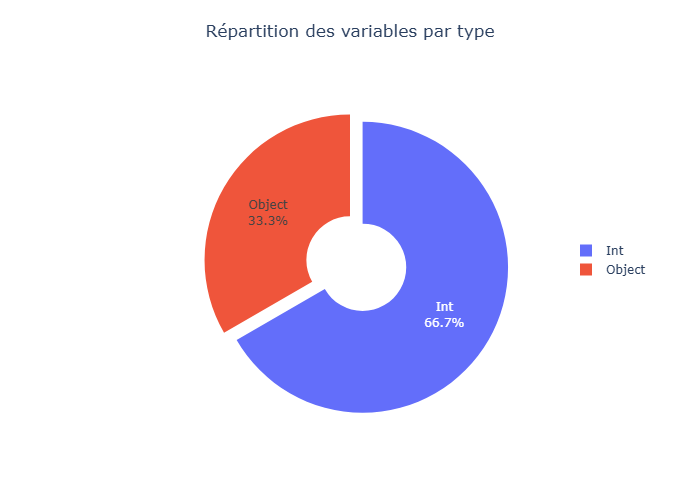

In [263]:
# Représentation graphique des types de variables.

fig = go.Figure(data=[go.Pie(
    labels=["Int", "Object"], 
    values=df_bureau_balance.dtypes.value_counts(),
    hole=0.3,
    textinfo="label+percent",
    pull=[0.1, 0, 0]
)])

# Titre et affichage
fig.update_layout(
    title={
        'text': "Répartition des variables par type",
        'y': 0.95,  # Position verticale (1 = tout en haut)
        'x': 0.50,   # Centrer le titre
        'xanchor': 'center',
        'yanchor': 'top'
    },
    legend={
        'x': 0.9,  # Ajuste la position de la légende plus proche
        'y': 0.5,
        'xanchor': 'left'
    }
)
fig.show()

In [264]:
# Visualisation des description liées à ce jeu de données.

pd.set_option('display.max_colwidth', None)
df_description.loc[df_description['Table'] == 'bureau_balance.csv'][['Row','Description']]

,Row,Description
139,SK_BUREAU_ID,Recoded ID of Credit Bureau credit (unique coding for each application) - use this to join to CREDIT_BUREAU table
140,MONTHS_BALANCE,Month of balance relative to application date (-1 means the freshest balance date)
141,STATUS,"Status of Credit Bureau loan during the month (active, closed, DPD0-30,� [C means closed, X means status unknown, 0 means no DPD, 1 means maximal did during month between 1-30, 2 means DPD 31-60,� 5 means DPD 120+ or sold or written off ] )"


In [265]:
pd.reset_option('display.max_colwidth')

In [266]:
# Statistique des données du fichier bureau.

df_bureau_balance.describe().round(2)

,SK_ID_BUREAU,MONTHS_BALANCE
count,27299925.00,27299925.00
mean,6036297.33,-30.74
std,492348.86,23.86
min,5001709.00,-96.00
25%,5730933.00,-46.00
50%,6070821.00,-25.00
75%,6431951.00,-11.00
max,6842888.00,0.00


In [267]:
# Calcul du pourcentage de valeurs nulles par variable pour "bureau_balance.csv". 
pd.set_option('display.max_rows', None)
calculate_missing_values(df_bureau_balance)

,Nbr_valeurs_manquantes,Pct_valeurs_manquantes


In [268]:
pd.reset_option('display.max_rows')

- Pas de valeurs manquantes pour ce dataframe.

In [269]:
# Recherche de doublons pour la variable ID "SK_ID_BUREAU"

df_bureau_balance['SK_ID_BUREAU'].duplicated().any()

True

In [270]:
# Nombre de lignes présentant au moins un doublon et celles n'en présentant pas.

df_bureau_balance['SK_ID_BUREAU'].duplicated(keep=False).value_counts()

True     27293736
False        6189
Name: SK_ID_BUREAU, dtype: int64

In [271]:
# Nombre de ID unique pour cette variable.

df_bureau_balance['SK_ID_BUREAU'].nunique()

817395

In [272]:
# On compare les ID présents à la fois dans df_bureau et dans df_bureau_balance.

print(f" Il y a {pd.Series(df_bureau_balance['SK_ID_BUREAU'].unique()).isin(df_bureau['SK_ID_BUREAU']).sum()} ID présents au moins une fois dans bureau et dans le fichier bureau_balance.")

 Il y a 774354 ID présents au moins une fois dans bureau et dans le fichier bureau_balance.


- Il y a bien un lien avec les deux fichiers bureau qui met en avant l'évolution du solde dans le temps des credits du bureau ainsi que leur statut à chacune de ces périodes.

In [273]:
df_bureau_balance['MONTHS_BALANCE'].describe().round(0)

count    27299925.0
mean          -31.0
std            24.0
min           -96.0
25%           -46.0
50%           -25.0
75%           -11.0
max             0.0
Name: MONTHS_BALANCE, dtype: float64

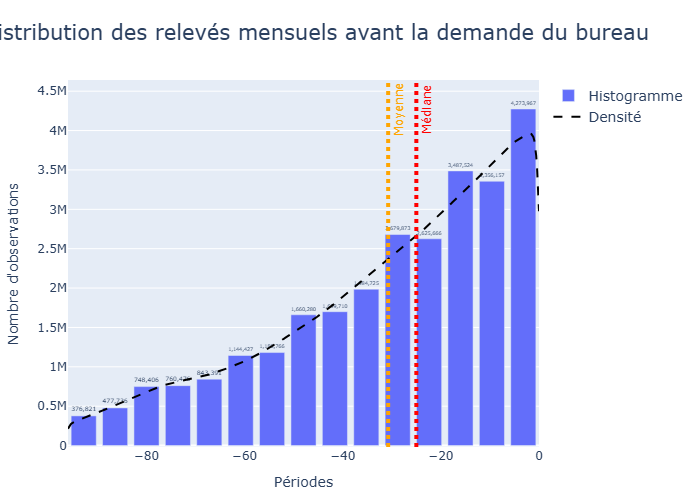

In [274]:
# Visualisation de la répartition pour la variable "MONTHS_BALANCE".

plot_quantitative_histogram(
    df_bureau_balance,
    x='MONTHS_BALANCE',
    title="Distribution des relevés mensuels avant la demande du bureau",
    title_layout={"x": 0.45},
    title_font_size=21,
    xaxis_title="Périodes",
    yaxis_title="Nombre d'observations",
    density=True,
    show_mean=True,
    show_median=True,
    width=1000,
    height=600
)

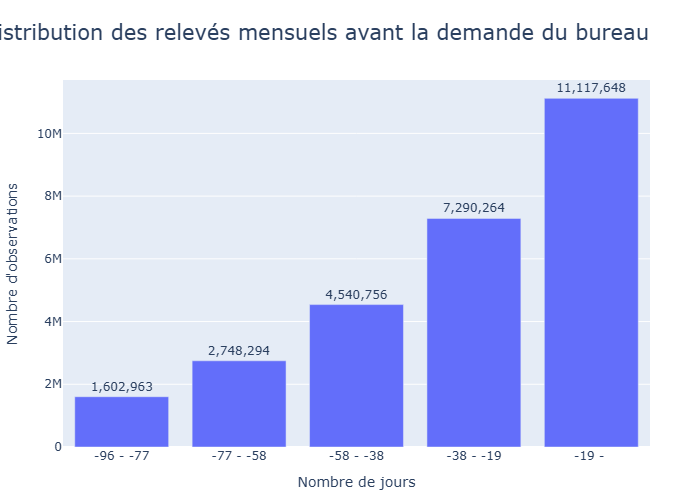

In [275]:
# Visualisation de la répartition pour la variable "MONTHS_BALANCE".

plot_quantitative_histogram(
    df_bureau_balance,
    x='MONTHS_BALANCE',
    nbins= 5,
    title="Distribution des relevés mensuels avant la demande du bureau",
    title_layout={"x": 0.45},
    title_font_size=21,
    xaxis_title="Nombre de jours",
    yaxis_title="Nombre d'observations",
    bin_as_category=True,
    width=1000,
    height=600
)

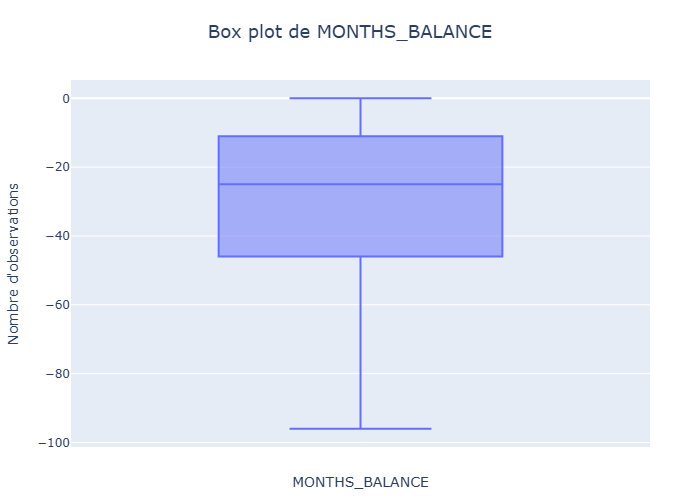

In [276]:
# Visualisation de la répartition pour la variable "MONTHS_BALANCE"

plot_quantitative_box_violin(df_bureau_balance, 
                            x="MONTHS_BALANCE",
                            plot_type="box",
                            width=800,
                            height=700,
                            xaxis_title="MONTHS_BALANCE",
                            yaxis_title="Nombre d'observations"
                            )

In [277]:
# Ajout de la variable 'TARGET' au dataframe df_bureau_balance

df_bureau_balance['TARGET'] = df_bureau_balance['SK_ID_BUREAU'].map(df_bureau.set_index('SK_ID_BUREAU')['TARGET'])

In [278]:
df_bureau_balance['TARGET'].value_counts(dropna=False)

0.0    13681331
NaN    12598313
1.0     1020281
Name: TARGET, dtype: int64

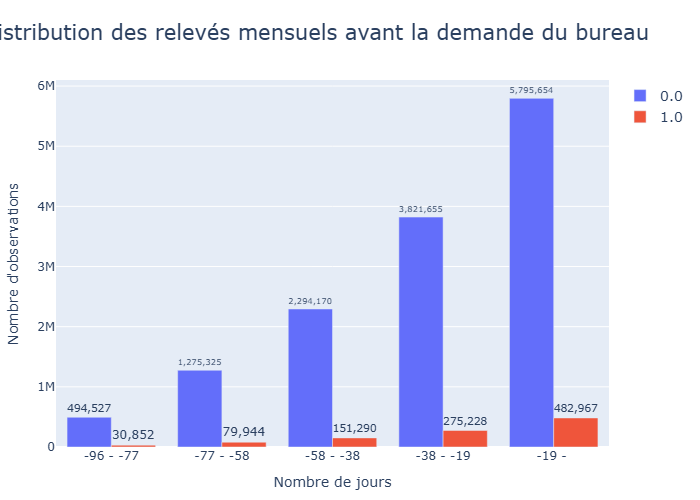

In [279]:
# Visualisation de la répartition pour la variable "MONTHS_BALANCE" en fonction de la Target.

plot_quantitative_histogram(
    df_bureau_balance,
    x='MONTHS_BALANCE',
    nbins= 5,
    color= 'TARGET',
    title="Distribution des relevés mensuels avant la demande du bureau",
    title_layout={"x": 0.45},
    title_font_size=21,
    xaxis_title="Nombre de jours",
    yaxis_title="Nombre d'observations",
    bin_as_category=True,
    width=1000,
    height=600
)


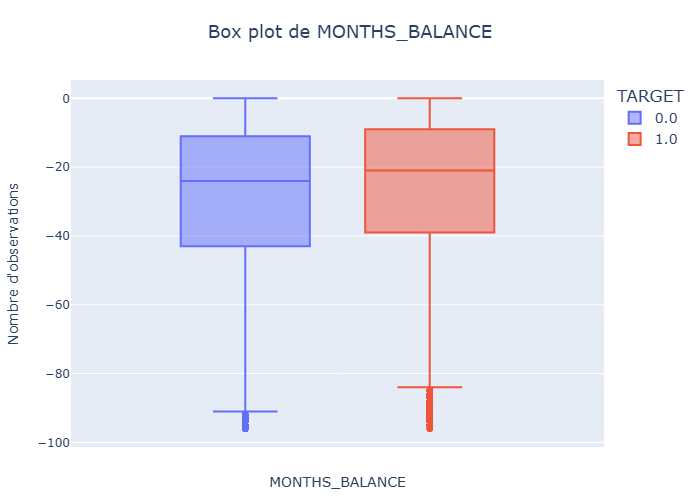

In [280]:
# Visualisation de la répartition pour la variable "MONTHS_BALANCE"

plot_quantitative_box_violin(df_bureau_balance, 
                            x="MONTHS_BALANCE",
                            plot_type="box",
                            color= 'TARGET',
                            width=800,
                            height=700,
                            xaxis_title="MONTHS_BALANCE",
                            yaxis_title="Nombre d'observations"
                            )

- Cette variable met en avant les rélevés mensuels des crédits antérieurs avant la demande actuelle de prêt. 
- On retrouve donc le suivi mois par mois de ces crédits en fonction des informations à la disposition du Bureau avec 0 la valeur la plus récente possible (correspond au mois de la demande de prêt pour le client en question) et des valeurs négatives pour chaque mois passés avant la demande actuelle.
- Dans l'ensemble les distributions pour les deux groupes sont assez semblables (pour les clients défaillants les relevés sont légérement plus récents).

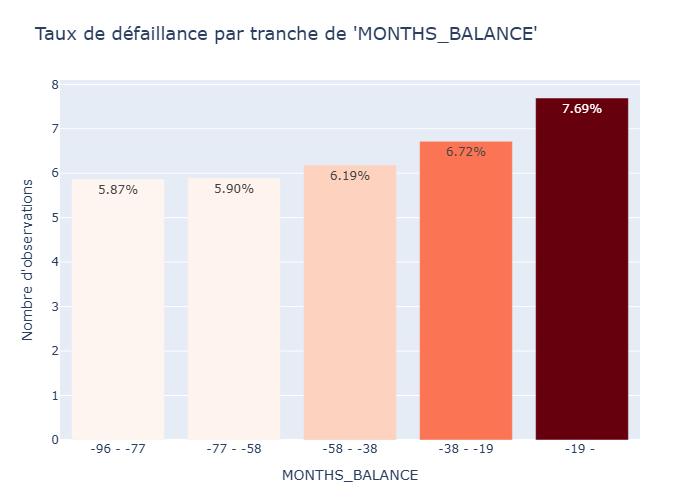

In [281]:
# Visualisation du taux de défaillance pour la variable "DAYS_CREDIT_UPDATE".

plot_defaillance_rate_per_quantitative(df_bureau_balance, 
                                       "MONTHS_BALANCE",
                                       target_var="TARGET",
                                       nbins=5,
                                       width=800,
                                       height=700,
                                       xaxis_title="MONTHS_BALANCE",
                                       yaxis_title="Nombre d'observations")

- D'après le graphique, on constate que plus les relevés sont anciens moins on a de cas de défaillant donc il y a peut être un lien entre les deux (toutefois il faut prendre en compte le fait qu'il y a beaucoup de valeurs nulle pour la variable Target)

In [282]:
# Nombre d'occurence pour chacune des valeurs de cette variable.

df_bureau_balance['STATUS'].value_counts()

C    13646993
0     7499507
X     5810482
1      242347
5       62406
2       23419
3        8924
4        5847
Name: STATUS, dtype: int64

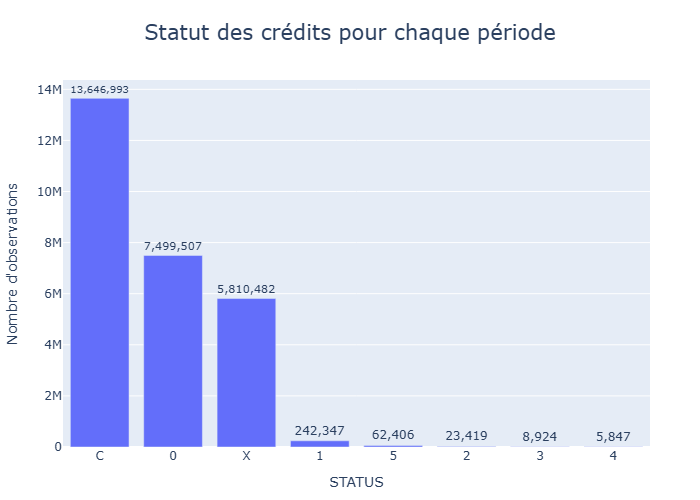

In [283]:
# Visualisation de la répartition pour la variable "STATUS"

plot_categorical_histogram(
    df=df_bureau_balance,
    x="STATUS",
    title="Statut des crédits pour chaque période",
    title_font_size=21
)

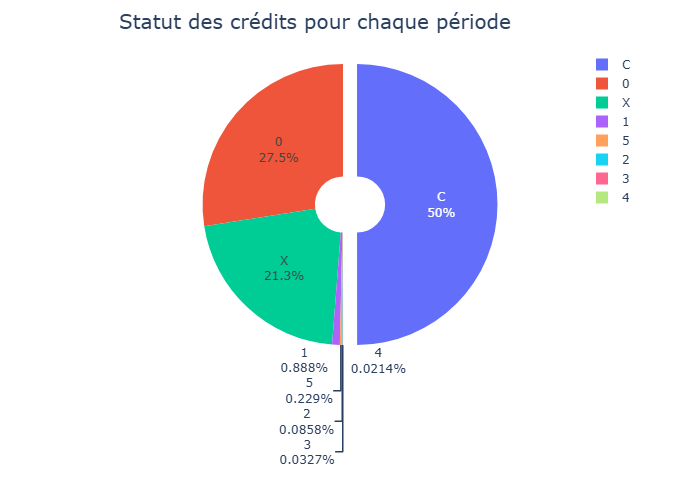

In [284]:
# Visualisation de la répartition en pourcentage pour la variable "STATUS"

plot_pie_chart(
    df=df_bureau_balance,
    column="STATUS",
    hole=0.2,
    title="Statut des crédits pour chaque période",
    title_layout = {'x':0.45, 'y':0.97},
    height=600,
    pull_auto=True
)

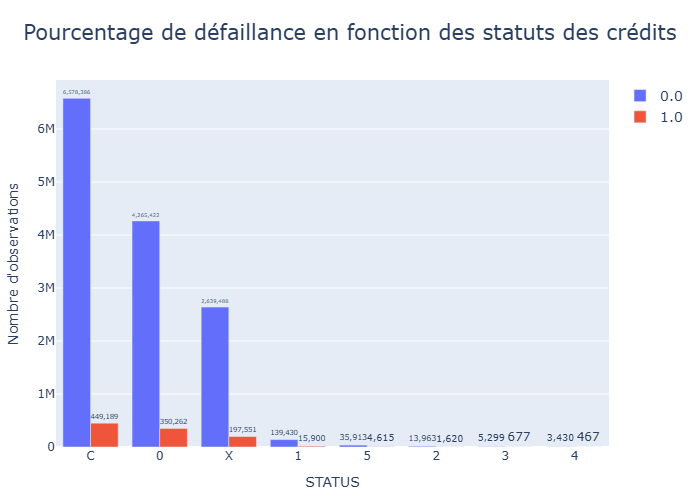

In [285]:
# Visualisation de la répartition pour la variable "STATUS" en fonction de la Target.

plot_categorical_histogram(
    df=df_bureau_balance,
    x="STATUS",
    color= 'TARGET',
    title="Pourcentage de défaillance en fonction des statuts des crédits",
    title_font_size=21
)

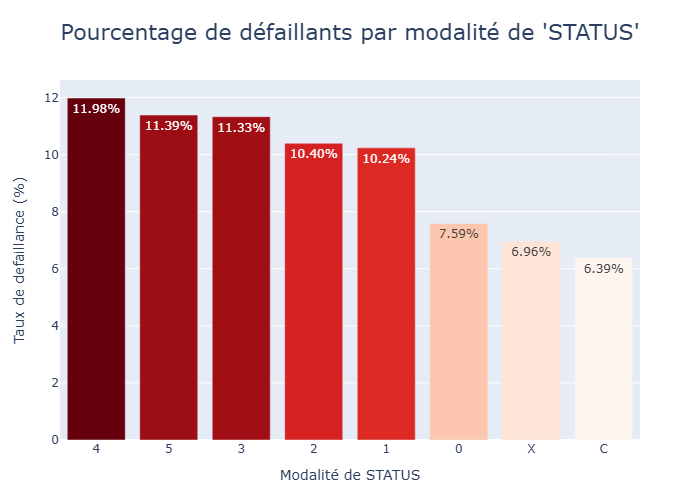

In [286]:
# Visualisation du pourcentage de prêts défaillants pour la variable de STATUS.

plot_defaillance_rate_per_category(
    df_bureau_balance,
    cat_var='STATUS',
    title_layout={"x": 0.5},
    xaxis_title = "Modalité de STATUS",
    yaxis_title = "Taux de defaillance (%)",
    title_font_size=22
)

- Dans l'ensemble la grande majorité des crédits sont clos (50%) et pour ce qui est quasiment l'autre moitié de notre échantillon, les relevés mensuels sont partagés entre le statut inconnu (21%) et le statut à jour dans les paiements.
- Pour les autres statuts qui représentent autour de 1 % de l'échantillon, on constate que les taux de défaillance sont très important comparativement à la majorité des statuts observés. Il y a donc un lien à prendre en considération ici avec la Target. On peut donc maintenant passer au fichier suivant "credit_card_balance.csv"

#### Dataframe "credit_card_balance"

In [287]:
# Importation du fichier qui s'intitule "credit_card_balance.csv".

df_credit_card = pd.read_csv(r"C:\Users\Caomghin\Desktop\Implementer_un_modele_de_scoring\Donnee_kaggle\credit_card_balance.csv")

In [288]:
# Forme du dataframe "credit_card_balance".

df_credit_card.shape

(3840312, 23)

In [289]:
# Visualisation du dataframe.

df_credit_card

,SK_ID_PREV,SK_ID_CURR,MONTHS_BALANCE,AMT_BALANCE,AMT_CREDIT_LIMIT_ACTUAL,AMT_DRAWINGS_ATM_CURRENT,AMT_DRAWINGS_CURRENT,AMT_DRAWINGS_OTHER_CURRENT,AMT_DRAWINGS_POS_CURRENT,AMT_INST_MIN_REGULARITY,...,AMT_RECIVABLE,AMT_TOTAL_RECEIVABLE,CNT_DRAWINGS_ATM_CURRENT,CNT_DRAWINGS_CURRENT,CNT_DRAWINGS_OTHER_CURRENT,CNT_DRAWINGS_POS_CURRENT,CNT_INSTALMENT_MATURE_CUM,NAME_CONTRACT_STATUS,SK_DPD,SK_DPD_DEF
0,2562384,378907,-6,56.970,135000,0.0,877.5,0.0,877.5,1700.325,...,0.000,0.000,0.0,1,0.0,1.0,35.0,Active,0,0
1,2582071,363914,-1,63975.555,45000,2250.0,2250.0,0.0,0.0,2250.000,...,64875.555,64875.555,1.0,1,0.0,0.0,69.0,Active,0,0
2,1740877,371185,-7,31815.225,450000,0.0,0.0,0.0,0.0,2250.000,...,31460.085,31460.085,0.0,0,0.0,0.0,30.0,Active,0,0
3,1389973,337855,-4,236572.110,225000,2250.0,2250.0,0.0,0.0,11795.760,...,233048.970,233048.970,1.0,1,0.0,0.0,10.0,Active,0,0
4,1891521,126868,-1,453919.455,450000,0.0,11547.0,0.0,11547.0,22924.890,...,453919.455,453919.455,0.0,1,0.0,1.0,101.0,Active,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3840307,1036507,328243,-9,0.000,45000,NaN,0.0,NaN,NaN,0.000,...,0.000,0.000,NaN,0,NaN,NaN,0.0,Active,0,0
3840308,1714892,347207,-9,0.000,45000,0.0,0.0,0.0,0.0,0.000,...,0.000,0.000,0.0,0,0.0,0.0,23.0,Active,0,0
3840309,1302323,215757,-9,275784.975,585000,270000.0,270000.0,0.0,0.0,2250.000,...,273093.975,273093.975,2.0,2,0.0,0.0,18.0,Active,0,0
3840310,1624872,430337,-10,0.000,450000,NaN,0.0,NaN,NaN,0.000,...,0.000,0.000,NaN,0,NaN,NaN,0.0,Active,0,0


In [290]:
# On visualise le type de chaque variable et la présence potentielle de valeurs nulles.

df_credit_card.info(show_counts=True)

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3840312 entries, 0 to 3840311
Data columns (total 23 columns):
 #   Column                      Non-Null Count    Dtype  
---  ------                      --------------    -----  
 0   SK_ID_PREV                  3840312 non-null  int64  
 1   SK_ID_CURR                  3840312 non-null  int64  
 2   MONTHS_BALANCE              3840312 non-null  int64  
 3   AMT_BALANCE                 3840312 non-null  float64
 4   AMT_CREDIT_LIMIT_ACTUAL     3840312 non-null  int64  
 5   AMT_DRAWINGS_ATM_CURRENT    3090496 non-null  float64
 6   AMT_DRAWINGS_CURRENT        3840312 non-null  float64
 7   AMT_DRAWINGS_OTHER_CURRENT  3090496 non-null  float64
 8   AMT_DRAWINGS_POS_CURRENT    3090496 non-null  float64
 9   AMT_INST_MIN_REGULARITY     3535076 non-null  float64
 10  AMT_PAYMENT_CURRENT         3072324 non-null  float64
 11  AMT_PAYMENT_TOTAL_CURRENT   3840312 non-null  float64
 12  AMT_RECEIVABLE_PRINCIPAL    3840312 non-null  float64
 1

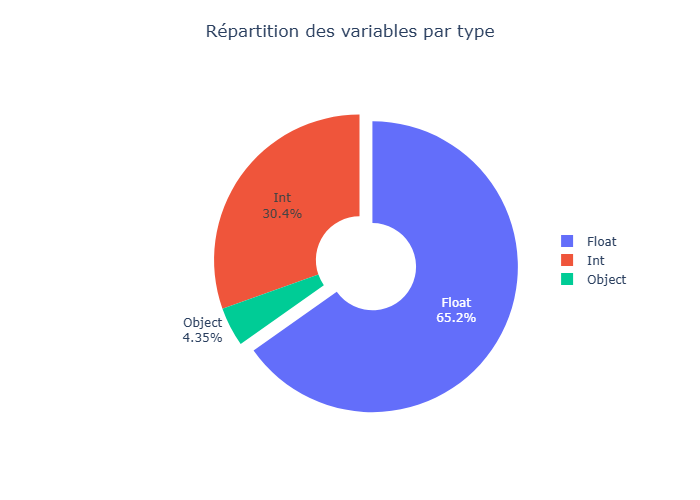

In [291]:
# Représentation graphique des types de variables.

fig = go.Figure(data=[go.Pie(
    labels=["Float", "Int", "Object"], 
    values=df_credit_card.dtypes.value_counts(),
    hole=0.3,
    textinfo="label+percent",
    pull=[0.1, 0, 0]
)])

# Titre et affichage
fig.update_layout(
    title={
        'text': "Répartition des variables par type",
        'y': 0.95,  # Position verticale (1 = tout en haut)
        'x': 0.50,   # Centrer le titre
        'xanchor': 'center',
        'yanchor': 'top'
    },
    legend={
        'x': 0.9,  # Ajuste la position de la légende plus proche
        'y': 0.5,
        'xanchor': 'left'
    }
)
fig.show()

In [292]:
# Visualisation des description liées à ce jeu de données.

pd.set_option('display.max_colwidth', None)
df_description.loc[df_description['Table'] == 'credit_card_balance.csv'][['Row','Description']]

,Row,Description
150,SK_ID_PREV,"ID of previous credit in Home credit related to loan in our sample. (One loan in our sample can have 0,1,2 or more previous loans in Home Credit)"
151,SK_ID_CURR,ID of loan in our sample
152,MONTHS_BALANCE,Month of balance relative to application date (-1 means the freshest balance date)
153,AMT_BALANCE,Balance during the month of previous credit
154,AMT_CREDIT_LIMIT_ACTUAL,Credit card limit during the month of the previous credit
155,AMT_DRAWINGS_ATM_CURRENT,Amount drawing at ATM during the month of the previous credit
156,AMT_DRAWINGS_CURRENT,Amount drawing during the month of the previous credit
157,AMT_DRAWINGS_OTHER_CURRENT,Amount of other drawings during the month of the previous credit
158,AMT_DRAWINGS_POS_CURRENT,Amount drawing or buying goods during the month of the previous credit
159,AMT_INST_MIN_REGULARITY,Minimal installment for this month of the previous credit


- Pour ce dataframe on retrouve les informations monétaires des crédits antérieurs à la demande de prêt au Bureau.
- Cela passe par des infos sur les montants liés à la carte de crédit du client (limite, montants prélevés, montants reçus etc...)

In [293]:
pd.reset_option('display.max_colwidth')

In [294]:
# Statistique des données du fichier credit_card.

df_credit_card.describe().round(2)

,SK_ID_PREV,SK_ID_CURR,MONTHS_BALANCE,AMT_BALANCE,AMT_CREDIT_LIMIT_ACTUAL,AMT_DRAWINGS_ATM_CURRENT,AMT_DRAWINGS_CURRENT,AMT_DRAWINGS_OTHER_CURRENT,AMT_DRAWINGS_POS_CURRENT,AMT_INST_MIN_REGULARITY,...,AMT_RECEIVABLE_PRINCIPAL,AMT_RECIVABLE,AMT_TOTAL_RECEIVABLE,CNT_DRAWINGS_ATM_CURRENT,CNT_DRAWINGS_CURRENT,CNT_DRAWINGS_OTHER_CURRENT,CNT_DRAWINGS_POS_CURRENT,CNT_INSTALMENT_MATURE_CUM,SK_DPD,SK_DPD_DEF
count,3840312.00,3840312.00,3840312.00,3840312.00,3840312.00,3090496.00,3840312.00,3090496.00,3090496.00,3535076.00,...,3840312.00,3840312.00,3840312.00,3090496.00,3840312.00,3090496.00,3090496.00,3535076.00,3840312.00,3840312.00
mean,1904503.59,278324.21,-34.52,58300.16,153807.96,5961.32,7433.39,288.17,2968.80,3540.20,...,55965.88,58088.81,58098.29,0.31,0.70,0.00,0.56,20.83,9.28,0.33
std,536469.47,102704.48,26.67,106307.03,165145.70,28225.69,33846.08,8201.99,20796.89,5600.15,...,102533.62,105965.37,105971.80,1.10,3.19,0.08,3.24,20.05,97.52,21.48
min,1000018.00,100006.00,-96.00,-420250.18,0.00,-6827.31,-6211.62,0.00,0.00,0.00,...,-423305.82,-420250.18,-420250.18,0.00,0.00,0.00,0.00,0.00,0.00,0.00
25%,1434385.00,189517.00,-55.00,0.00,45000.00,0.00,0.00,0.00,0.00,0.00,...,0.00,0.00,0.00,0.00,0.00,0.00,0.00,4.00,0.00,0.00
50%,1897122.00,278396.00,-28.00,0.00,112500.00,0.00,0.00,0.00,0.00,0.00,...,0.00,0.00,0.00,0.00,0.00,0.00,0.00,15.00,0.00,0.00
75%,2369327.75,367580.00,-11.00,89046.69,180000.00,0.00,0.00,0.00,0.00,6633.91,...,85359.24,88899.49,88914.51,0.00,0.00,0.00,0.00,32.00,0.00,0.00
max,2843496.00,456250.00,-1.00,1505902.18,1350000.00,2115000.00,2287098.32,1529847.00,2239274.16,202882.00,...,1472316.80,1493338.18,1493338.18,51.00,165.00,12.00,165.00,120.00,3260.00,3260.00


In [295]:
# Calcul du pourcentage de valeurs nulles par variable pour "bureau_balance.csv". 
pd.set_option('display.max_rows', None)
calculate_missing_values(df_credit_card)

,Nbr_valeurs_manquantes,Pct_valeurs_manquantes
AMT_PAYMENT_CURRENT,767988,19.998063
AMT_DRAWINGS_ATM_CURRENT,749816,19.524872
AMT_DRAWINGS_OTHER_CURRENT,749816,19.524872
AMT_DRAWINGS_POS_CURRENT,749816,19.524872
CNT_DRAWINGS_ATM_CURRENT,749816,19.524872
CNT_DRAWINGS_OTHER_CURRENT,749816,19.524872
CNT_DRAWINGS_POS_CURRENT,749816,19.524872
AMT_INST_MIN_REGULARITY,305236,7.948208
CNT_INSTALMENT_MATURE_CUM,305236,7.948208


In [296]:
pd.reset_option('display.max_rows')

Text(0, 0.5, 'Loans')

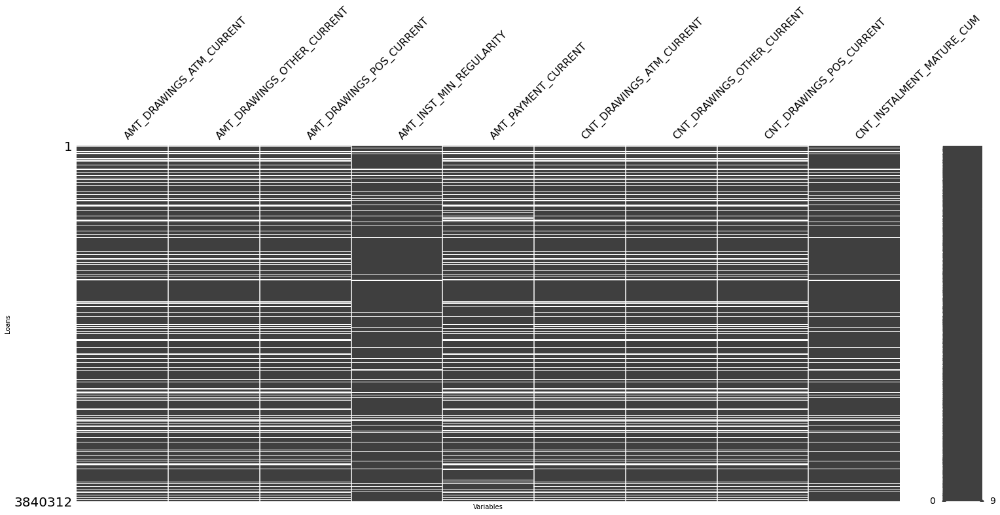

In [297]:
# Utilisation d'un graphique pour avoir une représentation visuelle des valeurs manquantes.

msno.matrix(df_credit_card.loc[:, df_credit_card.isnull().any(axis=0)])

plt.xlabel("Variables")
plt.ylabel("Loans")

- On retrouve 9 variables qui présentent des valeurs manquantes et qui ont un lien entre elles puique l'on a 19.52 % de Nan pour 6 variables et 7.94 % de Nan pour 2 autres variables (la dernière variable à 19.9% de valeurs manquantes).
- On peut maintenant s'intéresser aux variables de ce dataframe :

In [298]:
df_credit_card.info(show_counts=True)

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3840312 entries, 0 to 3840311
Data columns (total 23 columns):
 #   Column                      Non-Null Count    Dtype  
---  ------                      --------------    -----  
 0   SK_ID_PREV                  3840312 non-null  int64  
 1   SK_ID_CURR                  3840312 non-null  int64  
 2   MONTHS_BALANCE              3840312 non-null  int64  
 3   AMT_BALANCE                 3840312 non-null  float64
 4   AMT_CREDIT_LIMIT_ACTUAL     3840312 non-null  int64  
 5   AMT_DRAWINGS_ATM_CURRENT    3090496 non-null  float64
 6   AMT_DRAWINGS_CURRENT        3840312 non-null  float64
 7   AMT_DRAWINGS_OTHER_CURRENT  3090496 non-null  float64
 8   AMT_DRAWINGS_POS_CURRENT    3090496 non-null  float64
 9   AMT_INST_MIN_REGULARITY     3535076 non-null  float64
 10  AMT_PAYMENT_CURRENT         3072324 non-null  float64
 11  AMT_PAYMENT_TOTAL_CURRENT   3840312 non-null  float64
 12  AMT_RECEIVABLE_PRINCIPAL    3840312 non-null  float64
 1

In [299]:
# Recherche de doublons pour la variable ID "SK_ID_PREV"

df_credit_card['SK_ID_PREV'].duplicated().any()

True

In [300]:
# Nombre de lignes présentant au moins un doublon et celles n'en présentant pas.

df_credit_card['SK_ID_PREV'].duplicated(keep=False).value_counts()

True     3839590
False        722
Name: SK_ID_PREV, dtype: int64

In [301]:
# Nombre de ID unique pour cette variable.

df_credit_card['SK_ID_PREV'].nunique()

104307

- Cette variable met en avant des doublons puisqu'il peut y avoir plusieurs crédits précédent la demande de prêt actuelle.

In [302]:
# Recherche de doublons pour la variable ID "SK_ID_CURR"

df_credit_card['SK_ID_CURR'].duplicated().any()

True

In [303]:
# Nombre de lignes présentant au moins un doublon et celles n'en présentant pas.

df_credit_card['SK_ID_CURR'].duplicated(keep=False).value_counts()

True     3839620
False        692
Name: SK_ID_CURR, dtype: int64

In [304]:
# Nombre de ID unique pour cette variable.

df_credit_card['SK_ID_CURR'].nunique()

103558

- Pour cette deuxième variable ID, on retrouve aussi des doublons puisque dans la même logique que l'on puisse trouver plusieurs crédits antérieur à la demande actuelle, chacune des lignes reprend l'ID de la demande de prêt au Bureau et font le lien avec le dataframe principale.

In [305]:
df_credit_card.select_dtypes(include=['object']).nunique()

NAME_CONTRACT_STATUS    7
dtype: int64

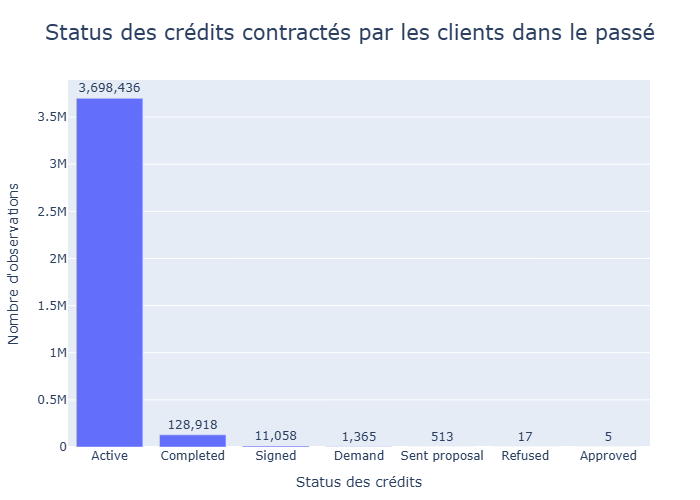

In [306]:
# Visualisation de la répartition pour la variable "NAME_CONTRACT_STATUS"

plot_categorical_histogram(
    df=df_credit_card,
    x="NAME_CONTRACT_STATUS",
    title="Status des crédits contractés par les clients dans le passé",
    xaxis_title= 'Status des crédits',
    title_font_size=21
)

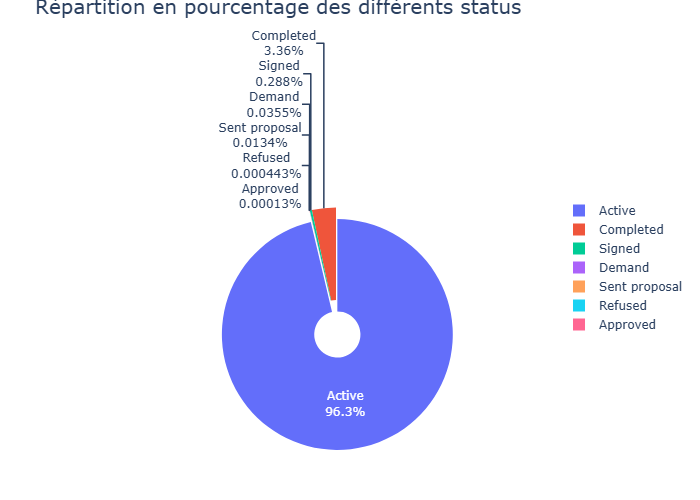

In [307]:
# Visualisation de la répartition en pourcentage pour la variable "NAME_CONTRACT_STATUS"

plot_pie_chart(
    df=df_credit_card,
    column="NAME_CONTRACT_STATUS",
    hole=0.2,
    title_layout = {'y': 1.0},
    title="Répartition en pourcentage des différents status",
    height=700,
    pull_auto=True
)

- Comme on peut le voir, la grande majorité des contrats de ce dataframe sont actifs pour près de 96 % du total et 3 % des contrats sont terminés. Pour le reste on a différent type de statuts mais très faiblement représentés.

In [308]:
# Ajout de la variable 'TARGET' au dataframe df_credit_card

df_credit_card['TARGET'] = df_credit_card['SK_ID_CURR'].map(df_appli_train.set_index('SK_ID_CURR')['TARGET'])

In [309]:
# Nombre d'occurence pour chacune des valeurs de cette variable.

df_credit_card['TARGET'].value_counts(dropna=False)

0.0    2997964
NaN     612347
1.0     230001
Name: TARGET, dtype: int64

- Comme précédemment, on rappelle que l'on a des valeurs nulles car certains IDs sont issues du fichier de test donc on ne les prends pas en compte ici.

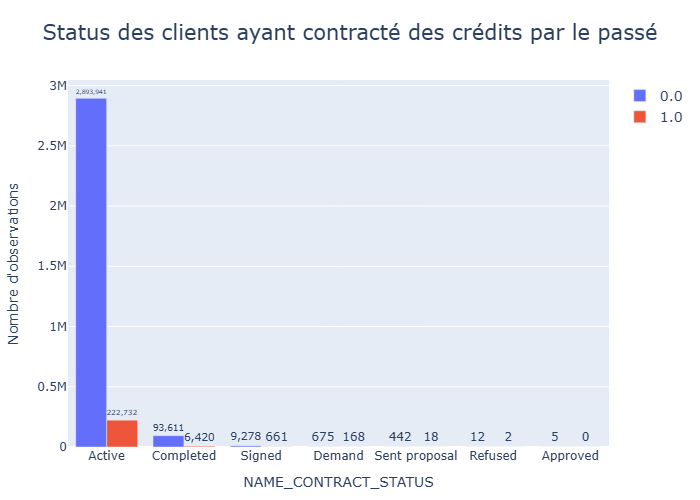

In [310]:
# Visualisation de la répartition pour la variable "NAME_CONTRACT_STATUS" en fonction de la Target.

plot_categorical_histogram(
    df=df_credit_card,
    x="NAME_CONTRACT_STATUS",
    color= 'TARGET',
    title="Status des clients ayant contracté des crédits par le passé",
    title_font_size=21
)

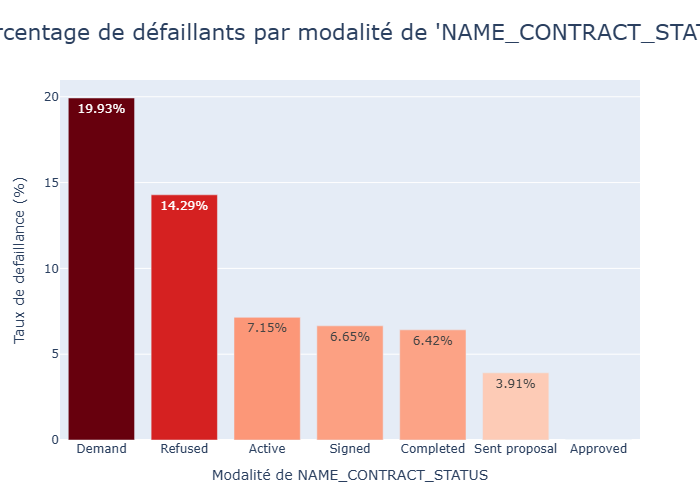

In [311]:
# Visualisation du pourcentage de prêts défaillants pour la variable de NAME_CONTRACT_STATUS.

plot_defaillance_rate_per_category(
    df_credit_card,
    cat_var='NAME_CONTRACT_STATUS',
    title_layout={"x": 0.5},
    xaxis_title = "Modalité de NAME_CONTRACT_STATUS",
    yaxis_title = "Taux de defaillance (%)",
    title_font_size=22
)

- En prenant en compte notre TARGET, on remarque qu'il y a plus de défaillance pour les clients qui sont en demande de crédit ou dont le crédit leur a été refusé. Cela peut être un point intéressant pour la modèlisation même si ces situations restent rares d'après les effectifs.

Ensuite on peut passer aux variables quantitatives :

In [312]:
df_credit_card['MONTHS_BALANCE'].describe().round(0)

count    3840312.0
mean         -35.0
std           27.0
min          -96.0
25%          -55.0
50%          -28.0
75%          -11.0
max           -1.0
Name: MONTHS_BALANCE, dtype: float64

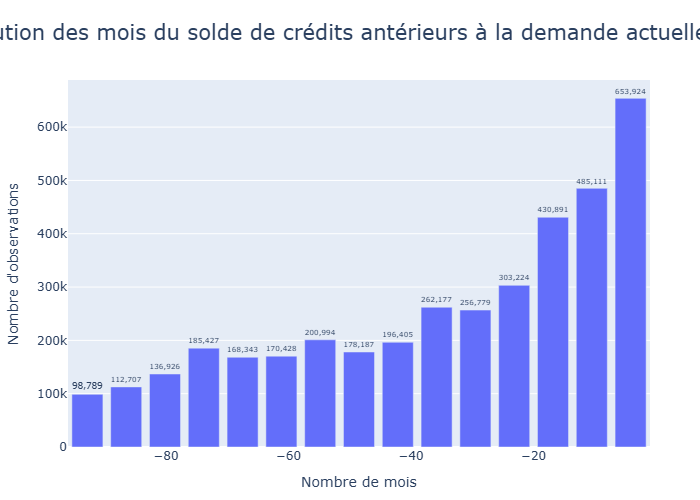

In [313]:
# Visualisation de la distribution pour la variable "MONTHS_BALANCE".

plot_quantitative_histogram(
    df_credit_card,
    x='MONTHS_BALANCE',
    title="Distribution des mois du solde de crédits antérieurs à la demande actuelle",
    title_layout={"x": 0.45},
    title_font_size=21,
    xaxis_title="Nombre de mois",
    yaxis_title="Nombre d'observations",
    width=1000,
    height=600
)

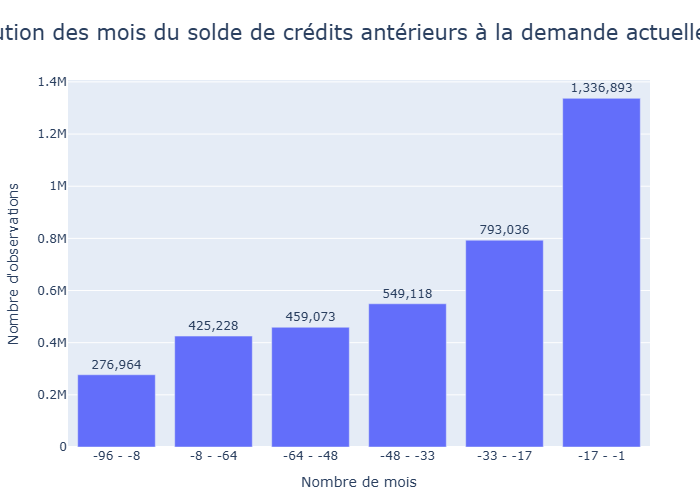

In [314]:
# Visualisation de la répartition pour la variable "MONTHS_BALANCE".

plot_quantitative_histogram(
    df_credit_card,
    x='MONTHS_BALANCE',
    nbins= 6,
    title="Distribution des mois du solde de crédits antérieurs à la demande actuelle",
    title_layout={"x": 0.45},
    title_font_size=21,
    xaxis_title="Nombre de mois",
    yaxis_title="Nombre d'observations",
    bin_as_category=True,
    width=1000,
    height=600
)

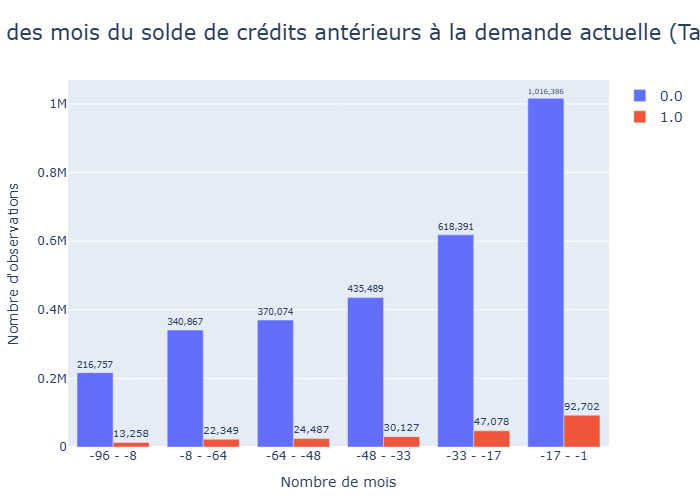

In [315]:
# Visualisation de la répartition pour la variable "MONTHS_BALANCE" avec la Target.

plot_quantitative_histogram(
    df_credit_card,
    x='MONTHS_BALANCE',
    color='TARGET',
    nbins= 6,
    title="Distribution des mois du solde de crédits antérieurs à la demande actuelle (Target)",
    title_layout={"x": 0.45},
    title_font_size=21,
    xaxis_title="Nombre de mois",
    yaxis_title="Nombre d'observations",
    bin_as_category=True,
    width=1000,
    height=600
)

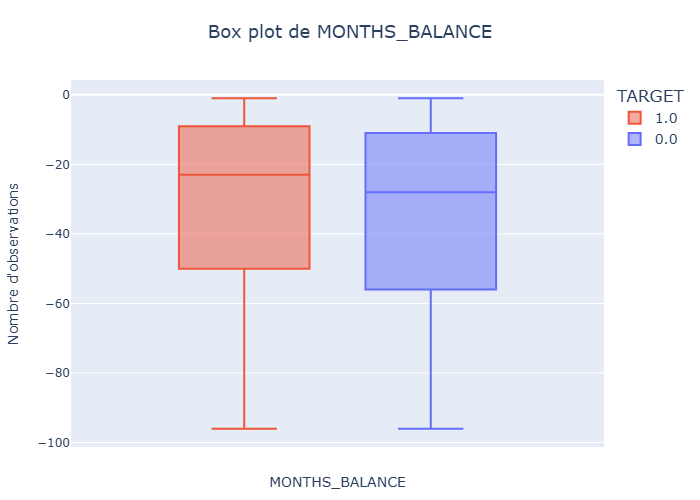

In [316]:
# Visualisation de la répartition pour la variable "MONTHS_BALANCE"

plot_quantitative_box_violin(df_credit_card, 
                            x="MONTHS_BALANCE",
                            plot_type="box",
                            color='TARGET',
                            width=800,
                            height=700,
                            xaxis_title="MONTHS_BALANCE",
                            yaxis_title="Nombre d'observations",
                            color_map={0: "#636EFA", 1: "#EF553B"}
                            )

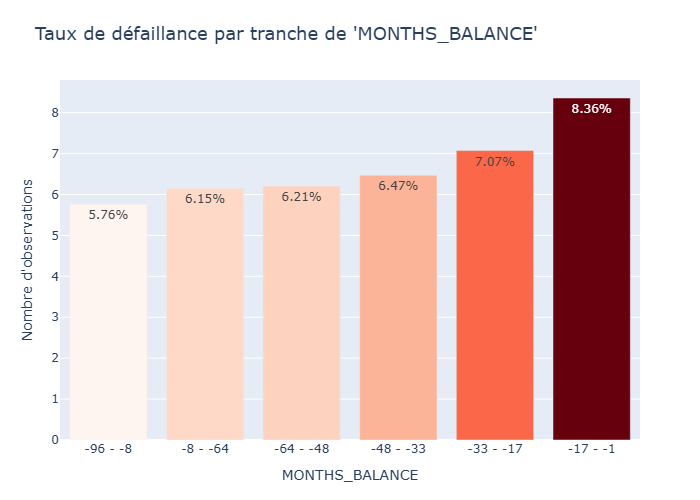

In [317]:
# Visualisation du taux de défaillance pour la variable "MONTHS_BALANCE".

plot_defaillance_rate_per_quantitative(df_credit_card, 
                                       "MONTHS_BALANCE",
                                       target_var="TARGET",
                                       nbins=6,
                                       width=800,
                                       height=700,
                                       xaxis_title="MONTHS_BALANCE",
                                       yaxis_title="Nombre d'observations")

- Dans l'ensemble, les défaillants ont un mois du solde plus récent que l'autre groupe. Et cela se vérifie dans le dernier graphique puisque le taux de défaillance diminue plus le nombre de mois augmente.

In [318]:
df_credit_card['AMT_BALANCE'].describe().round(0)

count    3840312.0
mean       58300.0
std       106307.0
min      -420250.0
25%            0.0
50%            0.0
75%        89047.0
max      1505902.0
Name: AMT_BALANCE, dtype: float64

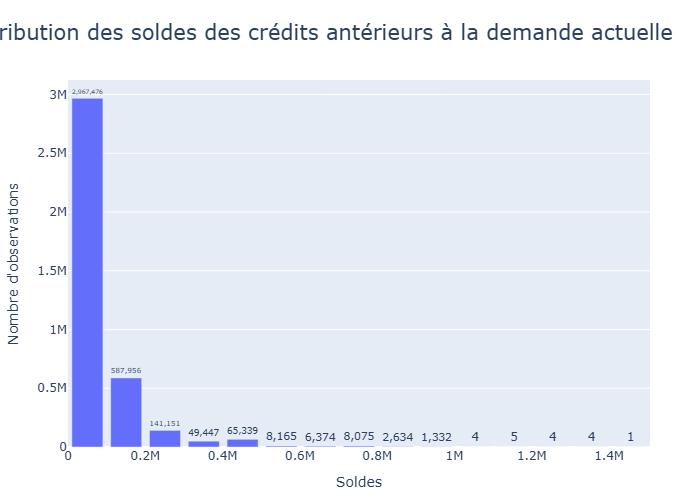

In [319]:
# Visualisation de la distribution pour la variable "AMT_BALANCE".

plot_quantitative_histogram(
    df_credit_card,
    x='AMT_BALANCE',
    title="Distribution des soldes des crédits antérieurs à la demande actuelle",
    title_layout={"x": 0.45},
    title_font_size=21,
    xaxis_title="Soldes",
    yaxis_title="Nombre d'observations",
    min_quantile=0.001,
    width=1000,
    height=600
)

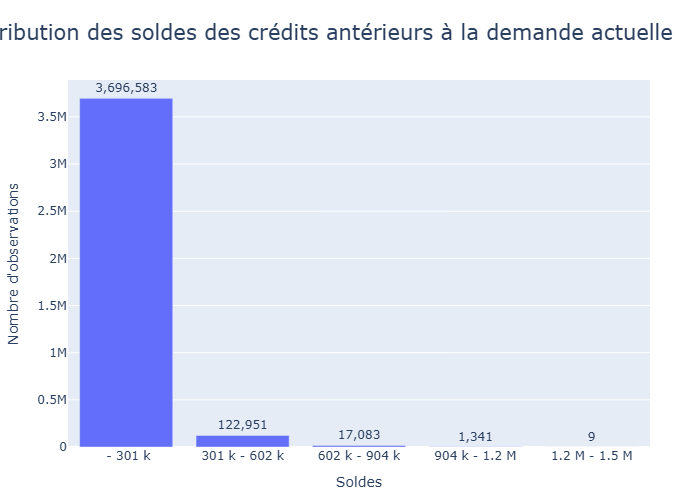

In [320]:
# Visualisation de la répartition pour la variable "AMT_BALANCE".

plot_quantitative_histogram(
    df_credit_card,
    x='AMT_BALANCE',
    nbins= 5,
    title="Distribution des soldes des crédits antérieurs à la demande actuelle",
    title_layout={"x": 0.45},
    title_font_size=21,
    xaxis_title="Soldes",
    yaxis_title="Nombre d'observations",
    min_quantile=0.001,
    bin_as_category=True,
    width=1000,
    height=600
)

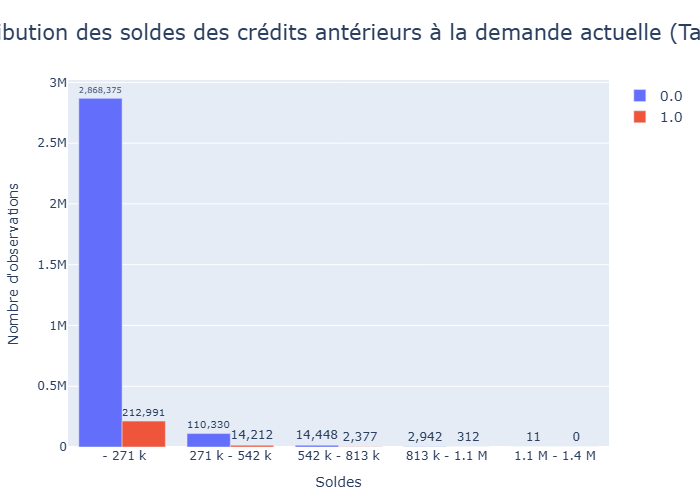

In [321]:
# Visualisation de la répartition pour la variable "AMT_BALANCE" avec la Target.

plot_quantitative_histogram(
    df_credit_card,
    x='AMT_BALANCE',
    color='TARGET',
    nbins= 5,
    title="Distribution des soldes des crédits antérieurs à la demande actuelle (Target)",
    title_layout={"x": 0.5},
    title_font_size=21,
    xaxis_title="Soldes",
    yaxis_title="Nombre d'observations",
    min_quantile=0.001,
    bin_as_category=True,
    width=1000,
    height=600
)

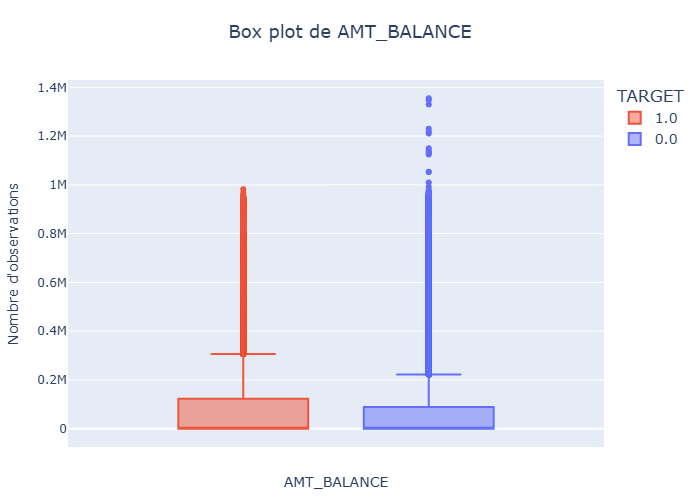

In [322]:
# Visualisation de la répartition pour la variable "AMT_BALANCE"

plot_quantitative_box_violin(df_credit_card, 
                            x="AMT_BALANCE",
                            plot_type="box",
                            color='TARGET',
                            width=800,
                            height=700,
                            xaxis_title="AMT_BALANCE",
                            yaxis_title="Nombre d'observations",
                            min_quantile=0.001,
                            color_map={0: "#636EFA", 1: "#EF553B"}
                            )

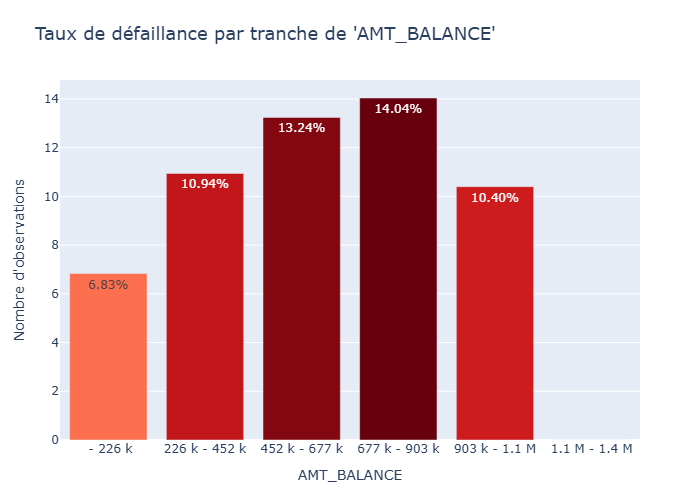

In [323]:
# Visualisation du taux de défaillance pour la variable "MONTHS_BALANCE".

plot_defaillance_rate_per_quantitative(df_credit_card, 
                                       "AMT_BALANCE",
                                       target_var="TARGET",
                                       nbins=6,
                                       width=800,
                                       height=700,
                                       xaxis_title="AMT_BALANCE",
                                       min_quantile=0.001,
                                       yaxis_title="Nombre d'observations")

- Dans l'ensemble les défaillants ont des soldes plus importants que les non défaillants donc cela peut être dû a des crédits avec des montants initiaux plus élevés ou des difficultés à rembourser mises en avant.
- Cependant on ne peut pas établir avec certitude le lien entre ces deux variables vu l'évolution des taux de défaillance.

In [324]:
df_credit_card['AMT_CREDIT_LIMIT_ACTUAL'].describe().round(0)

count    3840312.0
mean      153808.0
std       165146.0
min            0.0
25%        45000.0
50%       112500.0
75%       180000.0
max      1350000.0
Name: AMT_CREDIT_LIMIT_ACTUAL, dtype: float64

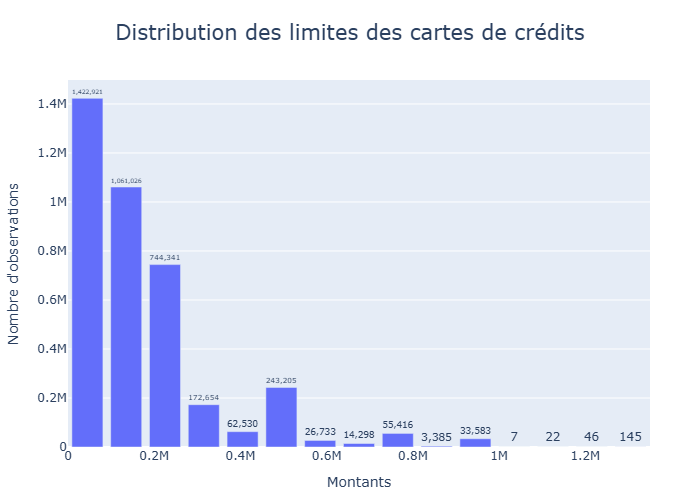

In [325]:
# Visualisation de la distribution pour la variable "AMT_CREDIT_LIMIT_ACTUAL".

plot_quantitative_histogram(
    df_credit_card,
    x='AMT_CREDIT_LIMIT_ACTUAL',
    title="Distribution des limites des cartes de crédits",
    title_layout={"x": 0.5},
    title_font_size=21,
    xaxis_title="Montants",
    yaxis_title="Nombre d'observations",
    width=1000,
    height=600
)

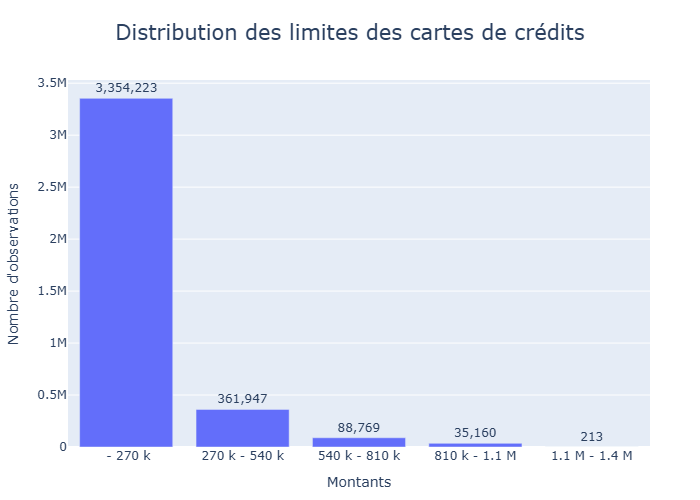

In [326]:
# Visualisation de la répartition pour la variable "AMT_CREDIT_LIMIT_ACTUAL".

plot_quantitative_histogram(
    df_credit_card,
    x='AMT_CREDIT_LIMIT_ACTUAL',
    nbins= 5,
    title="Distribution des limites des cartes de crédits",
    title_layout={"x": 0.5},
    title_font_size=21,
    xaxis_title="Montants",
    yaxis_title="Nombre d'observations",
    bin_as_category=True,
    width=1000,
    height=600
)

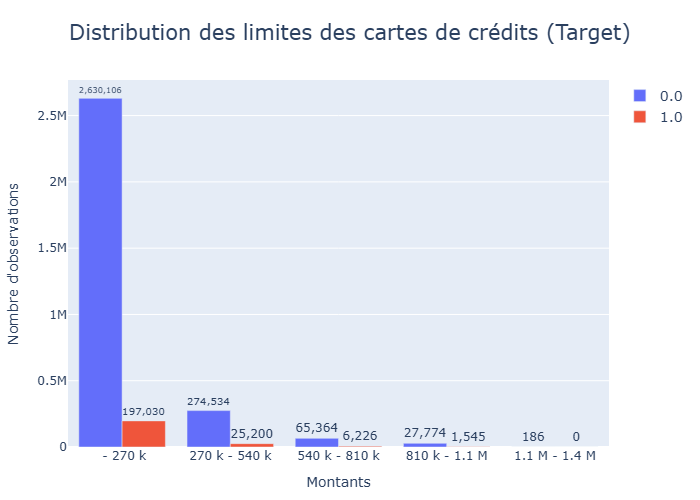

In [327]:
# Visualisation de la répartition pour la variable "AMT_CREDIT_LIMIT_ACTUAL" avec la Target.

plot_quantitative_histogram(
    df_credit_card,
    x='AMT_CREDIT_LIMIT_ACTUAL',
    color='TARGET',
    nbins= 5,
    title="Distribution des limites des cartes de crédits (Target)",
    title_layout={"x": 0.5},
    title_font_size=21,
    xaxis_title="Montants",
    yaxis_title="Nombre d'observations",
    bin_as_category=True,
    width=1000,
    height=600
)

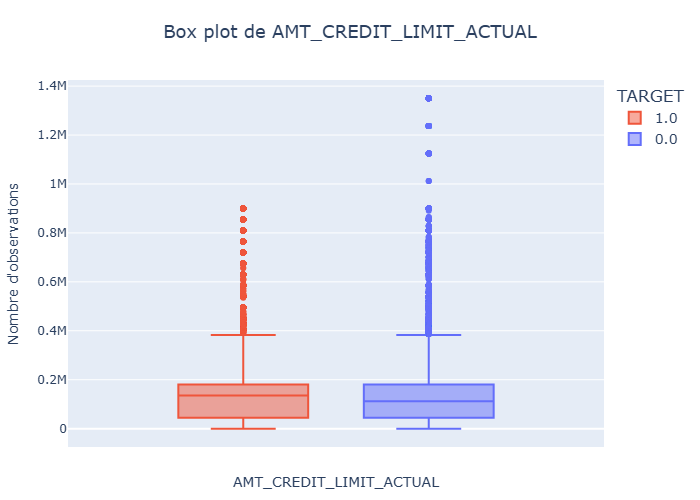

In [328]:
# Visualisation de la répartition pour la variable "AMT_CREDIT_LIMIT_ACTUAL"

plot_quantitative_box_violin(df_credit_card, 
                            x="AMT_CREDIT_LIMIT_ACTUAL",
                            plot_type="box",
                            color='TARGET',
                            width=800,
                            height=700,
                            xaxis_title="AMT_CREDIT_LIMIT_ACTUAL",
                            yaxis_title="Nombre d'observations",
                            color_map={0: "#636EFA", 1: "#EF553B"}
                            )

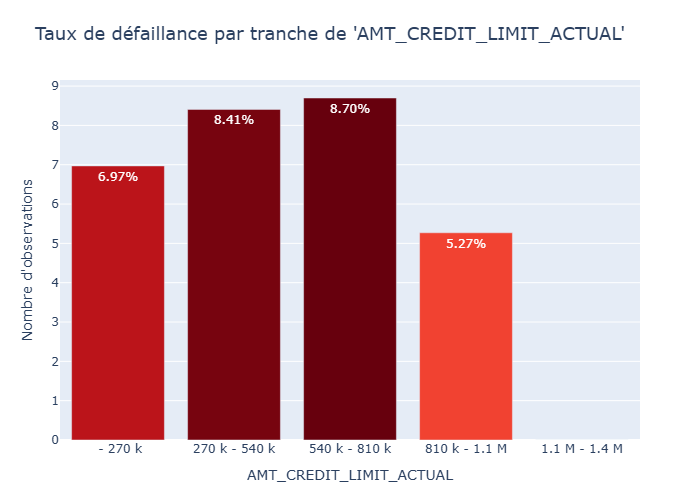

In [329]:
# Visualisation du taux de défaillance pour la variable "AMT_CREDIT_LIMIT_ACTUAL".

plot_defaillance_rate_per_quantitative(df_credit_card, 
                                       "AMT_CREDIT_LIMIT_ACTUAL",
                                       target_var="TARGET",
                                       nbins=5,
                                       width=800,
                                       height=700,
                                       xaxis_title="AMT_CREDIT_LIMIT_ACTUAL",
                                       min_quantile=0.001,
                                       yaxis_title="Nombre d'observations")

- Pour cette variable, on peut voir que les limites des cartes de crédits des clients défaillants sont un peu plus importantes que les clients non défaillants.
- Même constat que précédemment concernant le lien entre la Target et cette variable.

In [330]:
df_credit_card['AMT_DRAWINGS_ATM_CURRENT'].describe().round(0)

count    3090496.0
mean        5961.0
std        28226.0
min        -6827.0
25%            0.0
50%            0.0
75%            0.0
max      2115000.0
Name: AMT_DRAWINGS_ATM_CURRENT, dtype: float64

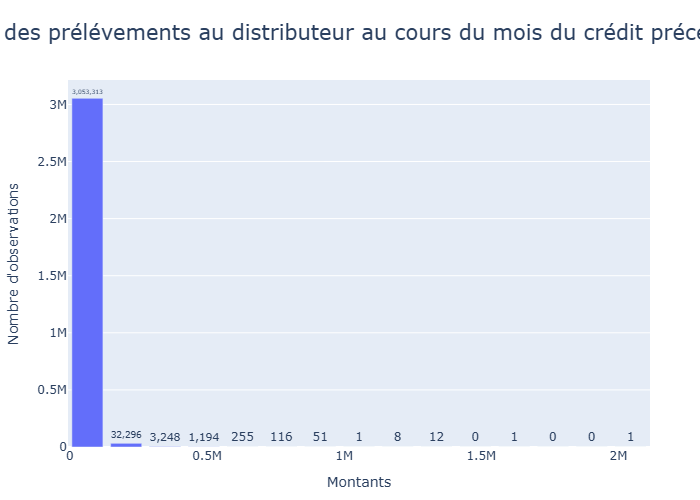

In [331]:
# Visualisation de la distribution pour la variable "AMT_DRAWINGS_ATM_CURRENT".

plot_quantitative_histogram(
    df_credit_card,
    x='AMT_DRAWINGS_ATM_CURRENT',
    title="Distribution des prélévements au distributeur au cours du mois du crédit précédent",
    title_layout={"x": 0.45},
    title_font_size=21,
    xaxis_title="Montants",
    yaxis_title="Nombre d'observations",
    width=1000,
    height=600
)

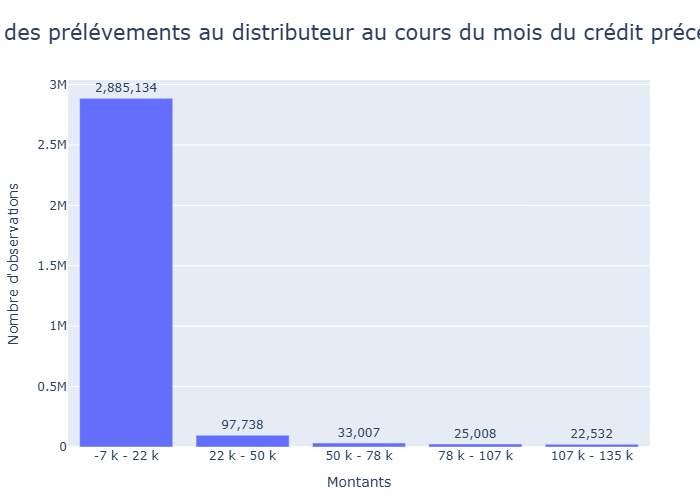

In [332]:
# Visualisation de la répartition pour la variable "AMT_DRAWINGS_ATM_CURRENT".

plot_quantitative_histogram(
    df_credit_card,
    x='AMT_DRAWINGS_ATM_CURRENT',
    nbins= 5,
    title="Distribution des prélévements au distributeur au cours du mois du crédit précédent",
    title_layout={"x": 0.45},
    title_font_size=21,
    xaxis_title="Montants",
    yaxis_title="Nombre d'observations",
    bin_as_category=True,
    max_quantile= 0.99,
    width=1000,
    height=600
)

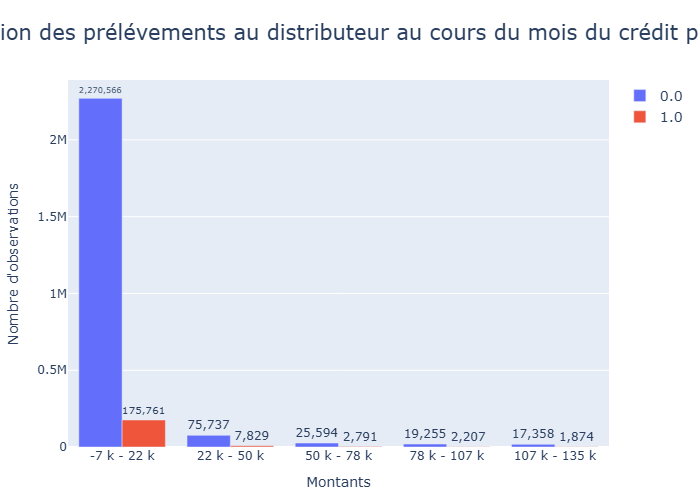

In [333]:
# Visualisation de la répartition pour la variable "AMT_DRAWINGS_ATM_CURRENT".

plot_quantitative_histogram(
    df_credit_card,
    x='AMT_DRAWINGS_ATM_CURRENT',
    color='TARGET',
    nbins= 5,
    title="Distribution des prélévements au distributeur au cours du mois du crédit précédent",
    title_layout={"x": 0.5},
    title_font_size=21,
    xaxis_title="Montants",
    yaxis_title="Nombre d'observations",
    bin_as_category=True,
    max_quantile= 0.99,
    width=1000,
    height=600
)

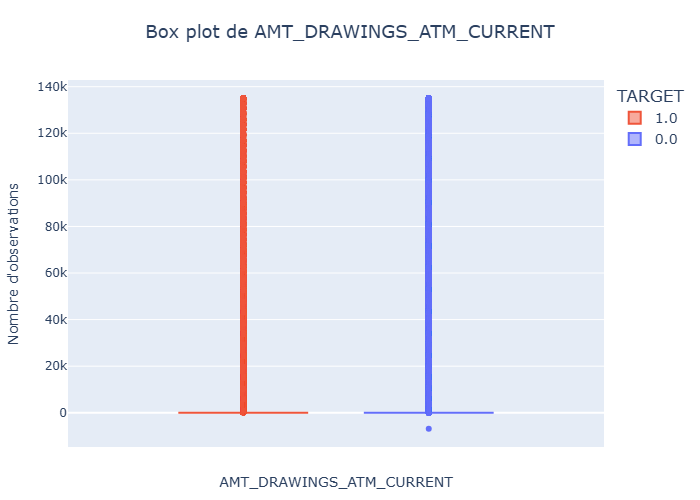

In [334]:
# Visualisation de la répartition pour la variable "AMT_DRAWINGS_ATM_CURRENT"

plot_quantitative_box_violin(df_credit_card, 
                            x="AMT_DRAWINGS_ATM_CURRENT",
                            plot_type="box",
                            color='TARGET',
                            width=800,
                            height=700,
                            xaxis_title="AMT_DRAWINGS_ATM_CURRENT",
                            yaxis_title="Nombre d'observations",
                            max_quantile= 0.99,
                            color_map={0: "#636EFA", 1: "#EF553B"}
                            )

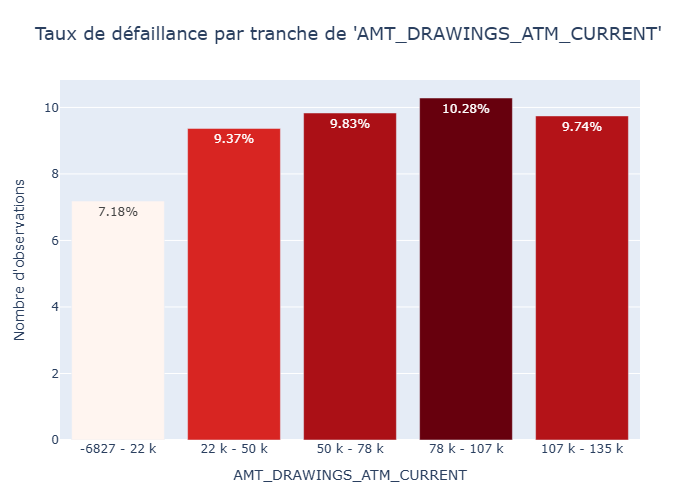

In [335]:
# Visualisation du taux de défaillance pour la variable "AMT_DRAWINGS_ATM_CURRENT".

plot_defaillance_rate_per_quantitative(df_credit_card, 
                                       "AMT_DRAWINGS_ATM_CURRENT",
                                       target_var="TARGET",
                                       nbins=5,
                                       width=800,
                                       height=700,
                                       xaxis_title="AMT_DRAWINGS_ATM_CURRENT",
                                       max_quantile=0.99,
                                       yaxis_title="Nombre d'observations")

- Pour cette variable, on peut souligner le fait que les cas de défaillances semblent augmentés avec le montants des prélévements (en enlevant les outliers car ce n'est plus le cas lorsque l'on dépasse certaines sommes)

In [336]:
df_credit_card['AMT_DRAWINGS_CURRENT'].describe().round(0)

count    3840312.0
mean        7433.0
std        33846.0
min        -6212.0
25%            0.0
50%            0.0
75%            0.0
max      2287098.0
Name: AMT_DRAWINGS_CURRENT, dtype: float64

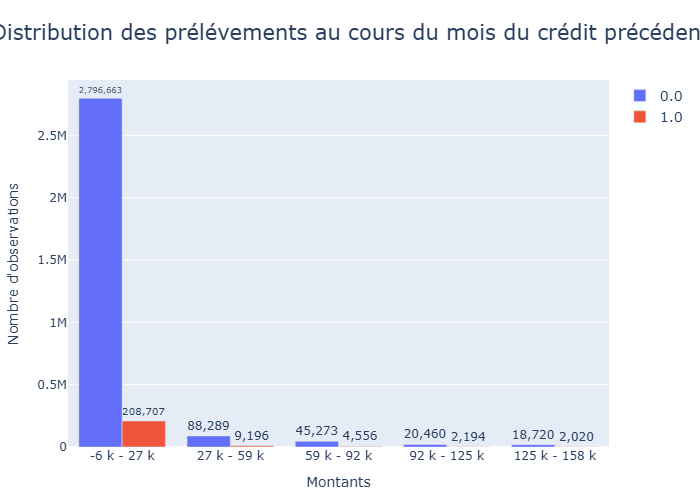

In [337]:
# Visualisation de la répartition pour la variable "AMT_DRAWINGS_CURRENT".

plot_quantitative_histogram(
    df_credit_card,
    x='AMT_DRAWINGS_CURRENT',
    color='TARGET',
    nbins= 5,
    title="Distribution des prélévements au cours du mois du crédit précédent",
    title_layout={"x": 0.5},
    title_font_size=21,
    xaxis_title="Montants",
    yaxis_title="Nombre d'observations",
    bin_as_category=True,
    max_quantile= 0.99,
    width=1000,
    height=600
)

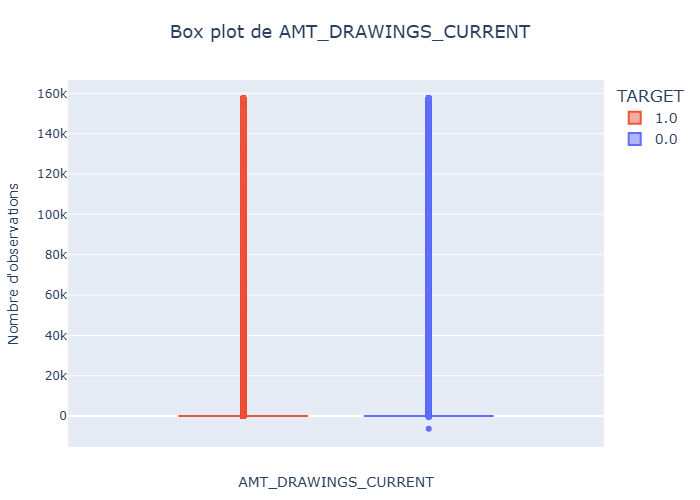

In [338]:
# Visualisation de la répartition pour la variable "AMT_DRAWINGS_CURRENT"

plot_quantitative_box_violin(df_credit_card, 
                            x="AMT_DRAWINGS_CURRENT",
                            plot_type="box",
                            color='TARGET',
                            width=800,
                            height=700,
                            xaxis_title="AMT_DRAWINGS_CURRENT",
                            yaxis_title="Nombre d'observations",
                            max_quantile= 0.99,
                            color_map={0: "#636EFA", 1: "#EF553B"}
                            )

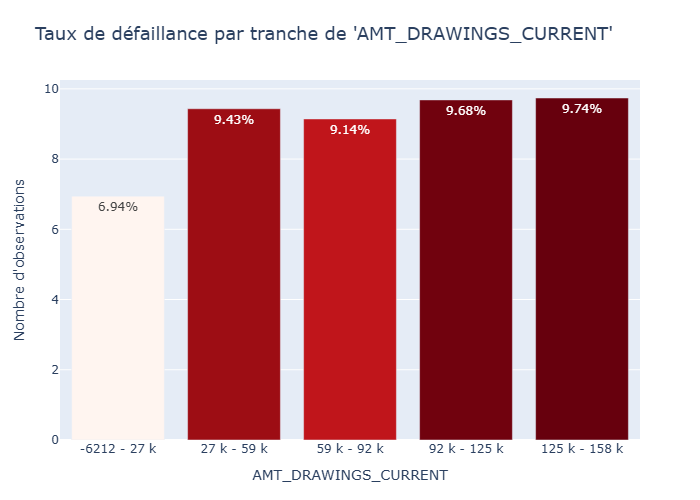

In [339]:
# Visualisation du taux de défaillance pour la variable "AMT_DRAWINGS_CURRENT".

plot_defaillance_rate_per_quantitative(df_credit_card, 
                                       "AMT_DRAWINGS_CURRENT",
                                       target_var="TARGET",
                                       nbins=5,
                                       width=800,
                                       height=700,
                                       xaxis_title="AMT_DRAWINGS_CURRENT",
                                       max_quantile= 0.99,
                                       yaxis_title="Nombre d'observations")

- Constat assez similaires que pour les distributeurs mais les taux de défaillance semblent être ici similaire quelque soit l'échelon des montants.

In [340]:
df_credit_card['AMT_DRAWINGS_OTHER_CURRENT'].describe().round(0)

count    3090496.0
mean         288.0
std         8202.0
min            0.0
25%            0.0
50%            0.0
75%            0.0
max      1529847.0
Name: AMT_DRAWINGS_OTHER_CURRENT, dtype: float64

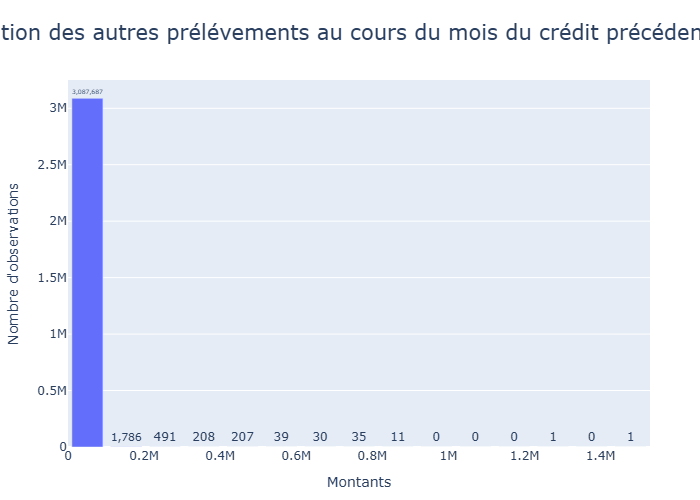

In [341]:
# Visualisation de la distribution pour la variable "AMT_DRAWINGS_OTHER_CURRENT".

plot_quantitative_histogram(
    df_credit_card,
    x='AMT_DRAWINGS_OTHER_CURRENT',
    title="Distribution des autres prélévements au cours du mois du crédit précédent",
    title_layout={"x": 0.45},
    title_font_size=21,
    xaxis_title="Montants",
    yaxis_title="Nombre d'observations",
    width=1000,
    height=600
)

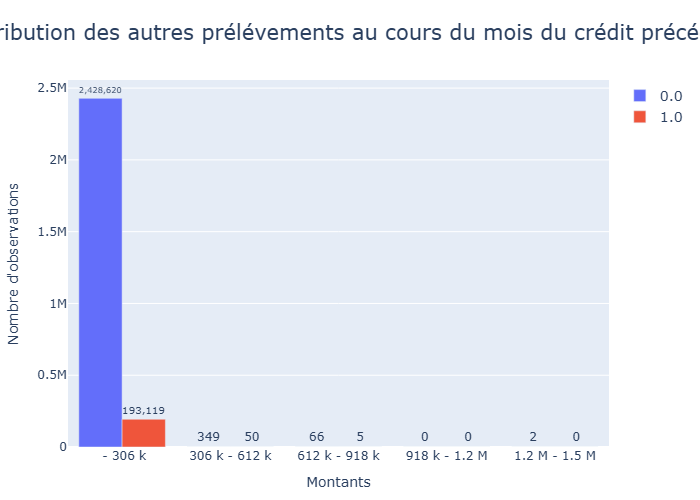

In [342]:
# Visualisation de la répartition pour la variable "AMT_DRAWINGS_OTHER_CURRENT"

plot_quantitative_histogram(
    df_credit_card,
    x='AMT_DRAWINGS_OTHER_CURRENT',
    color='TARGET',
    nbins= 5,
    title="Distribution des autres prélévements au cours du mois du crédit précédent",
    title_layout={"x": 0.5},
    title_font_size=21,
    xaxis_title="Montants",
    yaxis_title="Nombre d'observations",
    bin_as_category=True,
    width=1000,
    height=600
)

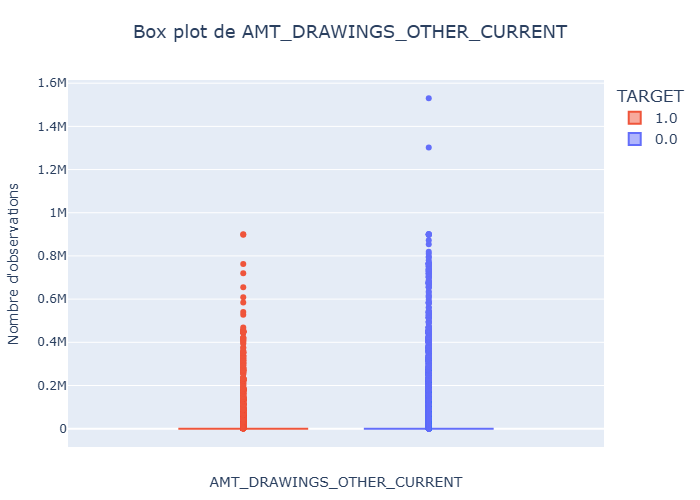

In [343]:
# Visualisation de la répartition pour la variable "AMT_DRAWINGS_OTHER_CURRENT"

plot_quantitative_box_violin(df_credit_card, 
                            x="AMT_DRAWINGS_OTHER_CURRENT",
                            plot_type="box",
                            color='TARGET',
                            width=800,
                            height=700,
                            xaxis_title="AMT_DRAWINGS_OTHER_CURRENT",
                            yaxis_title="Nombre d'observations",
                            color_map={0: "#636EFA", 1: "#EF553B"}
                            )

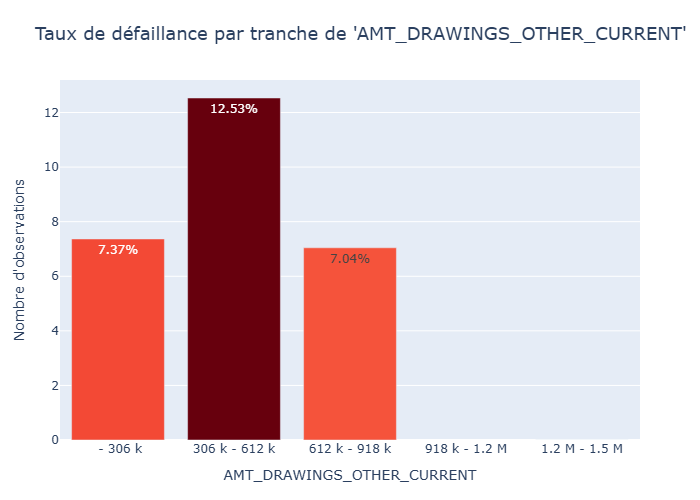

In [344]:
# Visualisation du taux de défaillance pour la variable "AMT_DRAWINGS_OTHER_CURRENT".

plot_defaillance_rate_per_quantitative(df_credit_card, 
                                       "AMT_DRAWINGS_OTHER_CURRENT",
                                       target_var="TARGET",
                                       nbins=5,
                                       width=800,
                                       height=700,
                                       xaxis_title="AMT_DRAWINGS_OTHER_CURRENT",
                                       yaxis_title="Nombre d'observations")

- Distributions assez similaires entre les groupes et pas de lien évident entre la Target et la variable.

In [345]:
df_credit_card['AMT_DRAWINGS_POS_CURRENT'].describe().round(0)

count    3090496.0
mean        2969.0
std        20797.0
min            0.0
25%            0.0
50%            0.0
75%            0.0
max      2239274.0
Name: AMT_DRAWINGS_POS_CURRENT, dtype: float64

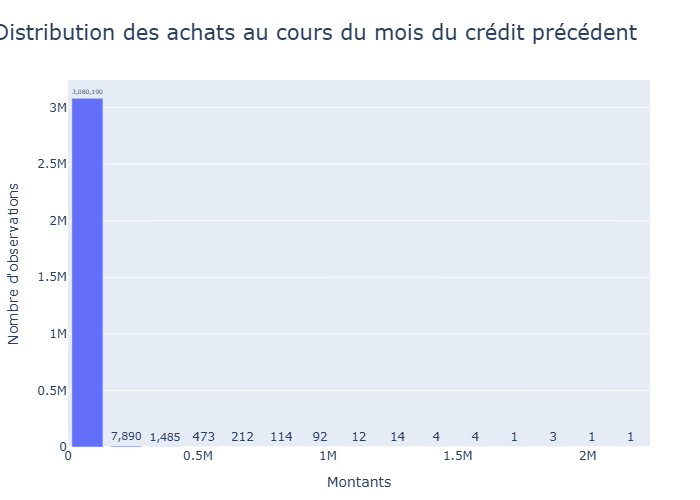

In [346]:
# Visualisation de la distribution pour la variable "AMT_DRAWINGS_POS_CURRENT".

plot_quantitative_histogram(
    df_credit_card,
    x='AMT_DRAWINGS_POS_CURRENT',
    title="Distribution des achats au cours du mois du crédit précédent",
    title_layout={"x": 0.45},
    title_font_size=21,
    xaxis_title="Montants",
    yaxis_title="Nombre d'observations",
    width=1000,
    height=600
)

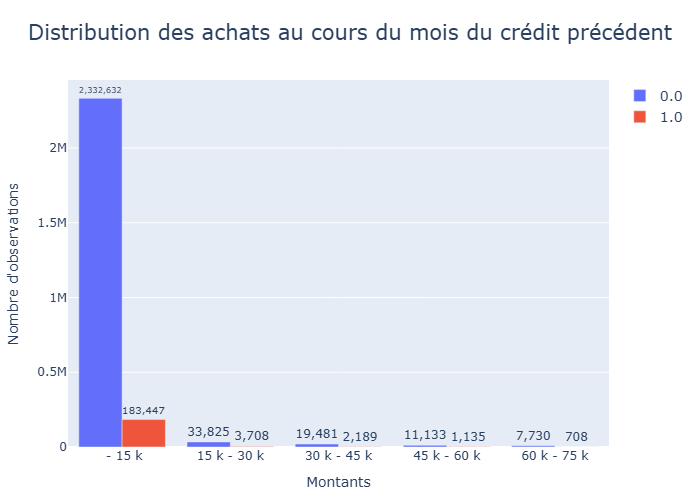

In [347]:
# Visualisation de la répartition pour la variable "AMT_DRAWINGS_POS_CURRENT"

plot_quantitative_histogram(
    df_credit_card,
    x='AMT_DRAWINGS_POS_CURRENT',
    color='TARGET',
    nbins= 5,
    title="Distribution des achats au cours du mois du crédit précédent",
    title_layout={"x": 0.5},
    title_font_size=21,
    xaxis_title="Montants",
    yaxis_title="Nombre d'observations",
    bin_as_category=True,
    max_quantile=0.99,
    width=1000,
    height=600
)

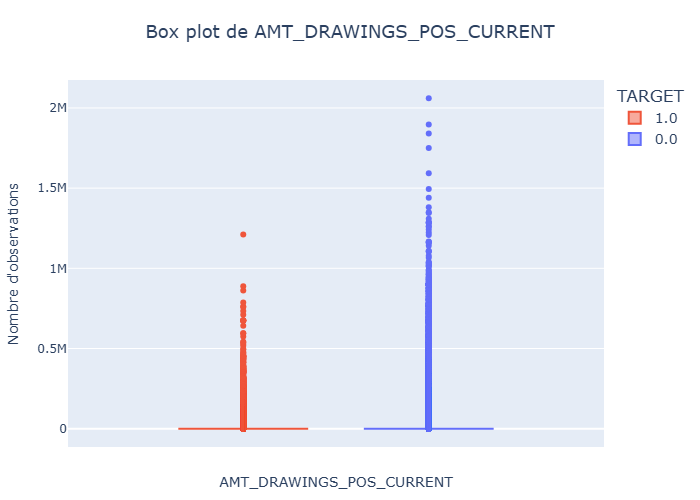

In [348]:
# Visualisation de la répartition pour la variable "AMT_DRAWINGS_POS_CURRENT"

plot_quantitative_box_violin(df_credit_card, 
                            x="AMT_DRAWINGS_POS_CURRENT",
                            plot_type="box",
                            color='TARGET',
                            width=800,
                            height=700,
                            xaxis_title="AMT_DRAWINGS_POS_CURRENT",
                            yaxis_title="Nombre d'observations",
                            color_map={0: "#636EFA", 1: "#EF553B"}
                            )

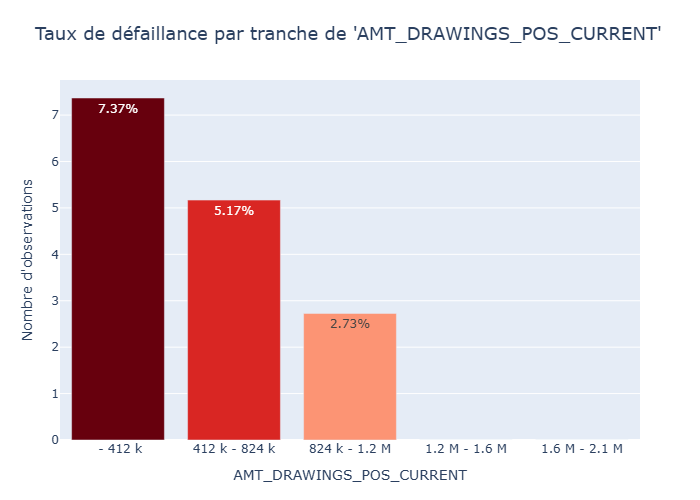

In [349]:
# Visualisation du taux de défaillance pour la variable "AMT_DRAWINGS_POS_CURRENT".

plot_defaillance_rate_per_quantitative(df_credit_card, 
                                       "AMT_DRAWINGS_POS_CURRENT",
                                       target_var="TARGET",
                                       nbins=5,
                                       width=800,
                                       height=700,
                                       xaxis_title="AMT_DRAWINGS_POS_CURRENT",
                                       yaxis_title="Nombre d'observations")

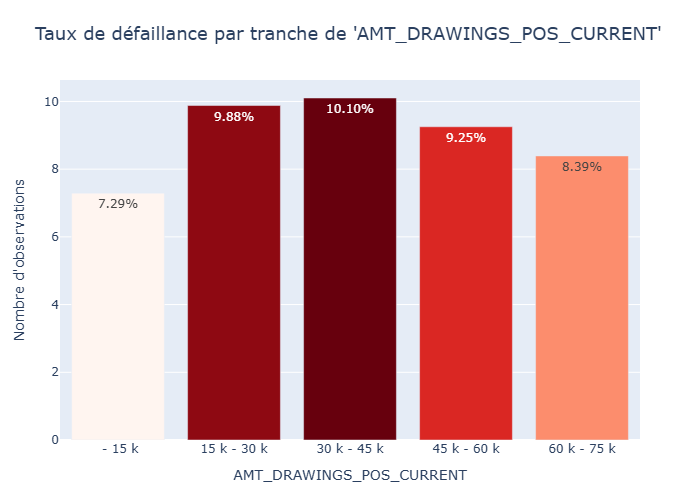

In [350]:
# Visualisation du taux de défaillance pour la variable "AMT_DRAWINGS_POS_CURRENT".

plot_defaillance_rate_per_quantitative(df_credit_card, 
                                       "AMT_DRAWINGS_POS_CURRENT",
                                       target_var="TARGET",
                                       nbins=5,
                                       width=800,
                                       height=700,
                                       xaxis_title="AMT_DRAWINGS_POS_CURRENT",
                                       max_quantile=0.99,
                                       yaxis_title="Nombre d'observations")

- Les distribution des deux groupes sont assez similaires et le taux de défaillance semble diminuer à mesure que les achats augmentent (comme on peut le voir lorsque l'on enlève les plus gros montants (outliers) le taux est assez stable quelque soit l'intervalle de valeurs qui représente dans le dernier graphique 99% de l'effectif)

In [351]:
df_credit_card['AMT_INST_MIN_REGULARITY'].describe().round(0)

count    3535076.0
mean        3540.0
std         5600.0
min            0.0
25%            0.0
50%            0.0
75%         6634.0
max       202882.0
Name: AMT_INST_MIN_REGULARITY, dtype: float64

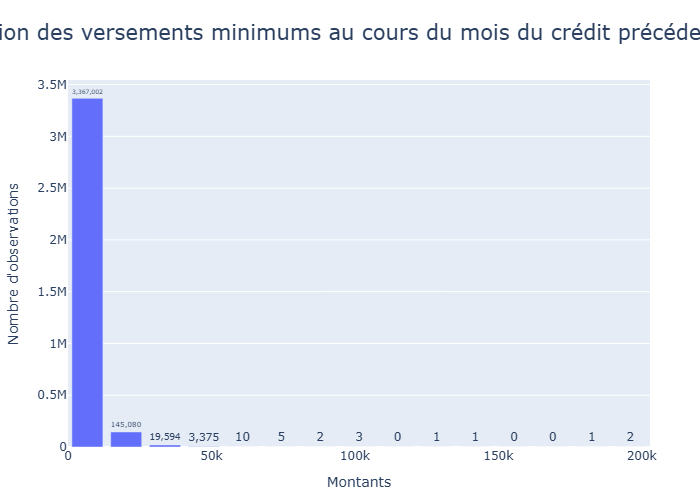

In [352]:
# Visualisation de la distribution pour la variable "AMT_INST_MIN_REGULARITY".

plot_quantitative_histogram(
    df_credit_card,
    x='AMT_INST_MIN_REGULARITY',
    title="Distribution des versements minimums au cours du mois du crédit précédent",
    title_layout={"x": 0.45},
    title_font_size=21,
    xaxis_title="Montants",
    yaxis_title="Nombre d'observations",
    width=1000,
    height=600
)

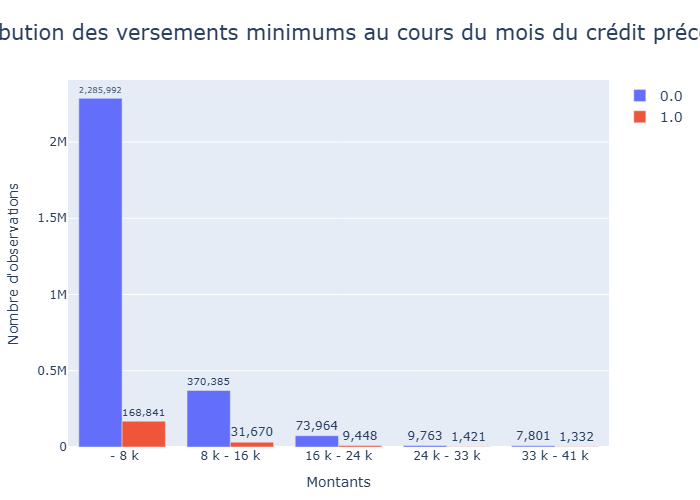

In [353]:
# Visualisation de la répartition pour la variable "AMT_INST_MIN_REGULARITY"

plot_quantitative_histogram(
    df_credit_card,
    x='AMT_INST_MIN_REGULARITY',
    color='TARGET',
    nbins= 5,
    title="Distribution des versements minimums au cours du mois du crédit précédent",
    title_layout={"x": 0.5},
    title_font_size=21,
    xaxis_title="Montants",
    yaxis_title="Nombre d'observations",
    bin_as_category=True,
    max_quantile=0.999,
    width=1000,
    height=600
)

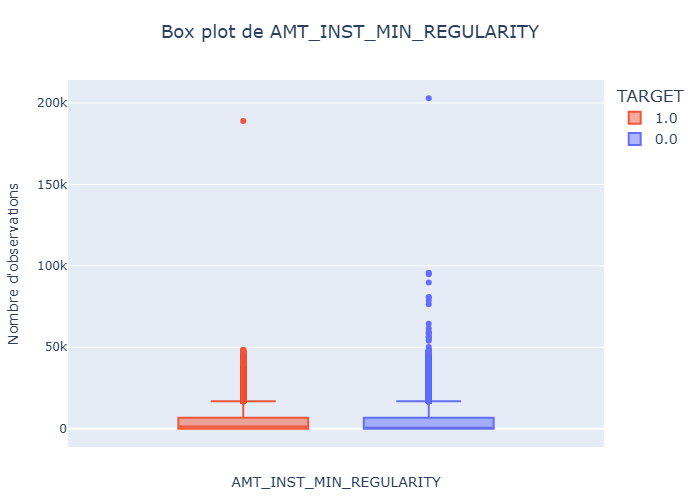

In [354]:
# Visualisation de la répartition pour la variable "AMT_INST_MIN_REGULARITY"

plot_quantitative_box_violin(df_credit_card, 
                            x="AMT_INST_MIN_REGULARITY",
                            plot_type="box",
                            color='TARGET',
                            width=800,
                            height=700,
                            xaxis_title="AMT_INST_MIN_REGULARITY",
                            yaxis_title="Nombre d'observations",
                            color_map={0: "#636EFA", 1: "#EF553B"}
                            )

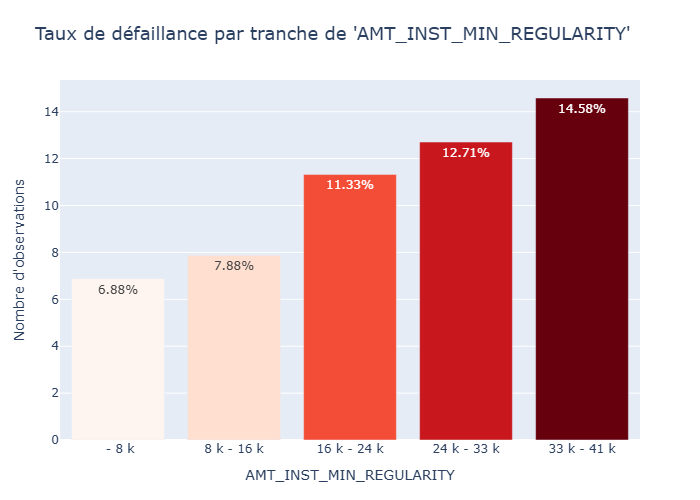

In [355]:
# Visualisation du taux de défaillance pour la variable "AMT_INST_MIN_REGULARITY".

plot_defaillance_rate_per_quantitative(df_credit_card, 
                                       "AMT_INST_MIN_REGULARITY",
                                       target_var="TARGET",
                                       nbins=5,
                                       width=800,
                                       height=700,
                                       max_quantile=0.999,
                                       xaxis_title="AMT_INST_MIN_REGULARITY",
                                       yaxis_title="Nombre d'observations")

- Pour cette variable il est intéressant de voir que lorsque l'on écarte les outliers, plus le versement minimum de régularisation du crédit est important plus le taux de défaillance augmente, cela peut être intéressant à prendre en compte par la suite.

In [356]:
df_credit_card['AMT_PAYMENT_CURRENT'].describe().round(0)

count    3072324.0
mean       10281.0
std        36078.0
min            0.0
25%          152.0
50%         2703.0
75%         9000.0
max      4289207.0
Name: AMT_PAYMENT_CURRENT, dtype: float64

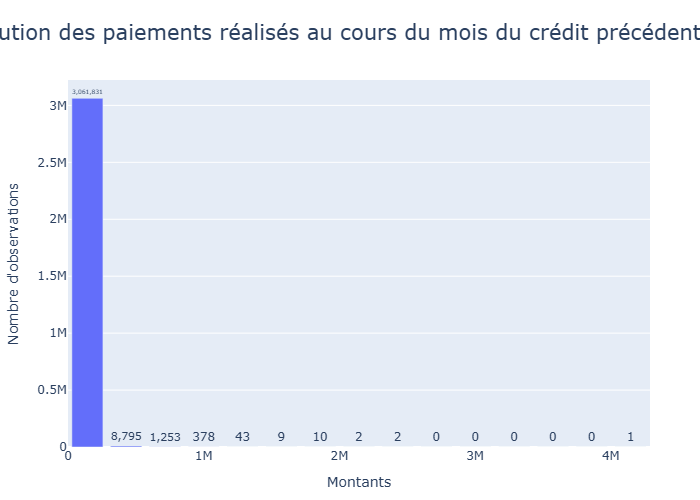

In [357]:
# Visualisation de la distribution pour la variable "AMT_PAYMENT_CURRENT".

plot_quantitative_histogram(
    df_credit_card,
    x='AMT_PAYMENT_CURRENT',
    title="Distribution des paiements réalisés au cours du mois du crédit précédent",
    title_layout={"x": 0.45},
    title_font_size=21,
    xaxis_title="Montants",
    yaxis_title="Nombre d'observations",
    width=1000,
    height=600
)

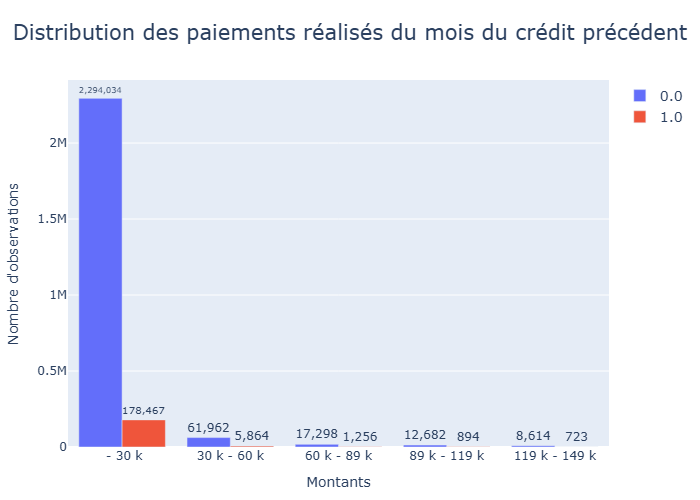

In [358]:
# Visualisation de la répartition pour la variable "AMT_PAYMENT_CURRENT"

plot_quantitative_histogram(
    df_credit_card,
    x='AMT_PAYMENT_CURRENT',
    color='TARGET',
    nbins= 5,
    title="Distribution des paiements réalisés du mois du crédit précédent",
    title_layout={"x": 0.5},
    title_font_size=21,
    xaxis_title="Montants",
    yaxis_title="Nombre d'observations",
    bin_as_category=True,
    max_quantile=0.99,
    width=1000,
    height=600
)

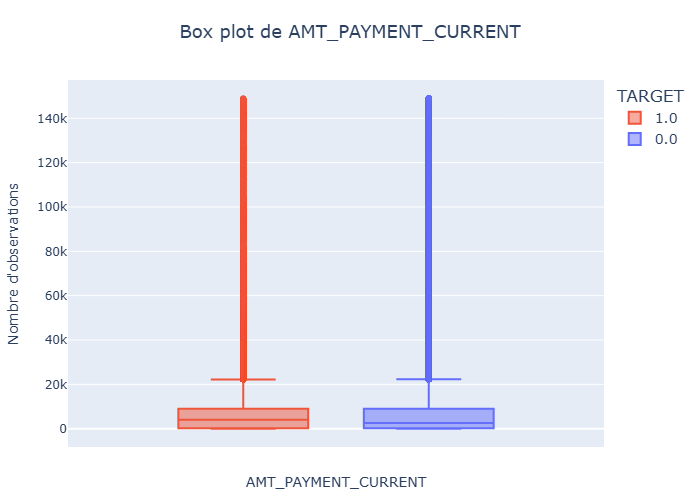

In [359]:
# Visualisation de la répartition pour la variable "AMT_PAYMENT_CURRENT"

plot_quantitative_box_violin(df_credit_card, 
                            x="AMT_PAYMENT_CURRENT",
                            plot_type="box",
                            color='TARGET',
                            width=800,
                            height=700,
                            xaxis_title="AMT_PAYMENT_CURRENT",
                            yaxis_title="Nombre d'observations",
                            max_quantile=0.99,
                            color_map={0: "#636EFA", 1: "#EF553B"}
                            )

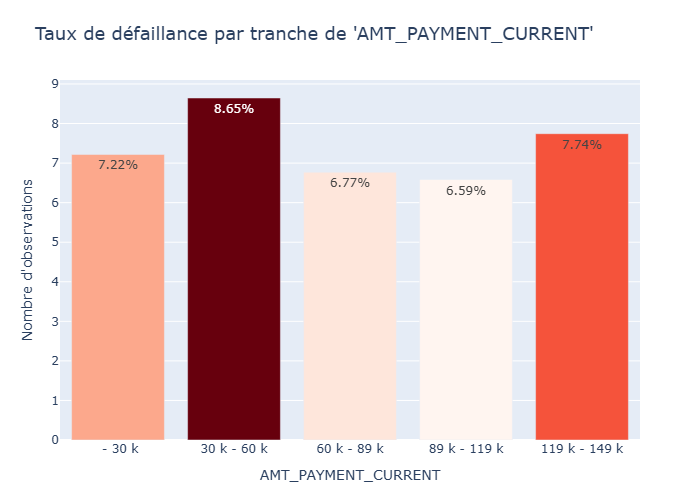

In [360]:
# Visualisation du taux de défaillance pour la variable "AMT_PAYMENT_CURRENT".

plot_defaillance_rate_per_quantitative(df_credit_card, 
                                       "AMT_PAYMENT_CURRENT",
                                       target_var="TARGET",
                                       nbins=5,
                                       width=800,
                                       height=700,
                                       max_quantile=0.99,
                                       xaxis_title="AMT_PAYMENT_CURRENT",
                                       yaxis_title="Nombre d'observations")

- Pour cette variable qui représente les paiement réalisé au cours du mois des crédits précédents les demandes actuelles, on constate globalement que les montants sont légérement supérieurs pour les clients défaillants (boites similaires mais médiane plus haute).
- Pas de lien apparent avec la Target.

In [361]:
df_credit_card['AMT_PAYMENT_TOTAL_CURRENT'].describe().round(0)

count    3840312.0
mean        7589.0
std        32006.0
min            0.0
25%            0.0
50%            0.0
75%         6750.0
max      4278316.0
Name: AMT_PAYMENT_TOTAL_CURRENT, dtype: float64

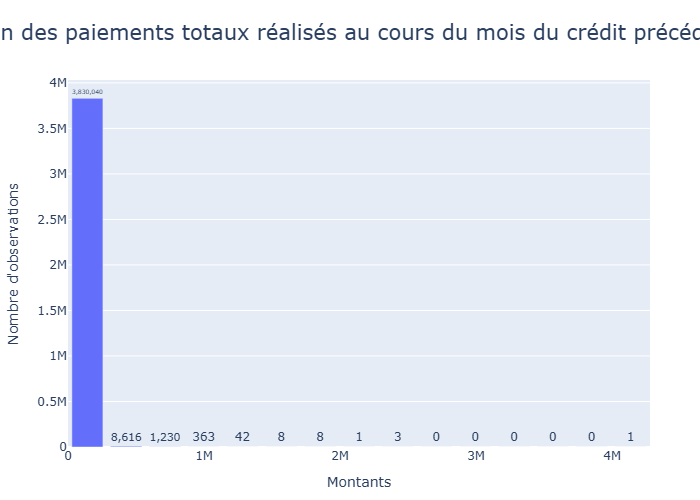

In [362]:
# Visualisation de la distribution pour la variable "AMT_PAYMENT_TOTAL_CURRENT".

plot_quantitative_histogram(
    df_credit_card,
    x='AMT_PAYMENT_TOTAL_CURRENT',
    title="Distribution des paiements totaux réalisés au cours du mois du crédit précédent",
    title_layout={"x": 0.45},
    title_font_size=21,
    xaxis_title="Montants",
    yaxis_title="Nombre d'observations",
    width=1000,
    height=600
)

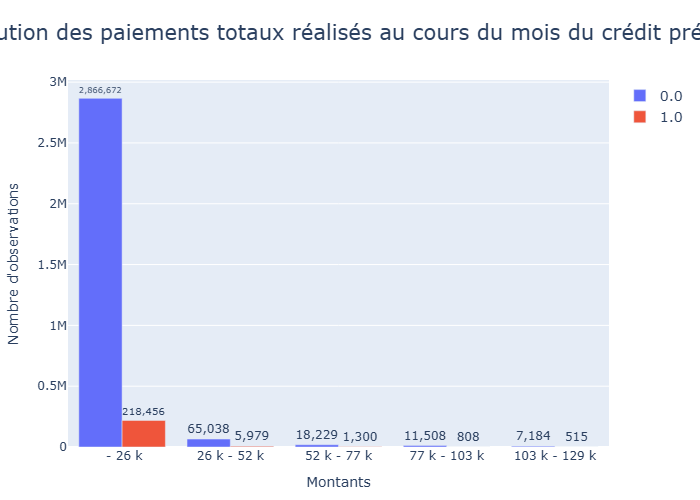

In [363]:
# Visualisation de la répartition pour la variable "AMT_PAYMENT_TOTAL_CURRENT"

plot_quantitative_histogram(
    df_credit_card,
    x='AMT_PAYMENT_TOTAL_CURRENT',
    color='TARGET',
    nbins= 5,
    title="Distribution des paiements totaux réalisés au cours du mois du crédit précédent",
    title_layout={"x": 0.5},
    title_font_size=21,
    xaxis_title="Montants",
    yaxis_title="Nombre d'observations",
    bin_as_category=True,
    max_quantile=0.99,
    width=1000,
    height=600
)

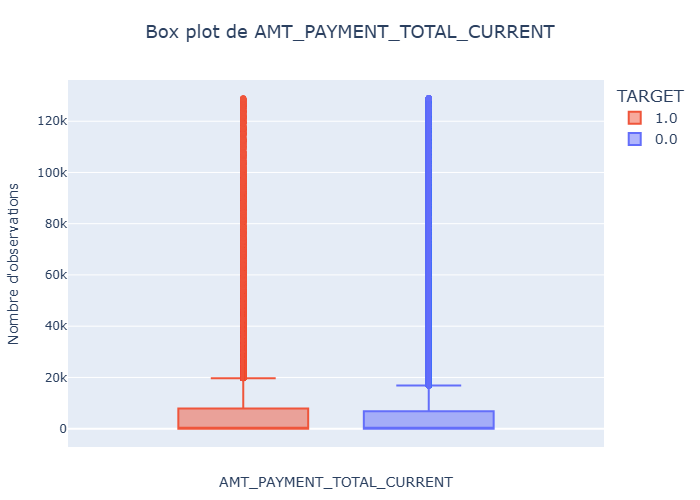

In [364]:
# Visualisation de la répartition pour la variable "AMT_PAYMENT_TOTAL_CURRENT"

plot_quantitative_box_violin(df_credit_card, 
                            x="AMT_PAYMENT_TOTAL_CURRENT",
                            plot_type="box",
                            color='TARGET',
                            width=800,
                            height=700,
                            xaxis_title="AMT_PAYMENT_TOTAL_CURRENT",
                            yaxis_title="Nombre d'observations",
                            max_quantile=0.99,
                            color_map={0: "#636EFA", 1: "#EF553B"}
                            )

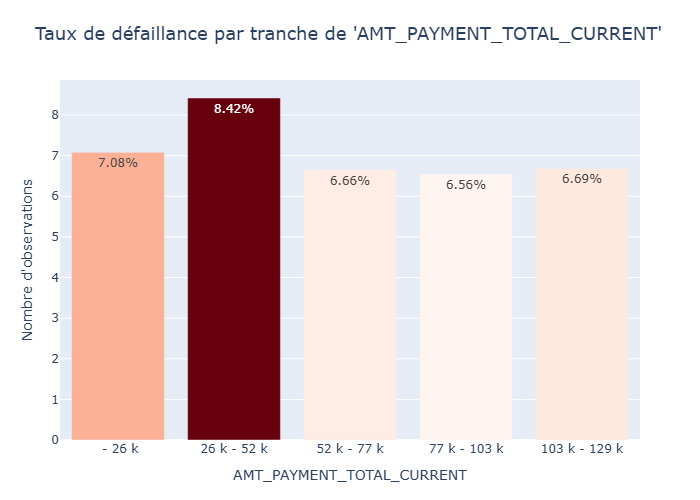

In [365]:
# Visualisation du taux de défaillance pour la variable "AMT_PAYMENT_TOTAL_CURRENT".

plot_defaillance_rate_per_quantitative(df_credit_card, 
                                       "AMT_PAYMENT_TOTAL_CURRENT",
                                       target_var="TARGET",
                                       nbins=5,
                                       width=800,
                                       height=700,
                                       max_quantile=0.99,
                                       xaxis_title="AMT_PAYMENT_TOTAL_CURRENT",
                                       yaxis_title="Nombre d'observations")

- Constat similaire à la variable précédente.

In [366]:
df_credit_card['AMT_RECEIVABLE_PRINCIPAL'].describe().round(0)

count    3840312.0
mean       55966.0
std       102534.0
min      -423306.0
25%            0.0
50%            0.0
75%        85359.0
max      1472317.0
Name: AMT_RECEIVABLE_PRINCIPAL, dtype: float64

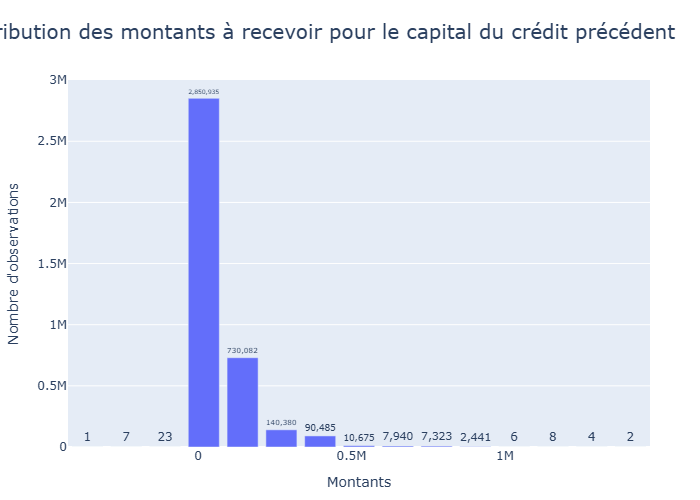

In [367]:
# Visualisation de la distribution pour la variable "AMT_RECEIVABLE_PRINCIPAL".

plot_quantitative_histogram(
    df_credit_card,
    x='AMT_RECEIVABLE_PRINCIPAL',
    title="Distribution des montants à recevoir pour le capital du crédit précédent",
    title_layout={"x": 0.45},
    title_font_size=20,
    xaxis_title="Montants",
    yaxis_title="Nombre d'observations",
    width=1000,
    height=600
)

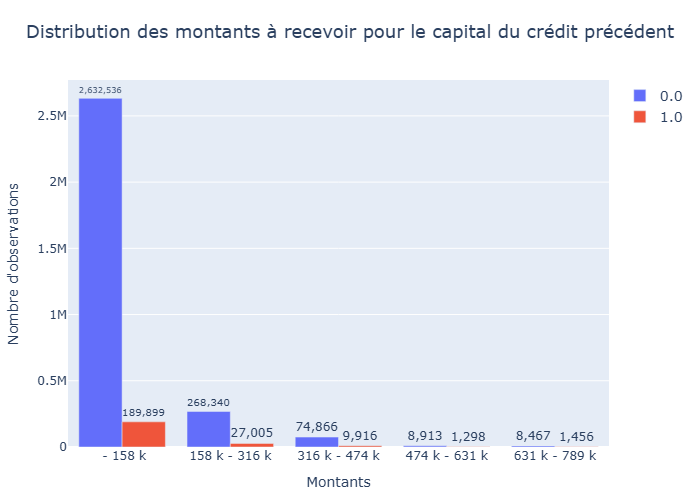

In [368]:
# Visualisation de la répartition pour la variable "AMT_RECEIVABLE_PRINCIPAL"

plot_quantitative_histogram(
    df_credit_card,
    x='AMT_RECEIVABLE_PRINCIPAL',
    color='TARGET',
    nbins= 5,
    title="Distribution des montants à recevoir pour le capital du crédit précédent",
    title_layout={"x": 0.5},
    title_font_size=18,
    xaxis_title="Montants",
    yaxis_title="Nombre d'observations",
    bin_as_category=True,
    min_quantile=0.001,
    max_quantile=0.999,
    width=1000,
    height=600
)

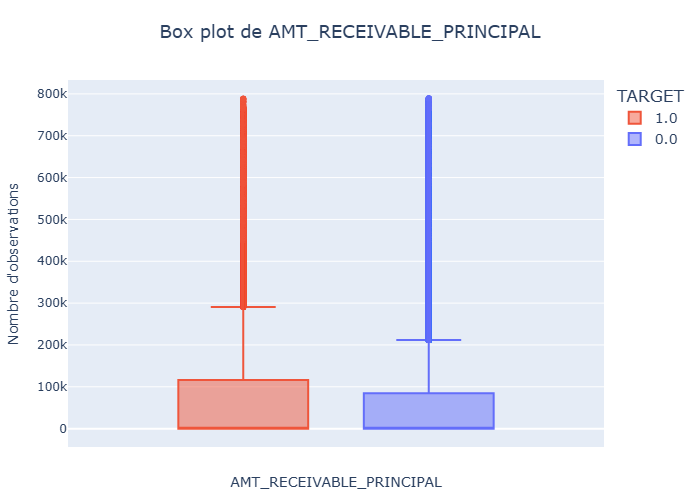

In [369]:
# Visualisation de la répartition pour la variable "AMT_RECEIVABLE_PRINCIPAL"

plot_quantitative_box_violin(df_credit_card, 
                            x="AMT_RECEIVABLE_PRINCIPAL",
                            plot_type="box",
                            color='TARGET',
                            width=800,
                            height=700,
                            xaxis_title="AMT_RECEIVABLE_PRINCIPAL",
                            yaxis_title="Nombre d'observations",
                            min_quantile=0.001,
                            max_quantile=0.999,
                            color_map={0: "#636EFA", 1: "#EF553B"}
                            )

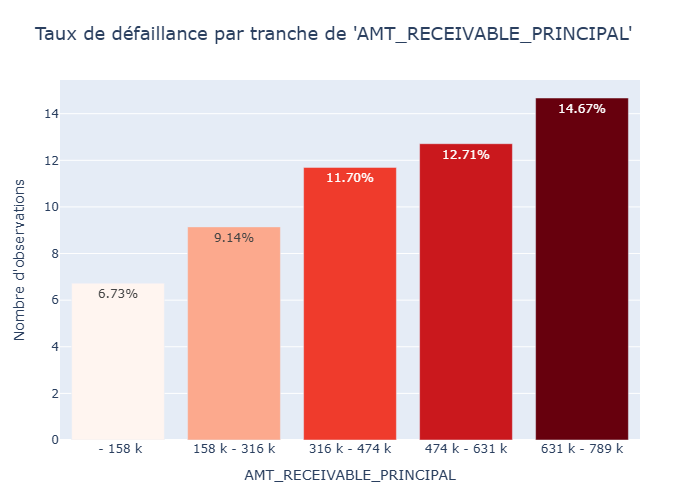

In [370]:
# Visualisation du taux de défaillance pour la variable "AMT_RECEIVABLE_PRINCIPAL".

plot_defaillance_rate_per_quantitative(df_credit_card, 
                                       "AMT_RECEIVABLE_PRINCIPAL",
                                       target_var="TARGET",
                                       nbins=5,
                                       width=800,
                                       height=700,
                                       min_quantile=0.001,
                                       max_quantile=0.999,
                                       xaxis_title="AMT_RECEIVABLE_PRINCIPAL",
                                       yaxis_title="Nombre d'observations")

- Pour les montants à recevoir sur le capital, les montants semblent plus élevés pour les non défaillants et il semble y avoir un lien entre cette variable et la Target.

In [371]:
df_credit_card['AMT_RECIVABLE'].describe().round(0)

count    3840312.0
mean       58089.0
std       105965.0
min      -420250.0
25%            0.0
50%            0.0
75%        88899.0
max      1493338.0
Name: AMT_RECIVABLE, dtype: float64

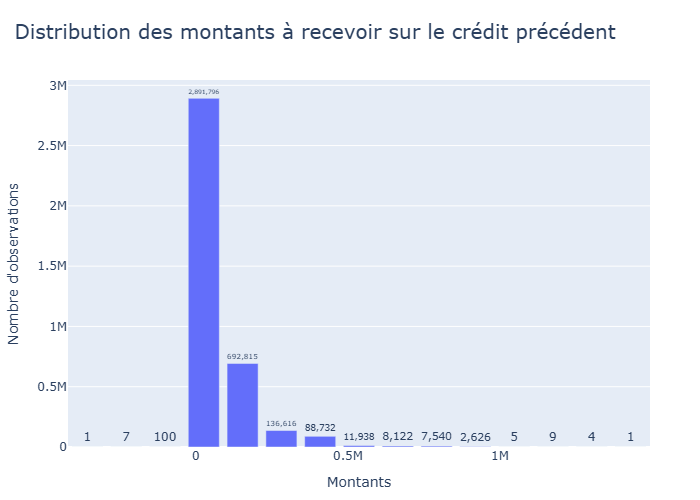

In [372]:
# Visualisation de la distribution pour la variable "AMT_RECIVABLE".

plot_quantitative_histogram(
    df_credit_card,
    x='AMT_RECIVABLE',
    title="Distribution des montants à recevoir sur le crédit précédent",
    title_layout={"x": 0.45},
    title_font_size=20,
    xaxis_title="Montants",
    yaxis_title="Nombre d'observations",
    width=1000,
    height=600
)

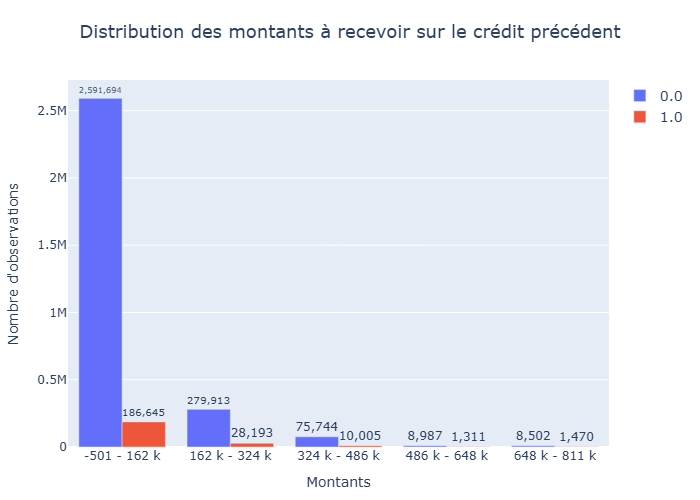

In [373]:
# Visualisation de la répartition pour la variable "AMT_RECIVABLE"

plot_quantitative_histogram(
    df_credit_card,
    x='AMT_RECIVABLE',
    color='TARGET',
    nbins= 5,
    title="Distribution des montants à recevoir sur le crédit précédent",
    title_layout={"x": 0.5},
    title_font_size=18,
    xaxis_title="Montants",
    yaxis_title="Nombre d'observations",
    bin_as_category=True,
    min_quantile=0.01,
    max_quantile=0.999,
    width=1000,
    height=600
)

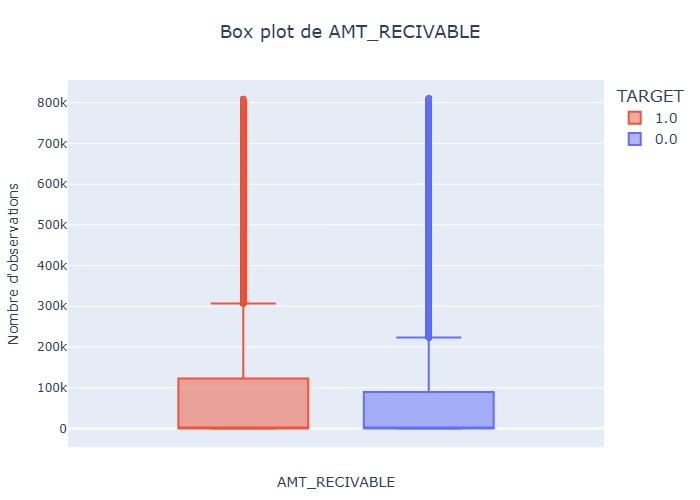

In [374]:
# Visualisation de la répartition pour la variable "AMT_RECIVABLE"

plot_quantitative_box_violin(df_credit_card, 
                            x="AMT_RECIVABLE",
                            plot_type="box",
                            color='TARGET',
                            width=800,
                            height=700,
                            xaxis_title="AMT_RECIVABLE",
                            yaxis_title="Nombre d'observations",
                            min_quantile=0.01,
                            max_quantile=0.999,
                            color_map={0: "#636EFA", 1: "#EF553B"}
                            )

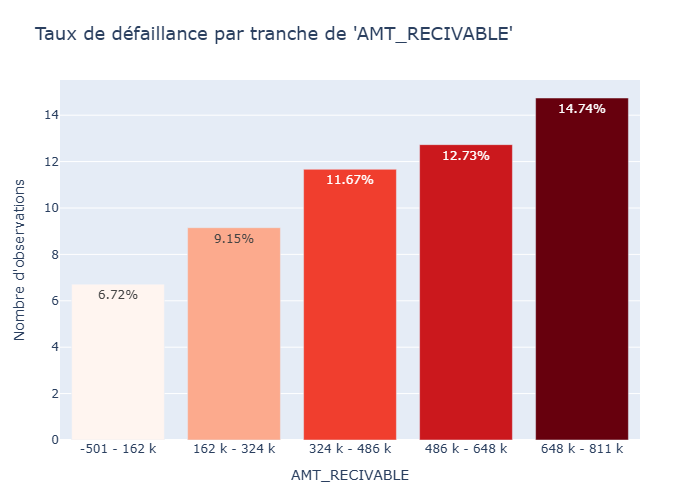

In [375]:
# Visualisation du taux de défaillance pour la variable "AMT_RECIVABLE".

plot_defaillance_rate_per_quantitative(df_credit_card, 
                                       "AMT_RECIVABLE",
                                       target_var="TARGET",
                                       nbins=5,
                                       width=800,
                                       height=700,
                                       min_quantile=0.01,
                                       max_quantile=0.999,
                                       xaxis_title="AMT_RECIVABLE",
                                       yaxis_title="Nombre d'observations")

- Même constat que la variable précédente (pratiquement la même variable)

In [376]:
df_credit_card['AMT_TOTAL_RECEIVABLE'].describe().round(0)

count    3840312.0
mean       58098.0
std       105972.0
min      -420250.0
25%            0.0
50%            0.0
75%        88915.0
max      1493338.0
Name: AMT_TOTAL_RECEIVABLE, dtype: float64

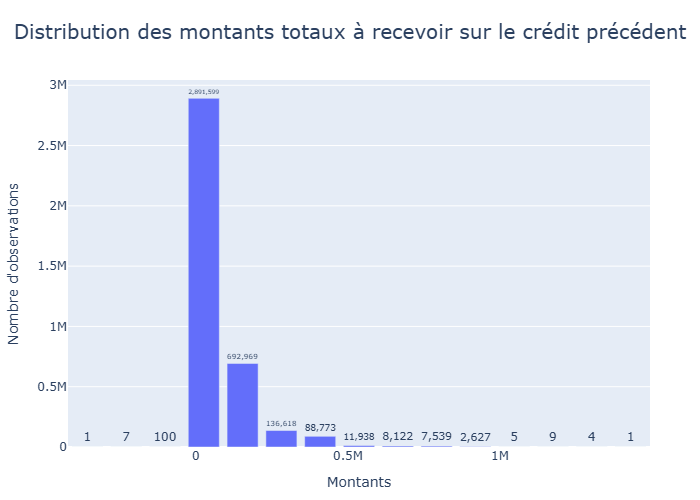

In [377]:
# Visualisation de la distribution pour la variable "AMT_TOTAL_RECEIVABLE".

plot_quantitative_histogram(
    df_credit_card,
    x='AMT_TOTAL_RECEIVABLE',
    title="Distribution des montants totaux à recevoir sur le crédit précédent",
    title_layout={"x": 0.5},
    title_font_size=20,
    xaxis_title="Montants",
    yaxis_title="Nombre d'observations",
    width=1000,
    height=600
)

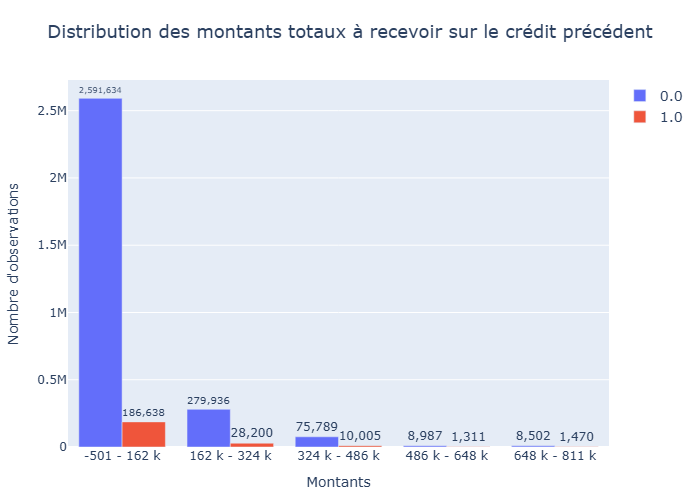

In [378]:
# Visualisation de la répartition pour la variable "AMT_TOTAL_RECEIVABLE"

plot_quantitative_histogram(
    df_credit_card,
    x='AMT_TOTAL_RECEIVABLE',
    color='TARGET',
    nbins= 5,
    title="Distribution des montants totaux à recevoir sur le crédit précédent",
    title_layout={"x": 0.5},
    title_font_size=18,
    xaxis_title="Montants",
    yaxis_title="Nombre d'observations",
    bin_as_category=True,
    min_quantile=0.01,
    max_quantile=0.999,
    width=1000,
    height=600
)

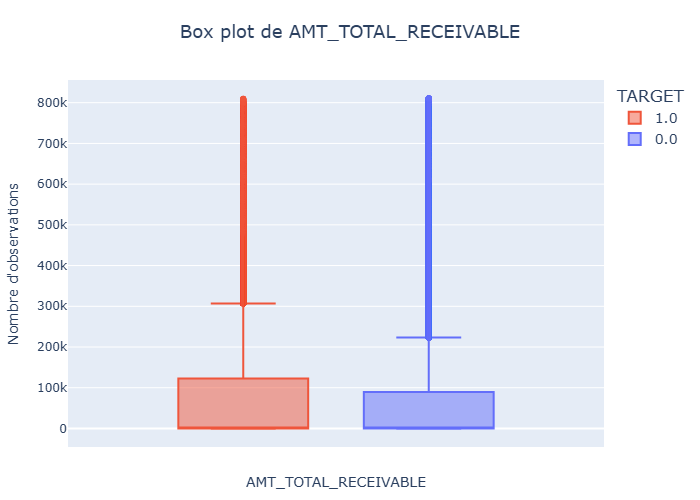

In [379]:
# Visualisation de la répartition pour la variable "AMT_TOTAL_RECEIVABLE"

plot_quantitative_box_violin(df_credit_card, 
                            x="AMT_TOTAL_RECEIVABLE",
                            plot_type="box",
                            color='TARGET',
                            width=800,
                            height=700,
                            xaxis_title="AMT_TOTAL_RECEIVABLE",
                            yaxis_title="Nombre d'observations",
                            min_quantile=0.01,
                            max_quantile=0.999,
                            color_map={0: "#636EFA", 1: "#EF553B"}
                            )

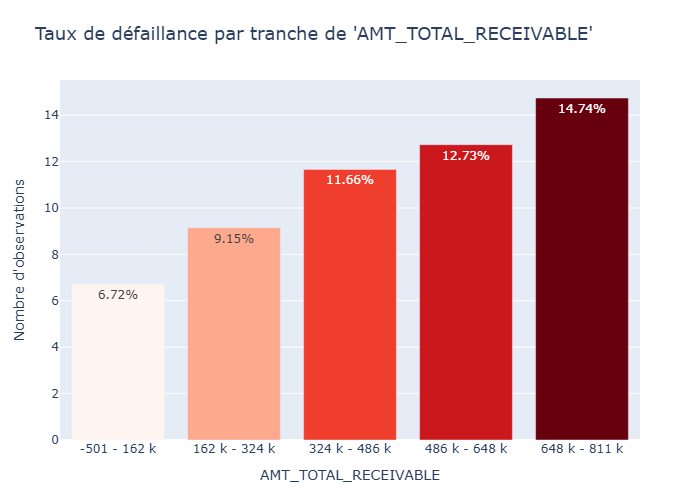

In [380]:
# Visualisation du taux de défaillance pour la variable "AMT_TOTAL_RECEIVABLE".

plot_defaillance_rate_per_quantitative(df_credit_card, 
                                       "AMT_TOTAL_RECEIVABLE",
                                       target_var="TARGET",
                                       nbins=5,
                                       width=800,
                                       height=700,
                                       min_quantile=0.01,
                                       max_quantile=0.999,
                                       xaxis_title="AMT_TOTAL_RECEIVABLE",
                                       yaxis_title="Nombre d'observations")

- Même constat pour toutes les variables "RECEIVABLE".

In [381]:
df_credit_card['CNT_DRAWINGS_ATM_CURRENT'].describe().round(0)

count    3090496.0
mean           0.0
std            1.0
min            0.0
25%            0.0
50%            0.0
75%            0.0
max           51.0
Name: CNT_DRAWINGS_ATM_CURRENT, dtype: float64

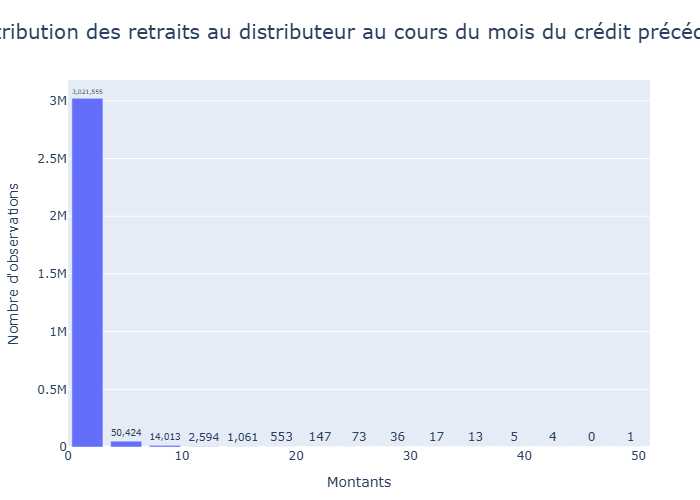

In [382]:
# Visualisation de la distribution pour la variable "CNT_DRAWINGS_ATM_CURRENT".

plot_quantitative_histogram(
    df_credit_card,
    x='CNT_DRAWINGS_ATM_CURRENT',
    title="Distribution des retraits au distributeur au cours du mois du crédit précédent",
    title_layout={"x": 0.5},
    title_font_size=20,
    xaxis_title="Montants",
    yaxis_title="Nombre d'observations",
    width=1000,
    height=600
)

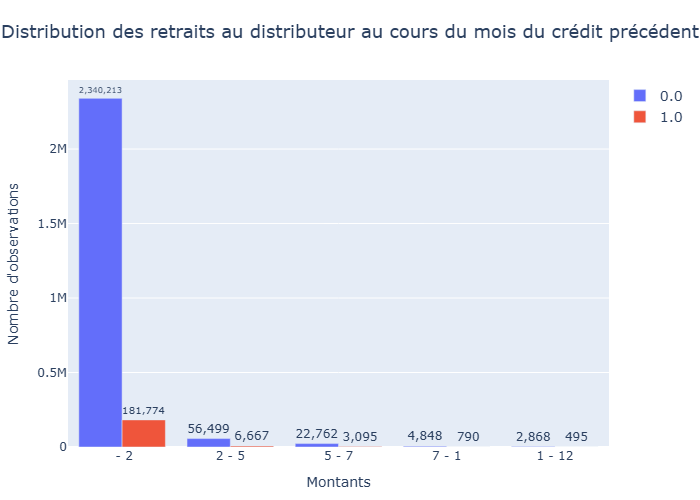

In [383]:
# Visualisation de la répartition pour la variable "CNT_DRAWINGS_ATM_CURRENT"

plot_quantitative_histogram(
    df_credit_card,
    x='CNT_DRAWINGS_ATM_CURRENT',
    color='TARGET',
    nbins= 5,
    title="Distribution des retraits au distributeur au cours du mois du crédit précédent",
    title_layout={"x": 0.5},
    title_font_size=18,
    xaxis_title="Montants",
    yaxis_title="Nombre d'observations",
    bin_as_category=True,
    max_quantile=0.999,
    width=1000,
    height=600
)

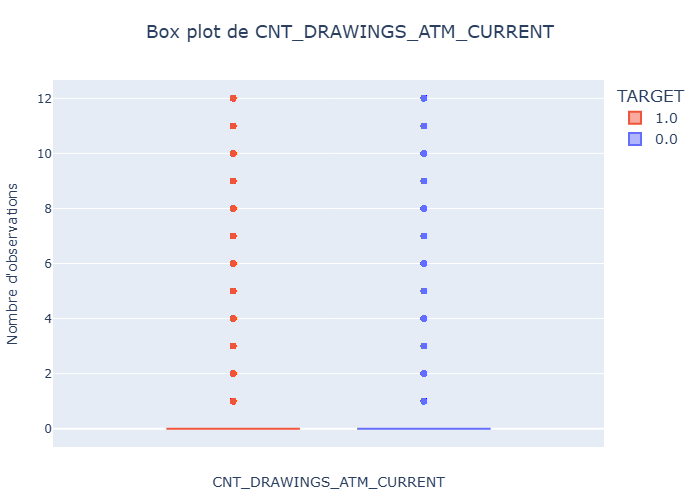

In [384]:
# Visualisation de la répartition pour la variable "CNT_DRAWINGS_ATM_CURRENT"

plot_quantitative_box_violin(df_credit_card, 
                            x="CNT_DRAWINGS_ATM_CURRENT",
                            plot_type="box",
                            color='TARGET',
                            width=800,
                            height=700,
                            xaxis_title="CNT_DRAWINGS_ATM_CURRENT",
                            yaxis_title="Nombre d'observations",
                            max_quantile=0.999,
                            color_map={0: "#636EFA", 1: "#EF553B"}
                            )

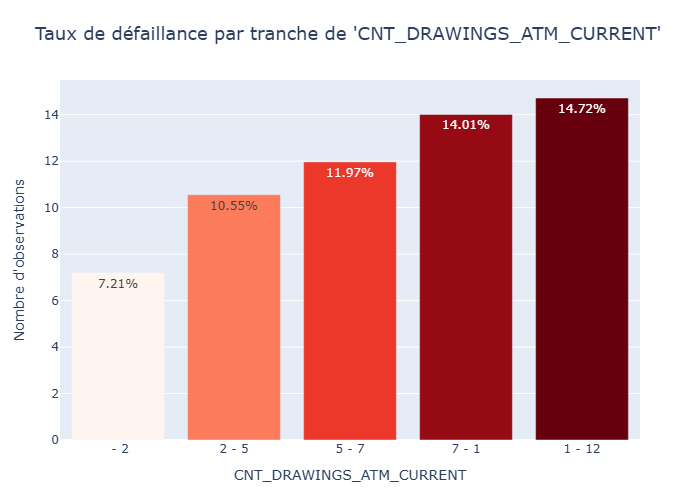

In [385]:
# Visualisation du taux de défaillance pour la variable "CNT_DRAWINGS_ATM_CURRENT".

plot_defaillance_rate_per_quantitative(df_credit_card, 
                                       "CNT_DRAWINGS_ATM_CURRENT",
                                       target_var="TARGET",
                                       nbins=5,
                                       width=800,
                                       height=700,
                                       max_quantile=0.999,
                                       xaxis_title="CNT_DRAWINGS_ATM_CURRENT",
                                       yaxis_title="Nombre d'observations")

- Une nouvelle corrélation potentiellement intéresante comme on peut le voir puisque le taux de défaillance augmente à mesure que le nombre de retrait augmente (outliers exclus).

In [386]:
df_credit_card['CNT_DRAWINGS_CURRENT'].describe().round(0)

count    3840312.0
mean           1.0
std            3.0
min            0.0
25%            0.0
50%            0.0
75%            0.0
max          165.0
Name: CNT_DRAWINGS_CURRENT, dtype: float64

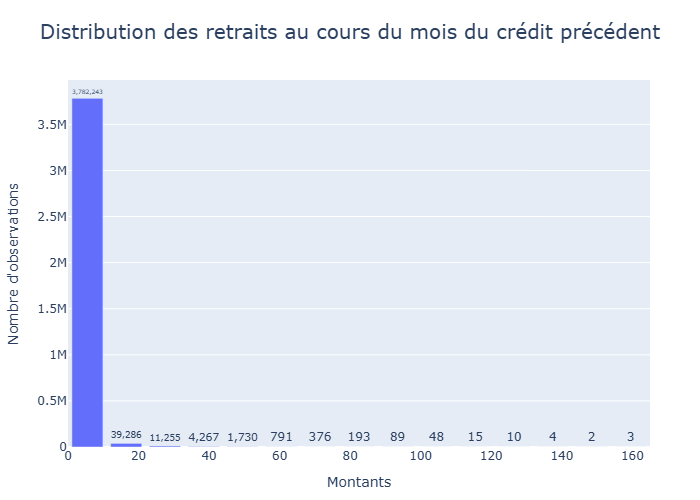

In [387]:
# Visualisation de la distribution pour la variable "CNT_DRAWINGS_CURRENT".

plot_quantitative_histogram(
    df_credit_card,
    x='CNT_DRAWINGS_CURRENT',
    title="Distribution des retraits au cours du mois du crédit précédent",
    title_layout={"x": 0.5},
    title_font_size=20,
    xaxis_title="Montants",
    yaxis_title="Nombre d'observations",
    width=1000,
    height=600
)

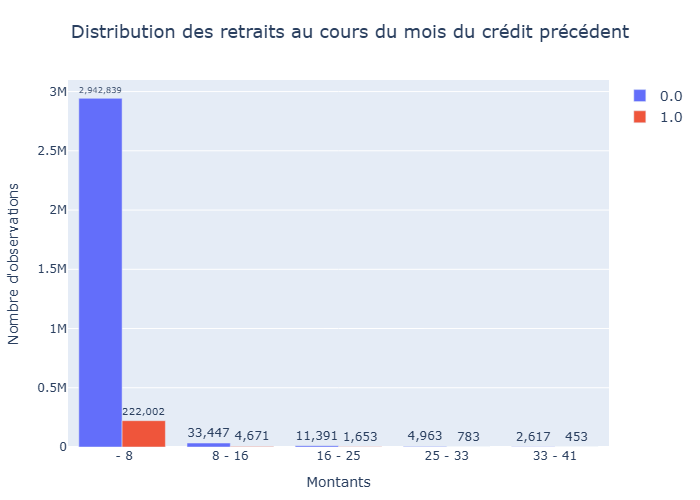

In [388]:
# Visualisation de la répartition pour la variable "CNT_DRAWINGS_CURRENT"

plot_quantitative_histogram(
    df_credit_card,
    x='CNT_DRAWINGS_CURRENT',
    color='TARGET',
    nbins= 5,
    title="Distribution des retraits au cours du mois du crédit précédent",
    title_layout={"x": 0.5},
    title_font_size=18,
    xaxis_title="Montants",
    yaxis_title="Nombre d'observations",
    bin_as_category=True,
    max_quantile=0.999,
    width=1000,
    height=600
)

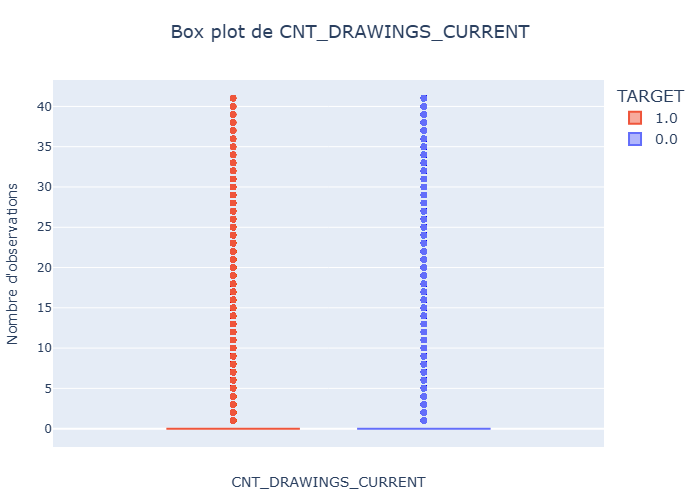

In [389]:
# Visualisation de la répartition pour la variable "CNT_DRAWINGS_CURRENT"

plot_quantitative_box_violin(df_credit_card, 
                            x="CNT_DRAWINGS_CURRENT",
                            plot_type="box",
                            color='TARGET',
                            width=800,
                            height=700,
                            xaxis_title="CNT_DRAWINGS_CURRENT",
                            yaxis_title="Nombre d'observations",
                            max_quantile=0.999,
                            color_map={0: "#636EFA", 1: "#EF553B"}
                            )

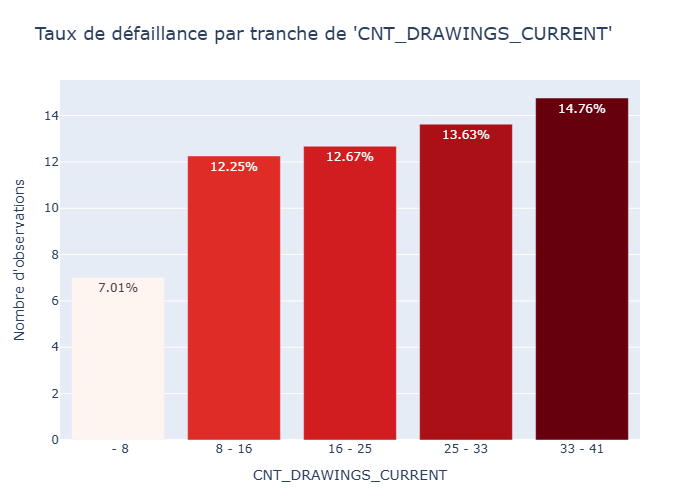

In [390]:
# Visualisation du taux de défaillance pour la variable "CNT_DRAWINGS_CURRENT".

plot_defaillance_rate_per_quantitative(df_credit_card, 
                                       "CNT_DRAWINGS_CURRENT",
                                       target_var="TARGET",
                                       nbins=5,
                                       width=800,
                                       height=700,
                                       max_quantile=0.999,
                                       xaxis_title="CNT_DRAWINGS_CURRENT",
                                       yaxis_title="Nombre d'observations")

- Constat similaire à la variable précédente.

In [391]:
df_credit_card['CNT_DRAWINGS_OTHER_CURRENT'].describe().round(0)

count    3090496.0
mean           0.0
std            0.0
min            0.0
25%            0.0
50%            0.0
75%            0.0
max           12.0
Name: CNT_DRAWINGS_OTHER_CURRENT, dtype: float64

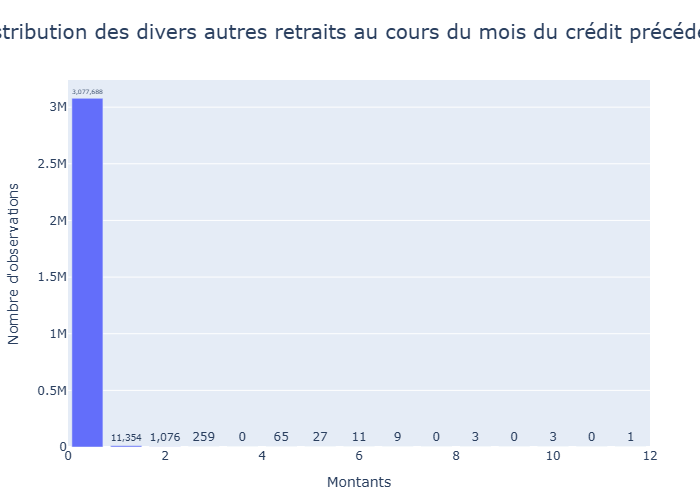

In [392]:
# Visualisation de la distribution pour la variable "CNT_DRAWINGS_OTHER_CURRENT".

plot_quantitative_histogram(
    df_credit_card,
    x='CNT_DRAWINGS_OTHER_CURRENT',
    title="Distribution des divers autres retraits au cours du mois du crédit précédent",
    title_layout={"x": 0.5},
    title_font_size=20,
    xaxis_title="Montants",
    yaxis_title="Nombre d'observations",
    width=1000,
    height=600
)

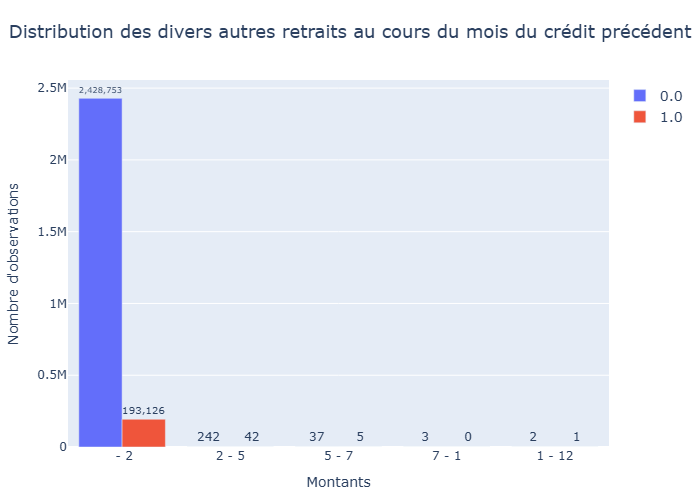

In [393]:
# Visualisation de la répartition pour la variable "CNT_DRAWINGS_OTHER_CURRENT"

plot_quantitative_histogram(
    df_credit_card,
    x='CNT_DRAWINGS_OTHER_CURRENT',
    color='TARGET',
    nbins= 5,
    title="Distribution des divers autres retraits au cours du mois du crédit précédent",
    title_layout={"x": 0.5},
    title_font_size=18,
    xaxis_title="Montants",
    yaxis_title="Nombre d'observations",
    bin_as_category=True,
    width=1000,
    height=600)


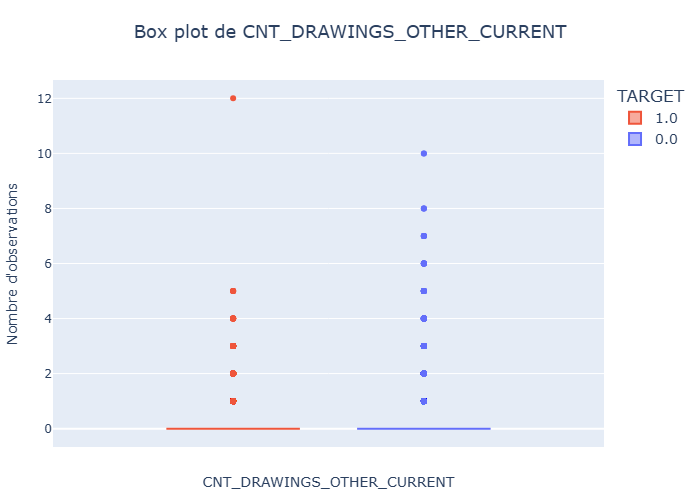

In [394]:
# Visualisation de la répartition pour la variable "CNT_DRAWINGS_OTHER_CURRENT"

plot_quantitative_box_violin(df_credit_card, 
                            x="CNT_DRAWINGS_OTHER_CURRENT",
                            plot_type="box",
                            color='TARGET',
                            width=800,
                            height=700,
                            xaxis_title="CNT_DRAWINGS_OTHER_CURRENT",
                            yaxis_title="Nombre d'observations",
                            color_map={0: "#636EFA", 1: "#EF553B"}
                            )

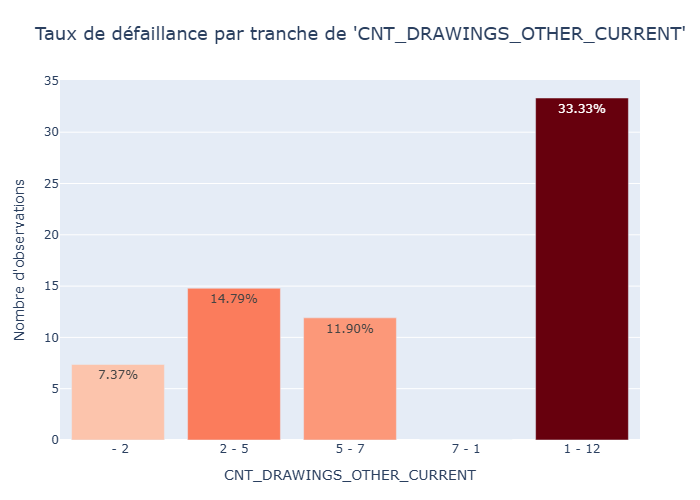

In [395]:
# Visualisation du taux de défaillance pour la variable "CNT_DRAWINGS_OTHER_CURRENT".

plot_defaillance_rate_per_quantitative(df_credit_card, 
                                       "CNT_DRAWINGS_OTHER_CURRENT",
                                       target_var="TARGET",
                                       nbins=5,
                                       width=800,
                                       height=700,
                                       xaxis_title="CNT_DRAWINGS_OTHER_CURRENT",
                                       yaxis_title="Nombre d'observations")

- Variable peu intéressante pour notre modèlisation.

In [396]:
df_credit_card['CNT_DRAWINGS_POS_CURRENT'].describe().round(0)

count    3090496.0
mean           1.0
std            3.0
min            0.0
25%            0.0
50%            0.0
75%            0.0
max          165.0
Name: CNT_DRAWINGS_POS_CURRENT, dtype: float64

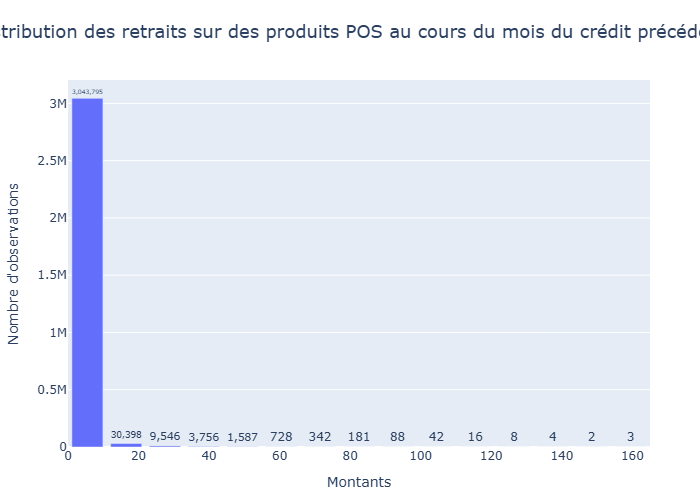

In [397]:
# Visualisation de la distribution pour la variable "CNT_DRAWINGS_POS_CURRENT".

plot_quantitative_histogram(
    df_credit_card,
    x='CNT_DRAWINGS_POS_CURRENT',
    title="Distribution des retraits sur des produits POS au cours du mois du crédit précédent",
    title_layout={"x": 0.5},
    title_font_size=18,
    xaxis_title="Montants",
    yaxis_title="Nombre d'observations",
    width=1000,
    height=600
)

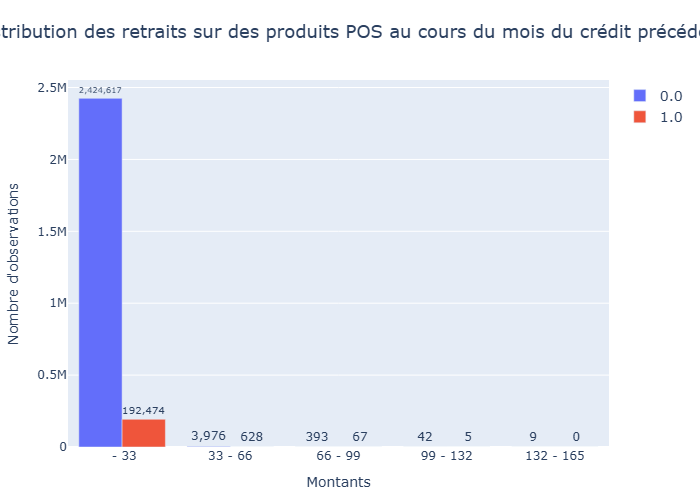

In [398]:
# Visualisation de la répartition pour la variable "CNT_DRAWINGS_POS_CURRENT"

plot_quantitative_histogram(
    df_credit_card,
    x='CNT_DRAWINGS_POS_CURRENT',
    color='TARGET',
    nbins= 5,
    title="Distribution des retraits sur des produits POS au cours du mois du crédit précédent",
    title_layout={"x": 0.5},
    title_font_size=18,
    xaxis_title="Montants",
    yaxis_title="Nombre d'observations",
    bin_as_category=True,
    width=1000,
    height=600)

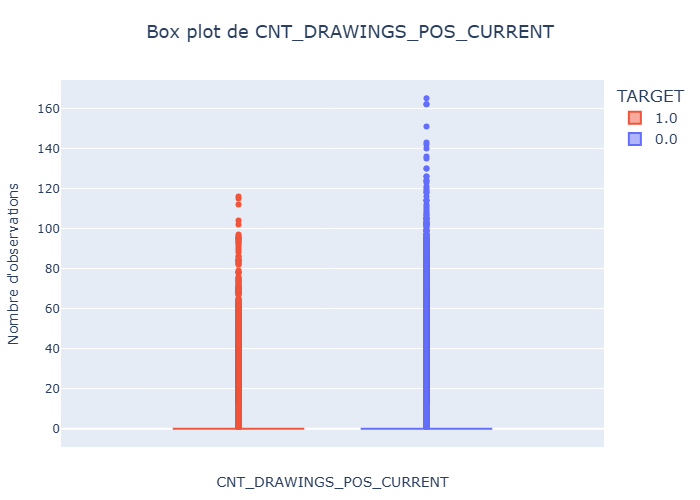

In [399]:
# Visualisation de la répartition pour la variable "CNT_DRAWINGS_POS_CURRENT"

plot_quantitative_box_violin(df_credit_card, 
                            x="CNT_DRAWINGS_POS_CURRENT",
                            plot_type="box",
                            color='TARGET',
                            width=800,
                            height=700,
                            xaxis_title="CNT_DRAWINGS_POS_CURRENT",
                            yaxis_title="Nombre d'observations",
                            color_map={0: "#636EFA", 1: "#EF553B"}
                            )

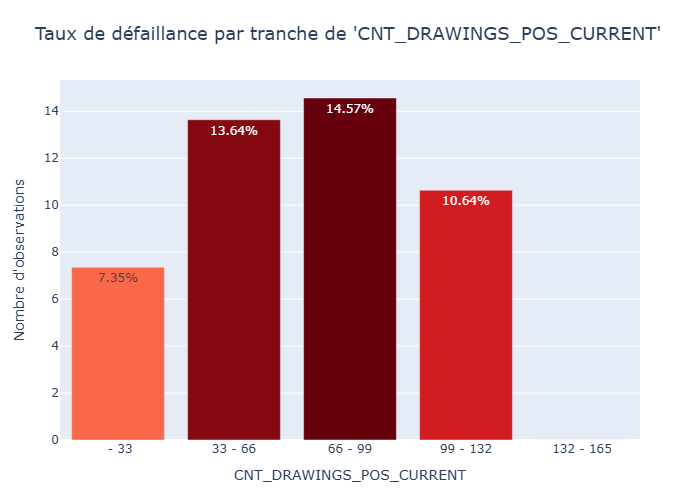

In [400]:
# Visualisation du taux de défaillance pour la variable "CNT_DRAWINGS_POS_CURRENT".

plot_defaillance_rate_per_quantitative(df_credit_card, 
                                       "CNT_DRAWINGS_POS_CURRENT",
                                       target_var="TARGET",
                                       nbins=5,
                                       width=800,
                                       height=700,
                                       xaxis_title="CNT_DRAWINGS_POS_CURRENT",
                                       yaxis_title="Nombre d'observations")

- Les distributions sont similaires entre les deux groupes et il ne semble pas y avoir de corrélation intéressante entre la Target et la variable.

In [401]:
df_credit_card['CNT_INSTALMENT_MATURE_CUM'].describe().round(0)

count    3535076.0
mean          21.0
std           20.0
min            0.0
25%            4.0
50%           15.0
75%           32.0
max          120.0
Name: CNT_INSTALMENT_MATURE_CUM, dtype: float64

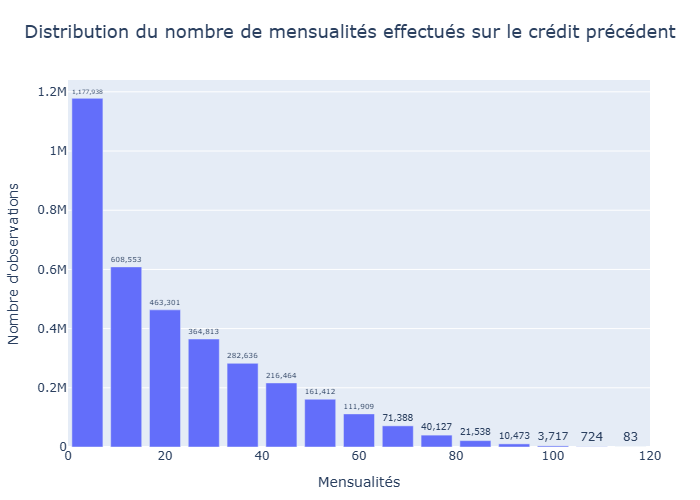

In [402]:
# Visualisation de la distribution pour la variable "CNT_INSTALMENT_MATURE_CUM".

plot_quantitative_histogram(
    df_credit_card,
    x='CNT_INSTALMENT_MATURE_CUM',
    title="Distribution du nombre de mensualités effectués sur le crédit précédent",
    title_layout={"x": 0.5},
    title_font_size=18,
    xaxis_title="Mensualités",
    yaxis_title="Nombre d'observations",
    width=1000,
    height=600
)

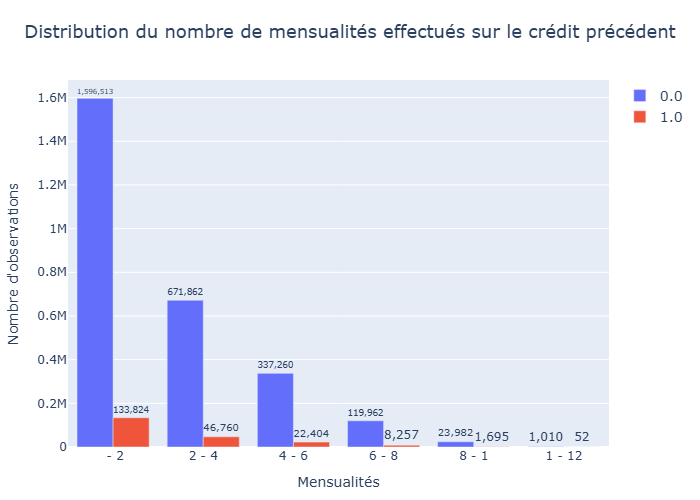

In [403]:
# Visualisation de la répartition pour la variable "CNT_INSTALMENT_MATURE_CUM"

plot_quantitative_histogram(
    df_credit_card,
    x='CNT_INSTALMENT_MATURE_CUM',
    color='TARGET',
    nbins=6,
    title="Distribution du nombre de mensualités effectués sur le crédit précédent",
    title_layout={"x": 0.5},
    title_font_size=18,
    xaxis_title="Mensualités",
    yaxis_title="Nombre d'observations",
    bin_as_category=True,
    width=1000,
    height=600)

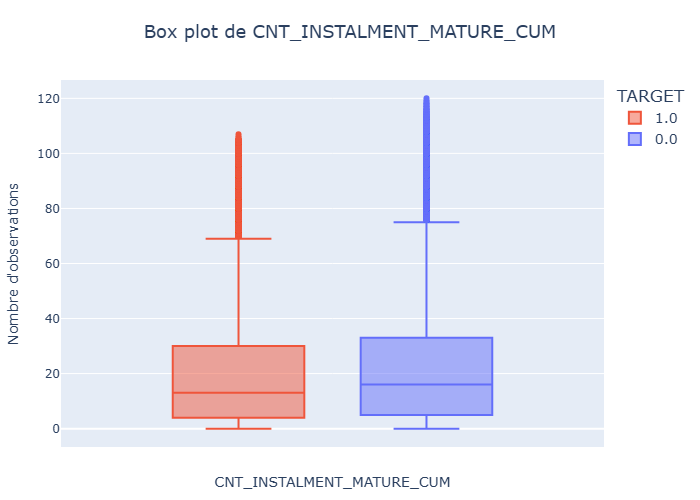

In [404]:
# Visualisation de la répartition pour la variable "CNT_INSTALMENT_MATURE_CUM"

plot_quantitative_box_violin(df_credit_card, 
                            x="CNT_INSTALMENT_MATURE_CUM",
                            plot_type="box",
                            color='TARGET',
                            width=800,
                            height=700,
                            xaxis_title="CNT_INSTALMENT_MATURE_CUM",
                            yaxis_title="Nombre d'observations",
                            color_map={0: "#636EFA", 1: "#EF553B"}
                            )

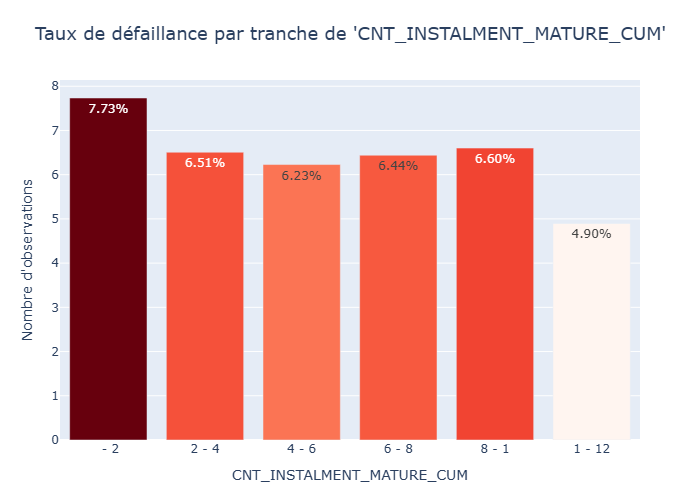

In [405]:
# Visualisation du taux de défaillance pour la variable "CNT_INSTALMENT_MATURE_CUM".

plot_defaillance_rate_per_quantitative(df_credit_card, 
                                       "CNT_INSTALMENT_MATURE_CUM",
                                       target_var="TARGET",
                                       nbins=6,
                                       width=800,
                                       height=700,
                                       xaxis_title="CNT_INSTALMENT_MATURE_CUM",
                                       yaxis_title="Nombre d'observations")

- Pour cette variable qui nous renseigne sur les mensualités payées sur les crédits antérieurs, on constate que les clients défaillants ont globalement moins de mensualités payées à leur actif. 
- Cela peut se voir aussi sur le dernier graphique qui montre une petite corrélation entre la Target et cette variable. 

In [406]:
df_credit_card['SK_DPD'].describe().round(0)

count    3840312.0
mean           9.0
std           98.0
min            0.0
25%            0.0
50%            0.0
75%            0.0
max         3260.0
Name: SK_DPD, dtype: float64

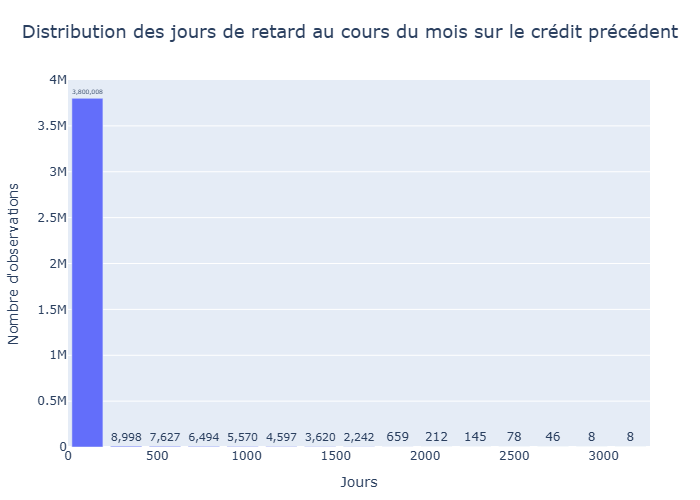

In [407]:
# Visualisation de la distribution pour la variable "SK_DPD".

plot_quantitative_histogram(
    df_credit_card,
    x='SK_DPD',
    title="Distribution des jours de retard au cours du mois sur le crédit précédent",
    title_layout={"x": 0.5},
    title_font_size=18,
    xaxis_title="Jours",
    yaxis_title="Nombre d'observations",
    width=1000,
    height=600
)

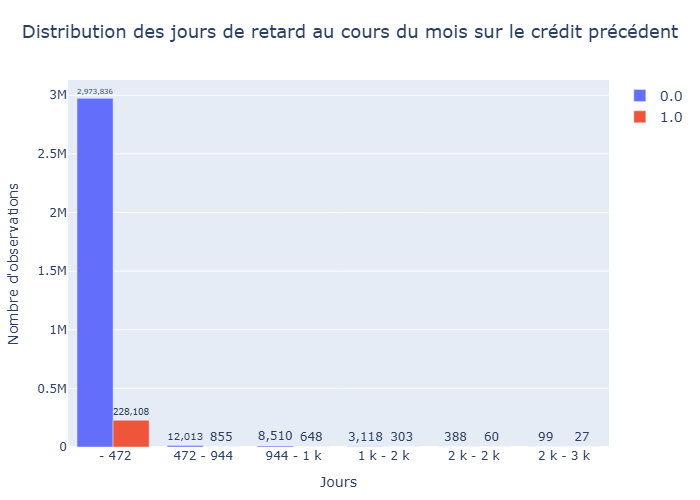

In [408]:
# Visualisation de la répartition pour la variable "SK_DPD"

plot_quantitative_histogram(
    df_credit_card,
    x='SK_DPD',
    color='TARGET',
    nbins=6,
    title="Distribution des jours de retard au cours du mois sur le crédit précédent",
    title_layout={"x": 0.5},
    title_font_size=18,
    xaxis_title="Jours",
    yaxis_title="Nombre d'observations",
    bin_as_category=True,
    width=1000,
    height=600)

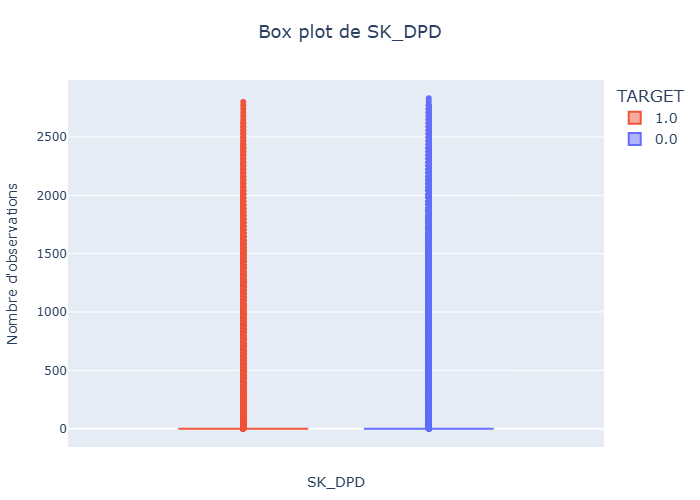

In [409]:
# Visualisation de la répartition pour la variable "SK_DPD"

plot_quantitative_box_violin(df_credit_card, 
                            x="SK_DPD",
                            plot_type="box",
                            color='TARGET',
                            width=800,
                            height=700,
                            xaxis_title="SK_DPD",
                            yaxis_title="Nombre d'observations",
                            color_map={0: "#636EFA", 1: "#EF553B"}
                            )

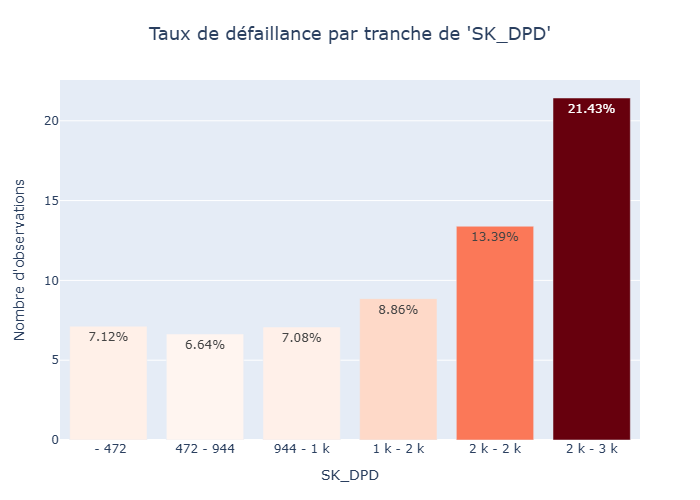

In [410]:
# Visualisation du taux de défaillance pour la variable "SK_DPD".

plot_defaillance_rate_per_quantitative(df_credit_card, 
                                       "SK_DPD",
                                       target_var="TARGET",
                                       nbins=6,
                                       width=800,
                                       height=700,
                                       title_layout={"x": 0.5},
                                       xaxis_title="SK_DPD",
                                       yaxis_title="Nombre d'observations")

- Sans surprise plus la durée de retard augmente, plus le taux de défaillance semble augmenter surtout après un certain palier (autour de 1000 jours) donc cela peut être une variable à prendre en compte dans la modélisation.

In [411]:
df_credit_card['SK_DPD_DEF'].describe().round(0)

count    3840312.0
mean           0.0
std           21.0
min            0.0
25%            0.0
50%            0.0
75%            0.0
max         3260.0
Name: SK_DPD_DEF, dtype: float64

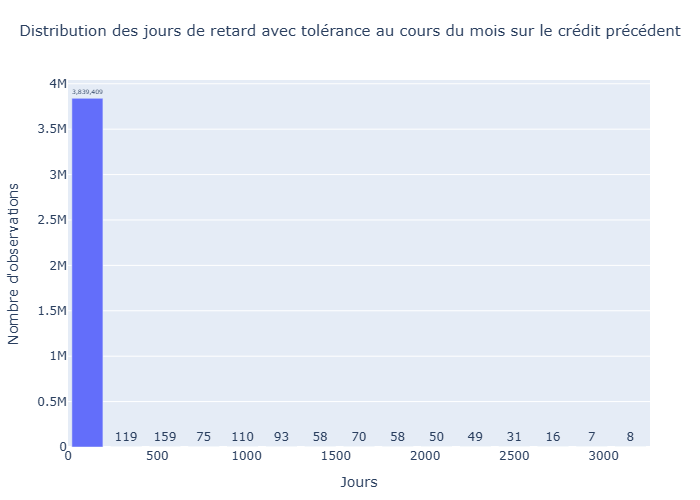

In [412]:
# Visualisation de la distribution pour la variable "SK_DPD_DEF".

plot_quantitative_histogram(
    df_credit_card,
    x='SK_DPD_DEF',
    title="Distribution des jours de retard avec tolérance au cours du mois sur le crédit précédent",
    title_layout={"x": 0.5},
    title_font_size=15,
    xaxis_title="Jours",
    yaxis_title="Nombre d'observations",
    width=1000,
    height=600
)

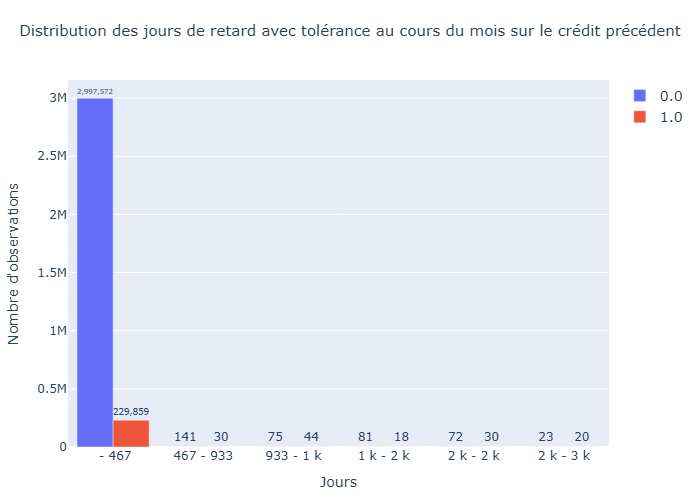

In [413]:
# Visualisation de la répartition pour la variable "SK_DPD_DEF"

plot_quantitative_histogram(
    df_credit_card,
    x='SK_DPD_DEF',
    color='TARGET',
    nbins=6,
    title="Distribution des jours de retard avec tolérance au cours du mois sur le crédit précédent",
    title_layout={"x": 0.5},
    title_font_size=15,
    xaxis_title="Jours",
    yaxis_title="Nombre d'observations",
    bin_as_category=True,
    width=1000,
    height=600)

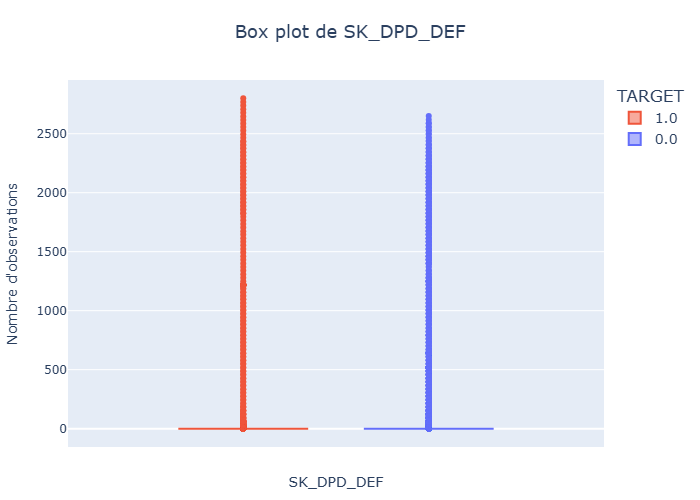

In [414]:
# Visualisation de la répartition pour la variable "SK_DPD_DEF"

plot_quantitative_box_violin(df_credit_card, 
                            x="SK_DPD_DEF",
                            plot_type="box",
                            color='TARGET',
                            width=800,
                            height=700,
                            xaxis_title="SK_DPD_DEF",
                            yaxis_title="Nombre d'observations",
                            color_map={0: "#636EFA", 1: "#EF553B"}
                            )

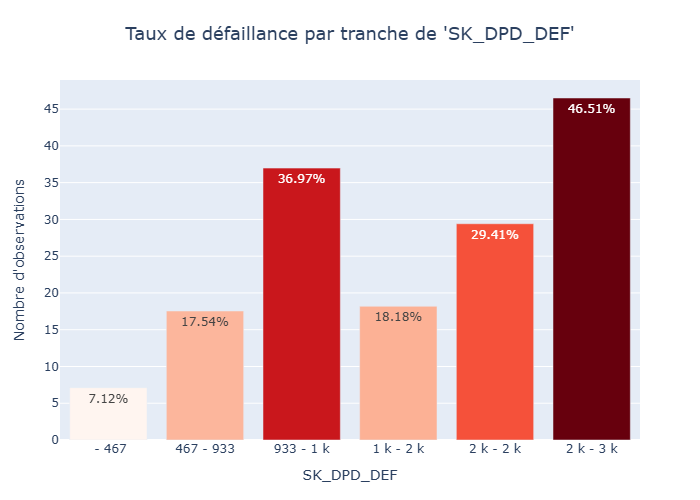

In [415]:
# Visualisation du taux de défaillance pour la variable "SK_DPD_DEF".

plot_defaillance_rate_per_quantitative(df_credit_card, 
                                       "SK_DPD_DEF",
                                       target_var="TARGET",
                                       nbins=6,
                                       width=800,
                                       height=700,
                                       title_layout={"x": 0.5},
                                       xaxis_title="SK_DPD_DEF",
                                       yaxis_title="Nombre d'observations")

- Pour cette varaible la relation avec la Target est moins évidente même si le taux est plus élevé pour le dernier intervalle de valeurs.
- On peut maintenant passer à l'analyse multivariée des différentes variables pour visualiser les corrélations entre elles et avec la Target :

In [416]:
# Calcul de la matrice de corrélation
corr_matrix = df_credit_card.corr()

# Masque pour exclure la diagonale (corrélations de 1)
mask = corr_matrix != 1

# Extraction des paires (en supprimant la diagonale)
corr_pairs = corr_matrix[mask].stack().reset_index()
corr_pairs.columns = ['Variable 1', 'Variable 2', 'Corrélation']

# Créer une paire triée pour éviter les doublons (A / B == B / A)
corr_pairs['Sorted Pair'] = corr_pairs.apply(
    lambda row: ' / '.join(sorted([row['Variable 1'], row['Variable 2']])), axis=1
)

# Supprimer les doublons
corr_pairs = corr_pairs.drop_duplicates(subset='Sorted Pair')

# Ajouter une colonne lisible avec les deux noms de variables
corr_pairs['Variables corrélées'] = corr_pairs['Sorted Pair']

# Garder uniquement les colonnes voulues
corr_df = corr_pairs[['Variables corrélées', 'Corrélation']]

# Trier par valeur absolue de corrélation (facultatif)
corr_df = corr_df.sort_values(by='Corrélation', ascending=False).reset_index(drop=True)

# Affichage stylisé
pd.set_option('display.max_rows', None)

corr_df_styled = corr_df.style.background_gradient(
    subset=['Corrélation'],
    cmap='coolwarm',
    vmin=-1, vmax=1
)

corr_df_styled

,Variables corrélées,Corrélation
0,AMT_RECIVABLE / AMT_TOTAL_RECEIVABLE,0.999995
1,AMT_BALANCE / AMT_RECIVABLE,0.999917
2,AMT_BALANCE / AMT_TOTAL_RECEIVABLE,0.999897
3,AMT_RECEIVABLE_PRINCIPAL / AMT_RECIVABLE,0.999727
4,AMT_BALANCE / AMT_RECEIVABLE_PRINCIPAL,0.999720
5,AMT_RECEIVABLE_PRINCIPAL / AMT_TOTAL_RECEIVABLE,0.999702
6,AMT_PAYMENT_CURRENT / AMT_PAYMENT_TOTAL_CURRENT,0.994764
7,CNT_DRAWINGS_CURRENT / CNT_DRAWINGS_POS_CURRENT,0.950546
8,AMT_INST_MIN_REGULARITY / AMT_RECIVABLE,0.897617
9,AMT_INST_MIN_REGULARITY / AMT_TOTAL_RECEIVABLE,0.897587


In [417]:
pd.reset_option('display.max_rows')

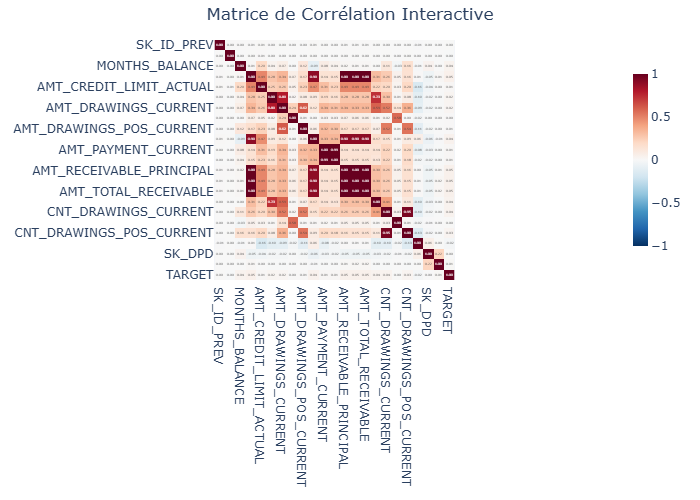

In [418]:
# Visualisation de la matrice de corrélation pour les variables quantitatives.

fig = px.imshow(
    corr_matrix,
    text_auto=".2f",
    color_continuous_scale='RdBu_r',
    zmin=-1,
    zmax=1
)

fig.update_layout(
    title="Matrice de Corrélation Interactive",
    title_x=0.5,
    width=1750,
    height=1750,
    margin=dict(l=20, r=20, t=40, b=20)
)

fig.update_coloraxes(colorbar=dict(thickness=15, x=1.02, len=0.8))
fig.show()

In [419]:
strong_corr_target = df_credit_card.corr()['TARGET'].drop('TARGET')

corr_matrix_target = strong_corr_target.to_frame(name='Corrélation en fonction de la target').sort_values(by='Corrélation en fonction de la target', ascending=False)
corr_matrix_target

,Corrélation en fonction de la target
AMT_BALANCE,0.050098
AMT_TOTAL_RECEIVABLE,0.049839
AMT_RECIVABLE,0.049803
AMT_RECEIVABLE_PRINCIPAL,0.049692
AMT_INST_MIN_REGULARITY,0.039798
CNT_DRAWINGS_ATM_CURRENT,0.038437
CNT_DRAWINGS_CURRENT,0.037793
MONTHS_BALANCE,0.035695
CNT_DRAWINGS_POS_CURRENT,0.029536
AMT_DRAWINGS_ATM_CURRENT,0.024700


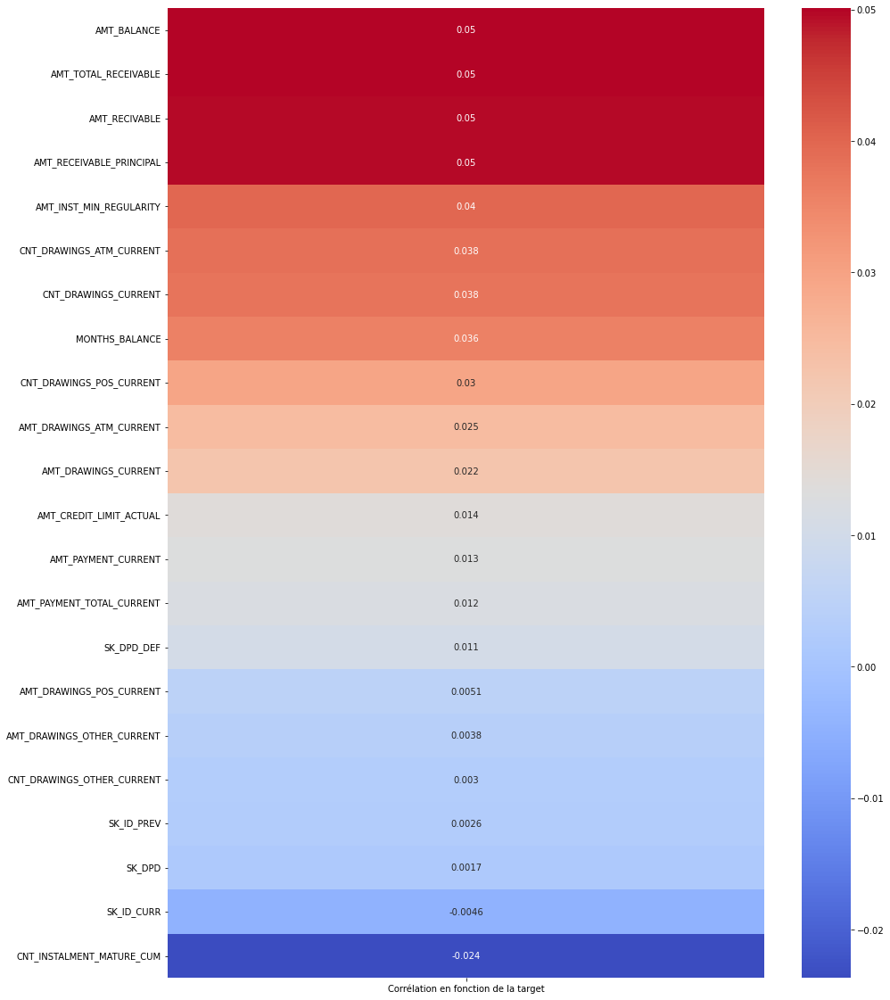

In [420]:
# Visualisation de la matrice de corrélation des variables quantitative par rapport à la Target.

plt.figure(figsize=(15,20))
sns.heatmap(corr_matrix_target, annot=True, cmap='coolwarm')
plt.show()

- On retrouve ici quelques corrélations positives avec la Target surtout pour les variables "AMT" même si elles ne sont pas très fortes (0.05 au maximum).
- Pour les corrélation négative seule une variable se démarque mais toujours faiblement ("CNT_INSTALMENT_MATURE_CUM" pour -0.024)

In [421]:
# Inclure TARGET dans la matrice
cramer_matrix_credit = cramers_v_matrix(df_credit_card, include_target=True, target_col='TARGET')

# Extraire la ligne/colonne de TARGET
target_corr = cramer_matrix_credit['TARGET'].drop('TARGET').sort_values(ascending=False)

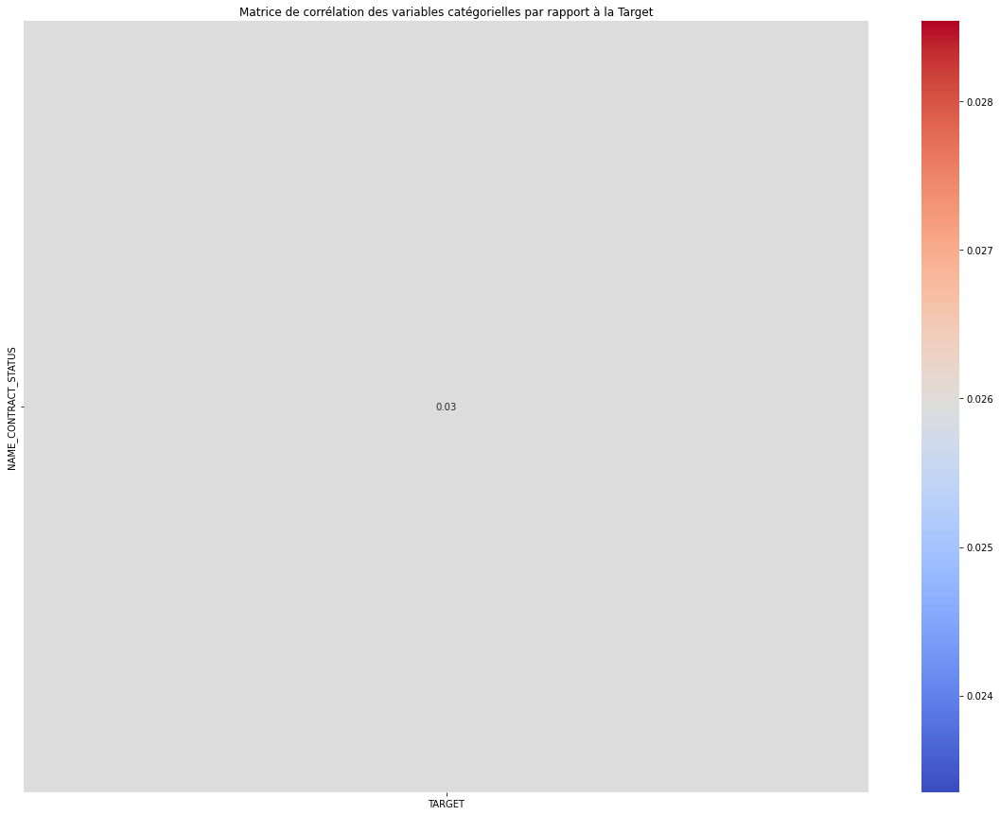

In [422]:
# Visualisation de la matrice de corrélation des variables qualitatives par rapport à la Target.

plt.figure(figsize=(20,15))
sns.heatmap(target_corr.to_frame(), annot=True, fmt=".2f", cmap="coolwarm")
plt.title("Matrice de corrélation des variables catégorielles par rapport à la Target")
plt.show()

- L'unique variable catégorielle est légérement corrélée à la Target au même niveau que les variables quantitatives les plus intéressante.

#### Dataframe "Previous_application"

In [423]:
# Importation du fichier qui s'intitule "previous_application.csv".

df_previous_app = pd.read_csv(r"C:\Users\Caomghin\Desktop\Implementer_un_modele_de_scoring\Donnee_kaggle\previous_application.csv")

In [424]:
# Forme du dataframe "previous_application".

df_previous_app.shape

(1670214, 37)

In [425]:
# Visualisation du dataframe.

df_previous_app

,SK_ID_PREV,SK_ID_CURR,NAME_CONTRACT_TYPE,AMT_ANNUITY,AMT_APPLICATION,AMT_CREDIT,AMT_DOWN_PAYMENT,AMT_GOODS_PRICE,WEEKDAY_APPR_PROCESS_START,HOUR_APPR_PROCESS_START,...,NAME_SELLER_INDUSTRY,CNT_PAYMENT,NAME_YIELD_GROUP,PRODUCT_COMBINATION,DAYS_FIRST_DRAWING,DAYS_FIRST_DUE,DAYS_LAST_DUE_1ST_VERSION,DAYS_LAST_DUE,DAYS_TERMINATION,NFLAG_INSURED_ON_APPROVAL
0,2030495,271877,Consumer loans,1730.430,17145.0,17145.0,0.0,17145.0,SATURDAY,15,...,Connectivity,12.0,middle,POS mobile with interest,365243.0,-42.0,300.0,-42.0,-37.0,0.0
1,2802425,108129,Cash loans,25188.615,607500.0,679671.0,NaN,607500.0,THURSDAY,11,...,XNA,36.0,low_action,Cash X-Sell: low,365243.0,-134.0,916.0,365243.0,365243.0,1.0
2,2523466,122040,Cash loans,15060.735,112500.0,136444.5,NaN,112500.0,TUESDAY,11,...,XNA,12.0,high,Cash X-Sell: high,365243.0,-271.0,59.0,365243.0,365243.0,1.0
3,2819243,176158,Cash loans,47041.335,450000.0,470790.0,NaN,450000.0,MONDAY,7,...,XNA,12.0,middle,Cash X-Sell: middle,365243.0,-482.0,-152.0,-182.0,-177.0,1.0
4,1784265,202054,Cash loans,31924.395,337500.0,404055.0,NaN,337500.0,THURSDAY,9,...,XNA,24.0,high,Cash Street: high,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1670209,2300464,352015,Consumer loans,14704.290,267295.5,311400.0,0.0,267295.5,WEDNESDAY,12,...,Furniture,30.0,low_normal,POS industry with interest,365243.0,-508.0,362.0,-358.0,-351.0,0.0
1670210,2357031,334635,Consumer loans,6622.020,87750.0,64291.5,29250.0,87750.0,TUESDAY,15,...,Furniture,12.0,middle,POS industry with interest,365243.0,-1604.0,-1274.0,-1304.0,-1297.0,0.0
1670211,2659632,249544,Consumer loans,11520.855,105237.0,102523.5,10525.5,105237.0,MONDAY,12,...,Consumer electronics,10.0,low_normal,POS household with interest,365243.0,-1457.0,-1187.0,-1187.0,-1181.0,0.0
1670212,2785582,400317,Cash loans,18821.520,180000.0,191880.0,NaN,180000.0,WEDNESDAY,9,...,XNA,12.0,low_normal,Cash X-Sell: low,365243.0,-1155.0,-825.0,-825.0,-817.0,1.0


In [426]:
# On visualise le type de chaque variable et la présence potentielle de valeurs nulles.

df_previous_app.info(show_counts=True)

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1670214 entries, 0 to 1670213
Data columns (total 37 columns):
 #   Column                       Non-Null Count    Dtype  
---  ------                       --------------    -----  
 0   SK_ID_PREV                   1670214 non-null  int64  
 1   SK_ID_CURR                   1670214 non-null  int64  
 2   NAME_CONTRACT_TYPE           1670214 non-null  object 
 3   AMT_ANNUITY                  1297979 non-null  float64
 4   AMT_APPLICATION              1670214 non-null  float64
 5   AMT_CREDIT                   1670213 non-null  float64
 6   AMT_DOWN_PAYMENT             774370 non-null   float64
 7   AMT_GOODS_PRICE              1284699 non-null  float64
 8   WEEKDAY_APPR_PROCESS_START   1670214 non-null  object 
 9   HOUR_APPR_PROCESS_START      1670214 non-null  int64  
 10  FLAG_LAST_APPL_PER_CONTRACT  1670214 non-null  object 
 11  NFLAG_LAST_APPL_IN_DAY       1670214 non-null  int64  
 12  RATE_DOWN_PAYMENT            774370 non-nu

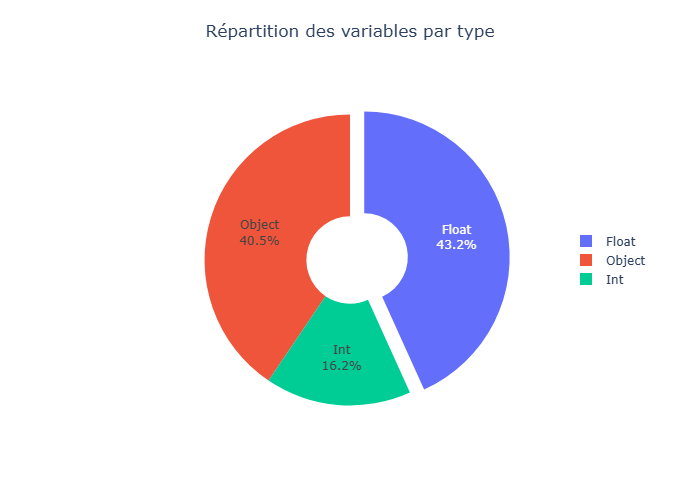

In [427]:
# Représentation graphique des types de variables.

fig = go.Figure(data=[go.Pie(
    labels=["Float", "Object", "Int"], 
    values=df_previous_app.dtypes.value_counts(),
    hole=0.3,
    textinfo="label+percent",
    pull=[0.1, 0, 0]
)])

# Titre et affichage
fig.update_layout(
    title={
        'text': "Répartition des variables par type",
        'y': 0.95,  # Position verticale (1 = tout en haut)
        'x': 0.50,   # Centrer le titre
        'xanchor': 'center',
        'yanchor': 'top'
    },
    legend={
        'x': 0.9,  # Ajuste la position de la légende plus proche
        'y': 0.5,
        'xanchor': 'left'
    }
)
fig.show()

In [428]:
# Visualisation des description liées à ce jeu de données.

pd.set_option('display.max_colwidth', None)
df_description.loc[df_description['Table'] == 'previous_application.csv'][['Row','Description']]

,Row,Description
173,SK_ID_PREV,"ID of previous credit in Home credit related to loan in our sample. (One loan in our sample can have 0,1,2 or more previous loan applications in Home Credit, previous application could, but not necessarily have to lead to credit)"
174,SK_ID_CURR,ID of loan in our sample
175,NAME_CONTRACT_TYPE,"Contract product type (Cash loan, consumer loan [POS] ,...) of the previous application"
176,AMT_ANNUITY,Annuity of previous application
177,AMT_APPLICATION,For how much credit did client ask on the previous application
178,AMT_CREDIT,"Final credit amount on the previous application. This differs from AMT_APPLICATION in a way that the AMT_APPLICATION is the amount for which the client initially applied for, but during our approval process he could have received different amount - AMT_CREDIT"
179,AMT_DOWN_PAYMENT,Down payment on the previous application
180,AMT_GOODS_PRICE,Goods price of good that client asked for (if applicable) on the previous application
181,WEEKDAY_APPR_PROCESS_START,On which day of the week did the client apply for previous application
182,HOUR_APPR_PROCESS_START,Approximately at what day hour did the client apply for the previous application


In [429]:
pd.reset_option('display.max_colwidth')

In [430]:
# Statistique des données du previous application .

df_previous_app.describe().round(2)

,SK_ID_PREV,SK_ID_CURR,AMT_ANNUITY,AMT_APPLICATION,AMT_CREDIT,AMT_DOWN_PAYMENT,AMT_GOODS_PRICE,HOUR_APPR_PROCESS_START,NFLAG_LAST_APPL_IN_DAY,RATE_DOWN_PAYMENT,...,RATE_INTEREST_PRIVILEGED,DAYS_DECISION,SELLERPLACE_AREA,CNT_PAYMENT,DAYS_FIRST_DRAWING,DAYS_FIRST_DUE,DAYS_LAST_DUE_1ST_VERSION,DAYS_LAST_DUE,DAYS_TERMINATION,NFLAG_INSURED_ON_APPROVAL
count,1670214.00,1670214.00,1297979.00,1670214.00,1670213.00,774370.0,1284699.00,1670214.00,1670214.00,774370.00,...,5951.00,1670214.00,1670214.00,1297984.00,997149.00,997149.00,997149.00,997149.00,997149.00,997149.00
mean,1923089.14,278357.17,15955.12,175233.86,196114.02,6697.4,227847.28,12.48,1.00,0.08,...,0.77,-880.68,313.95,16.05,342209.86,13826.27,33767.77,76582.40,81992.34,0.33
std,532597.96,102814.82,14782.14,292779.76,318574.62,20921.5,315396.56,3.33,0.06,0.11,...,0.10,779.10,7127.44,14.57,88916.12,72444.87,106857.03,149647.42,153303.52,0.47
min,1000001.00,100001.00,0.00,0.00,0.00,-0.9,0.00,0.00,0.00,-0.00,...,0.37,-2922.00,-1.00,0.00,-2922.00,-2892.00,-2801.00,-2889.00,-2874.00,0.00
25%,1461857.25,189329.00,6321.78,18720.00,24160.50,0.0,50841.00,10.00,1.00,0.00,...,0.72,-1300.00,-1.00,6.00,365243.00,-1628.00,-1242.00,-1314.00,-1270.00,0.00
50%,1923110.50,278714.50,11250.00,71046.00,80541.00,1638.0,112320.00,12.00,1.00,0.05,...,0.84,-581.00,3.00,12.00,365243.00,-831.00,-361.00,-537.00,-499.00,0.00
75%,2384279.75,367514.00,20658.42,180360.00,216418.50,7740.0,234000.00,15.00,1.00,0.11,...,0.85,-280.00,82.00,24.00,365243.00,-411.00,129.00,-74.00,-44.00,1.00
max,2845382.00,456255.00,418058.14,6905160.00,6905160.00,3060045.0,6905160.00,23.00,1.00,1.00,...,1.00,-1.00,4000000.00,84.00,365243.00,365243.00,365243.00,365243.00,365243.00,1.00


In [431]:
# Calcul du pourcentage de valeurs nulles par variable pour "previous_application.csv". 
pd.set_option('display.max_rows', None)
calculate_missing_values(df_previous_app)

,Nbr_valeurs_manquantes,Pct_valeurs_manquantes
RATE_INTEREST_PRIMARY,1664263,99.643698
RATE_INTEREST_PRIVILEGED,1664263,99.643698
AMT_DOWN_PAYMENT,895844,53.636480
RATE_DOWN_PAYMENT,895844,53.636480
NAME_TYPE_SUITE,820405,49.119754
DAYS_FIRST_DRAWING,673065,40.298129
DAYS_FIRST_DUE,673065,40.298129
DAYS_LAST_DUE_1ST_VERSION,673065,40.298129
DAYS_LAST_DUE,673065,40.298129
DAYS_TERMINATION,673065,40.298129


In [432]:
pd.reset_option('display.max_rows')

Text(0, 0.5, 'Loans')

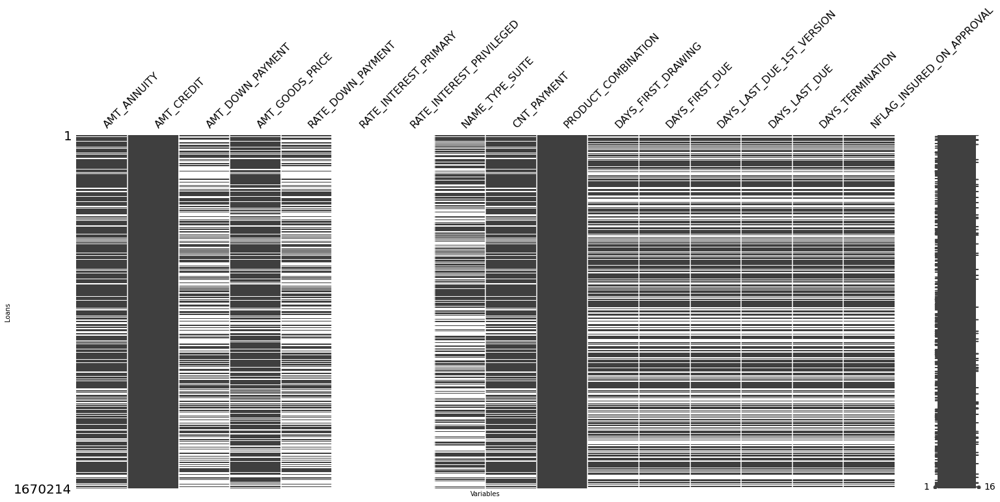

In [433]:
# Utilisation d'un graphique pour avoir une représentation visuelle des valeurs manquantes.

msno.matrix(df_previous_app.loc[:, df_previous_app.isnull().any(axis=0)])

plt.xlabel("Variables")
plt.ylabel("Loans")

- On retrouve ici 16 variables avec des valeurs manquantes dont certaines sont quasiment inutilisables puisque elles recensent 99 % de valeurs manquantes.
- Les autres tournent autour de 50 % donc il faudra corriger cela si ces variables sont utiles à notre projet.

In [434]:
df_previous_app.info(show_counts=True)

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1670214 entries, 0 to 1670213
Data columns (total 37 columns):
 #   Column                       Non-Null Count    Dtype  
---  ------                       --------------    -----  
 0   SK_ID_PREV                   1670214 non-null  int64  
 1   SK_ID_CURR                   1670214 non-null  int64  
 2   NAME_CONTRACT_TYPE           1670214 non-null  object 
 3   AMT_ANNUITY                  1297979 non-null  float64
 4   AMT_APPLICATION              1670214 non-null  float64
 5   AMT_CREDIT                   1670213 non-null  float64
 6   AMT_DOWN_PAYMENT             774370 non-null   float64
 7   AMT_GOODS_PRICE              1284699 non-null  float64
 8   WEEKDAY_APPR_PROCESS_START   1670214 non-null  object 
 9   HOUR_APPR_PROCESS_START      1670214 non-null  int64  
 10  FLAG_LAST_APPL_PER_CONTRACT  1670214 non-null  object 
 11  NFLAG_LAST_APPL_IN_DAY       1670214 non-null  int64  
 12  RATE_DOWN_PAYMENT            774370 non-nu

In [435]:
# Recherche de doublons pour la variable ID "SK_ID_PREV"

df_previous_app['SK_ID_PREV'].duplicated().any()

False

In [436]:
# Nombre de lignes présentant au moins un doublon et celles n'en présentant pas.

df_previous_app['SK_ID_PREV'].duplicated(keep=False).value_counts()

False    1670214
Name: SK_ID_PREV, dtype: int64

- Pour ce dataframe la variable "SK_ID_PREV" ne présente pas de doublons ce qui peut faire office de clé primaire ici pour de précédents crédits avant la demande de prêt actuelle de nos clients.

In [437]:
# Recherche de doublons pour la variable ID "SK_ID_CURR"

df_previous_app['SK_ID_CURR'].duplicated().any()

True

In [438]:
# Nombre de lignes présentant au moins un doublon et celles n'en présentant pas.

df_previous_app['SK_ID_CURR'].duplicated(keep=False).value_counts()

True     1609756
False      60458
Name: SK_ID_CURR, dtype: int64

In [439]:
# Nombre de ID unique pour cette variable.

df_previous_app['SK_ID_CURR'].nunique()

338857

- Fais référence aux ID des demandes de prêts qui représente les clients dans le fichier principal donc il est normal d'avoir des doublons puisque un même client peut avoir différents crédits antérieur à cette demande.
- On passe ensuite aux différentes variables du dataframe en commençant par les variables catégorielles qui peuvent être pertinente par la suite :

In [440]:
df_previous_app.select_dtypes(include=['object']).nunique()

NAME_CONTRACT_TYPE              4
WEEKDAY_APPR_PROCESS_START      7
FLAG_LAST_APPL_PER_CONTRACT     2
NAME_CASH_LOAN_PURPOSE         25
NAME_CONTRACT_STATUS            4
NAME_PAYMENT_TYPE               4
CODE_REJECT_REASON              9
NAME_TYPE_SUITE                 7
NAME_CLIENT_TYPE                4
NAME_GOODS_CATEGORY            28
NAME_PORTFOLIO                  5
NAME_PRODUCT_TYPE               3
CHANNEL_TYPE                    8
NAME_SELLER_INDUSTRY           11
NAME_YIELD_GROUP                5
PRODUCT_COMBINATION            17
dtype: int64

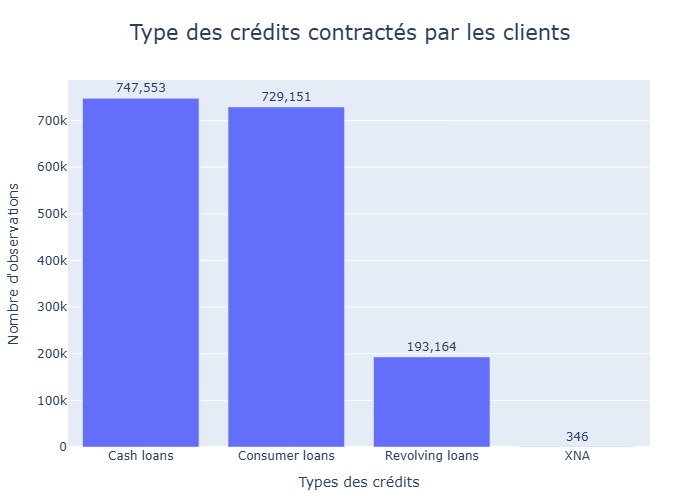

In [441]:
# Visualisation de la répartition pour la variable "NAME_CONTRACT_TYPE"

plot_categorical_histogram(
    df=df_previous_app,
    x="NAME_CONTRACT_TYPE",
    title="Type des crédits contractés par les clients",
    xaxis_title= 'Types des crédits',
    title_font_size=21
)

In [442]:
# Ajout de la variable 'TARGET' au dataframe df_previous_app

df_previous_app['TARGET'] = df_previous_app['SK_ID_CURR'].map(df_appli_train.set_index('SK_ID_CURR')['TARGET'])

In [443]:
# Nombre d'occurence pour chacune des valeurs de cette variable.

df_previous_app['TARGET'].value_counts(dropna=False)

0.0    1291341
NaN     256513
1.0     122360
Name: TARGET, dtype: int64

- De nouveau des valeurs nulles puisque certains ID's proviennent du fichier de test que l'on utilise pas ici.

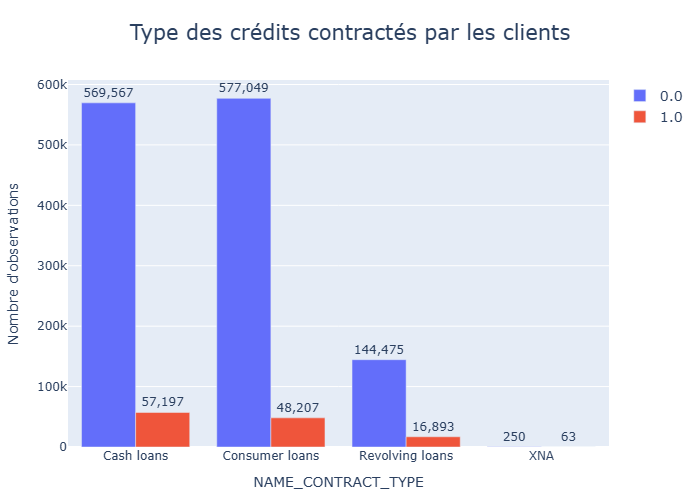

In [444]:
# Visualisation de la répartition pour la variable "NAME_CONTRACT_TYPE" en fonction de la Target.

plot_categorical_histogram(
    df=df_previous_app,
    x="NAME_CONTRACT_TYPE",
    color= 'TARGET',
    title="Type des crédits contractés par les clients",
    title_font_size=21
)

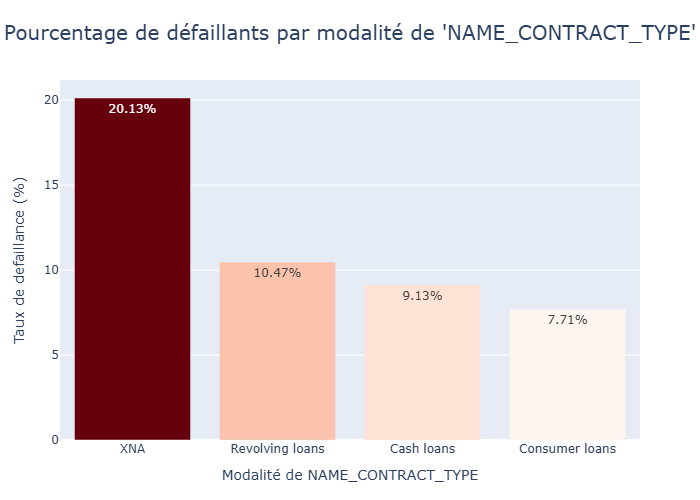

In [445]:
# Visualisation du pourcentage de prêts défaillants pour la variable de NAME_CONTRACT_TYPE.

plot_defaillance_rate_per_category(
    df_previous_app,
    cat_var='NAME_CONTRACT_TYPE',
    title_layout={"x": 0.5},
    xaxis_title = "Modalité de NAME_CONTRACT_TYPE",
    yaxis_title = "Taux de defaillance (%)",
    title_font_size=20
)

- Le taux de défaillance est bien plus élevé pour les crédits dont le type n'est pas spécifié.
- Pour le reste il y a peu de différence entre les 3 autres types de crédits (même si il faut prendre en compte que les "Cash Loans" et les "Consumer Loans" sont beaucoup plus représentés que le dernier).

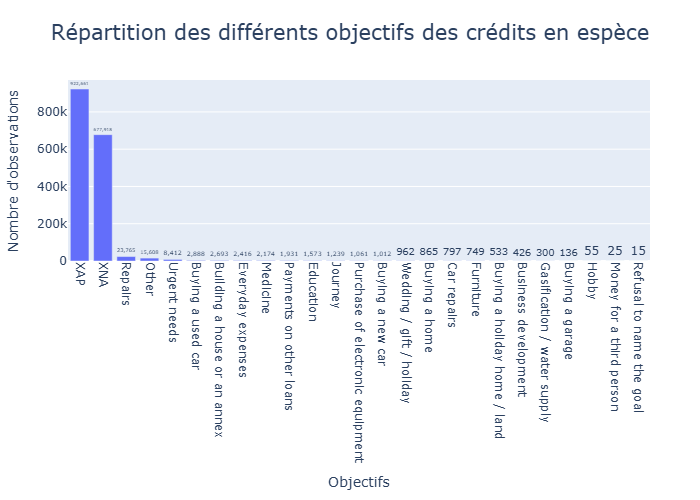

In [446]:
# Visualisation de la répartition pour la variable "NAME_CASH_LOAN_PURPOSE"

'''def plot_categorical_histogram(df, x, color=None, color_map=None, nbins=None,
                                title=None, width=800, height=500,
                                orientation='v', barmode='group', use_plotly_express=False,
                                title_layout=None, xaxis_title=None, yaxis_title=None,
                                legend_layout=None, tickangle=0, title_font_size=18, 
                                legend_font_size=14, margin=None, percent=False, rare_threshold=None):'''

plot_categorical_histogram(
    df=df_previous_app,
    x="NAME_CASH_LOAN_PURPOSE",
    title="Répartition des différents objectifs des crédits en espèce",
    tickangle=90,
    xaxis_title= 'Objectifs',
    title_font_size=21
)

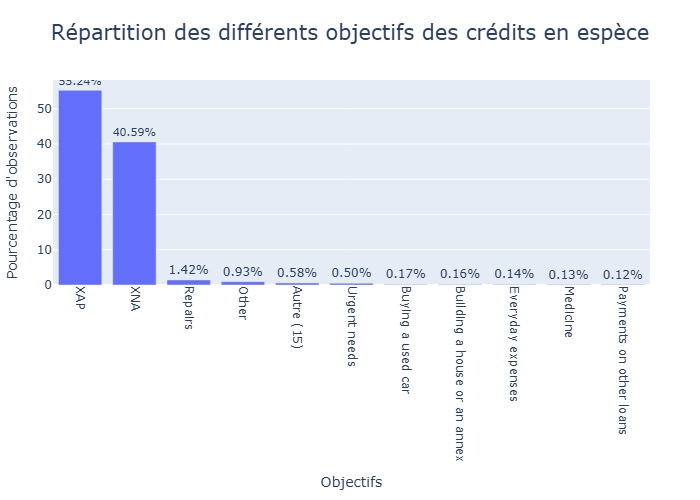

In [447]:
# Visualisation de la répartition pour la variable "NAME_CASH_LOAN_PURPOSE"

plot_categorical_histogram(
    df=df_previous_app,
    x="NAME_CASH_LOAN_PURPOSE",
    title="Répartition des différents objectifs des crédits en espèce",
    tickangle=90,
    xaxis_title= 'Objectifs',
    rare_threshold=0.001,
    title_font_size=21,
    percent=True,
    height=900
)

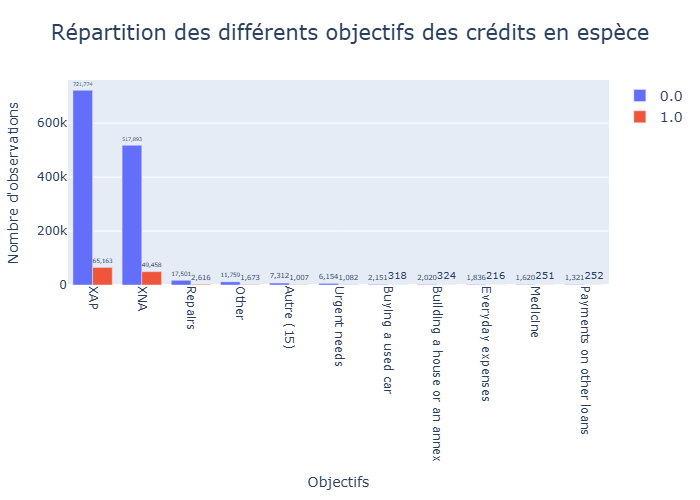

In [448]:
# Visualisation de la répartition pour la variable "NAME_CASH_LOAN_PURPOSE" en fonction de la Target.

plot_categorical_histogram(
    df=df_previous_app,
    x="NAME_CASH_LOAN_PURPOSE",
    title="Répartition des différents objectifs des crédits en espèce",
    color= 'TARGET',
    tickangle=90,
    xaxis_title= 'Objectifs',
    rare_threshold=0.001,
    title_font_size=21,
    height=900
)

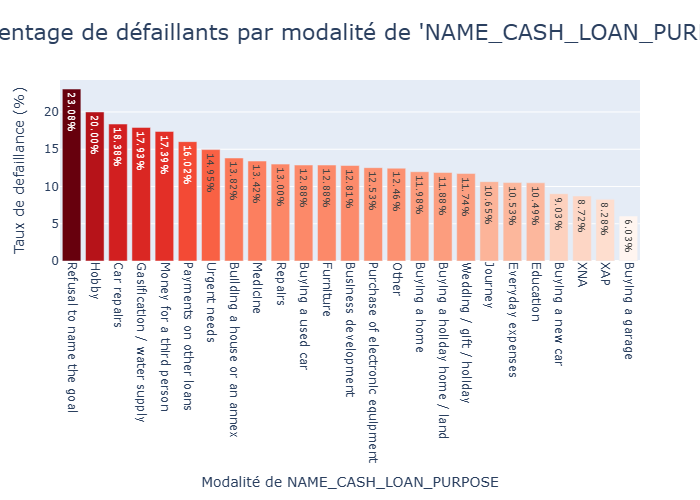

In [449]:
# Visualisation du pourcentage de prêts défaillants pour la variable de NAME_CASH_LOAN_PURPOSE.

plot_defaillance_rate_per_category(
    df_previous_app,
    cat_var='NAME_CASH_LOAN_PURPOSE',
    title_layout={"x": 0.5},
    xaxis_title = "Modalité de NAME_CASH_LOAN_PURPOSE",
    yaxis_title = "Taux de defaillance (%)",
    tickangle=90,
    title_font_size=22
)

- Pour cette variable qui met en avant les différents objectifs liès à la souscription d'un crédit, on peut voir que les principales catégories sont XAP et XNA pour 95 % des objectifs mis en avant.
- Toutefois lorsque l'on regarde les taux de défaillance, il est intéressant de remarquer que la première catégorie à se démarquée est celle où les clients ont refusés de donner une raison (23 % de défaillance pour cette catégorie) ce qui pourrait être pris en compte par la suite.
- A l'inverse pour les deux catégories avec le plus d'effectifs, elles se positionnent en fin de classement avec moins de 10 % de défaillance.

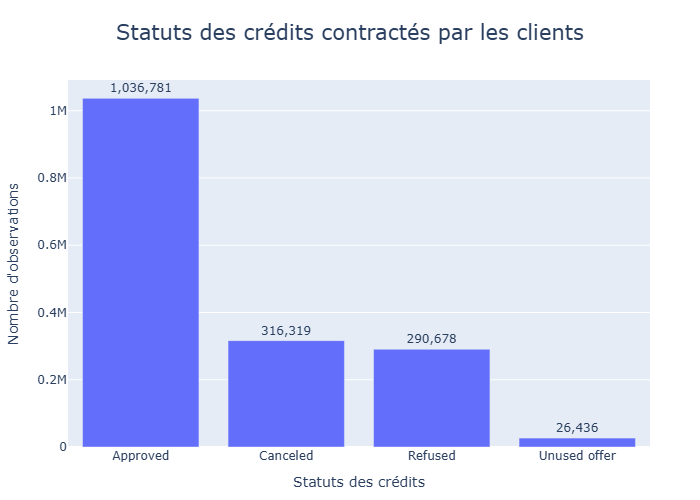

In [450]:
# Visualisation de la répartition pour la variable "NAME_CONTRACT_STATUS"

plot_categorical_histogram(
    df=df_previous_app,
    x="NAME_CONTRACT_STATUS",
    title="Statuts des crédits contractés par les clients",
    xaxis_title= 'Statuts des crédits',
    title_font_size=21
)

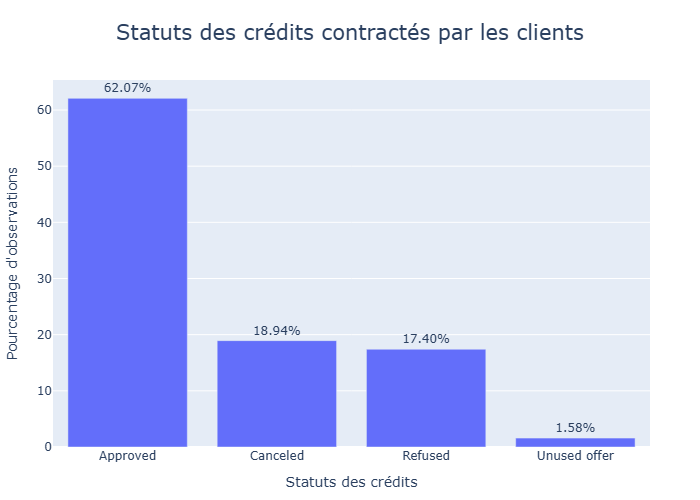

In [451]:
# Visualisation de la répartition pour la variable "NAME_CONTRACT_STATUS"

plot_categorical_histogram(
    df=df_previous_app,
    x="NAME_CONTRACT_STATUS",
    title="Statuts des crédits contractés par les clients",
    xaxis_title= 'Statuts des crédits',
    percent=True,
    title_font_size=21)


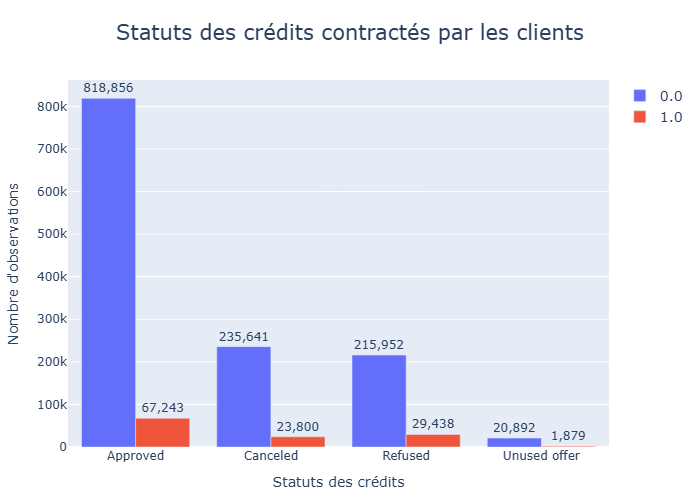

In [452]:
# Visualisation de la répartition pour la variable "NAME_CONTRACT_STATUS"

plot_categorical_histogram(
    df=df_previous_app,
    x="NAME_CONTRACT_STATUS",
    color= 'TARGET',
    title="Statuts des crédits contractés par les clients",
    xaxis_title= 'Statuts des crédits',
    title_font_size=21
)

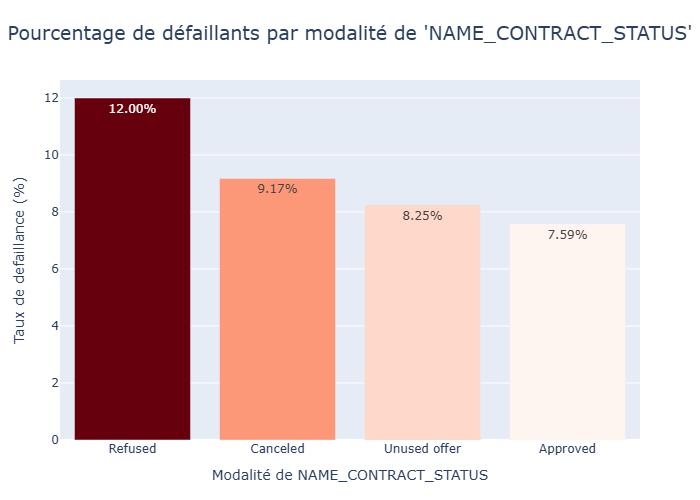

In [453]:
# Visualisation du pourcentage de prêts défaillants pour la variable de NAME_CONTRACT_STATUS.

plot_defaillance_rate_per_category(
    df_previous_app,
    cat_var='NAME_CONTRACT_STATUS',
    title_layout={"x": 0.5},
    xaxis_title = "Modalité de NAME_CONTRACT_STATUS",
    yaxis_title = "Taux de defaillance (%)",
    title_font_size=19
)

- De nouveau une variable intéressante puisque cela nous donne des informations sur les décisions prises au sujets des crédits antérieurs à la demande actuelle de nos clients. Comme on peut le voir la majorité des crédits sont accordés pour plus de **60 %** des cas.
- Pour le reste des cas, les crédits ont soit été refusés (**17%**), annulés (**18%**) ou non utilisé pour le reste.
- Ce qui est intéressant ici, c'est le taux de défaillance pour la modalité *"Refused"* qui est le plus important et qui peut permettre d'améliorer la prise de décision pour les futurs demandes de prêts (même constat pour *"Canceled"*).

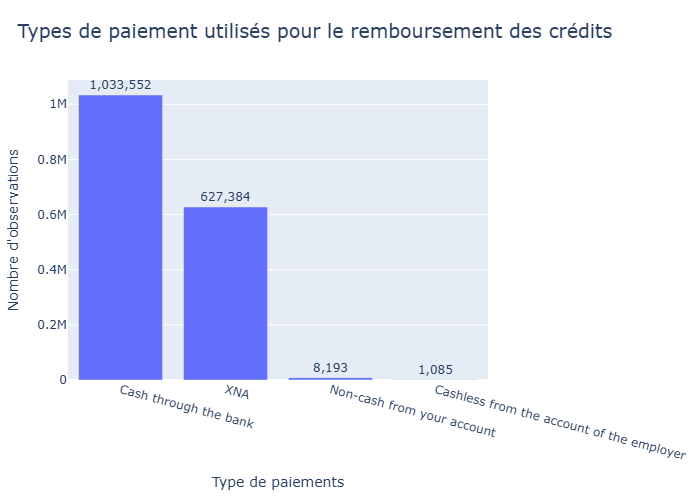

In [454]:
# Visualisation de la répartition pour la variable "NAME_PAYMENT_TYPE"

plot_categorical_histogram(
    df=df_previous_app,
    x="NAME_PAYMENT_TYPE",
    title="Types de paiement utilisés pour le remboursement des crédits",
    title_layout={"x": 0.45},
    xaxis_title= 'Type de paiements',
    tickangle=15,
    title_font_size=19
)

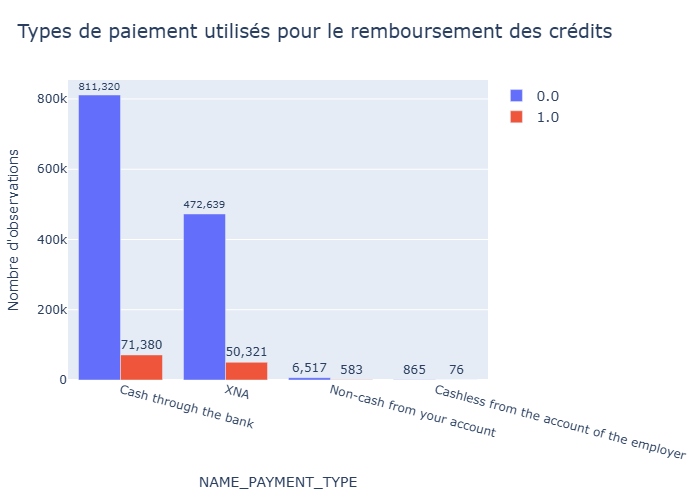

In [455]:
# Visualisation de la répartition pour la variable "NAME_PAYMENT_TYPE" en fonction de la Target.

plot_categorical_histogram(
    df=df_previous_app,
    x="NAME_PAYMENT_TYPE",
    color= 'TARGET',
    title="Types de paiement utilisés pour le remboursement des crédits",
    title_layout={"x": 0.45},
    tickangle=15,
    title_font_size=19
)

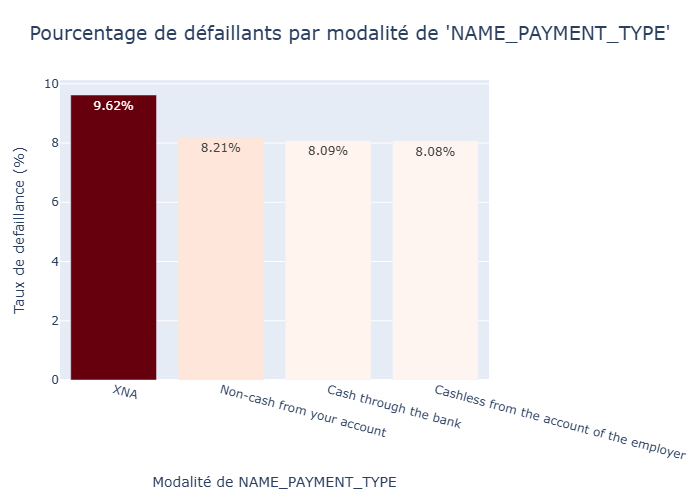

In [456]:
# Visualisation du pourcentage de prêts défaillants pour la variable de NAME_PAYMENT_TYPE.

plot_defaillance_rate_per_category(
    df_previous_app,
    cat_var='NAME_PAYMENT_TYPE',
    title_layout={"x": 0.5},
    xaxis_title = "Modalité de NAME_PAYMENT_TYPE",
    yaxis_title = "Taux de defaillance (%)",
    tickangle=15,
    title_font_size=19
    )

- Pour les types de paiment utilisés, seuls les méthodes inconnues se démarquent sans que cela soit réellement significatif.

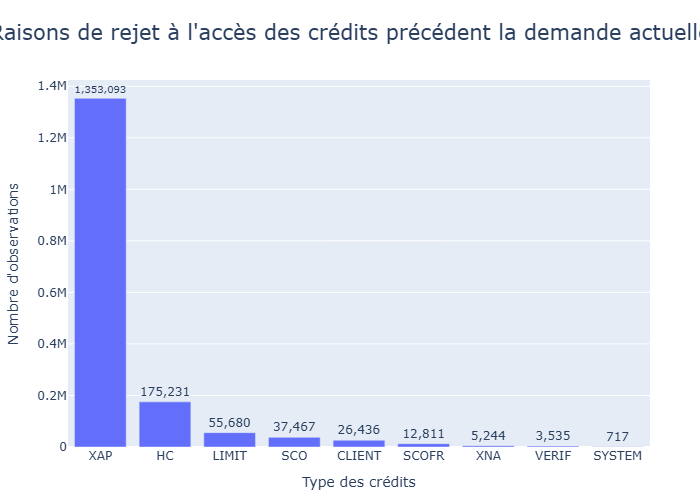

In [457]:
# Visualisation de la répartition pour la variable "CODE_REJECT_REASON"

plot_categorical_histogram(
    df=df_previous_app,
    x="CODE_REJECT_REASON",
    title="Raisons de rejet à l'accès des crédits précédent la demande actuelle",
    xaxis_title= 'Type des crédits',
    title_font_size=21
)

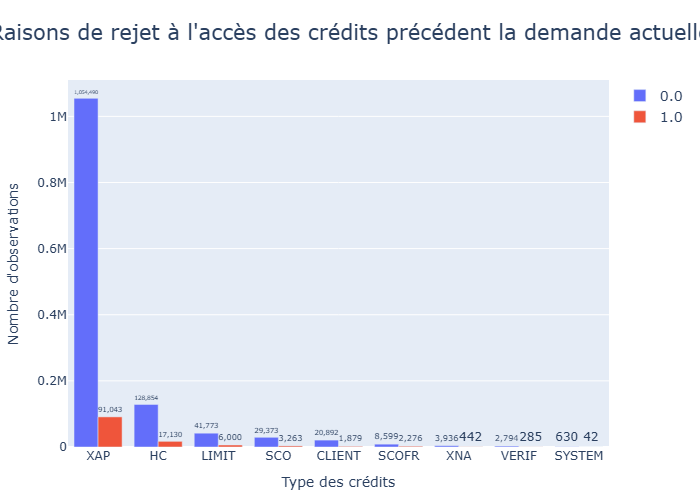

In [458]:
# Visualisation de la répartition pour la variable "CODE_REJECT_REASON"

plot_categorical_histogram(
    df=df_previous_app,
    x="CODE_REJECT_REASON",
    color= 'TARGET',
    title="Raisons de rejet à l'accès des crédits précédent la demande actuelle",
    xaxis_title= 'Type des crédits',
    title_font_size=21
)

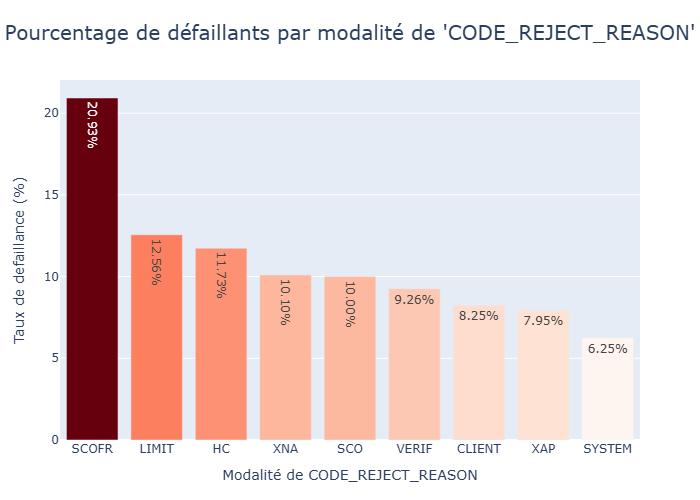

In [459]:
# Visualisation du pourcentage de prêts défaillants pour la variable de CODE_REJECT_REASON.

plot_defaillance_rate_per_category(
    df_previous_app,
    cat_var='CODE_REJECT_REASON',
    title_layout={"x": 0.5},
    xaxis_title = "Modalité de CODE_REJECT_REASON",
    yaxis_title = "Taux de defaillance (%)",
    title_font_size=20
)

- Pour cette variable, la raison **"SCOFR"** se démarque du lot comparativement aux autres taux assez proches relativement les uns des autres.

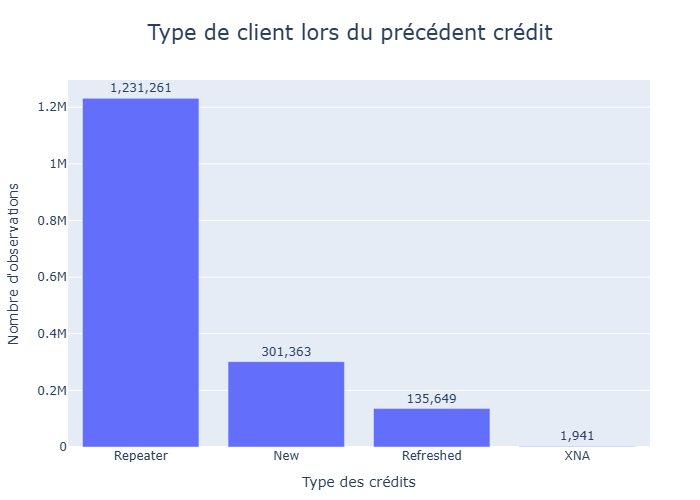

In [460]:
# Visualisation de la répartition pour la variable "NAME_CLIENT_TYPE"

plot_categorical_histogram(
    df=df_previous_app,
    x="NAME_CLIENT_TYPE",
    title="Type de client lors du précédent crédit",
    xaxis_title= 'Type des crédits',
    title_font_size=21
)

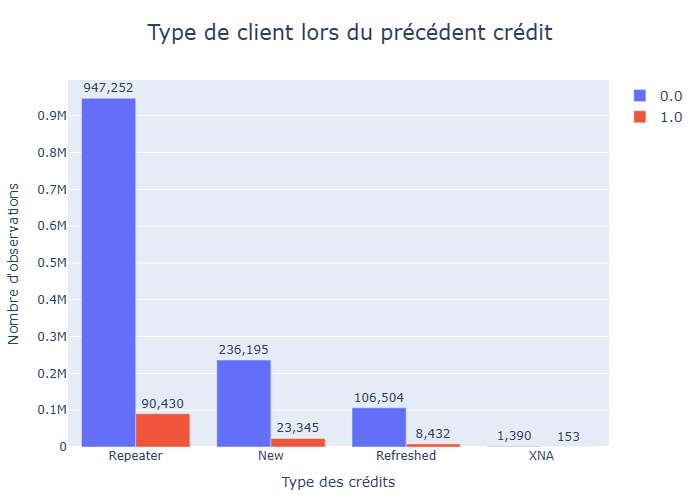

In [461]:
# Visualisation de la répartition pour la variable "NAME_CLIENT_TYPE" en fonction de la Target.

plot_categorical_histogram(
    df=df_previous_app,
    x="NAME_CLIENT_TYPE",
    color= 'TARGET',
    title="Type de client lors du précédent crédit",
    xaxis_title= 'Type des crédits',
    title_font_size=21
)

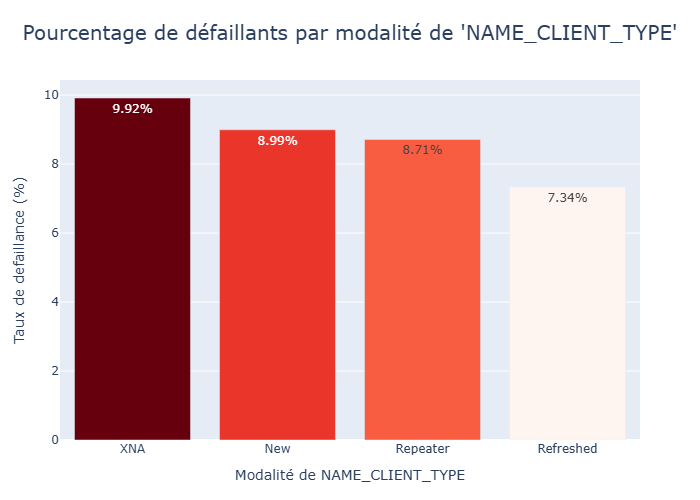

In [462]:
# Visualisation du pourcentage de prêts défaillants pour la variable de NAME_CLIENT_TYPE.

plot_defaillance_rate_per_category(
    df_previous_app,
    cat_var='NAME_CLIENT_TYPE',
    title_layout={"x": 0.5},
    xaxis_title = "Modalité de NAME_CLIENT_TYPE",
    yaxis_title = "Taux de defaillance (%)",
    title_font_size=20
)

- Ce sont les nouveaux et les client dont on ne connait pas leur ancienneté qui ont le plus de défaillance sans être significatif.

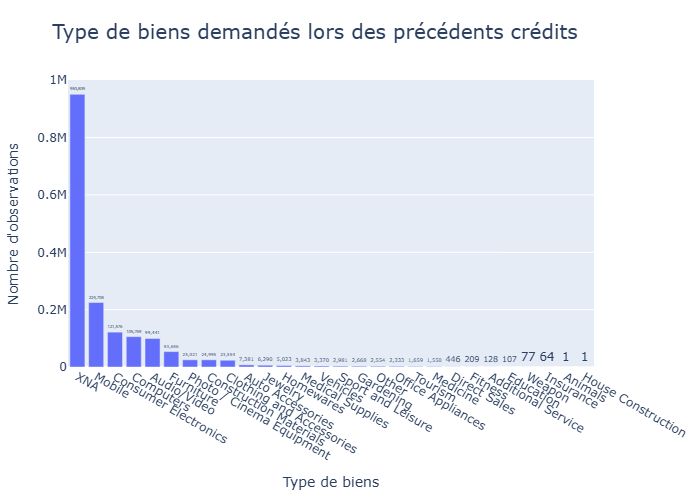

In [463]:
# Visualisation de la répartition pour la variable "NAME_GOODS_CATEGORY"

plot_categorical_histogram(
    df=df_previous_app,
    x="NAME_GOODS_CATEGORY",
    title="Type de biens demandés lors des précédents crédits",
    title_layout={"x": 0.45},
    xaxis_title= 'Type de biens',
    tickangle=30,
    title_font_size=20
)

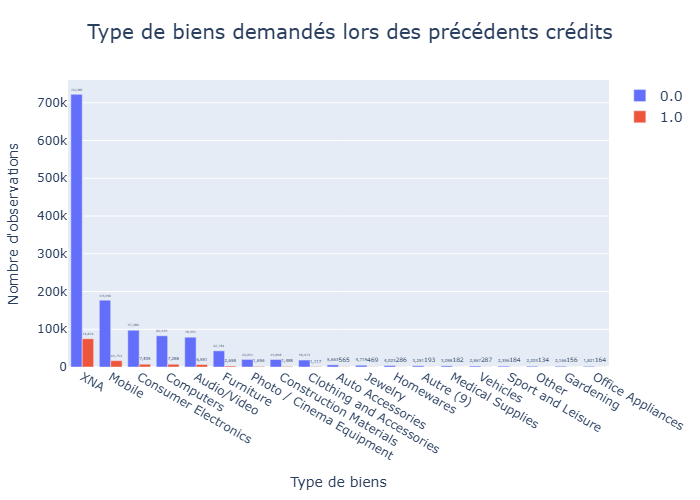

In [464]:
# Visualisation de la répartition pour la variable "NAME_GOODS_CATEGORY" en fonction de la Target.

plot_categorical_histogram(
    df=df_previous_app,
    x="NAME_GOODS_CATEGORY",
    color= 'TARGET',
    title="Type de biens demandés lors des précédents crédits",
    xaxis_title= 'Type de biens',
    tickangle=30,
    title_font_size=20,
    rare_threshold=0.001,
    height=900
)

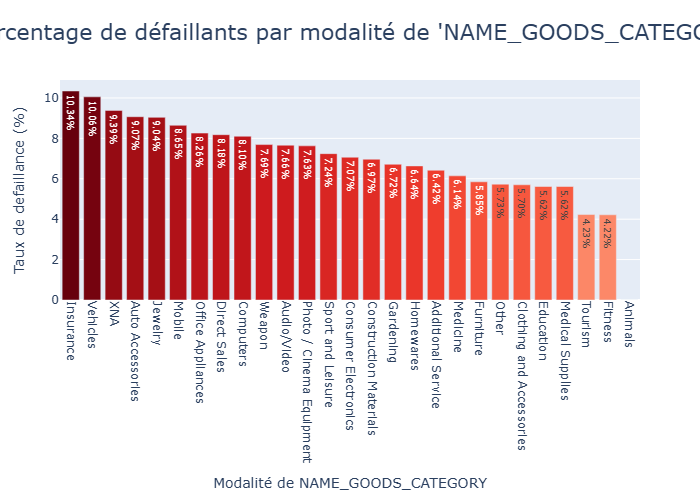

In [465]:
# Visualisation du pourcentage de prêts défaillants pour la variable de NAME_GOODS_CATEGORY.

plot_defaillance_rate_per_category(
    df_previous_app,
    cat_var='NAME_GOODS_CATEGORY',
    title_layout={"x": 0.5},
    xaxis_title = "Modalité de NAME_GOODS_CATEGORY",
    yaxis_title = "Taux de defaillance (%)",
    tickangle=90,
    title_font_size=22,
    height=900,
    width=1000
)

- Selon les catégories de biens, il y a des différences au niveau de la défaillance car on passe de plus de 10 % pour **"Insurance"** à moins de 5 % pour **"Tourism"** et **"Fitness"** (les dernières catégories ne présentant que quelques crédits comme "Animals" seulement 1 crédit)
- Toutefois au niveau des effectifs, la plupart des clients ne précisent pas pour quel type de biens ils souhaitent obtenir un crédit (XNA en grande majorité).

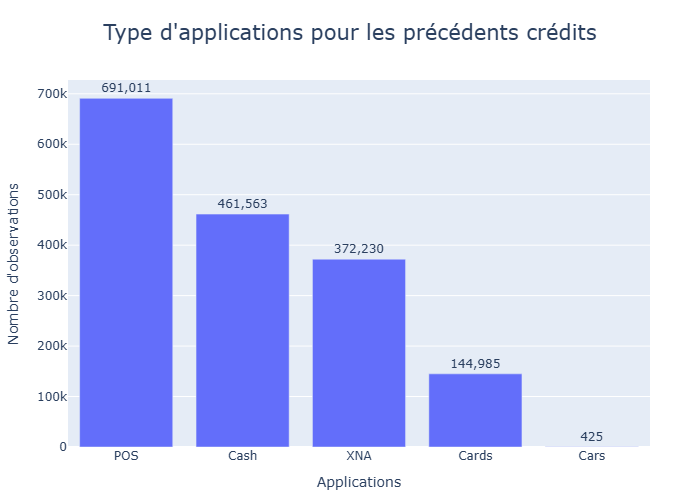

In [466]:
# Visualisation de la répartition pour la variable "NAME_PORTFOLIO"

plot_categorical_histogram(
    df=df_previous_app,
    x="NAME_PORTFOLIO",
    title="Type d'applications pour les précédents crédits",
    xaxis_title= 'Applications',
    title_font_size=21
)

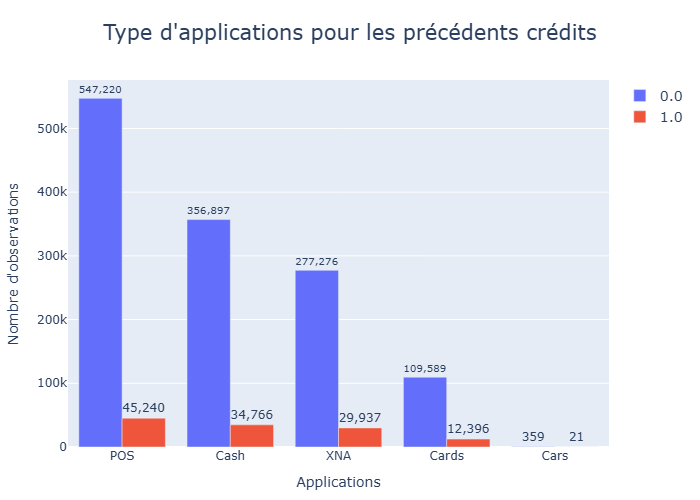

In [467]:
# Visualisation de la répartition pour la variable "NAME_PORTFOLIO" en fonction de la Target.

plot_categorical_histogram(
    df=df_previous_app,
    x="NAME_PORTFOLIO",
    color= 'TARGET',
    title="Type d'applications pour les précédents crédits",
    xaxis_title= 'Applications',
    title_font_size=21
)

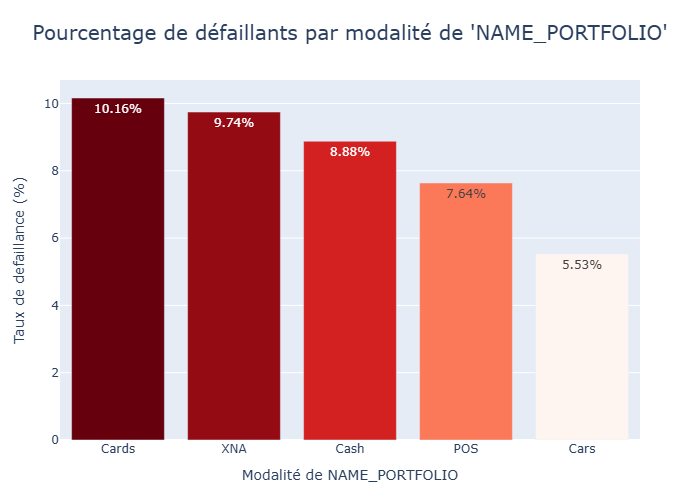

In [468]:
# Visualisation du pourcentage de prêts défaillants pour la variable de NAME_PORTFOLIO.

plot_defaillance_rate_per_category(
    df_previous_app,
    cat_var='NAME_PORTFOLIO',
    title_layout={"x": 0.5},
    xaxis_title = "Modalité de NAME_PORTFOLIO",
    yaxis_title = "Taux de defaillance (%)",
    title_font_size=20
)

- La majorité des crédits sont **POS** mais c'est la catégorie **Cards** qui affiche le plus de défaillance même si dans l'ensemble il y a peu de différences entre les modalités sauf **Cars** qui se démarque un petit peu plus.

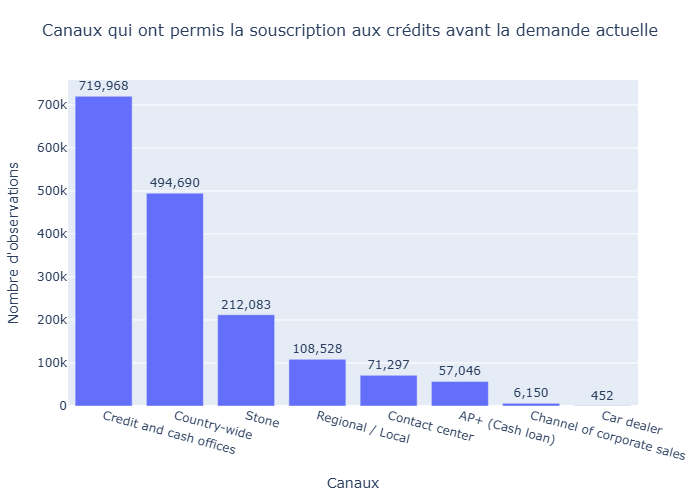

In [469]:
# Visualisation de la répartition pour la variable "CHANNEL_TYPE"

plot_categorical_histogram(
    df=df_previous_app,
    x="CHANNEL_TYPE",
    title="Canaux qui ont permis la souscription aux crédits avant la demande actuelle",
    xaxis_title= 'Canaux',
    tickangle=15,
    title_font_size=16
)

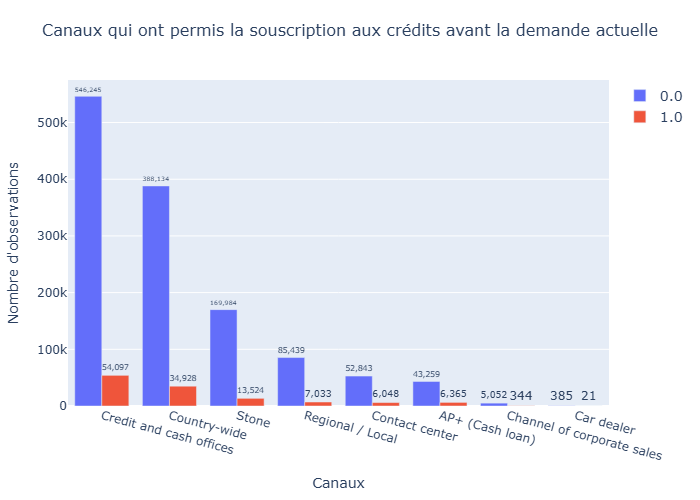

In [470]:
# Visualisation de la répartition pour la variable "CHANNEL_TYPE" en fonction de la Target.

plot_categorical_histogram(
    df=df_previous_app,
    x="CHANNEL_TYPE",
    title="Canaux qui ont permis la souscription aux crédits avant la demande actuelle",
    xaxis_title= 'Canaux',
    color= 'TARGET',
    tickangle=15,
    title_font_size=16
)

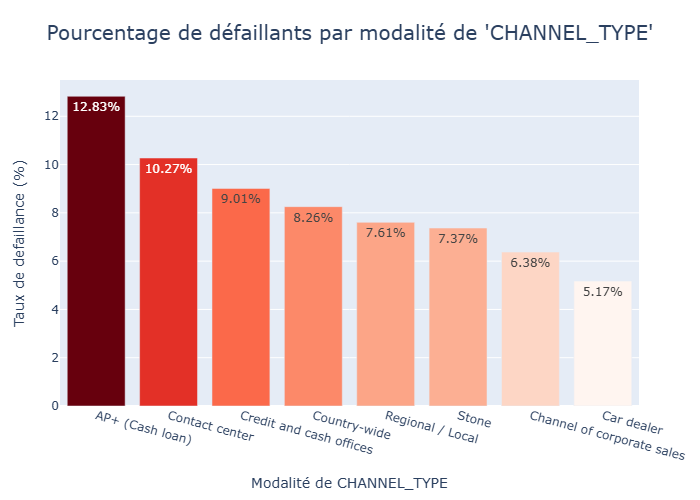

In [471]:
# Visualisation du pourcentage de prêts défaillants pour la variable de CHANNEL_TYPE.

plot_defaillance_rate_per_category(
    df_previous_app,
    cat_var='CHANNEL_TYPE',
    title_layout={"x": 0.5},
    xaxis_title = "Modalité de CHANNEL_TYPE",
    yaxis_title = "Taux de defaillance (%)",
    tickangle=15,
    title_font_size=20
)

- Les canaux les plus utilisés sont "Credit and Cash office" et "Country Wide" pour la majorité.
- Pour ce qui est des canaux avec le plus de défaillance ce sont "AP+" et "Contact center" qui sont à plus de 10 % chacun.

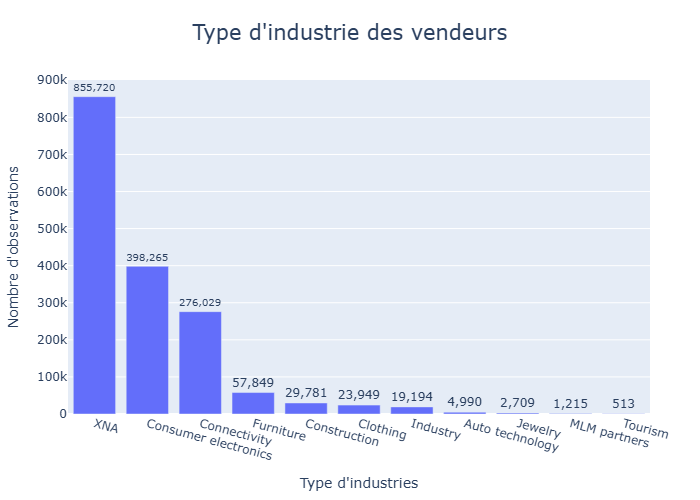

In [472]:
# Visualisation de la répartition pour la variable "NAME_SELLER_INDUSTRY"

plot_categorical_histogram(
    df=df_previous_app,
    x="NAME_SELLER_INDUSTRY",
    title="Type d'industrie des vendeurs",
    xaxis_title= "Type d'industries",
    tickangle=15,
    title_font_size=21
)

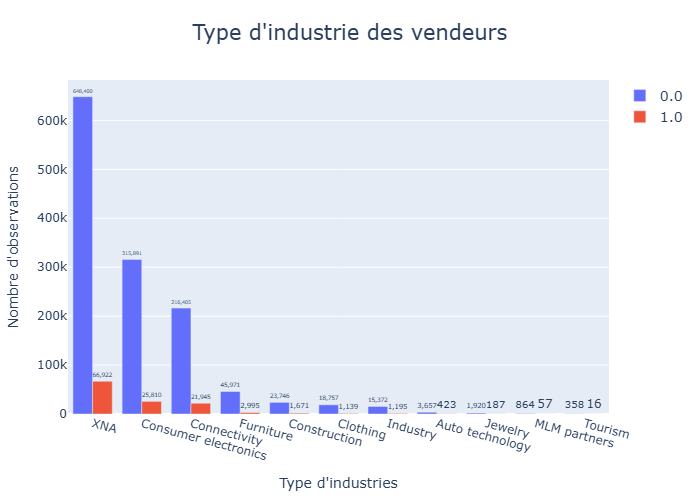

In [473]:
# Visualisation de la répartition pour la variable "NAME_SELLER_INDUSTRY" en fonction de la Target.

plot_categorical_histogram(
    df=df_previous_app,
    x="NAME_SELLER_INDUSTRY",
    color= 'TARGET',
    title="Type d'industrie des vendeurs",
    xaxis_title= "Type d'industries",
    tickangle=15,
    title_font_size=21
)

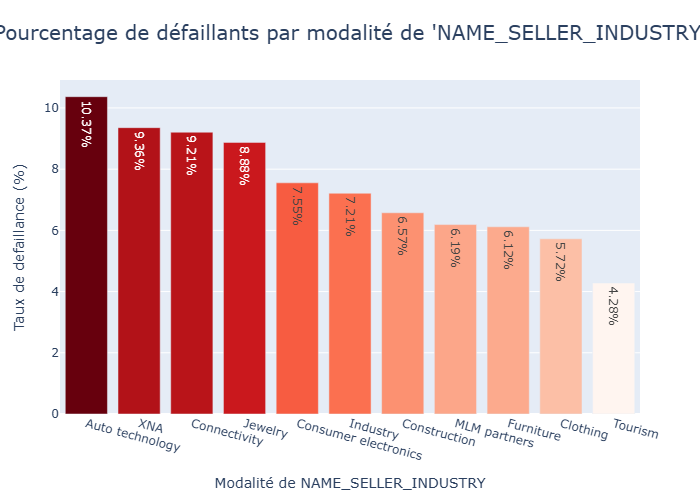

In [474]:
# Visualisation du pourcentage de prêts défaillants pour la variable de NAME_SELLER_INDUSTRY.

plot_defaillance_rate_per_category(
    df_previous_app,
    cat_var='NAME_SELLER_INDUSTRY',
    title_layout={"x": 0.5},
    xaxis_title = "Modalité de NAME_SELLER_INDUSTRY",
    yaxis_title = "Taux de defaillance (%)",
    tickangle=15,
    title_font_size=20
)

- Les modalités "Auto Technology" et "XNA" sont celles qui présentent le plus de défaillance mais ca reste assez similaire pour les 4 premières modalités. Toutefois dans la grande majorité des cas, l'industrie n'est pas renseignée.

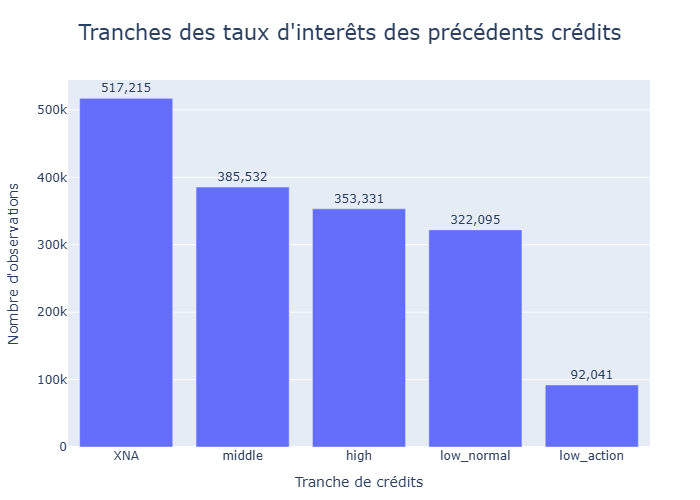

In [475]:
# Visualisation de la répartition pour la variable "NAME_YIELD_GROUP"

plot_categorical_histogram(
    df=df_previous_app,
    x="NAME_YIELD_GROUP",
    title=" Tranches des taux d'interêts des précédents crédits ",
    xaxis_title= 'Tranche de crédits',
    title_font_size=21
)

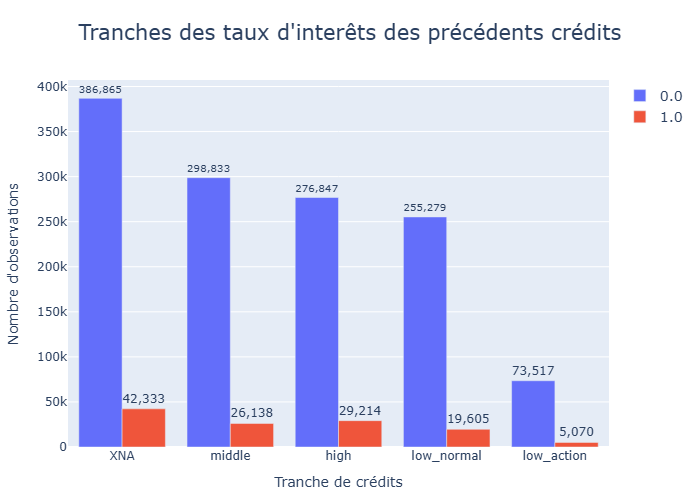

In [476]:
# Visualisation de la répartition pour la variable "NAME_YIELD_GROUP"

plot_categorical_histogram(
    df=df_previous_app,
    x="NAME_YIELD_GROUP",
    color= 'TARGET',
    title=" Tranches des taux d'interêts des précédents crédits ",
    xaxis_title= 'Tranche de crédits',
    title_font_size=21
)

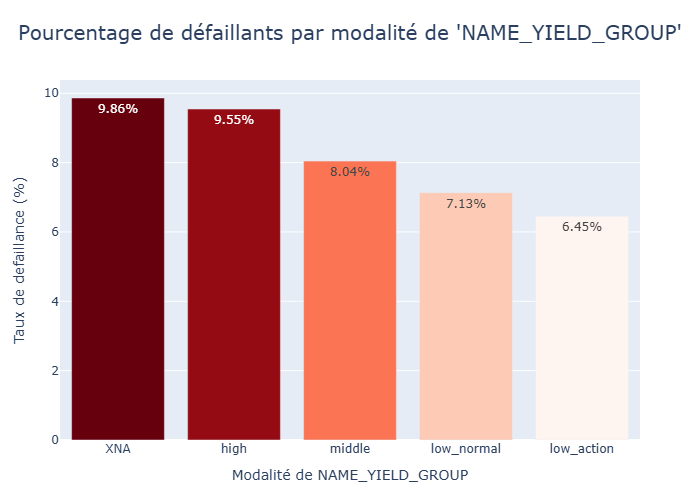

In [477]:
# Visualisation du pourcentage de prêts défaillants pour la variable de NAME_YIELD_GROUP.

plot_defaillance_rate_per_category(
    df_previous_app,
    cat_var='NAME_YIELD_GROUP',
    title_layout={"x": 0.5},
    xaxis_title = "Modalité de NAME_YIELD_GROUP",
    yaxis_title = "Taux de defaillance (%)",
    title_font_size=20
)

- Les résultats sont plutôt en accords avec ce que l'on pourrait attendre au niveau des taux d'interêts car ici plus ils sont élevés plus le taux de défaillance est important. Seule la première catégorie ne suit pas cette logique puisque l'on a pas cette information (cela pourrait être de la rétention d'information concernant des taux élevés)

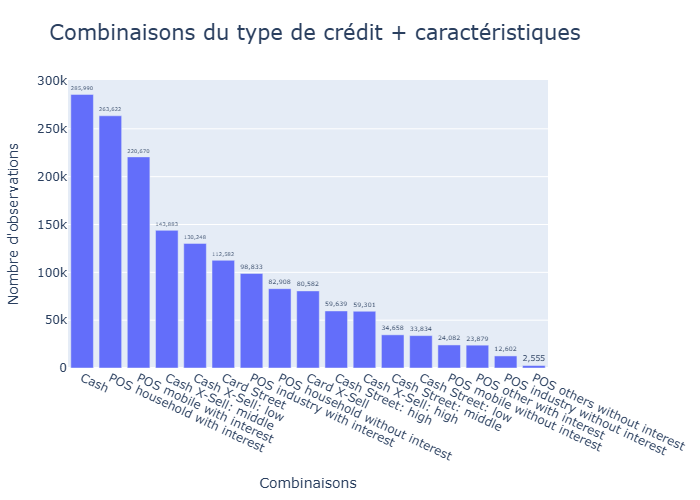

In [478]:
# Visualisation de la répartition pour la variable "PRODUCT_COMBINATION"

plot_categorical_histogram(
    df=df_previous_app,
    x="PRODUCT_COMBINATION",
    title="Combinaisons du type de crédit + caractéristiques",
    xaxis_title= 'Combinaisons',
    title_layout={"x": 0.45},
    tickangle=25,
    title_font_size=21
)

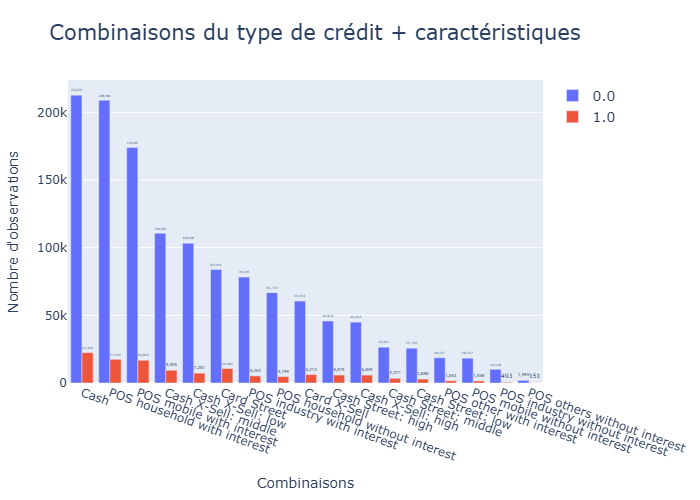

In [479]:
# Visualisation de la répartition pour la variable "PRODUCT_COMBINATION"

plot_categorical_histogram(
    df=df_previous_app,
    x="PRODUCT_COMBINATION",
    color= 'TARGET',
    title="Combinaisons du type de crédit + caractéristiques",
    title_layout={"x": 0.45},
    xaxis_title= 'Combinaisons',
    tickangle=20,
    title_font_size=21
)

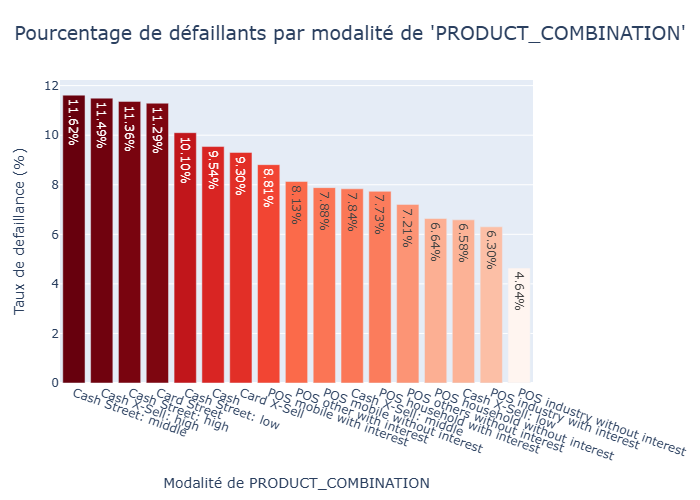

In [480]:
# Visualisation du pourcentage de prêts défaillants pour la variable de PRODUCT_COMBINATION.

plot_defaillance_rate_per_category(
    df_previous_app,
    cat_var='PRODUCT_COMBINATION',
    title_layout={"x": 0.5},
    xaxis_title = "Modalité de PRODUCT_COMBINATION",
    yaxis_title = "Taux de defaillance (%)",
    tickangle=20,
    title_font_size=19
)

- Selon les combinaisons, on retrouve des taux de défaillance plus ou moins important entre 11 % et 4 %. Globalement on peut remarquer que les catégories avec le plus de défaillance semblent être plus souvent des crédits en cash sauf exceptions, suivis des crédits POS dans la deuxième partie du graphique.
- On peut ensuite passer aux variables quantitatives:

In [481]:
df_previous_app.select_dtypes(include=['int64', 'float64']).info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1670214 entries, 0 to 1670213
Data columns (total 22 columns):
 #   Column                     Non-Null Count    Dtype  
---  ------                     --------------    -----  
 0   SK_ID_PREV                 1670214 non-null  int64  
 1   SK_ID_CURR                 1670214 non-null  int64  
 2   AMT_ANNUITY                1297979 non-null  float64
 3   AMT_APPLICATION            1670214 non-null  float64
 4   AMT_CREDIT                 1670213 non-null  float64
 5   AMT_DOWN_PAYMENT           774370 non-null   float64
 6   AMT_GOODS_PRICE            1284699 non-null  float64
 7   HOUR_APPR_PROCESS_START    1670214 non-null  int64  
 8   NFLAG_LAST_APPL_IN_DAY     1670214 non-null  int64  
 9   RATE_DOWN_PAYMENT          774370 non-null   float64
 10  RATE_INTEREST_PRIMARY      5951 non-null     float64
 11  RATE_INTEREST_PRIVILEGED   5951 non-null     float64
 12  DAYS_DECISION              1670214 non-null  int64  
 13  SELLERPLACE_

In [482]:
df_previous_app['AMT_ANNUITY'].describe().round(0)

count    1297979.0
mean       15955.0
std        14782.0
min            0.0
25%         6322.0
50%        11250.0
75%        20658.0
max       418058.0
Name: AMT_ANNUITY, dtype: float64

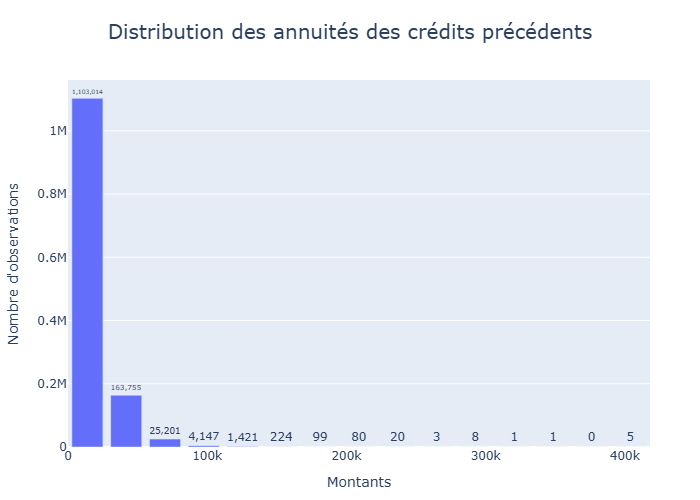

In [483]:
# Visualisation de la distribution pour la variable "AMT_ANNUITY".

plot_quantitative_histogram(
    df_previous_app,
    x='AMT_ANNUITY',
    title="Distribution des annuités des crédits précédents",
    title_layout={"x": 0.5},
    title_font_size=20,
    xaxis_title="Montants",
    yaxis_title="Nombre d'observations",
    width=1000,
    height=600
)

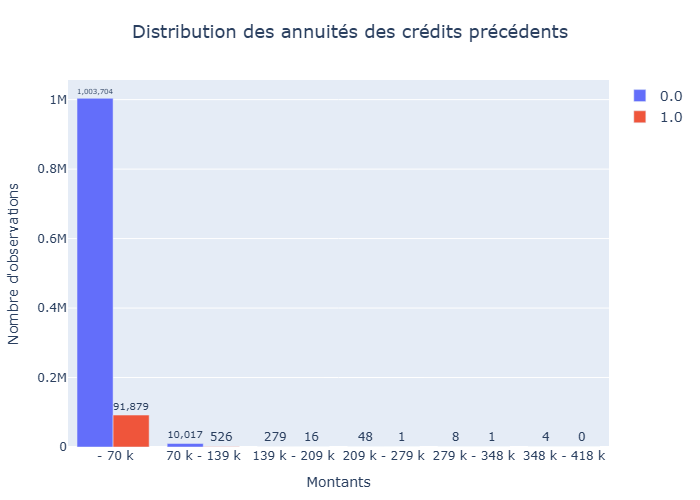

In [484]:
# Visualisation de la répartition pour la variable "AMT_ANNUITY" en fonction de la Target.

plot_quantitative_histogram(
    df_previous_app,
    x='AMT_ANNUITY',
    color='TARGET',
    nbins= 6,
    title="Distribution des annuités des crédits précédents",
    title_layout={"x": 0.5},
    title_font_size=18,
    xaxis_title="Montants",
    yaxis_title="Nombre d'observations",
    bin_as_category=True,
    width=1000,
    height=600
)

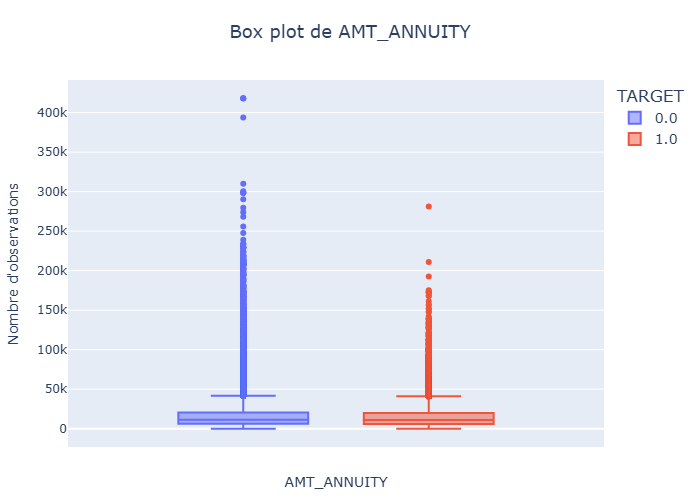

In [485]:
# Visualisation de la répartition pour la variable "AMT_ANNUITY"

plot_quantitative_box_violin(df_previous_app, 
                            x="AMT_ANNUITY",
                            plot_type="box",
                            color='TARGET',
                            width=800,
                            height=700,
                            xaxis_title="AMT_ANNUITY",
                            yaxis_title="Nombre d'observations",
                            color_map={0: "#636EFA", 1: "#EF553B"}
                            )

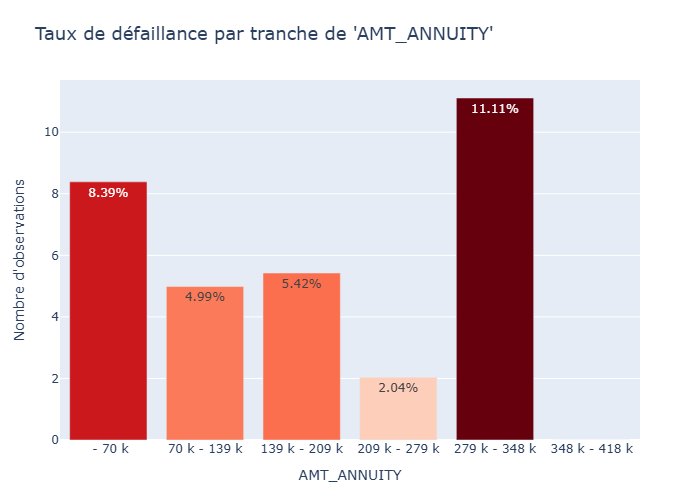

In [486]:
# Visualisation du taux de défaillance pour la variable "AMT_ANNUITY".

plot_defaillance_rate_per_quantitative(df_previous_app, 
                                       "AMT_ANNUITY",
                                       target_var="TARGET",
                                       nbins=6,
                                       width=800,
                                       height=700,
                                       xaxis_title="AMT_ANNUITY",
                                       yaxis_title="Nombre d'observations")

- Les distributions entre les deux groupes sont similaires (sauf outliers plus étendus pour les non défaillants) et il ne semble pas y avoir de corrélation importante entre la Target et les annuités payés par les clients.

In [487]:
df_previous_app['AMT_APPLICATION'].describe().round(0)

count    1670214.0
mean      175234.0
std       292780.0
min            0.0
25%        18720.0
50%        71046.0
75%       180360.0
max      6905160.0
Name: AMT_APPLICATION, dtype: float64

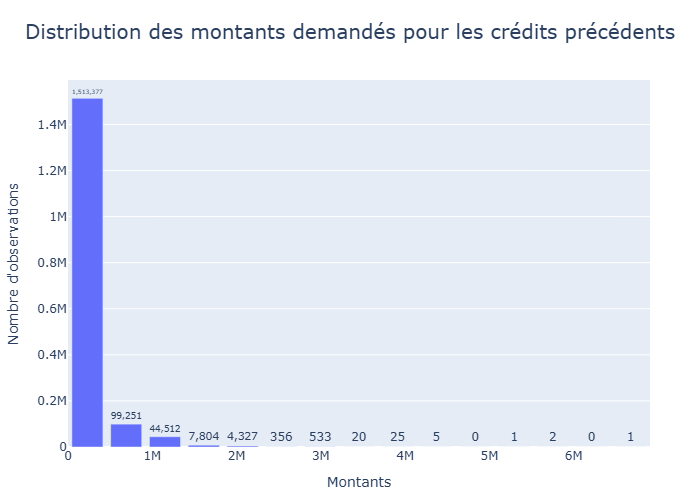

In [488]:
# Visualisation de la distribution pour la variable "AMT_APPLICATION".

plot_quantitative_histogram(
    df_previous_app,
    x='AMT_APPLICATION',
    title="Distribution des montants demandés pour les crédits précédents",
    title_layout={"x": 0.5},
    title_font_size=20,
    xaxis_title="Montants",
    yaxis_title="Nombre d'observations",
    width=1000,
    height=600
)

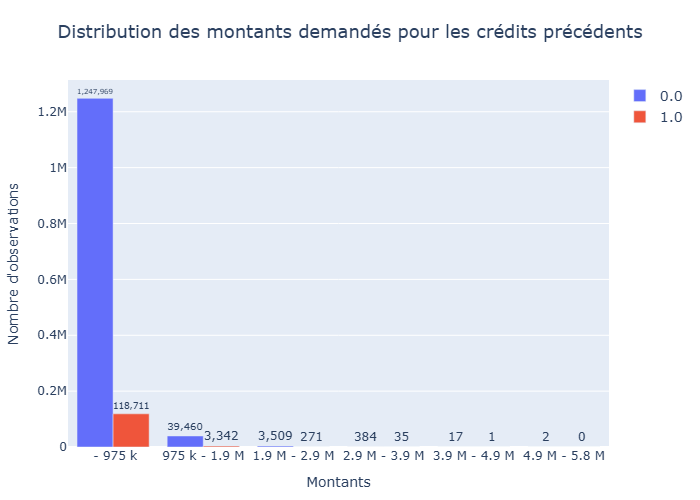

In [489]:
# Visualisation de la répartition pour la variable "AMT_APPLICATION" en fonction de la Target.


plot_quantitative_histogram(
    df_previous_app,
    x='AMT_APPLICATION',
    color='TARGET',
    nbins= 6,
    title="Distribution des montants demandés pour les crédits précédents",
    title_layout={"x": 0.5},
    title_font_size=18,
    xaxis_title="Montants",
    yaxis_title="Nombre d'observations",
    bin_as_category=True,
    width=1000,
    height=600
)

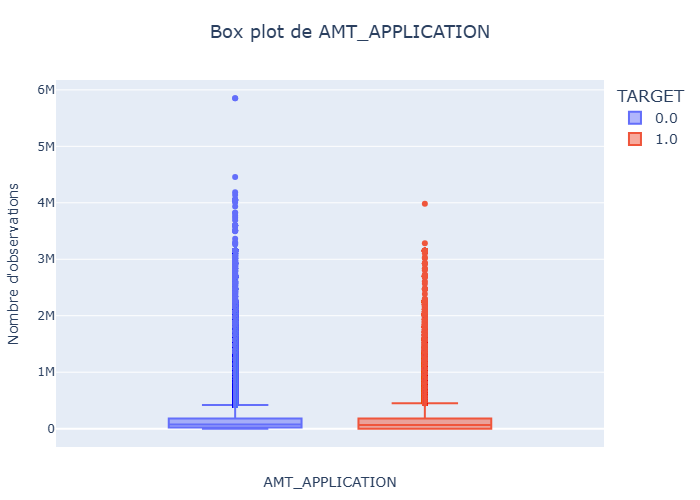

In [490]:
# Visualisation de la répartition pour la variable "AMT_APPLICATION"

plot_quantitative_box_violin(df_previous_app, 
                            x="AMT_APPLICATION",
                            plot_type="box",
                            color='TARGET',
                            width=800,
                            height=700,
                            xaxis_title="AMT_APPLICATION",
                            yaxis_title="Nombre d'observations",
                            color_map={0: "#636EFA", 1: "#EF553B"}
                            )

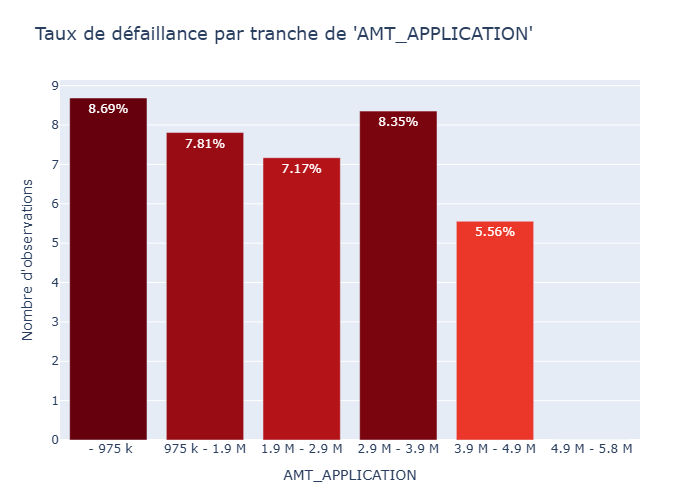

In [491]:
# Visualisation du taux de défaillance pour la variable "AMT_APPLICATION".

plot_defaillance_rate_per_quantitative(df_previous_app, 
                                       "AMT_APPLICATION",
                                       target_var="TARGET",
                                       nbins=6,
                                       width=800,
                                       height=700,
                                       xaxis_title="AMT_APPLICATION",
                                       yaxis_title="Nombre d'observations")

- Le constat est plutôt similaire à la variable précédente pour les distributions mais pour ce qui est de la corrélation avec la Target, on peut juste constater une baisse de la défaillance pour les plus hauts montants (mais il y a pas assez d'échantillon pour être sûr)

In [492]:
df_previous_app['AMT_CREDIT'].describe().round(0)

count    1670213.0
mean      196114.0
std       318575.0
min            0.0
25%        24160.0
50%        80541.0
75%       216418.0
max      6905160.0
Name: AMT_CREDIT, dtype: float64

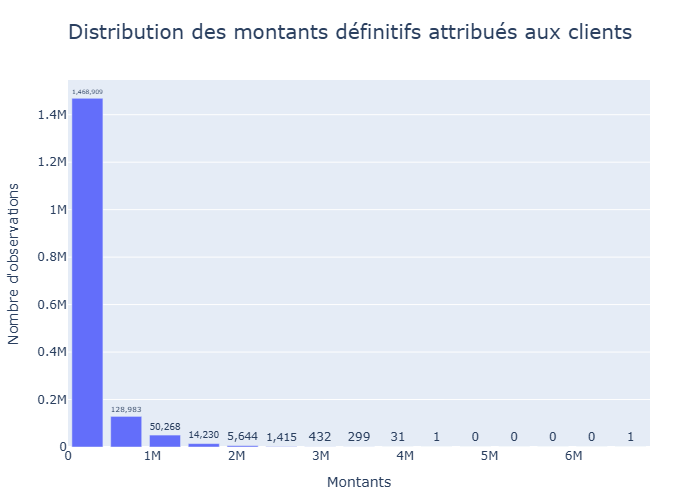

In [493]:
# Visualisation de la distribution pour la variable "AMT_CREDIT".

plot_quantitative_histogram(
    df_previous_app,
    x='AMT_CREDIT',
    title="Distribution des montants définitifs attribués aux clients",
    title_layout={"x": 0.5},
    title_font_size=20,
    xaxis_title="Montants",
    yaxis_title="Nombre d'observations",
    width=1000,
    height=600
)

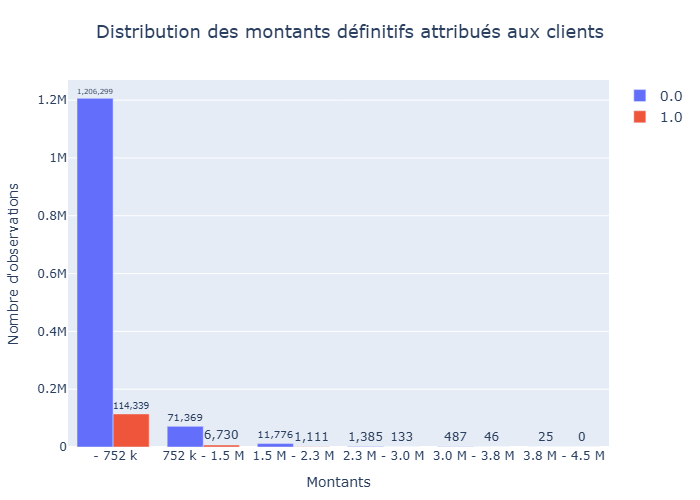

In [494]:
# Visualisation de la répartition pour la variable "AMT_CREDIT" en fonction de la Target.

plot_quantitative_histogram(
    df_previous_app,
    x='AMT_CREDIT',
    color='TARGET',
    nbins= 6,
    title="Distribution des montants définitifs attribués aux clients",
    title_layout={"x": 0.5},
    title_font_size=18,
    xaxis_title="Montants",
    yaxis_title="Nombre d'observations",
    bin_as_category=True,
    width=1000,
    height=600
)

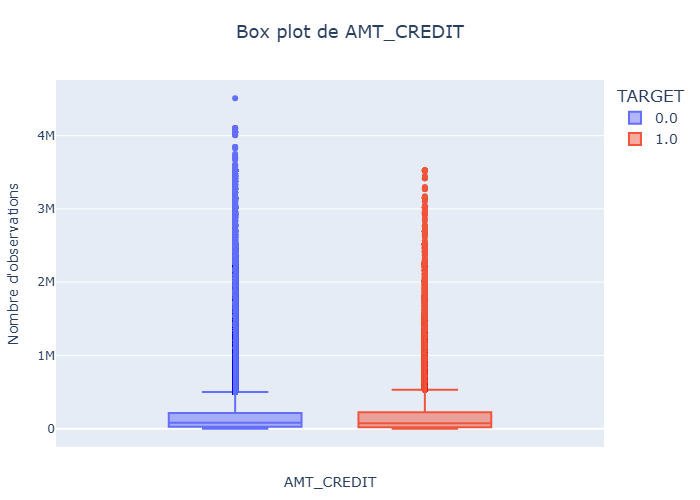

In [495]:
# Visualisation de la répartition pour la variable "AMT_CREDIT"

plot_quantitative_box_violin(df_previous_app, 
                            x="AMT_CREDIT",
                            plot_type="box",
                            color='TARGET',
                            width=800,
                            height=700,
                            xaxis_title="AMT_CREDIT",
                            yaxis_title="Nombre d'observations",
                            color_map={0: "#636EFA", 1: "#EF553B"}
                            )

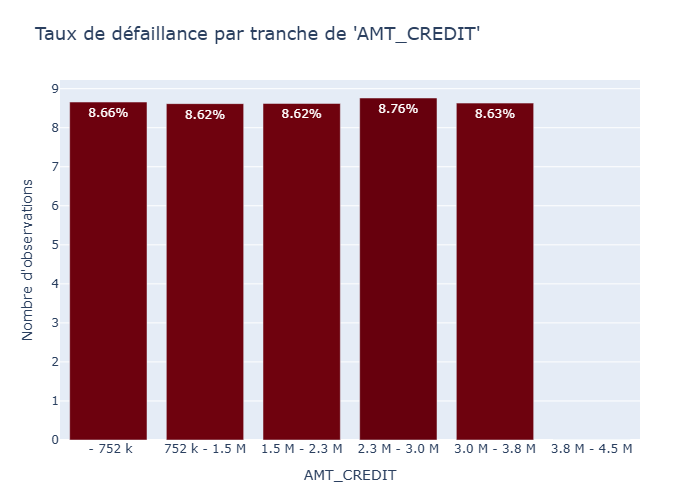

In [496]:
# Visualisation du taux de défaillance pour la variable "AMT_CREDIT".

plot_defaillance_rate_per_quantitative(df_previous_app, 
                                       "AMT_CREDIT",
                                       target_var="TARGET",
                                       nbins=6,
                                       width=800,
                                       height=700,
                                       xaxis_title="AMT_CREDIT",
                                       yaxis_title="Nombre d'observations")

- Ici les taux de défaillance sont plutôt stables quelque soit l'échelon.

In [497]:
df_previous_app['AMT_DOWN_PAYMENT'].describe().round(0)

count     774370.0
mean        6697.0
std        20921.0
min           -1.0
25%            0.0
50%         1638.0
75%         7740.0
max      3060045.0
Name: AMT_DOWN_PAYMENT, dtype: float64

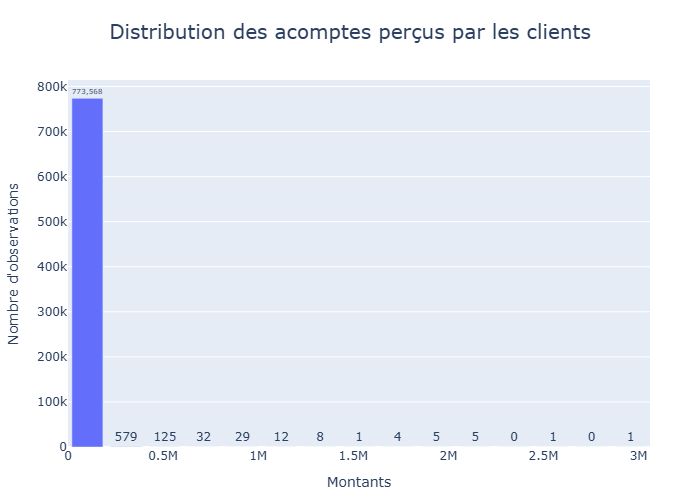

In [498]:
# Visualisation de la distribution pour la variable "AMT_DOWN_PAYMENT".

plot_quantitative_histogram(
    df_previous_app,
    x='AMT_DOWN_PAYMENT',
    title="Distribution des acomptes perçus par les clients",
    title_layout={"x": 0.5},
    title_font_size=20,
    xaxis_title="Montants",
    yaxis_title="Nombre d'observations",
    width=1000,
    height=600
)

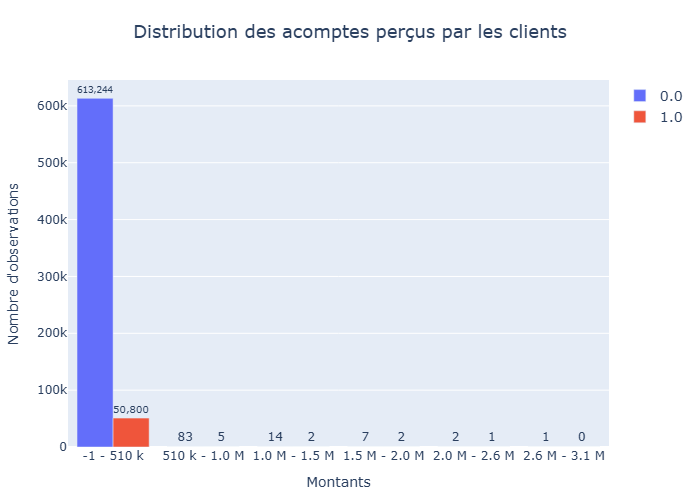

In [499]:
# Visualisation de la répartition pour la variable "AMT_DOWN_PAYMENT" en fonction de la Target.

plot_quantitative_histogram(
    df_previous_app,
    x='AMT_DOWN_PAYMENT',
    color='TARGET',
    nbins= 6,
    title="Distribution des acomptes perçus par les clients",
    title_layout={"x": 0.5},
    title_font_size=18,
    xaxis_title="Montants",
    yaxis_title="Nombre d'observations",
    bin_as_category=True,
    width=1000,
    height=600
)

c:\Users\Caomghin\anaconda3\lib\site-packages\choreographer\utils\_tmpfile.py:137: TmpDirWarning:

The temporary directory could not be deleted, execution will continue. errors: [(WindowsPath('C:/Users/Caomghin/AppData/Local/Temp/tmpru504qfa/CrashpadMetrics-active.pma'), PermissionError(13, 'Accès refusé')), (WindowsPath('C:/Users/Caomghin/AppData/Local/Temp/tmpru504qfa'), OSError(41, 'Le répertoire n’est pas vide'))]

WARNING	Thread(Thread-623) choreographer.utils._tmpfile:_tmpfile.py:clean()- Temporary dictory couldn't be removed manually.


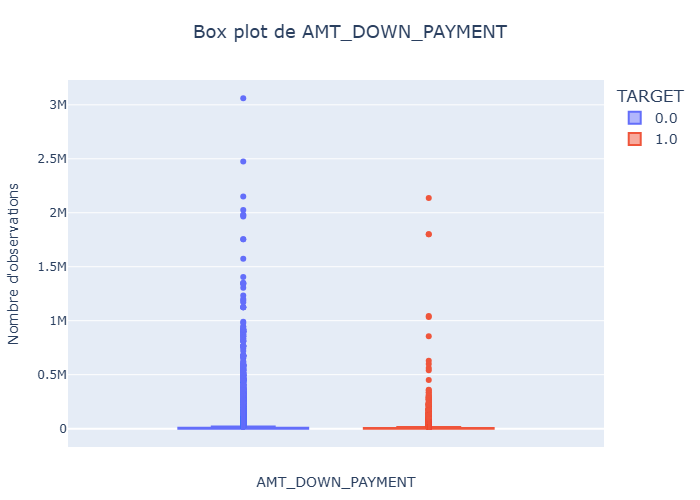

In [500]:
# Visualisation de la répartition pour la variable "AMT_DOWN_PAYMENT"

plot_quantitative_box_violin(df_previous_app, 
                            x="AMT_DOWN_PAYMENT",
                            plot_type="box",
                            color='TARGET',
                            width=800,
                            height=700,
                            xaxis_title="AMT_DOWN_PAYMENT",
                            yaxis_title="Nombre d'observations",
                            color_map={0: "#636EFA", 1: "#EF553B"}
                            )

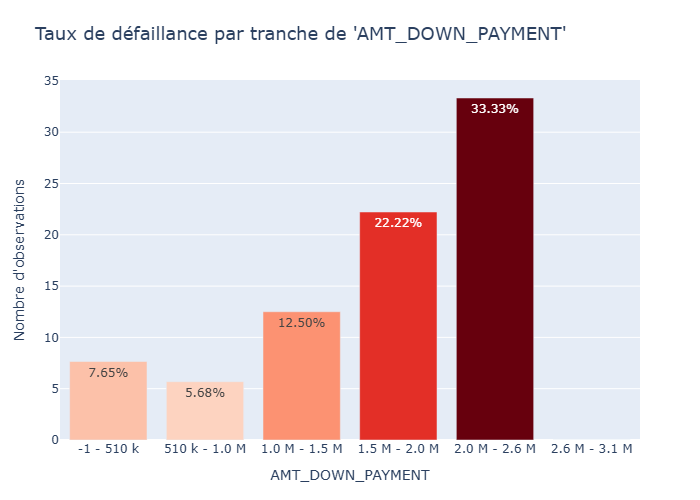

In [501]:
# Visualisation du taux de défaillance pour la variable "AMT_DOWN_PAYMENT".

plot_defaillance_rate_per_quantitative(df_previous_app, 
                                       "AMT_DOWN_PAYMENT",
                                       target_var="TARGET",
                                       nbins=6,
                                       width=800,
                                       height=700,
                                       xaxis_title="AMT_DOWN_PAYMENT",
                                       yaxis_title="Nombre d'observations")

- Comme on peut le voir avec cette variable, il y a très peu d'acomptes perçus par les clients lors des précédents crédits toutefois il semble y avoir un taux de défaillance croissant sur les grands acomptes (malgré le faible d'échantillon à ces niveaux de montants).

In [502]:
df_previous_app['AMT_GOODS_PRICE'].describe().round(0)

count    1284699.0
mean      227847.0
std       315397.0
min            0.0
25%        50841.0
50%       112320.0
75%       234000.0
max      6905160.0
Name: AMT_GOODS_PRICE, dtype: float64

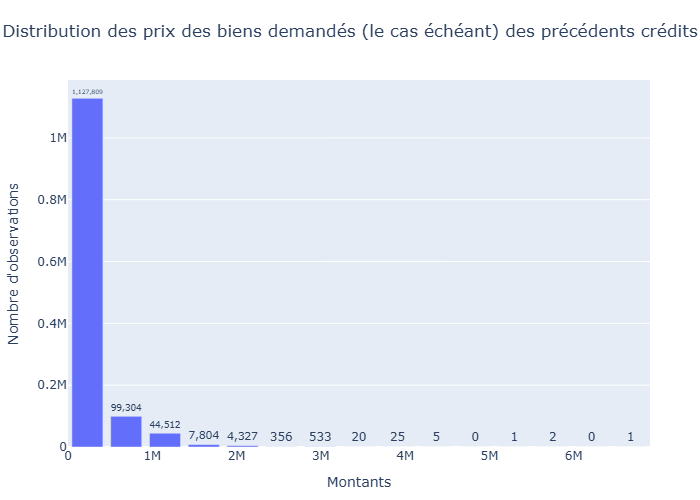

In [503]:
# Visualisation de la distribution pour la variable "AMT_GOODS_PRICE".

plot_quantitative_histogram(
    df_previous_app,
    x='AMT_GOODS_PRICE',
    title="Distribution des prix des biens demandés (le cas échéant) des précédents crédits",
    title_layout={"x": 0.5},
    title_font_size=17,
    xaxis_title="Montants",
    yaxis_title="Nombre d'observations",
    width=1000,
    height=600
)

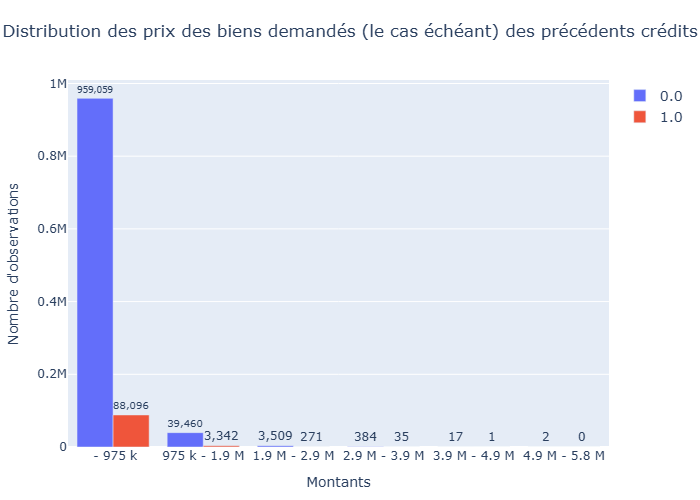

In [504]:
# Visualisation de la répartition pour la variable "AMT_GOODS_PRICE" en fonction de la Target.

plot_quantitative_histogram(
    df_previous_app,
    x='AMT_GOODS_PRICE',
    color='TARGET',
    nbins= 6,
    title="Distribution des prix des biens demandés (le cas échéant) des précédents crédits",
    title_layout={"x": 0.5},
    title_font_size=17,
    xaxis_title="Montants",
    yaxis_title="Nombre d'observations",
    bin_as_category=True,
    width=1000,
    height=600
)

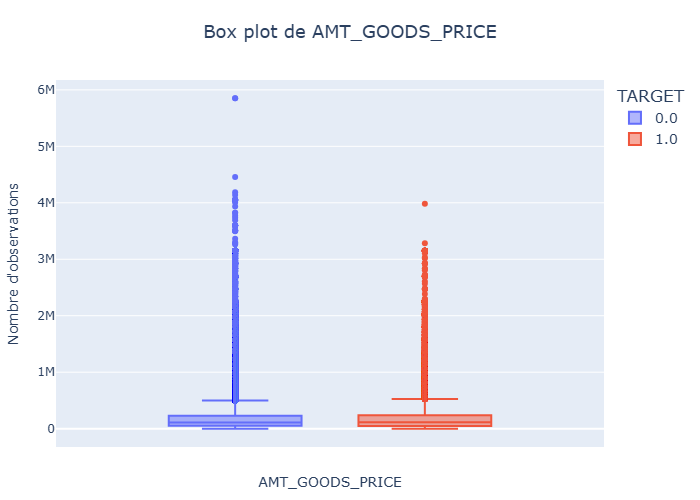

In [505]:
# Visualisation de la répartition pour la variable "AMT_GOODS_PRICE"

plot_quantitative_box_violin(df_previous_app, 
                            x="AMT_GOODS_PRICE",
                            plot_type="box",
                            color='TARGET',
                            width=800,
                            height=700,
                            xaxis_title="AMT_GOODS_PRICE",
                            yaxis_title="Nombre d'observations",
                            color_map={0: "#636EFA", 1: "#EF553B"}
                            )

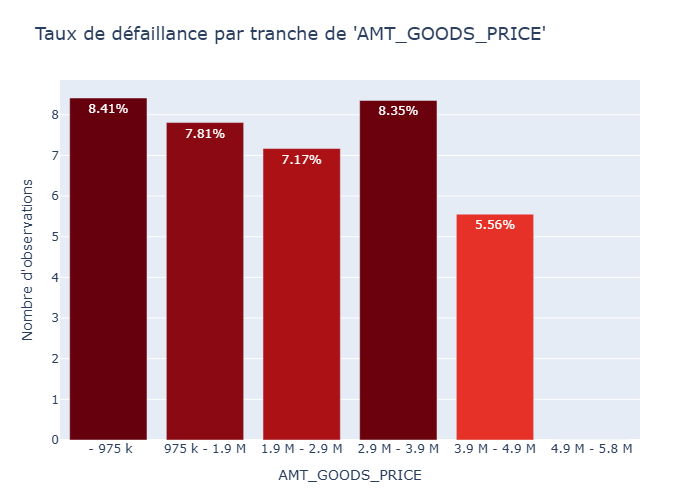

In [506]:
# Visualisation du taux de défaillance pour la variable "AMT_GOODS_PRICE".

plot_defaillance_rate_per_quantitative(df_previous_app, 
                                       "AMT_GOODS_PRICE",
                                       target_var="TARGET",
                                       nbins=6,
                                       width=800,
                                       height=700,
                                       xaxis_title="AMT_GOODS_PRICE",
                                       yaxis_title="Nombre d'observations")

- Les distributions sont similaires et les taux de défaillance varient peu lorsque les prix des biens augmentent.

In [507]:
df_previous_app['RATE_DOWN_PAYMENT'].describe().round(0)

count    774370.0
mean          0.0
std           0.0
min          -0.0
25%           0.0
50%           0.0
75%           0.0
max           1.0
Name: RATE_DOWN_PAYMENT, dtype: float64

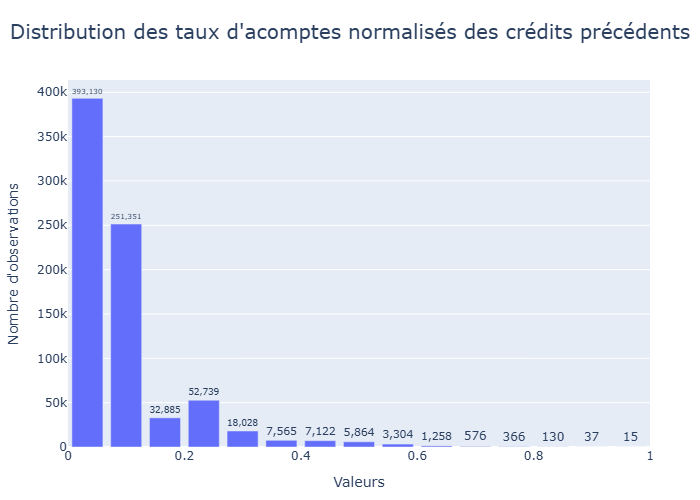

In [508]:
# Visualisation de la distribution pour la variable "RATE_DOWN_PAYMENT".

plot_quantitative_histogram(
    df_previous_app,
    x='RATE_DOWN_PAYMENT',
    title="Distribution des taux d'acomptes normalisés des crédits précédents",
    title_layout={"x": 0.5},
    title_font_size=20,
    xaxis_title="Valeurs",
    yaxis_title="Nombre d'observations",
    width=1000,
    height=600
)

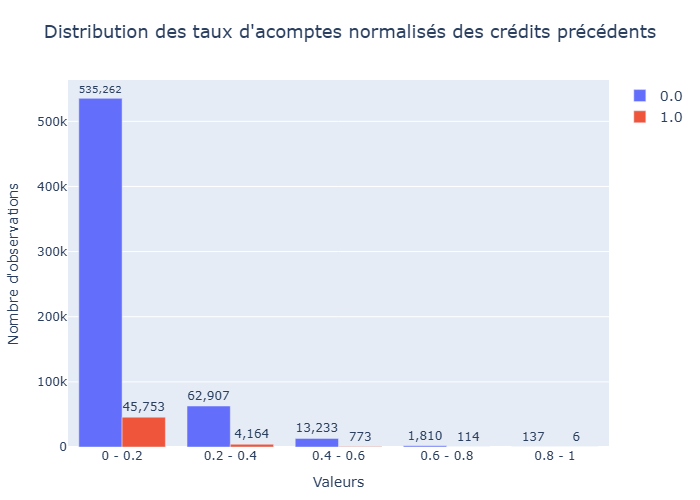

In [509]:
# Visualisation du taux de défaillance pour la variable "RATE_DOWN_PAYMENT" en fonction de la Target.

plot_quantitative_histogram(
    df_previous_app,
    x="RATE_DOWN_PAYMENT",
    color="TARGET",
    nbins=5,
    bin_as_category=True,
    bin_range=(0, 1),
    title="Distribution des taux d'acomptes normalisés des crédits précédents",
    xaxis_title="Valeurs",
    yaxis_title="Nombre d'observations",
    width=1000,
    height=600
)

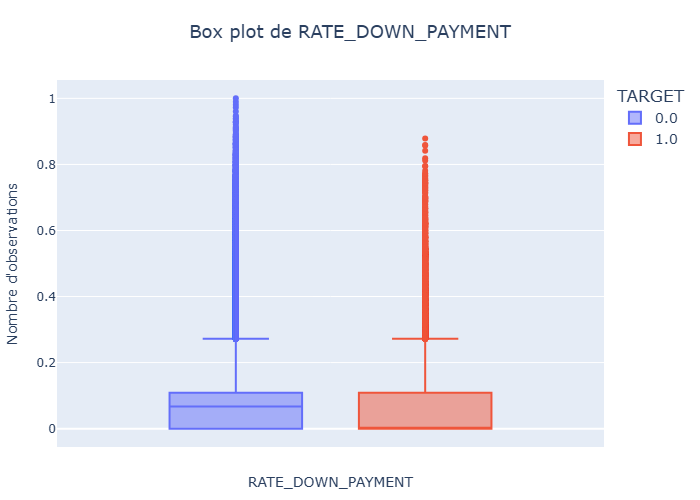

In [510]:
# Visualisation de la répartition pour la variable "RATE_DOWN_PAYMENT"

plot_quantitative_box_violin(df_previous_app, 
                            x="RATE_DOWN_PAYMENT",
                            plot_type="box",
                            color='TARGET',
                            width=800,
                            height=700,
                            xaxis_title="RATE_DOWN_PAYMENT",
                            yaxis_title="Nombre d'observations",
                            color_map={0: "#636EFA", 1: "#EF553B"}
                            )

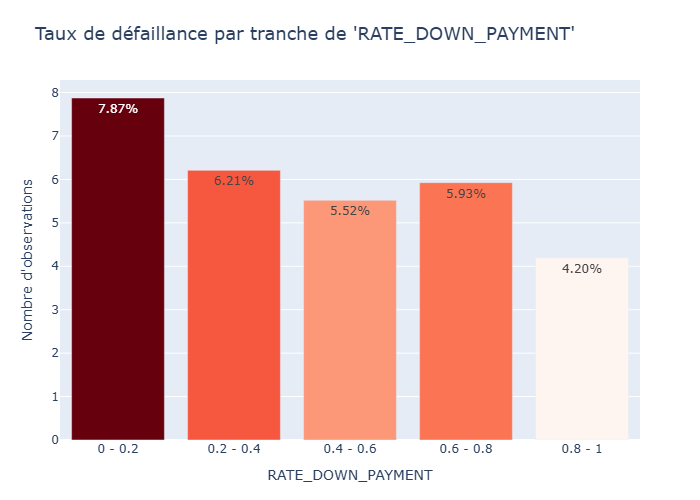

In [511]:
# Visualisation du taux de défaillance pour la variable "RATE_DOWN_PAYMENT".

plot_defaillance_rate_per_quantitative(df_previous_app, 
                                       "RATE_DOWN_PAYMENT",
                                       target_var="TARGET",
                                       nbins=5,
                                       bin_range=(0, 1),
                                       width=800,
                                       height=700,
                                       xaxis_title="RATE_DOWN_PAYMENT",
                                       yaxis_title="Nombre d'observations")

- Pour les taux d'acompte normalisés, on constate que les taux sont souvent plus faible comme on peut le voir avec la médiane proche de 0 pour le groupe de clients défaillants.
- Ce taux de défaillance semble diminuer progressivement à mesure que les taux d'acompte augmentent.

In [512]:
df_previous_app['RATE_INTEREST_PRIMARY'].describe().round(0)

count    5951.0
mean        0.0
std         0.0
min         0.0
25%         0.0
50%         0.0
75%         0.0
max         1.0
Name: RATE_INTEREST_PRIMARY, dtype: float64

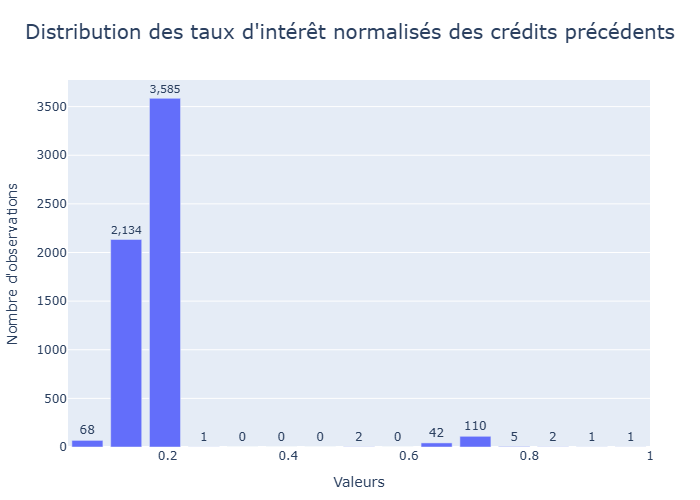

In [513]:
# Visualisation de la distribution pour la variable "AMT_ANNUITY".

plot_quantitative_histogram(
    df_previous_app,
    x='RATE_INTEREST_PRIMARY',
    title="Distribution des taux d'intérêt normalisés des crédits précédents",
    title_layout={"x": 0.5},
    title_font_size=20,
    xaxis_title="Valeurs",
    yaxis_title="Nombre d'observations",
    width=1000,
    height=600
)

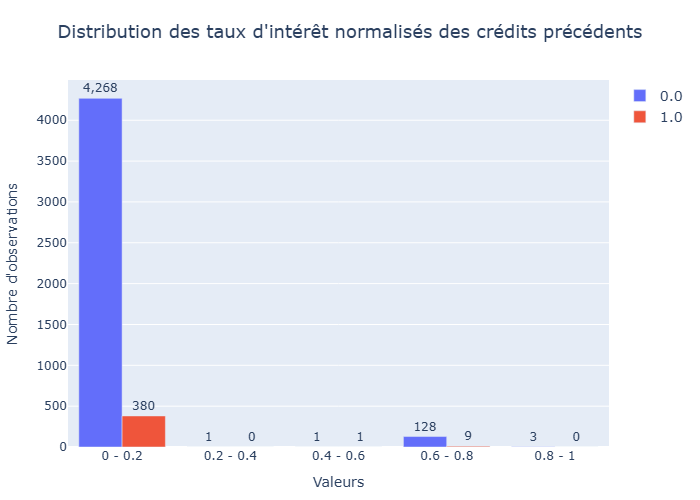

In [514]:
# Visualisation de la répartition pour la variable "RATE_INTEREST_PRIMARY" en fonction de la Target.

plot_quantitative_histogram(
    df_previous_app,
    x='RATE_INTEREST_PRIMARY',
    color='TARGET',
    nbins= 5,
    title="Distribution des taux d'intérêt normalisés des crédits précédents",
    title_layout={"x": 0.5},
    title_font_size=18,
    xaxis_title="Valeurs",
    yaxis_title="Nombre d'observations",
    bin_as_category=True,
    width=1000,
    height=600
)

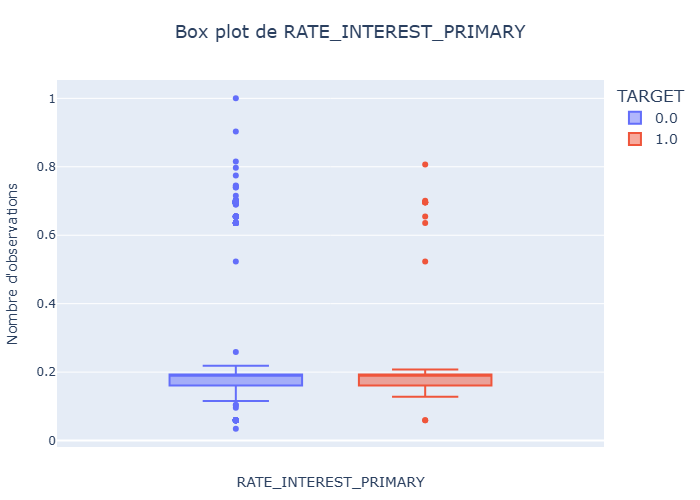

In [515]:
# Visualisation de la répartition pour la variable "RATE_INTEREST_PRIMARY"

plot_quantitative_box_violin(df_previous_app, 
                            x="RATE_INTEREST_PRIMARY",
                            plot_type="box",
                            color='TARGET',
                            width=800,
                            height=700,
                            xaxis_title="RATE_INTEREST_PRIMARY",
                            yaxis_title="Nombre d'observations",
                            color_map={0: "#636EFA", 1: "#EF553B"}
                            )

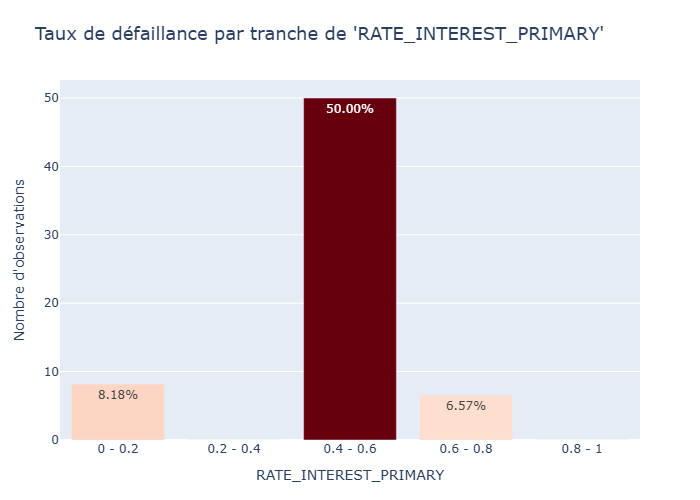

In [516]:
# Visualisation du taux de défaillance pour la variable "RATE_INTEREST_PRIMARY".

plot_defaillance_rate_per_quantitative(df_previous_app, 
                                       "RATE_INTEREST_PRIMARY",
                                       target_var="TARGET",
                                       nbins=5,
                                       width=800,
                                       height=700,
                                       xaxis_title="RATE_INTEREST_PRIMARY",
                                       yaxis_title="Nombre d'observations")

- Les distributions sont assez similaires et la corrélation entre la variable et la Target ne semble pas importante.

In [517]:
df_previous_app['RATE_INTEREST_PRIVILEGED'].describe().round(0)

count    5951.0
mean        1.0
std         0.0
min         0.0
25%         1.0
50%         1.0
75%         1.0
max         1.0
Name: RATE_INTEREST_PRIVILEGED, dtype: float64

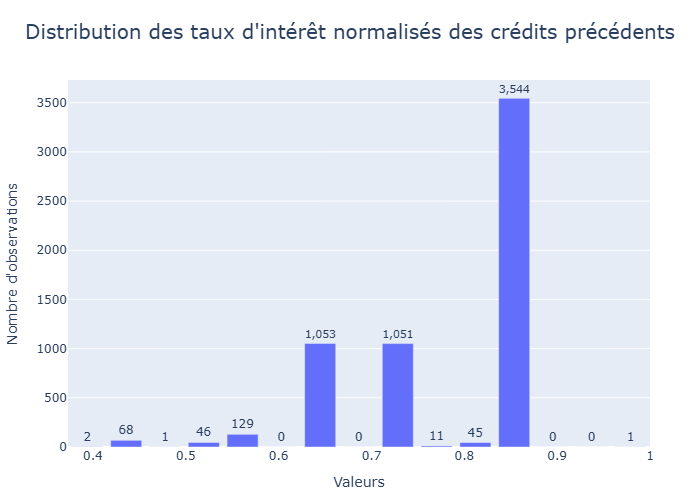

In [518]:
# Visualisation de la distribution pour la variable "RATE_INTEREST_PRIVILEGED".

plot_quantitative_histogram(
    df_previous_app,
    x='RATE_INTEREST_PRIVILEGED',
    title="Distribution des taux d'intérêt normalisés des crédits précédents",
    title_layout={"x": 0.5},
    title_font_size=20,
    xaxis_title="Valeurs",
    yaxis_title="Nombre d'observations",
    width=1000,
    height=600
)

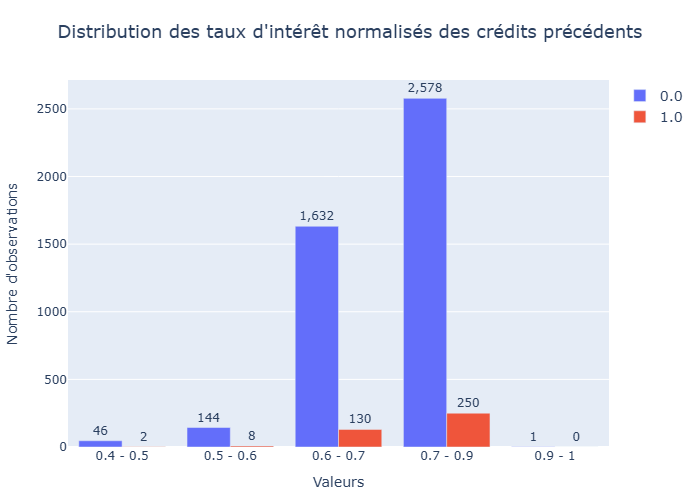

In [519]:
# Visualisation de la répartition pour la variable "RATE_INTEREST_PRIVILEGED" en fonction de la Target.

plot_quantitative_histogram(
    df_previous_app,
    x='RATE_INTEREST_PRIVILEGED',
    color='TARGET',
    nbins= 5,
    title="Distribution des taux d'intérêt normalisés des crédits précédents",
    title_layout={"x": 0.5},
    title_font_size=18,
    xaxis_title="Valeurs",
    yaxis_title="Nombre d'observations",
    bin_as_category=True,
    width=1000,
    height=600
)

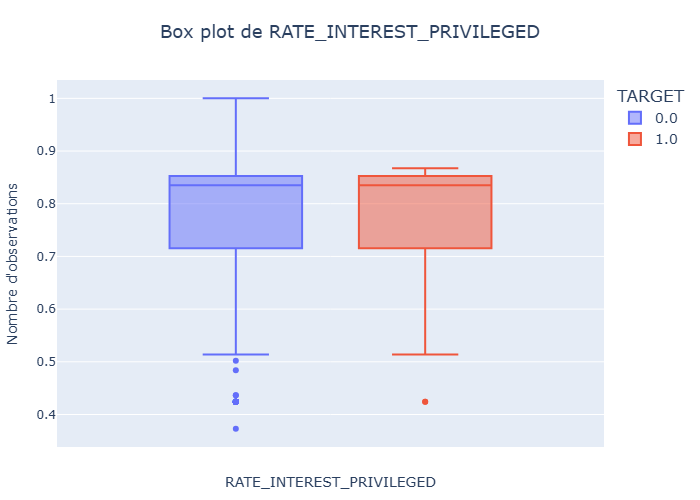

In [520]:
# Visualisation de la répartition pour la variable "RATE_INTEREST_PRIVILEGED"

plot_quantitative_box_violin(df_previous_app, 
                            x="RATE_INTEREST_PRIVILEGED",
                            plot_type="box",
                            color='TARGET',
                            width=800,
                            height=700,
                            xaxis_title="RATE_INTEREST_PRIVILEGED",
                            yaxis_title="Nombre d'observations",
                            color_map={0: "#636EFA", 1: "#EF553B"}
                            )

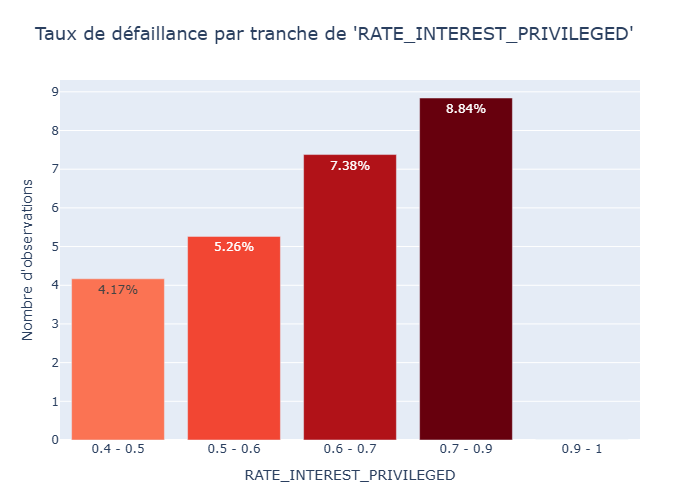

In [521]:
# Visualisation du taux de défaillance pour la variable "RATE_INTEREST_PRIVILEGED".

plot_defaillance_rate_per_quantitative(df_previous_app, 
                                       "RATE_INTEREST_PRIVILEGED",
                                       target_var="TARGET",
                                       nbins=5,
                                       width=800,
                                       height=700,
                                       xaxis_title="RATE_INTEREST_PRIVILEGED",
                                       yaxis_title="Nombre d'observations")

- Pour cette variable, il semble cette fois y avoir une plus grande corrélation entre les taux d'intérêts et la Target.

In [522]:
df_previous_app['DAYS_DECISION'].describe().round(0)

count    1670214.0
mean        -881.0
std          779.0
min        -2922.0
25%        -1300.0
50%         -581.0
75%         -280.0
max           -1.0
Name: DAYS_DECISION, dtype: float64

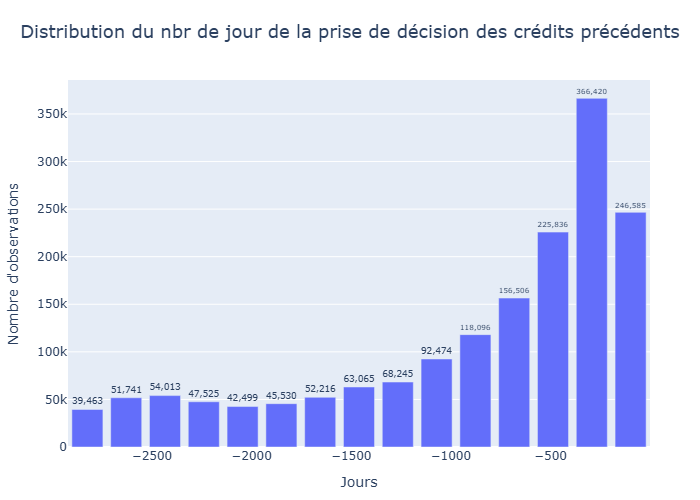

In [523]:
# Visualisation de la distribution pour la variable "DAYS_DECISION".

plot_quantitative_histogram(
    df_previous_app,
    x='DAYS_DECISION',
    title="Distribution du nbr de jour de la prise de décision des crédits précédents",
    title_layout={"x": 0.5},
    title_font_size=18,
    xaxis_title="Jours",
    yaxis_title="Nombre d'observations",
    width=1000,
    height=600
)

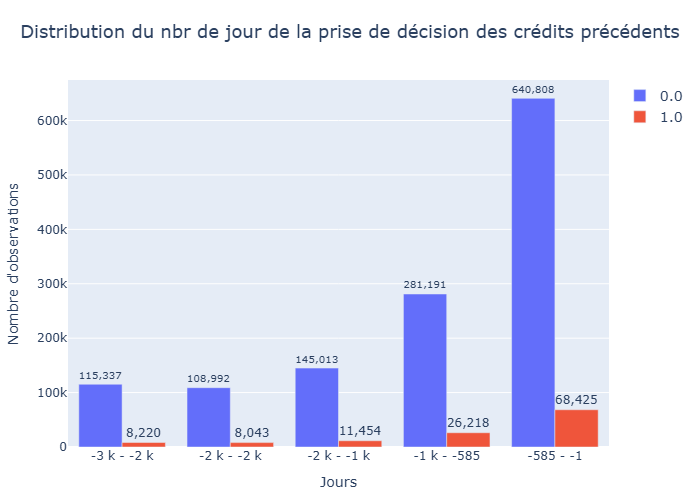

In [524]:
# Visualisation de la répartition pour la variable "DAYS_DECISION" en fonction de la Target.

plot_quantitative_histogram(
    df_previous_app,
    x='DAYS_DECISION',
    color='TARGET',
    nbins= 5,
    title="Distribution du nbr de jour de la prise de décision des crédits précédents",
    title_layout={"x": 0.5},
    title_font_size=18,
    xaxis_title="Jours",
    yaxis_title="Nombre d'observations",
    bin_as_category=True,
    width=1000,
    height=600
)

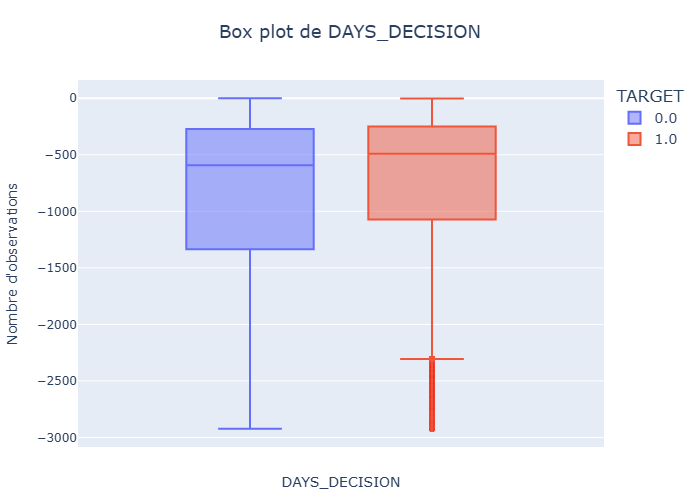

In [525]:
# Visualisation de la répartition pour la variable "DAYS_DECISION"

plot_quantitative_box_violin(df_previous_app, 
                            x="DAYS_DECISION",
                            plot_type="box",
                            color='TARGET',
                            width=800,
                            height=700,
                            xaxis_title="DAYS_DECISION",
                            yaxis_title="Nombre d'observations",
                            color_map={0: "#636EFA", 1: "#EF553B"}
                            )

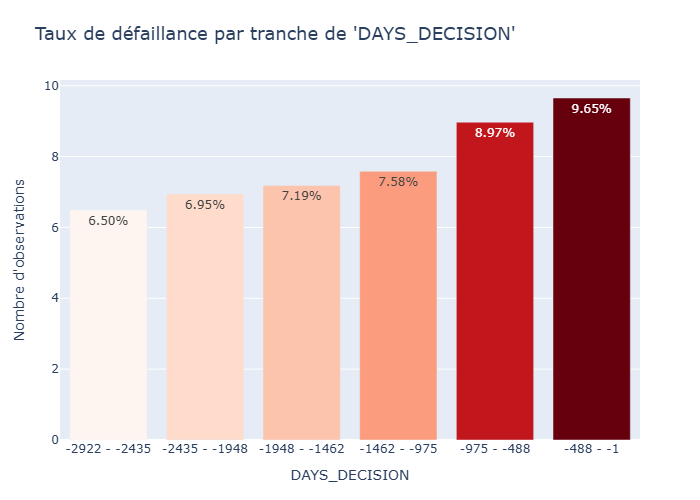

In [526]:
# Visualisation du taux de défaillance pour la variable "DAYS_DECISION".

plot_defaillance_rate_per_quantitative(df_previous_app, 
                                       "DAYS_DECISION",
                                       target_var="TARGET",
                                       nbins=6,
                                       width=800,
                                       height=700,
                                       xaxis_title="DAYS_DECISION",
                                       yaxis_title="Nombre d'observations")

- Si l'on regarde les distributions des deux groupes, on peut voir que les clients défaillants ont souvent une réponse plus récente que l'autre groupe.
- De plus, la corrélation entre la Target et cette variable semble être intéressante à prendre en compte comme on peut le voir juste au dessus.

In [527]:
df_previous_app['SELLERPLACE_AREA'].describe().round(0)

count    1670214.0
mean         314.0
std         7127.0
min           -1.0
25%           -1.0
50%            3.0
75%           82.0
max      4000000.0
Name: SELLERPLACE_AREA, dtype: float64

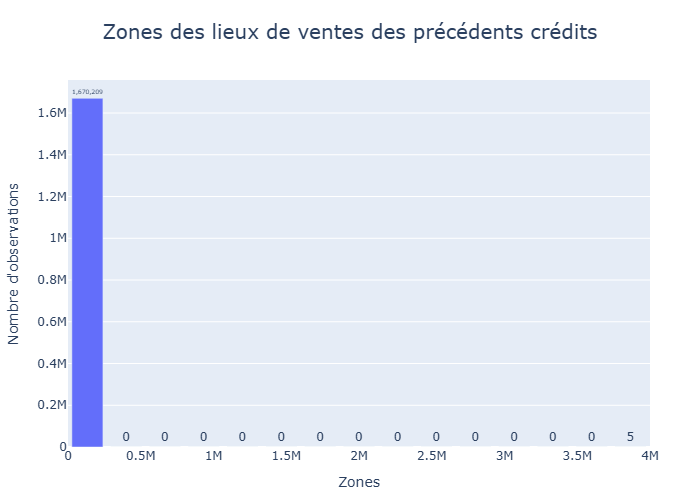

In [528]:
# Visualisation de la distribution pour la variable "SELLERPLACE_AREA".

plot_quantitative_histogram(
    df_previous_app,
    x='SELLERPLACE_AREA',
    title="Zones des lieux de ventes des précédents crédits",
    title_layout={"x": 0.5},
    title_font_size=20,
    xaxis_title="Zones",
    yaxis_title="Nombre d'observations",
    width=1000,
    height=600
)

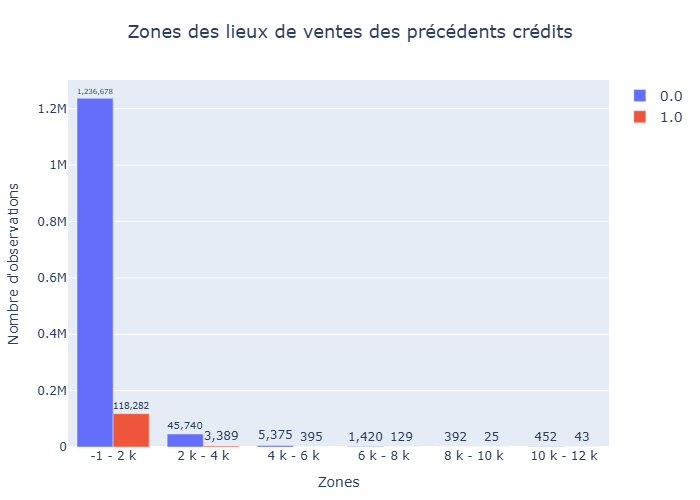

In [529]:
# Visualisation de la répartition pour la variable "SELLERPLACE_AREA" en fonction de la Target.

plot_quantitative_histogram(
    df_previous_app,
    x='SELLERPLACE_AREA',
    color='TARGET',
    nbins= 6,
    title="Zones des lieux de ventes des précédents crédits",
    title_layout={"x": 0.5},
    title_font_size=18,
    xaxis_title="Zones",
    yaxis_title="Nombre d'observations",
    bin_as_category=True,
    max_quantile=0.999,
    width=1000,
    height=600
)

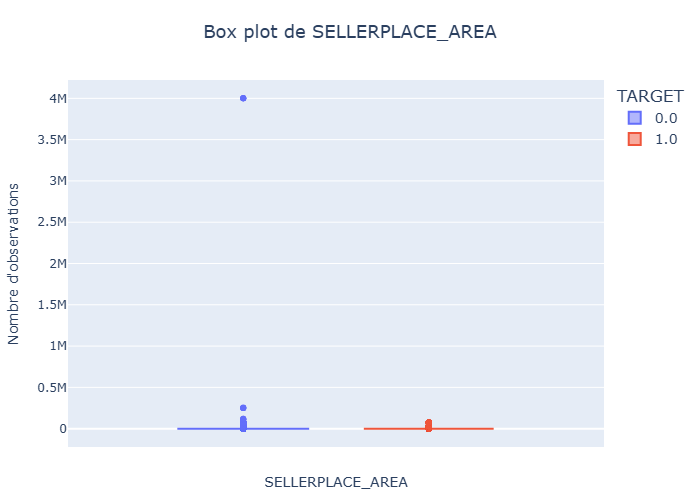

In [530]:
# Visualisation de la répartition pour la variable "SELLERPLACE_AREA"

plot_quantitative_box_violin(df_previous_app, 
                            x="SELLERPLACE_AREA",
                            plot_type="box",
                            color='TARGET',
                            width=800,
                            height=700,
                            xaxis_title="SELLERPLACE_AREA",
                            yaxis_title="Nombre d'observations",
                            color_map={0: "#636EFA", 1: "#EF553B"}
                            )

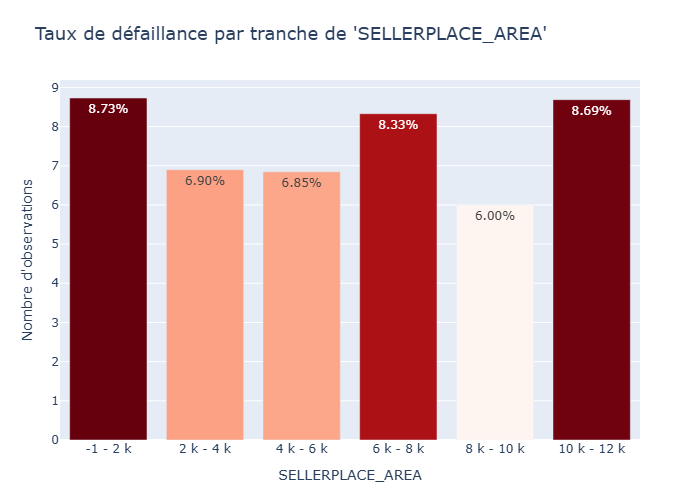

In [531]:
# Visualisation du taux de défaillance pour la variable "SELLERPLACE_AREA".

plot_defaillance_rate_per_quantitative(df_previous_app, 
                                       "SELLERPLACE_AREA",
                                       target_var="TARGET",
                                       nbins=6,
                                       width=800,
                                       height=700,
                                       xaxis_title="SELLERPLACE_AREA",
                                       max_quantile=0.999,
                                       yaxis_title="Nombre d'observations")

- Cette variable semble peu intéressant par rapport à la Target puisqu'elle est assez difficile à interpréter en l'état.

In [532]:
df_previous_app['CNT_PAYMENT'].describe().round(0)

count    1297984.0
mean          16.0
std           15.0
min            0.0
25%            6.0
50%           12.0
75%           24.0
max           84.0
Name: CNT_PAYMENT, dtype: float64

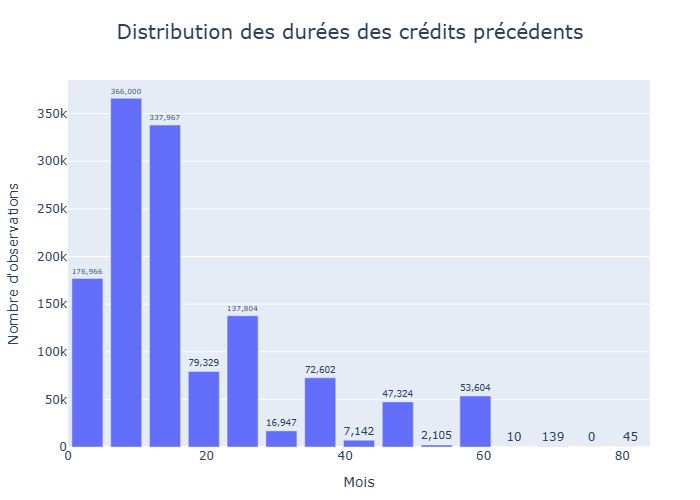

In [533]:
# Visualisation de la distribution pour la variable "CNT_PAYMENT".

plot_quantitative_histogram(
    df_previous_app,
    x='CNT_PAYMENT',
    title="Distribution des durées des crédits précédents",
    title_layout={"x": 0.5},
    title_font_size=20,
    xaxis_title="Mois",
    yaxis_title="Nombre d'observations",
    width=1000,
    height=600
)

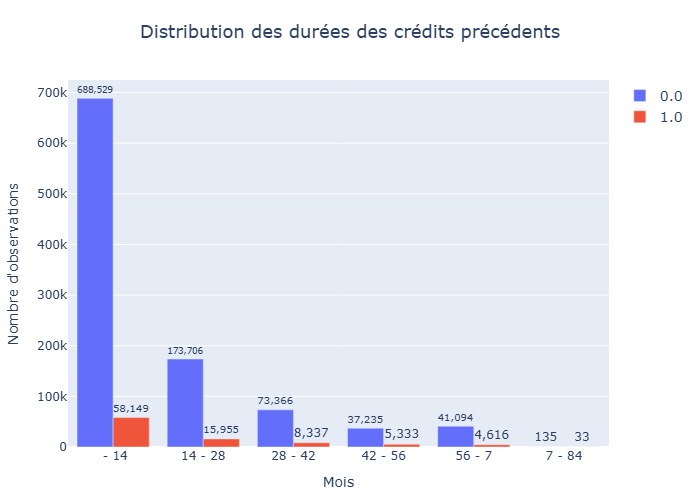

In [534]:
# Visualisation de la répartition pour la variable "CNT_PAYMENT" en fonction de la Target.

plot_quantitative_histogram(
    df_previous_app,
    x='CNT_PAYMENT',
    color='TARGET',
    nbins= 6,
    title="Distribution des durées des crédits précédents",
    title_layout={"x": 0.5},
    title_font_size=18,
    xaxis_title="Mois",
    yaxis_title="Nombre d'observations",
    bin_as_category=True,
    width=1000,
    height=600
)

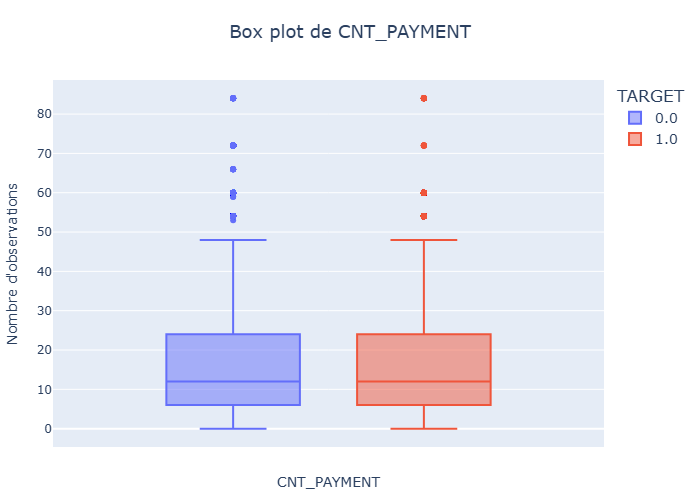

In [535]:
# Visualisation de la répartition pour la variable "CNT_PAYMENT"

plot_quantitative_box_violin(df_previous_app, 
                            x="CNT_PAYMENT",
                            plot_type="box",
                            color='TARGET',
                            width=800,
                            height=700,
                            xaxis_title="CNT_PAYMENT",
                            yaxis_title="Nombre d'observations",
                            color_map={0: "#636EFA", 1: "#EF553B"}
                            )

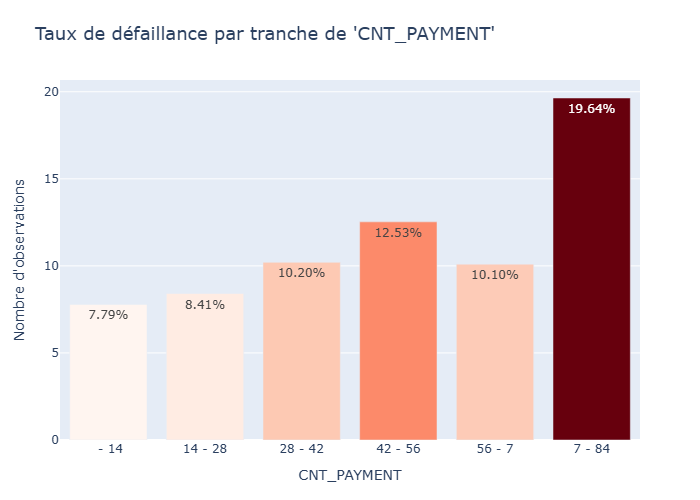

In [536]:
# Visualisation du taux de défaillance pour la variable "CNT_PAYMENT".

plot_defaillance_rate_per_quantitative(df_previous_app, 
                                       "CNT_PAYMENT",
                                       target_var="TARGET",
                                       nbins=6,
                                       width=800,
                                       height=700,
                                       xaxis_title="CNT_PAYMENT",
                                       yaxis_title="Nombre d'observations")

- Pour la durée des crédit, les distributions semblent assez similaires entre les deux groupes cependant la corrélation avec la variable est intéressante puisque le taux de défaillance semble augmenter avec la durée.

In [537]:
df_previous_app['DAYS_FIRST_DRAWING'].describe().round(0)

count    997149.0
mean     342210.0
std       88916.0
min       -2922.0
25%      365243.0
50%      365243.0
75%      365243.0
max      365243.0
Name: DAYS_FIRST_DRAWING, dtype: float64

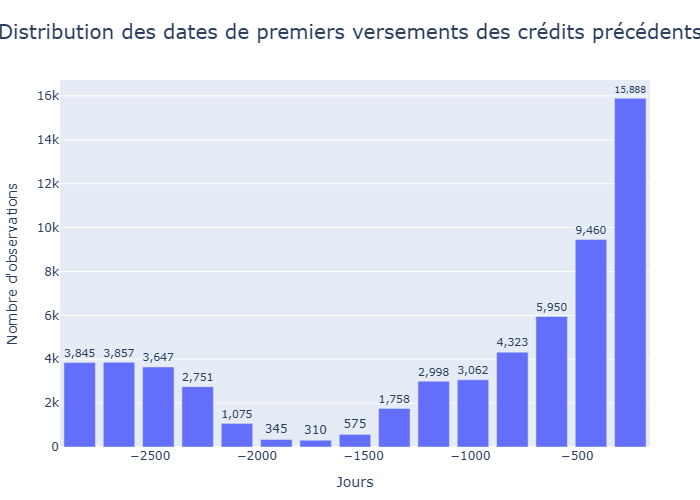

In [538]:
# Visualisation de la distribution pour la variable "DAYS_FIRST_DRAWING".

plot_quantitative_histogram(
    df_previous_app,
    x='DAYS_FIRST_DRAWING',
    title="Distribution des dates de premiers versements des crédits précédents",
    title_layout={"x": 0.5},
    title_font_size=20,
    xaxis_title="Jours",
    yaxis_title="Nombre d'observations",
    max_quantile=0.06,
    width=1000,
    height=600
)

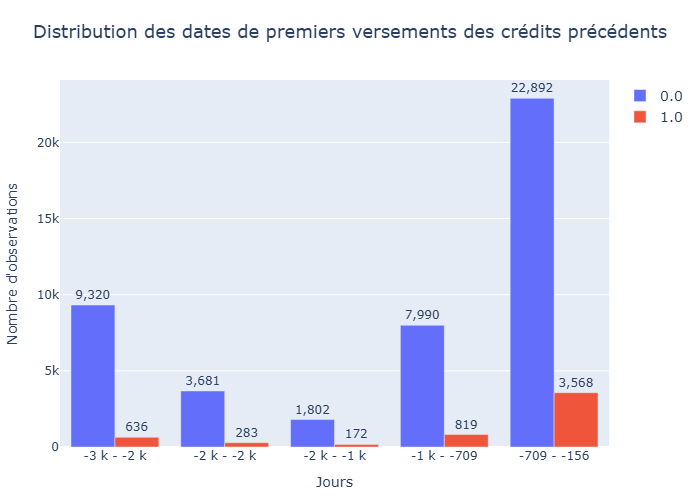

In [539]:
# Visualisation de la répartition pour la variable "DAYS_FIRST_DRAWING" en fonction de la Target.

plot_quantitative_histogram(
    df_previous_app,
    x='DAYS_FIRST_DRAWING',
    color='TARGET',
    nbins= 5,
    title="Distribution des dates de premiers versements des crédits précédents",
    title_layout={"x": 0.5},
    title_font_size=18,
    xaxis_title="Jours",
    yaxis_title="Nombre d'observations",
    max_quantile=0.06,
    bin_as_category=True,
    width=1000,
    height=600
)


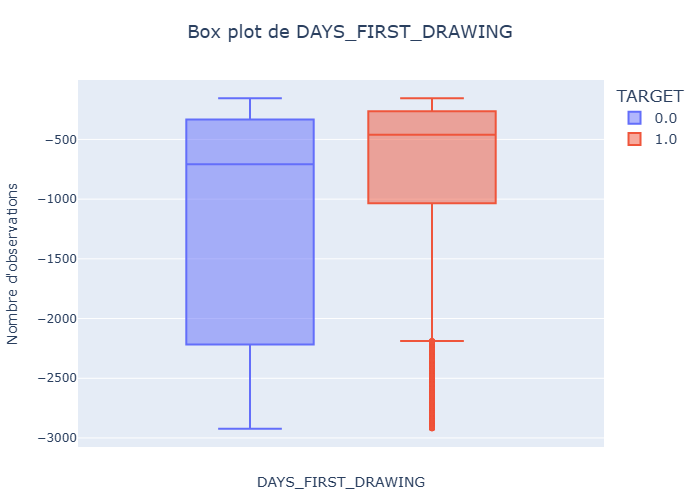

In [540]:
# Visualisation de la répartition pour la variable "DAYS_FIRST_DRAWING"

plot_quantitative_box_violin(df_previous_app, 
                            x="DAYS_FIRST_DRAWING",
                            plot_type="box",
                            color='TARGET',
                            width=800,
                            height=700,
                            xaxis_title="DAYS_FIRST_DRAWING",
                            yaxis_title="Nombre d'observations",
                            max_quantile=0.06,
                            color_map={0: "#636EFA", 1: "#EF553B"}
                            )

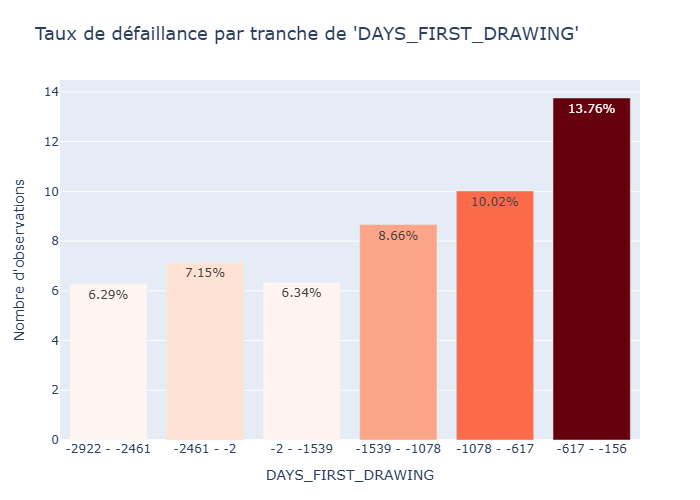

In [541]:
# Visualisation du taux de défaillance pour la variable "DAYS_FIRST_DRAWING".

plot_defaillance_rate_per_quantitative(df_previous_app, 
                                       "DAYS_FIRST_DRAWING",
                                       target_var="TARGET",
                                       nbins=6,
                                       width=800,
                                       height=700,
                                       max_quantile=0.06,
                                       xaxis_title="DAYS_FIRST_DRAWING",
                                       yaxis_title="Nombre d'observations")

- Pour cette variable il y a un nombre très important de valeurs aberrante, ce qui nous laisse un échantillon très réduit.
- On constate pour les valeurs restantes que le groupe défaillant perçoit son premier versement plus récemment que l'autre groupe. De plus il semble y avoir une corrélation intéressante comme on peut le voir au dessus.

In [542]:
df_previous_app['DAYS_FIRST_DUE'].describe().round(0)

count    997149.0
mean      13826.0
std       72445.0
min       -2892.0
25%       -1628.0
50%        -831.0
75%        -411.0
max      365243.0
Name: DAYS_FIRST_DUE, dtype: float64

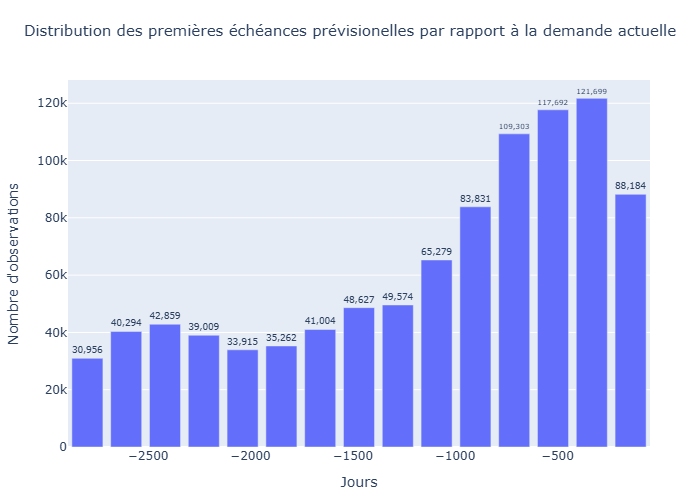

In [543]:
# Visualisation de la distribution pour la variable "DAYS_FIRST_DUE".

plot_quantitative_histogram(
    df_previous_app,
    x='DAYS_FIRST_DUE',
    title="Distribution des premières échéances prévisionelles par rapport à la demande actuelle",
    title_layout={"x": 0.5},
    title_font_size=15,
    xaxis_title="Jours",
    yaxis_title="Nombre d'observations",
    max_quantile=0.95,
    width=1000,
    height=600
)

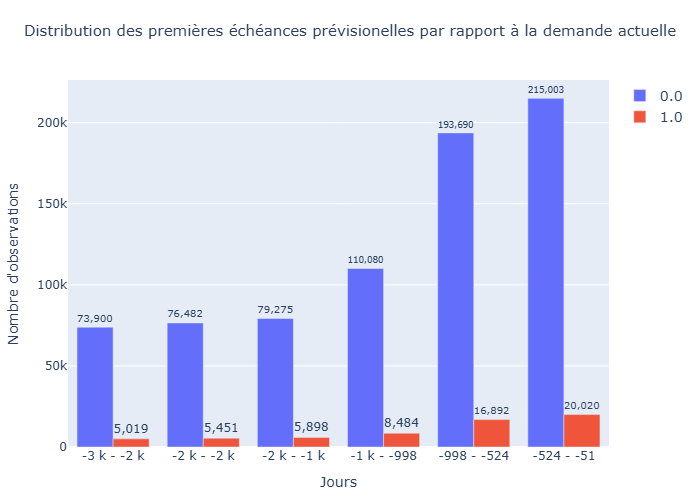

In [544]:
# Visualisation de la répartition pour la variable "DAYS_FIRST_DUE" en fonction de la Target.

plot_quantitative_histogram(
    df_previous_app,
    x='DAYS_FIRST_DUE',
    color='TARGET',
    nbins= 6,
    title="Distribution des premières échéances prévisionelles par rapport à la demande actuelle",
    title_layout={"x": 0.5},
    title_font_size=15,
    xaxis_title="Jours",
    yaxis_title="Nombre d'observations",
    max_quantile=0.95,
    bin_as_category=True,
    width=1000,
    height=600
)

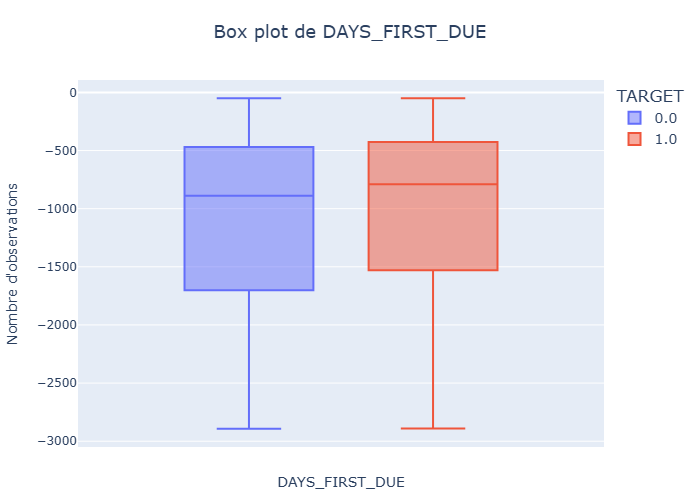

In [545]:
# Visualisation de la répartition pour la variable "DAYS_FIRST_DUE"

plot_quantitative_box_violin(df_previous_app, 
                            x="DAYS_FIRST_DUE",
                            plot_type="box",
                            color='TARGET',
                            width=800,
                            height=700,
                            xaxis_title="DAYS_FIRST_DUE",
                            yaxis_title="Nombre d'observations",
                            max_quantile=0.95,
                            color_map={0: "#636EFA", 1: "#EF553B"}
                            )

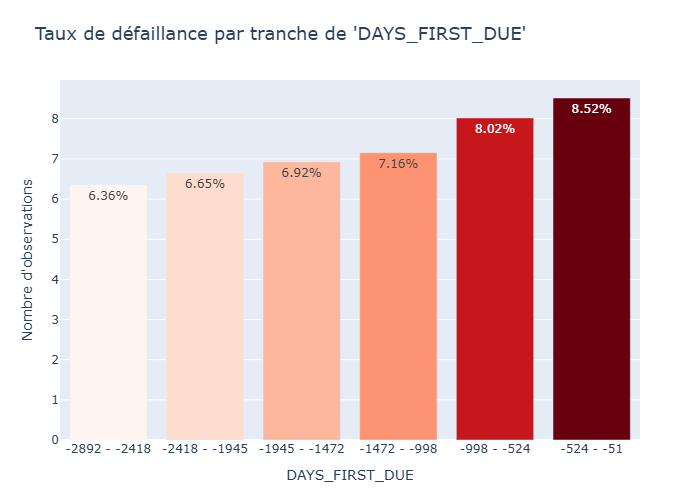

In [546]:
# Visualisation du taux de défaillance pour la variable "DAYS_FIRST_DUE".

plot_defaillance_rate_per_quantitative(df_previous_app, 
                                       "DAYS_FIRST_DUE",
                                       target_var="TARGET",
                                       nbins=6,
                                       width=800,
                                       height=700,
                                       xaxis_title="DAYS_FIRST_DUE",
                                       max_quantile=0.95,
                                       yaxis_title="Nombre d'observations")

 - Même constat que la variable précédente même si ici on a beaucoup moins de valeurs aberrantes.

In [547]:
df_previous_app['DAYS_LAST_DUE'].describe().round(0)

count    997149.0
mean      76582.0
std      149647.0
min       -2889.0
25%       -1314.0
50%        -537.0
75%         -74.0
max      365243.0
Name: DAYS_LAST_DUE, dtype: float64

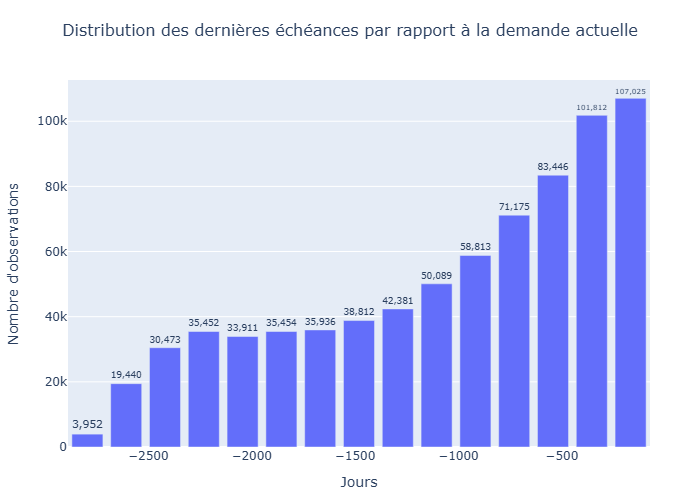

In [548]:
# Visualisation de la distribution pour la variable "DAYS_LAST_DUE".

plot_quantitative_histogram(
    df_previous_app,
    x='DAYS_LAST_DUE',
    title="Distribution des dernières échéances par rapport à la demande actuelle",
    title_layout={"x": 0.5},
    title_font_size=16,
    xaxis_title="Jours",
    yaxis_title="Nombre d'observations",
    max_quantile=0.75,
    width=1000,
    height=600
)

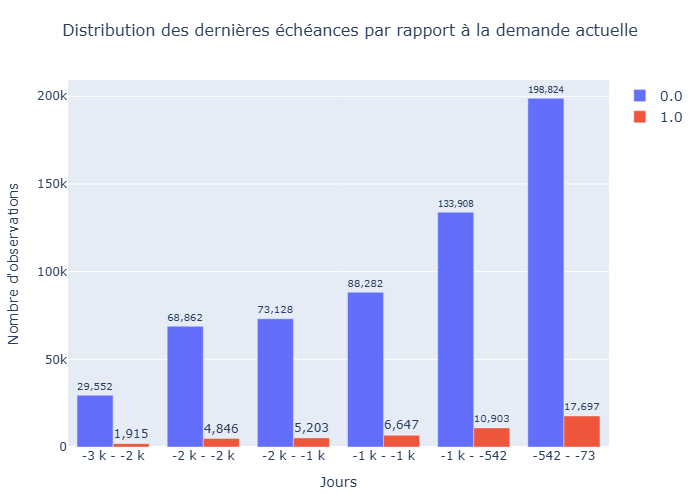

In [549]:
# Visualisation de la répartition pour la variable "DAYS_LAST_DUE" en fonction de la Target.

plot_quantitative_histogram(
    df_previous_app,
    x='DAYS_LAST_DUE',
    color='TARGET',
    nbins= 6,
    title="Distribution des dernières échéances par rapport à la demande actuelle",
    title_layout={"x": 0.5},
    title_font_size=16,
    xaxis_title="Jours",
    yaxis_title="Nombre d'observations",
    bin_as_category=True,
    max_quantile=0.75,
    width=1000,
    height=600
)

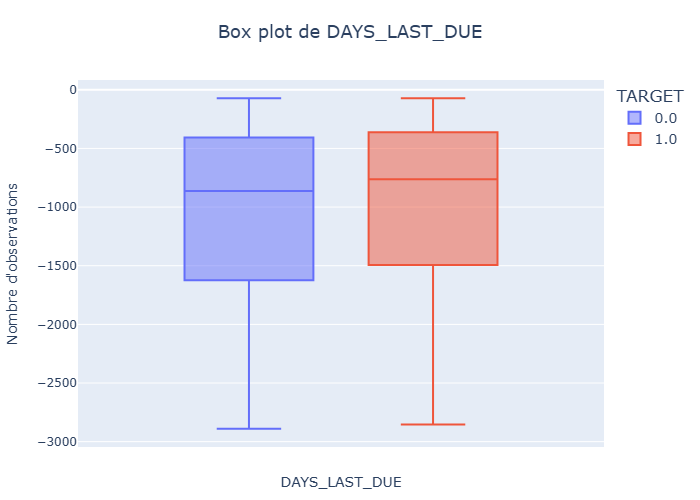

In [550]:
# Visualisation de la répartition pour la variable "DAYS_LAST_DUE"

plot_quantitative_box_violin(df_previous_app, 
                            x="DAYS_LAST_DUE",
                            plot_type="box",
                            color='TARGET',
                            width=800,
                            height=700,
                            xaxis_title="DAYS_LAST_DUE",
                            yaxis_title="Nombre d'observations",
                            max_quantile=0.75,
                            color_map={0: "#636EFA", 1: "#EF553B"}
                            )

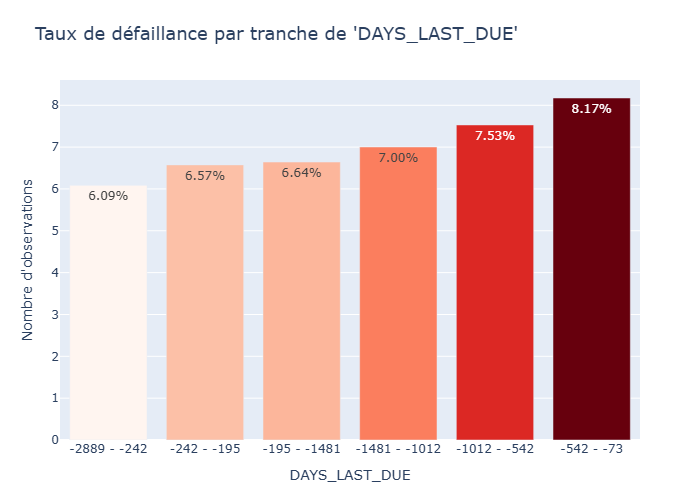

In [551]:
# Visualisation du taux de défaillance pour la variable "DAYS_LAST_DUE".

plot_defaillance_rate_per_quantitative(df_previous_app, 
                                       "DAYS_LAST_DUE",
                                       target_var="TARGET",
                                       nbins=6,
                                       width=800,
                                       height=700,
                                       xaxis_title="DAYS_LAST_DUE",
                                       max_quantile=0.75,
                                       yaxis_title="Nombre d'observations")

- De nouveau un constat similaire aux variables précédentes sur les échéances de paiments avec de nouveau des valeurs aberrantes.

In [552]:
df_previous_app['DAYS_TERMINATION'].describe().round(0)

count    997149.0
mean      81992.0
std      153304.0
min       -2874.0
25%       -1270.0
50%        -499.0
75%         -44.0
max      365243.0
Name: DAYS_TERMINATION, dtype: float64

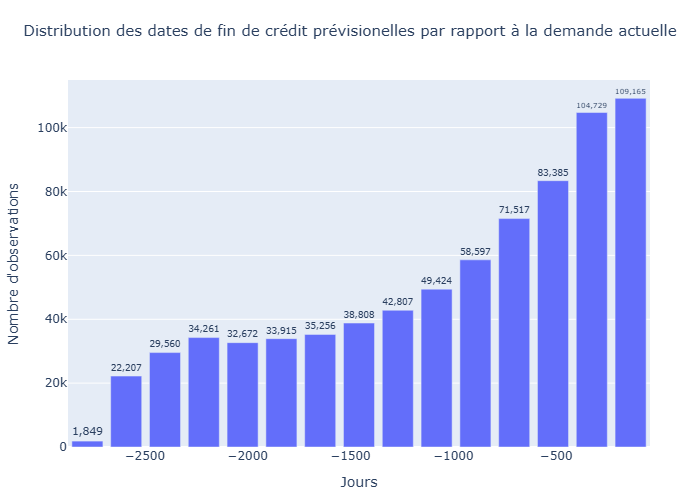

In [553]:
# Visualisation de la distribution pour la variable "DAYS_TERMINATION".

plot_quantitative_histogram(
    df_previous_app,
    x='DAYS_TERMINATION',
    title="Distribution des dates de fin de crédit prévisionelles par rapport à la demande actuelle",
    title_layout={"x": 0.5},
    title_font_size=15,
    xaxis_title="Jours",
    yaxis_title="Nombre d'observations",
    max_quantile=0.75,
    width=1000,
    height=600
)

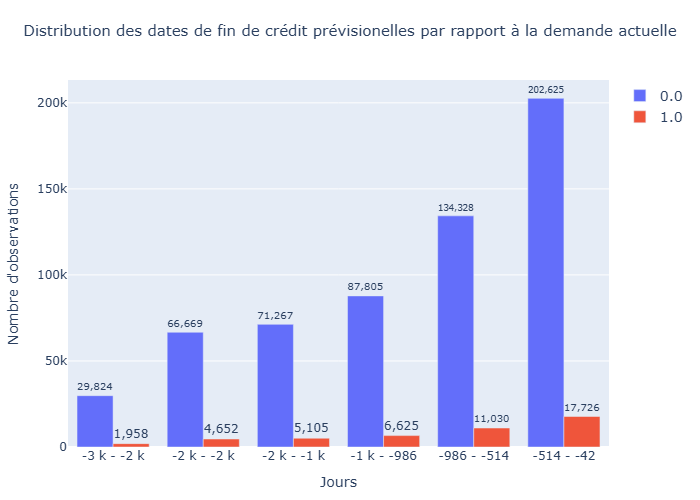

In [554]:
# Visualisation de la répartition pour la variable "DAYS_TERMINATION" en fonction de la Target.

plot_quantitative_histogram(
    df_previous_app,
    x='DAYS_TERMINATION',
    color='TARGET',
    nbins= 6,
    title="Distribution des dates de fin de crédit prévisionelles par rapport à la demande actuelle",
    title_layout={"x": 0.5},
    title_font_size=15,
    xaxis_title="Jours",
    yaxis_title="Nombre d'observations",
    bin_as_category=True,
    max_quantile=0.75,
    width=1000,
    height=600
)

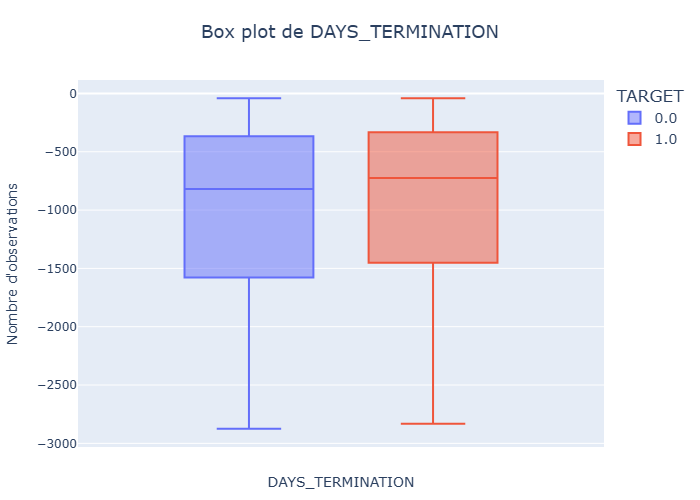

In [555]:
# Visualisation de la répartition pour la variable "DAYS_TERMINATION"

plot_quantitative_box_violin(df_previous_app, 
                            x="DAYS_TERMINATION",
                            plot_type="box",
                            color='TARGET',
                            width=800,
                            height=700,
                            xaxis_title="DAYS_TERMINATION",
                            yaxis_title="Nombre d'observations",
                            max_quantile=0.75,
                            color_map={0: "#636EFA", 1: "#EF553B"}
                            )

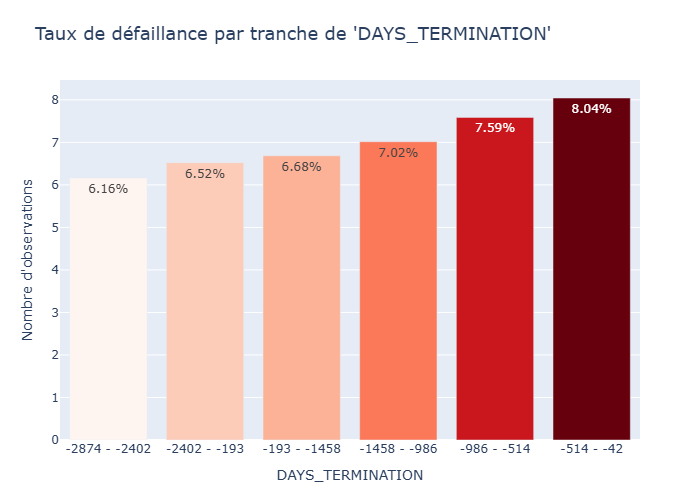

In [556]:
# Visualisation du taux de défaillance pour la variable "DAYS_TERMINATION".

plot_defaillance_rate_per_quantitative(df_previous_app, 
                                       "DAYS_TERMINATION",
                                       target_var="TARGET",
                                       nbins=6,
                                       width=800,
                                       height=700,
                                       max_quantile=0.75,
                                       xaxis_title="DAYS_TERMINATION",
                                       yaxis_title="Nombre d'observations")

- De nouveau des dates plus récentes pour les groupes défaillant par rapport aux clients non défaillants.

In [557]:
df_previous_app['NFLAG_INSURED_ON_APPROVAL'].describe().round(0)

count    997149.0
mean          0.0
std           0.0
min           0.0
25%           0.0
50%           0.0
75%           1.0
max           1.0
Name: NFLAG_INSURED_ON_APPROVAL, dtype: float64

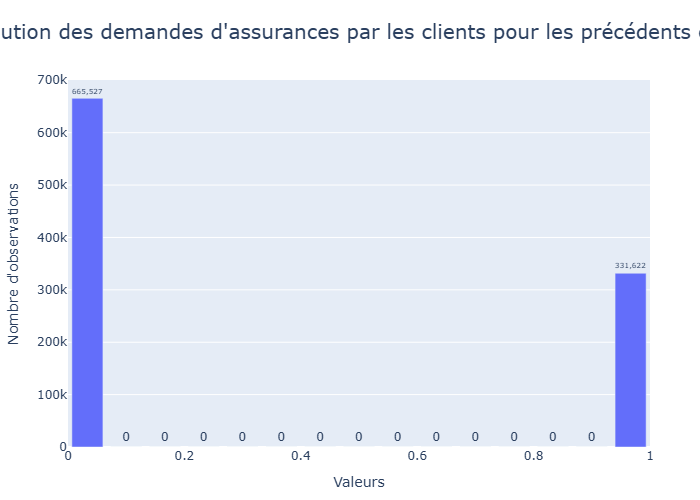

In [558]:
# Visualisation de la distribution pour la variable "NFLAG_INSURED_ON_APPROVAL".

plot_quantitative_histogram(
    df_previous_app,
    x='NFLAG_INSURED_ON_APPROVAL',
    title="Distribution des demandes d'assurances par les clients pour les précédents crédits",
    title_layout={"x": 0.5},
    title_font_size=20,
    xaxis_title="Valeurs",
    yaxis_title="Nombre d'observations",
    width=1000,
    height=600
)

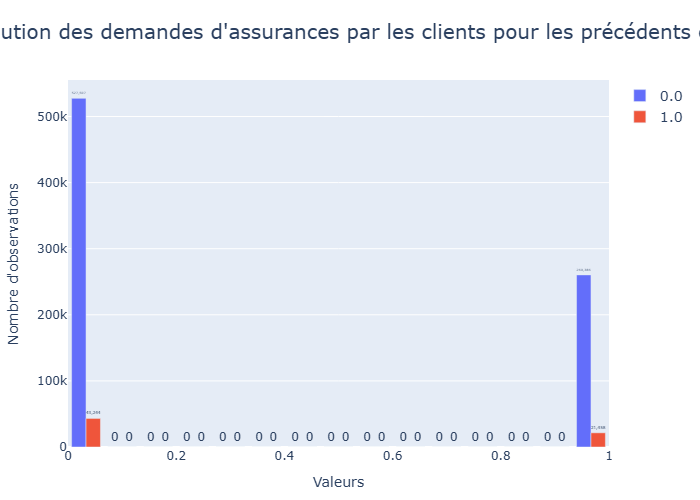

In [559]:
# Visualisation de la distribution pour la variable "NFLAG_INSURED_ON_APPROVAL".

plot_quantitative_histogram(
    df_previous_app,
    x='NFLAG_INSURED_ON_APPROVAL',
    color='TARGET',
    title="Distribution des demandes d'assurances par les clients pour les précédents crédits",
    title_layout={"x": 0.5},
    title_font_size=20,
    xaxis_title="Valeurs",
    yaxis_title="Nombre d'observations",
    width=1000,
    height=600
)

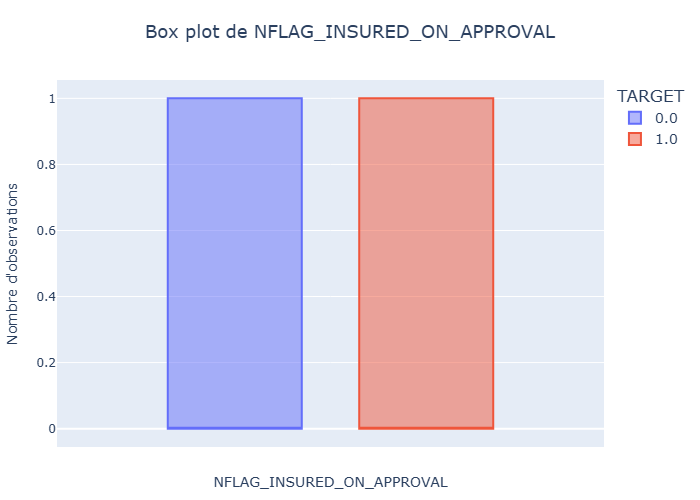

In [560]:
# Visualisation de la répartition pour la variable "NFLAG_INSURED_ON_APPROVAL"

plot_quantitative_box_violin(df_previous_app, 
                            x="NFLAG_INSURED_ON_APPROVAL",
                            plot_type="box",
                            color='TARGET',
                            width=800,
                            height=700,
                            xaxis_title="NFLAG_INSURED_ON_APPROVAL",
                            yaxis_title="Nombre d'observations",
                            color_map={0: "#636EFA", 1: "#EF553B"}
                            )

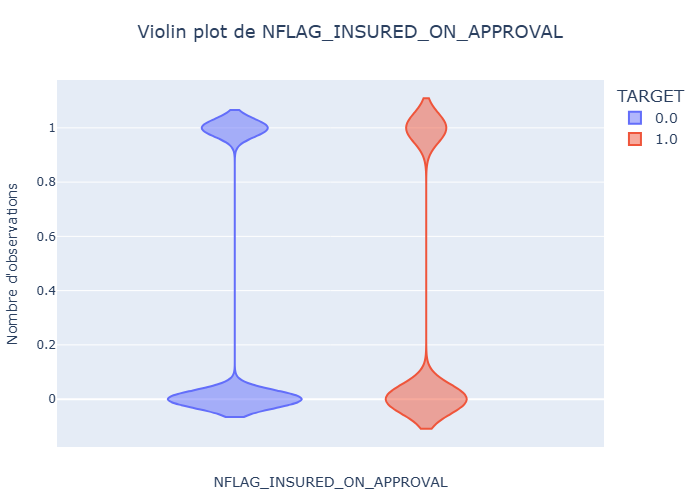

In [561]:
# Visualisation de la répartition pour la variable "NFLAG_INSURED_ON_APPROVAL"

plot_quantitative_box_violin(df_previous_app, 
                            x="NFLAG_INSURED_ON_APPROVAL",
                            plot_type="violin",
                            color='TARGET',
                            width=800,
                            height=700,
                            xaxis_title="NFLAG_INSURED_ON_APPROVAL",
                            yaxis_title="Nombre d'observations",
                            color_map={0: "#636EFA", 1: "#EF553B"}
                            )

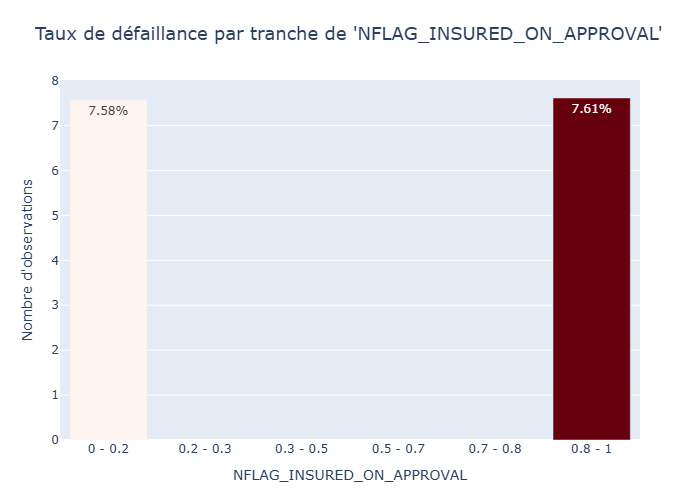

In [562]:
# Visualisation du taux de défaillance pour la variable "NFLAG_INSURED_ON_APPROVAL".

plot_defaillance_rate_per_quantitative(df_previous_app, 
                                       "NFLAG_INSURED_ON_APPROVAL",
                                       target_var="TARGET",
                                       nbins=6,
                                       width=800,
                                       height=700,
                                       xaxis_title="NFLAG_INSURED_ON_APPROVAL",
                                       yaxis_title="Nombre d'observations")

- Pour les groupes avec ou sans assurances, on retrouve les même distributions et quasiment le même taux de défaillance.
- On peut maintenant passer à l'analyse multivariée des différentes variables pour visualiser les corrélations entre elles et avec la Target :

In [563]:
# Calcul de la matrice de corrélation
corr_matrix = df_previous_app.corr()

# Masque pour exclure la diagonale (corrélations de 1)
mask = corr_matrix != 1

# Extraction des paires (en supprimant la diagonale)
corr_pairs = corr_matrix[mask].stack().reset_index()
corr_pairs.columns = ['Variable 1', 'Variable 2', 'Corrélation']

# Créer une paire triée pour éviter les doublons (A / B == B / A)
corr_pairs['Sorted Pair'] = corr_pairs.apply(
    lambda row: ' / '.join(sorted([row['Variable 1'], row['Variable 2']])), axis=1
)

# Supprimer les doublons
corr_pairs = corr_pairs.drop_duplicates(subset='Sorted Pair')

# Ajouter une colonne lisible avec les deux noms de variables
corr_pairs['Variables corrélées'] = corr_pairs['Sorted Pair']

# Garder uniquement les colonnes voulues
corr_df = corr_pairs[['Variables corrélées', 'Corrélation']]

# Trier par valeur absolue de corrélation (facultatif)
corr_df = corr_df.sort_values(by='Corrélation', ascending=False).reset_index(drop=True)

# Affichage stylisé
pd.set_option('display.max_rows', None)

corr_df_styled = corr_df.style.background_gradient(
    subset=['Corrélation'],
    cmap='coolwarm',
    vmin=-1, vmax=1
)

corr_df_styled

,Variables corrélées,Corrélation
0,AMT_APPLICATION / AMT_GOODS_PRICE,0.999884
1,AMT_CREDIT / AMT_GOODS_PRICE,0.993087
2,AMT_APPLICATION / AMT_CREDIT,0.975824
3,DAYS_LAST_DUE / DAYS_TERMINATION,0.927990
4,AMT_ANNUITY / AMT_GOODS_PRICE,0.820895
5,AMT_ANNUITY / AMT_CREDIT,0.816429
6,AMT_ANNUITY / AMT_APPLICATION,0.808872
7,AMT_APPLICATION / CNT_PAYMENT,0.680630
8,AMT_CREDIT / CNT_PAYMENT,0.674278
9,AMT_GOODS_PRICE / CNT_PAYMENT,0.672129


In [564]:
pd.reset_option('display.max_rows')

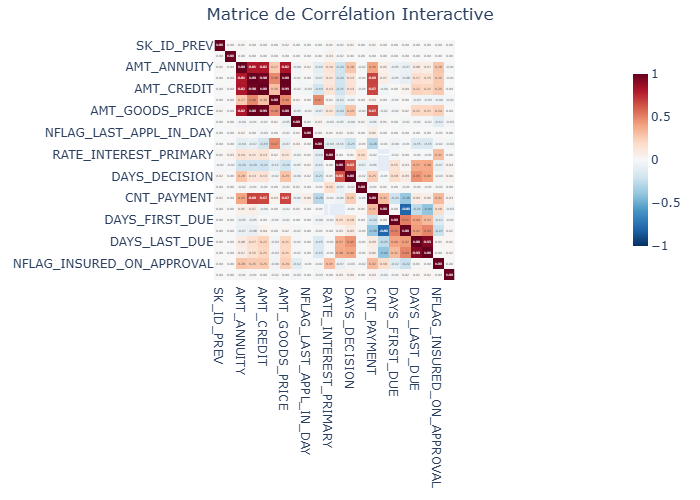

In [565]:
# Visualisation de la matrice de corrélation pour les variables quantitatives.

fig = px.imshow(
    corr_matrix,
    text_auto=".2f",
    color_continuous_scale='RdBu_r',
    zmin=-1,
    zmax=1
)

fig.update_layout(
    title="Matrice de Corrélation Interactive",
    title_x=0.5,
    width=1750,
    height=1750,
    margin=dict(l=20, r=20, t=40, b=20)
)

fig.update_coloraxes(colorbar=dict(thickness=15, x=1.02, len=0.8))
fig.show()

In [566]:
strong_corr_target = df_previous_app.corr()['TARGET'].drop('TARGET')

corr_matrix_target = strong_corr_target.to_frame(name='Corrélation en fonction de la target').sort_values(by='Corrélation en fonction de la target', ascending=False)
corr_matrix_target

,Corrélation en fonction de la target
DAYS_DECISION,0.039901
CNT_PAYMENT,0.030480
RATE_INTEREST_PRIVILEGED,0.028640
DAYS_LAST_DUE_1ST_VERSION,0.018021
DAYS_LAST_DUE,0.017522
DAYS_TERMINATION,0.016981
SK_ID_PREV,0.002009
NFLAG_INSURED_ON_APPROVAL,0.000653
AMT_GOODS_PRICE,0.000254
SK_ID_CURR,-0.001246


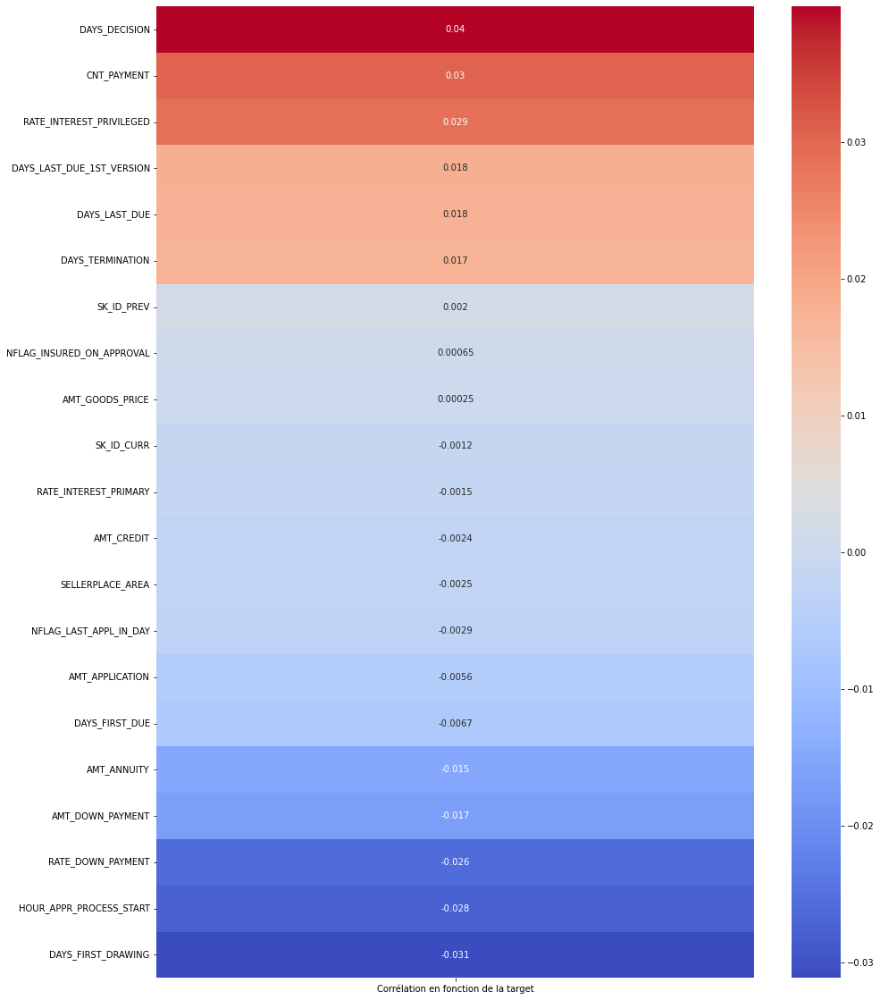

In [567]:
# Visualisation de la matrice de corrélation des variables quantitative par rapport à la Target.

plt.figure(figsize=(15,20))
sns.heatmap(corr_matrix_target, annot=True, cmap='coolwarm')
plt.show()

- Pour les variables quantitatives, on a quelques variables intéressante par rapport à la Target comme par exemple **"DAYS_DECISION"**, **"CNT_PAYMENT"**, **"RATE_INTEREST_PRIVILEGED"** qui sont les plus corrélées (entre 0.03 et 0.04 ce qui reste tout de même assez faible)
- Pour les corrélation négatives on a aussi **"RATE_DOWN_PAYMENT"**, **"HOUR_APPR_PROCESS_START"* et **"DAYS_FIRST_DRAWING"** pour la même échelle de valeurs.

In [568]:
# Inclure TARGET dans la matrice
cramer_matrix_previous = cramers_v_matrix(df_previous_app, include_target=True, target_col='TARGET')

# Extraire la ligne/colonne de TARGET
target_corr = cramer_matrix_previous['TARGET'].drop('TARGET').sort_values(ascending=False)

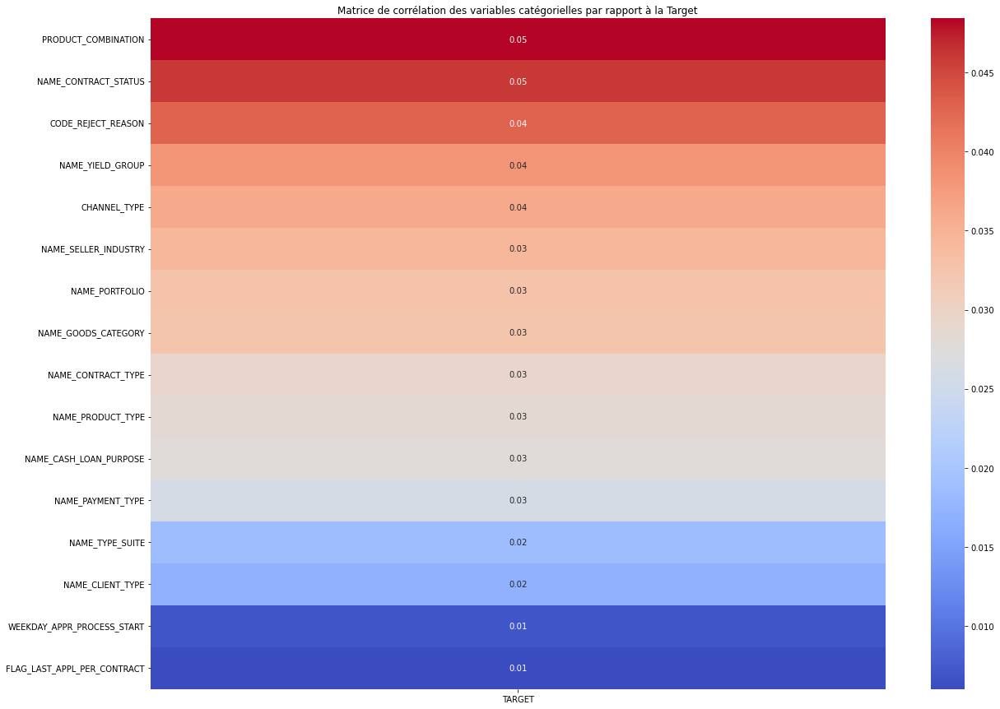

In [569]:
# Visualisation de la matrice de corrélation des variables qualitatives par rapport à la Target.

plt.figure(figsize=(20,15))
sns.heatmap(target_corr.to_frame(), annot=True, fmt=".2f", cmap="coolwarm")
plt.title("Matrice de corrélation des variables catégorielles par rapport à la Target")
plt.show()

- Pour les variables catégorielles, on a plus de variables avec une corrélation du même ordre de valeurs comme on peut le voir avec le graphique comme par exemple **"PRODUCT_COMBINAISON"** ou **"NAME_CONTRACT_STATUS"**.

#### Dataframe "POS_CASH_balance"

In [570]:
# Importation du fichier qui s'intitule "POS_CASH_balance.csv".

df_pos_cash_balance = pd.read_csv(r"C:\Users\Caomghin\Desktop\Implementer_un_modele_de_scoring\Donnee_kaggle\POS_CASH_balance.csv")

In [571]:
# Forme du dataframe "POS_CASH_balance".

df_pos_cash_balance.shape

(10001358, 8)

In [572]:
# Visualisation du dataframe.

df_pos_cash_balance

,SK_ID_PREV,SK_ID_CURR,MONTHS_BALANCE,CNT_INSTALMENT,CNT_INSTALMENT_FUTURE,NAME_CONTRACT_STATUS,SK_DPD,SK_DPD_DEF
0,1803195,182943,-31,48.0,45.0,Active,0,0
1,1715348,367990,-33,36.0,35.0,Active,0,0
2,1784872,397406,-32,12.0,9.0,Active,0,0
3,1903291,269225,-35,48.0,42.0,Active,0,0
4,2341044,334279,-35,36.0,35.0,Active,0,0
...,...,...,...,...,...,...,...,...
10001353,2448283,226558,-20,6.0,0.0,Active,843,0
10001354,1717234,141565,-19,12.0,0.0,Active,602,0
10001355,1283126,315695,-21,10.0,0.0,Active,609,0
10001356,1082516,450255,-22,12.0,0.0,Active,614,0


In [573]:
# On visualise le type de chaque variable et la présence potentielle de valeurs nulles.

df_pos_cash_balance.info(show_counts=True)

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 10001358 entries, 0 to 10001357
Data columns (total 8 columns):
 #   Column                 Non-Null Count     Dtype  
---  ------                 --------------     -----  
 0   SK_ID_PREV             10001358 non-null  int64  
 1   SK_ID_CURR             10001358 non-null  int64  
 2   MONTHS_BALANCE         10001358 non-null  int64  
 3   CNT_INSTALMENT         9975287 non-null   float64
 4   CNT_INSTALMENT_FUTURE  9975271 non-null   float64
 5   NAME_CONTRACT_STATUS   10001358 non-null  object 
 6   SK_DPD                 10001358 non-null  int64  
 7   SK_DPD_DEF             10001358 non-null  int64  
dtypes: float64(2), int64(5), object(1)
memory usage: 610.4+ MB


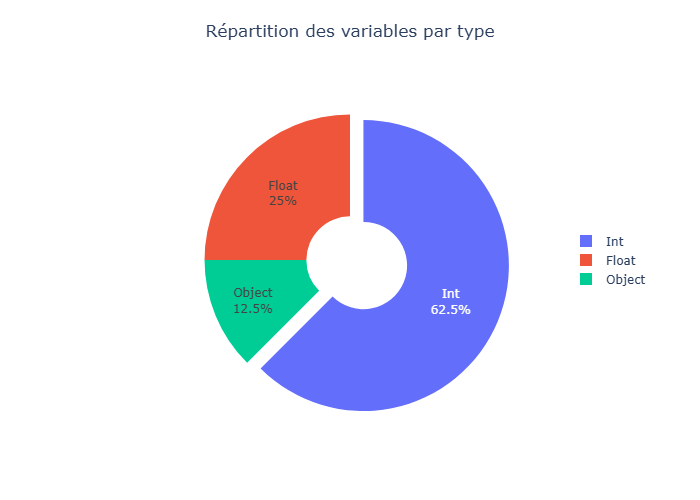

In [574]:
# Représentation graphique des types de variables.

fig = go.Figure(data=[go.Pie(
    labels=["Int", "Float", "Object"], 
    values=df_pos_cash_balance.dtypes.value_counts(),
    hole=0.3,
    textinfo="label+percent",
    pull=[0.1, 0, 0]
)])

# Titre et affichage
fig.update_layout(
    title={
        'text': "Répartition des variables par type",
        'y': 0.95,  # Position verticale (1 = tout en haut)
        'x': 0.50,   # Centrer le titre
        'xanchor': 'center',
        'yanchor': 'top'
    },
    legend={
        'x': 0.9,  # Ajuste la position de la légende plus proche
        'y': 0.5,
        'xanchor': 'left'
    }
)
fig.show()

In [575]:
# Visualisation des description liées à ce jeu de données.

pd.set_option('display.max_colwidth', None)
df_description.loc[df_description['Table'] == 'POS_CASH_balance.csv'][['Row','Description']]

,Row,Description
142,SK_ID_PREV,"ID of previous credit in Home Credit related to loan in our sample. (One loan in our sample can have 0,1,2 or more previous loans in Home Credit)"
143,SK_ID_CURR,ID of loan in our sample
144,MONTHS_BALANCE,"Month of balance relative to application date (-1 means the information to the freshest monthly snapshot, 0 means the information at application - often it will be the same as -1 as many banks are not updating the information to Credit Bureau regularly )"
145,CNT_INSTALMENT,Term of previous credit (can change over time)
146,CNT_INSTALMENT_FUTURE,Installments left to pay on the previous credit
147,NAME_CONTRACT_STATUS,Contract status during the month
148,SK_DPD,DPD (days past due) during the month of previous credit
149,SK_DPD_DEF,DPD during the month with tolerance (debts with low loan amounts are ignored) of the previous credit


In [576]:
pd.reset_option('display.max_colwidth')

In [577]:
# Statistique des données du previous application .

df_pos_cash_balance.describe().round(2)

,SK_ID_PREV,SK_ID_CURR,MONTHS_BALANCE,CNT_INSTALMENT,CNT_INSTALMENT_FUTURE,SK_DPD,SK_DPD_DEF
count,10001358.00,10001358.00,10001358.00,9975287.00,9975271.00,10001358.00,10001358.00
mean,1903216.60,278403.86,-35.01,17.09,10.48,11.61,0.65
std,535846.53,102763.75,26.07,12.00,11.11,132.71,32.76
min,1000001.00,100001.00,-96.00,1.00,0.00,0.00,0.00
25%,1434405.00,189550.00,-54.00,10.00,3.00,0.00,0.00
50%,1896565.00,278654.00,-28.00,12.00,7.00,0.00,0.00
75%,2368963.00,367429.00,-13.00,24.00,14.00,0.00,0.00
max,2843499.00,456255.00,-1.00,92.00,85.00,4231.00,3595.00


In [578]:
# Calcul du pourcentage de valeurs nulles par variable pour "pos_cash_balance.csv". 
pd.set_option('display.max_rows', None)
calculate_missing_values(df_pos_cash_balance)

,Nbr_valeurs_manquantes,Pct_valeurs_manquantes
CNT_INSTALMENT_FUTURE,26087,0.260835
CNT_INSTALMENT,26071,0.260675


In [579]:
pd.reset_option('display.max_rows')

Text(0, 0.5, 'Loans')

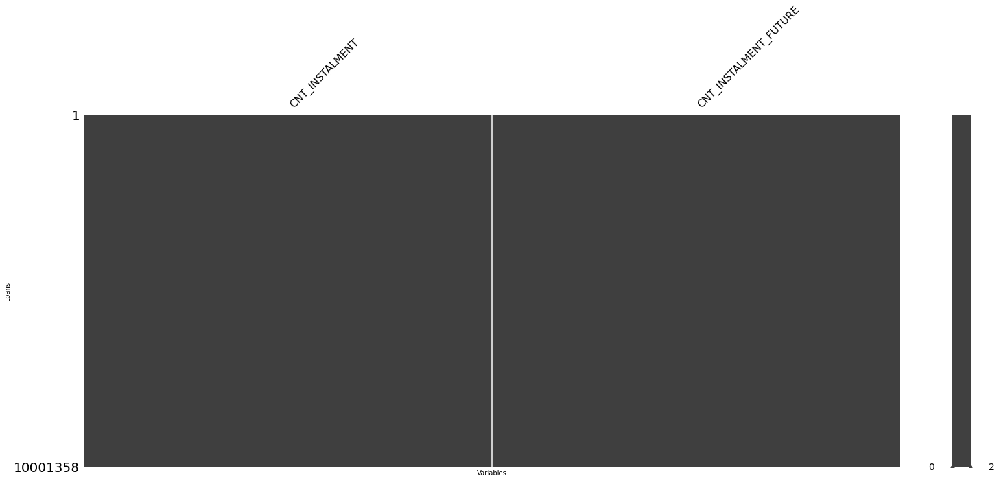

In [580]:
# Utilisation d'un graphique pour avoir une représentation visuelle des valeurs manquantes.

msno.matrix(df_pos_cash_balance.loc[:, df_pos_cash_balance.isnull().any(axis=0)])

plt.xlabel("Variables")
plt.ylabel("Loans")

- Pour ce dataframe on ne retrouve que 2 variables avec des valeurs manquantes toutefois ces valeurs ne représentent que 0.2 % des valeurs totales donc il devrait être possible d'y remédier assez facilement.

In [581]:
df_pos_cash_balance.info(show_counts=True)

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 10001358 entries, 0 to 10001357
Data columns (total 8 columns):
 #   Column                 Non-Null Count     Dtype  
---  ------                 --------------     -----  
 0   SK_ID_PREV             10001358 non-null  int64  
 1   SK_ID_CURR             10001358 non-null  int64  
 2   MONTHS_BALANCE         10001358 non-null  int64  
 3   CNT_INSTALMENT         9975287 non-null   float64
 4   CNT_INSTALMENT_FUTURE  9975271 non-null   float64
 5   NAME_CONTRACT_STATUS   10001358 non-null  object 
 6   SK_DPD                 10001358 non-null  int64  
 7   SK_DPD_DEF             10001358 non-null  int64  
dtypes: float64(2), int64(5), object(1)
memory usage: 610.4+ MB


In [582]:
# Recherche de doublons pour la variable ID "SK_ID_PREV"

df_pos_cash_balance['SK_ID_PREV'].duplicated().any()

True

In [583]:
# Nombre de lignes présentant au moins un doublon et celles n'en présentant pas.

df_pos_cash_balance['SK_ID_PREV'].duplicated(keep=False).value_counts()

True     9992302
False       9056
Name: SK_ID_PREV, dtype: int64

- Comme pour les précédents dataframes, cet ID fait référence aux précédent credit du Bureau lié au prêt de notre échantillon de donnée principale (application train/test).
- Il est aussi préciser qu'il peut y avoir plusieurs crédits précédent la demande de prêt actuelle ce qui justifie qu'il y ait des doublons.

In [584]:
# Recherche de doublons pour la variable ID "SK_ID_CURR"

df_pos_cash_balance['SK_ID_CURR'].duplicated().any()

True

In [585]:
# Nombre de lignes présentant au moins un doublon et celles n'en présentant pas.

df_pos_cash_balance['SK_ID_CURR'].duplicated(keep=False).value_counts()

True     10000986
False         372
Name: SK_ID_CURR, dtype: int64

- Ici on a l'ID des prêts actuels de nos clients donc pour la même raison, on retrouve des doublons pour cette variable.

In [586]:
df_pos_cash_balance.select_dtypes(include=['object']).nunique()

NAME_CONTRACT_STATUS    9
dtype: int64

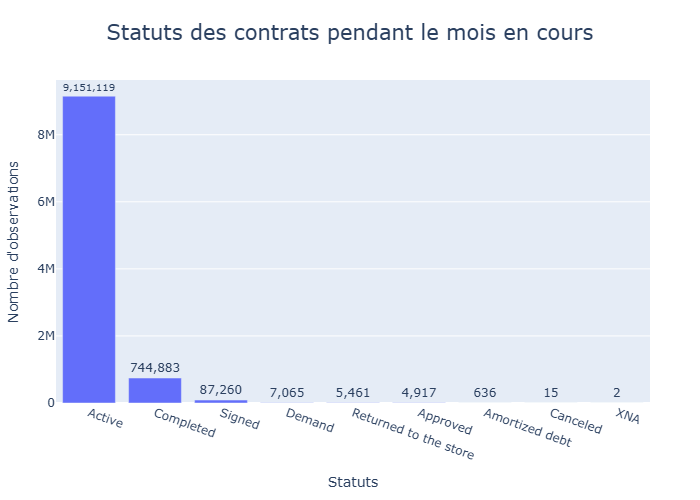

In [587]:
# Visualisation de la répartition pour la variable "NAME_CONTRACT_STATUS"

plot_categorical_histogram(
    df=df_pos_cash_balance,
    x="NAME_CONTRACT_STATUS",
    title="Statuts des contrats pendant le mois en cours",
    xaxis_title= 'Statuts',
    tickangle=20,
    title_font_size=21
)

In [588]:
# Ajout de la variable 'TARGET' au dataframe df_pos_cash_balance

df_pos_cash_balance['TARGET'] = df_pos_cash_balance['SK_ID_CURR'].map(df_appli_train.set_index('SK_ID_CURR')['TARGET'])

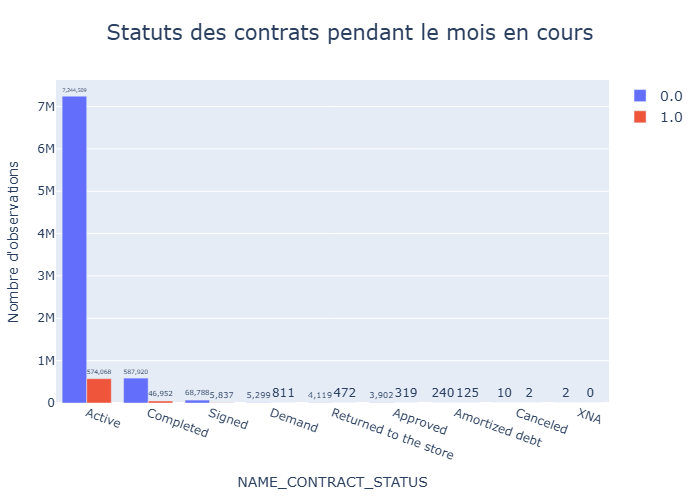

In [589]:
# Visualisation de la répartition pour la variable "NAME_CONTRACT_STATUS" en fonction de la Target.

plot_categorical_histogram(
    df=df_pos_cash_balance,
    x="NAME_CONTRACT_STATUS",
    color= 'TARGET',
    title="Statuts des contrats pendant le mois en cours",
    tickangle=20,
    title_font_size=21
)

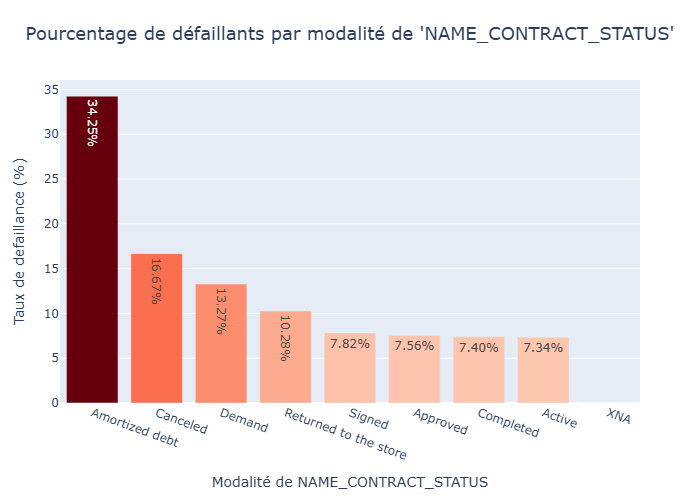

In [590]:
# Visualisation du pourcentage de prêts défaillants pour la variable de NAME_CONTRACT_STATUS.

plot_defaillance_rate_per_category(
    df_pos_cash_balance,
    cat_var='NAME_CONTRACT_STATUS',
    title_layout={"x": 0.5},
    xaxis_title = "Modalité de NAME_CONTRACT_STATUS",
    yaxis_title = "Taux de defaillance (%)",
    tickangle=20,
    title_font_size=18
)

- Pour les statuts de contrats des ces crédits liés à des cartes de type “Point of Sale” (POS) ou à des crédits renouvelables (Cash loans), on constate que la catégorie "Amortized debt" se démarque largement des autres en atteignant plus d'un tiers de défaillance pour cette catégorie.
- A l'inverse pour les catégories avec le plus d'effectifs, on a les taux les plus faibles de défaillance.

In [591]:
df_pos_cash_balance.select_dtypes(include=['int64', 'float64']).info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 10001358 entries, 0 to 10001357
Data columns (total 8 columns):
 #   Column                 Dtype  
---  ------                 -----  
 0   SK_ID_PREV             int64  
 1   SK_ID_CURR             int64  
 2   MONTHS_BALANCE         int64  
 3   CNT_INSTALMENT         float64
 4   CNT_INSTALMENT_FUTURE  float64
 5   SK_DPD                 int64  
 6   SK_DPD_DEF             int64  
 7   TARGET                 float64
dtypes: float64(3), int64(5)
memory usage: 610.4 MB


In [592]:
df_pos_cash_balance['MONTHS_BALANCE'].describe().round(0)

count    10001358.0
mean          -35.0
std            26.0
min           -96.0
25%           -54.0
50%           -28.0
75%           -13.0
max            -1.0
Name: MONTHS_BALANCE, dtype: float64

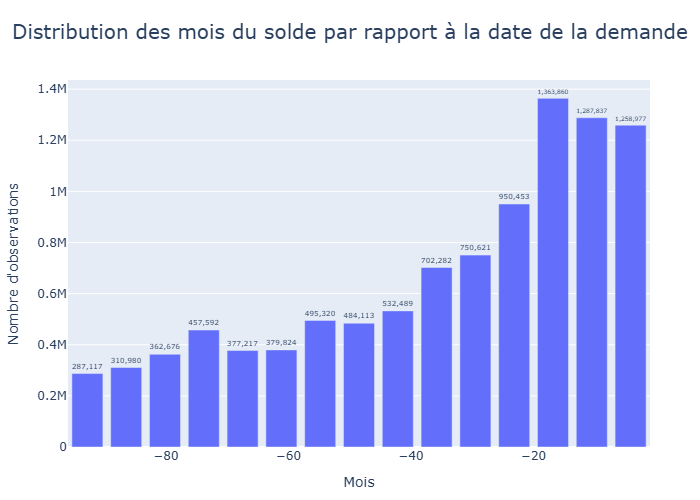

In [593]:
# Visualisation de la distribution pour la variable "MONTHS_BALANCE".

plot_quantitative_histogram(
    df_pos_cash_balance,
    x='MONTHS_BALANCE',
    title="Distribution des mois du solde par rapport à la date de la demande",
    title_layout={"x": 0.5},
    title_font_size=20,
    xaxis_title="Mois",
    yaxis_title="Nombre d'observations",
    width=1000,
    height=600
)

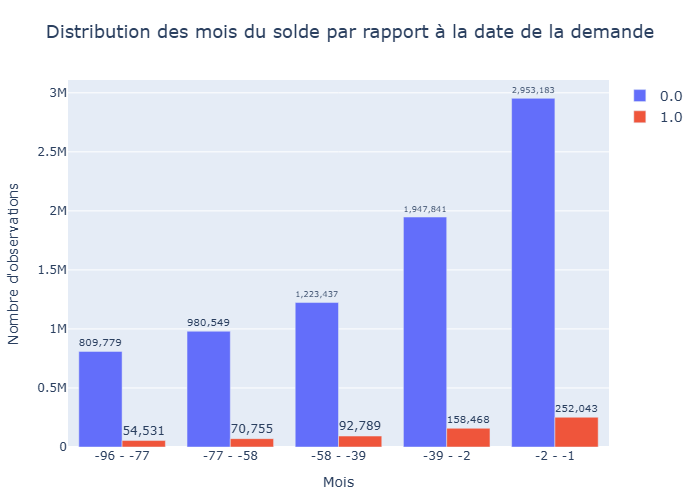

In [594]:
# Visualisation de la répartition pour la variable "MONTHS_BALANCE" en fonction de la Target.

plot_quantitative_histogram(
    df_pos_cash_balance,
    x='MONTHS_BALANCE',
    color='TARGET',
    nbins= 5,
    title="Distribution des mois du solde par rapport à la date de la demande",
    title_layout={"x": 0.5},
    title_font_size=18,
    xaxis_title="Mois",
    yaxis_title="Nombre d'observations",
    bin_as_category=True,
    width=1000,
    height=600
)

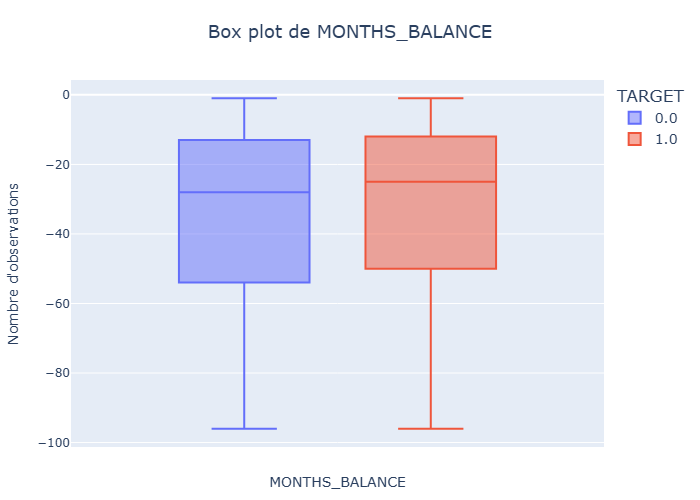

In [595]:
# Visualisation de la répartition pour la variable "MONTHS_BALANCE"

plot_quantitative_box_violin(df_pos_cash_balance, 
                            x="MONTHS_BALANCE",
                            plot_type="box",
                            color='TARGET',
                            width=800,
                            height=700,
                            xaxis_title="MONTHS_BALANCE",
                            yaxis_title="Nombre d'observations",
                            color_map={0: "#636EFA", 1: "#EF553B"}
                            )

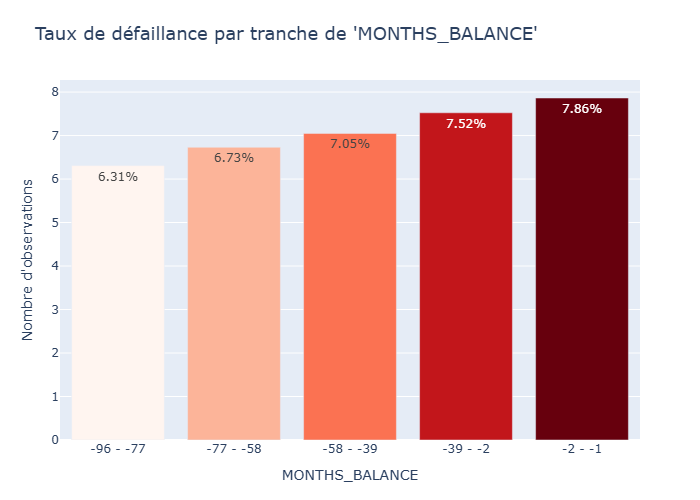

In [596]:
# Visualisation du taux de défaillance pour la variable "MONTHS_BALANCE".

plot_defaillance_rate_per_quantitative(df_pos_cash_balance, 
                                       "MONTHS_BALANCE",
                                       target_var="TARGET",
                                       nbins=5,
                                       width=800,
                                       height=700,
                                       xaxis_title="MONTHS_BALANCE",
                                       yaxis_title="Nombre d'observations")

- Lorsque l'on regarde les distributions des deux groupes, on remarque que les informations liées aux soldes des défaillants sont légérement plus récent et cela se confirme plutôt bien avec le graphique ci-dessus.

In [597]:
df_pos_cash_balance['CNT_INSTALMENT'].describe().round(0)

count    9975287.0
mean          17.0
std           12.0
min            1.0
25%           10.0
50%           12.0
75%           24.0
max           92.0
Name: CNT_INSTALMENT, dtype: float64

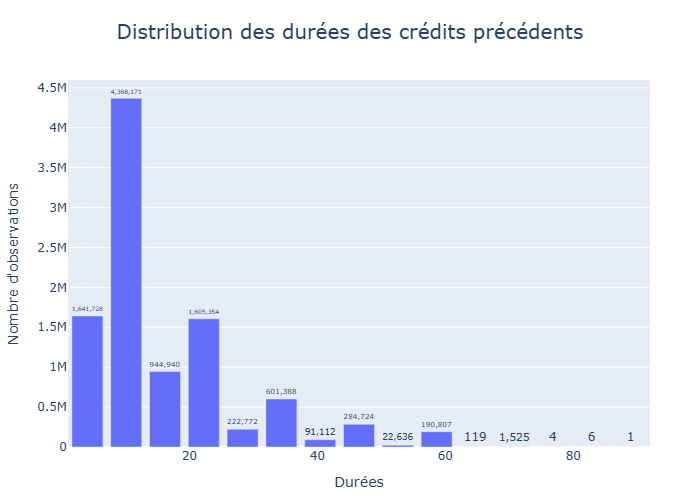

In [598]:
# Visualisation de la distribution pour la variable "CNT_INSTALMENT".

plot_quantitative_histogram(
    df_pos_cash_balance,
    x='CNT_INSTALMENT',
    title="Distribution des durées des crédits précédents",
    title_layout={"x": 0.5},
    title_font_size=20,
    xaxis_title="Durées",
    yaxis_title="Nombre d'observations",
    width=1000,
    height=600
)

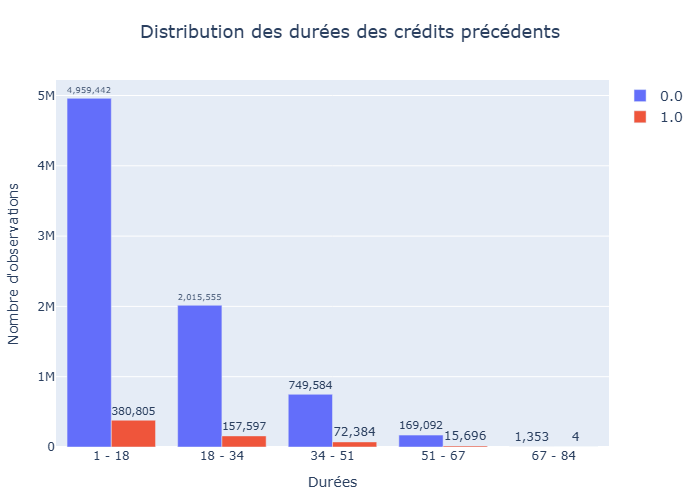

In [599]:
# Visualisation de la répartition pour la variable "CNT_INSTALMENT" en fonction de la Target.

plot_quantitative_histogram(
    df_pos_cash_balance,
    x='CNT_INSTALMENT',
    color='TARGET',
    nbins= 5,
    title="Distribution des durées des crédits précédents",
    title_layout={"x": 0.5},
    title_font_size=18,
    xaxis_title="Durées",
    yaxis_title="Nombre d'observations",
    bin_as_category=True,
    width=1000,
    height=600
)

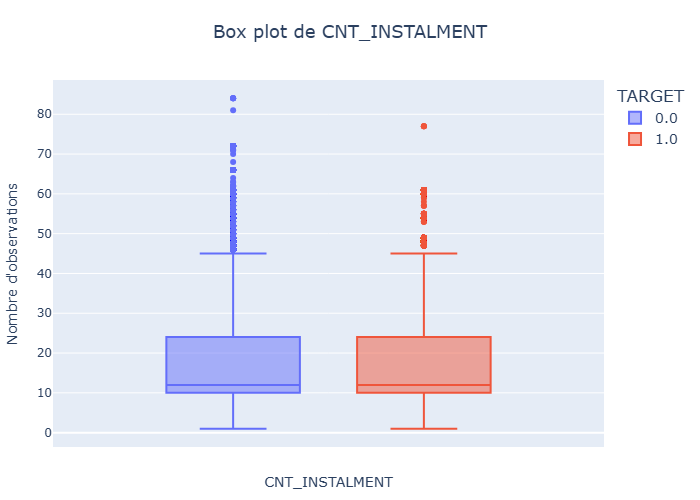

In [600]:
# Visualisation de la répartition pour la variable "CNT_INSTALMENT"

plot_quantitative_box_violin(df_pos_cash_balance, 
                            x="CNT_INSTALMENT",
                            plot_type="box",
                            color='TARGET',
                            width=800,
                            height=700,
                            xaxis_title="CNT_INSTALMENT",
                            yaxis_title="Nombre d'observations",
                            color_map={0: "#636EFA", 1: "#EF553B"}
                            )

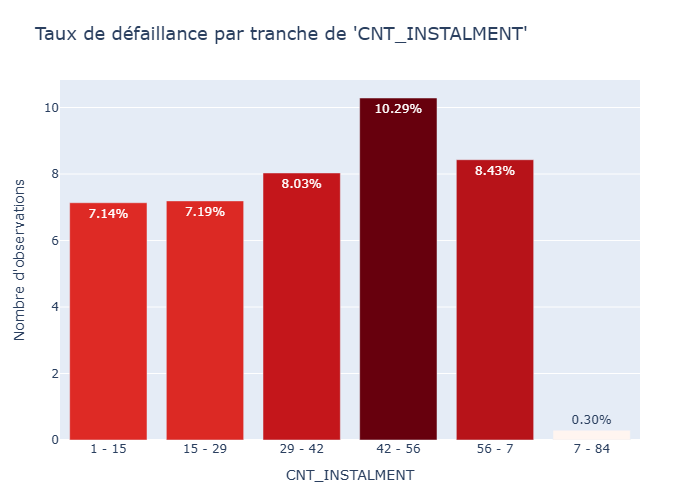

In [601]:
# Visualisation du taux de défaillance pour la variable "CNT_INSTALMENT".

plot_defaillance_rate_per_quantitative(df_pos_cash_balance, 
                                       "CNT_INSTALMENT",
                                       target_var="TARGET",
                                       nbins=6,
                                       width=800,
                                       height=700,
                                       xaxis_title="CNT_INSTALMENT",
                                       yaxis_title="Nombre d'observations")

- Pour cette variable qui met en avant les durées des crédits, les distributions entre les deux groupes sont similaires et le taux de défaillance ne semble pas être fortement corrélé à cette variable.

In [602]:
df_pos_cash_balance['CNT_INSTALMENT_FUTURE'].describe().round(0)

count    9975271.0
mean          10.0
std           11.0
min            0.0
25%            3.0
50%            7.0
75%           14.0
max           85.0
Name: CNT_INSTALMENT_FUTURE, dtype: float64

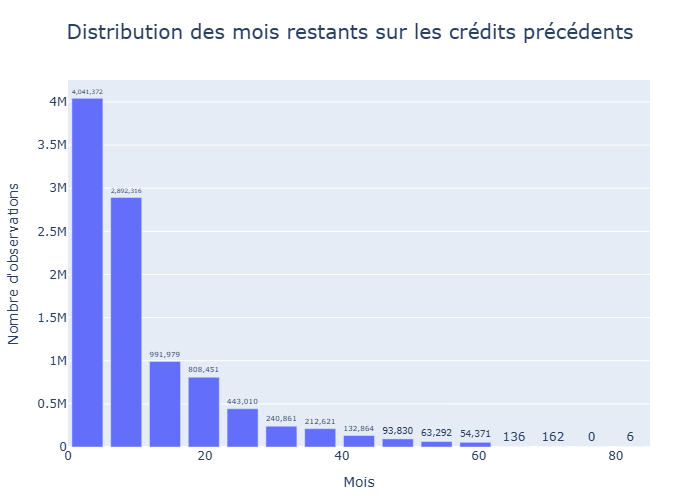

In [603]:
# Visualisation de la distribution pour la variable "CNT_INSTALMENT_FUTURE".

plot_quantitative_histogram(
    df_pos_cash_balance,
    x='CNT_INSTALMENT_FUTURE',
    title="Distribution des mois restants sur les crédits précédents",
    title_layout={"x": 0.5},
    title_font_size=20,
    xaxis_title="Mois",
    yaxis_title="Nombre d'observations",
    width=1000,
    height=600
)

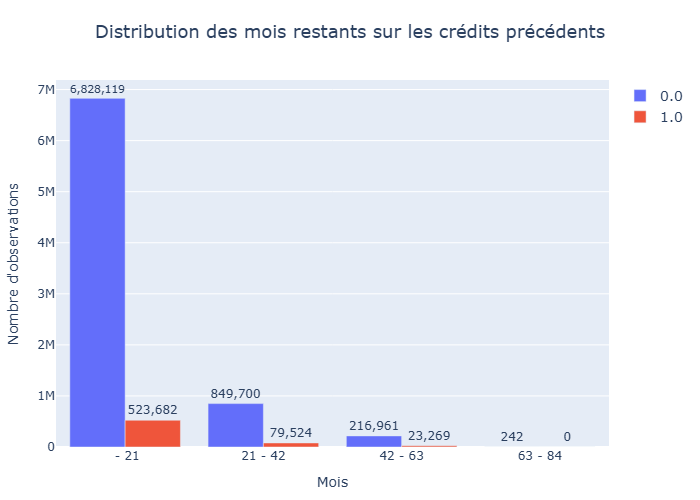

In [604]:
# Visualisation de la répartition pour la variable "CNT_INSTALMENT_FUTURE" en fonction de la Target.

plot_quantitative_histogram(
    df_pos_cash_balance,
    x='CNT_INSTALMENT_FUTURE',
    color='TARGET',
    nbins= 4,
    title="Distribution des mois restants sur les crédits précédents",
    title_layout={"x": 0.5},
    title_font_size=18,
    xaxis_title="Mois",
    yaxis_title="Nombre d'observations",
    bin_as_category=True,
    width=1000,
    height=600
)

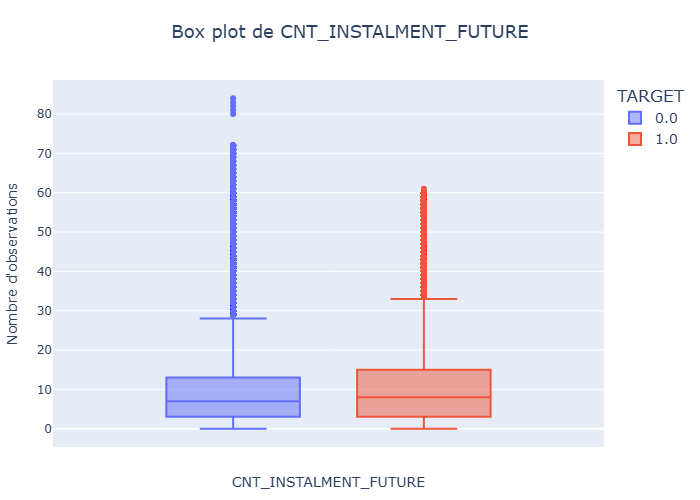

In [605]:
# Visualisation de la répartition pour la variable "CNT_INSTALMENT_FUTURE"

plot_quantitative_box_violin(df_pos_cash_balance, 
                            x="CNT_INSTALMENT_FUTURE",
                            plot_type="box",
                            color='TARGET',
                            width=800,
                            height=700,
                            xaxis_title="CNT_INSTALMENT_FUTURE",
                            yaxis_title="Nombre d'observations",
                            color_map={0: "#636EFA", 1: "#EF553B"}
                            )

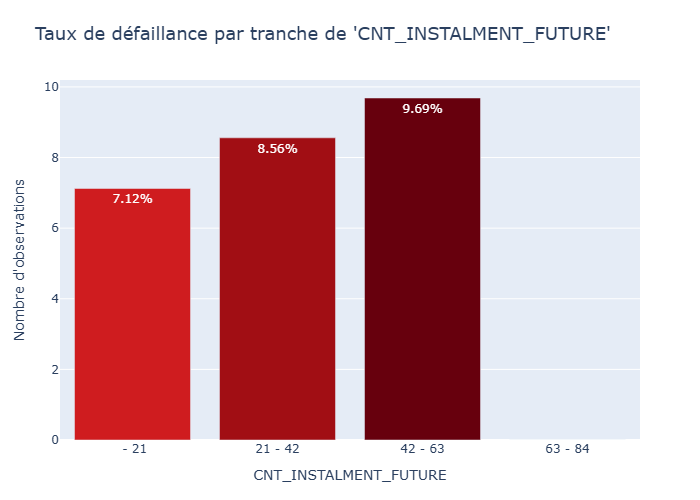

In [606]:
# Visualisation du taux de défaillance pour la variable "CNT_INSTALMENT_FUTURE".

plot_defaillance_rate_per_quantitative(df_pos_cash_balance, 
                                       "CNT_INSTALMENT_FUTURE",
                                       target_var="TARGET",
                                       nbins=4,
                                       width=800,
                                       height=700,
                                       xaxis_title="CNT_INSTALMENT_FUTURE",
                                       yaxis_title="Nombre d'observations")

- Pour cette variable les distributions sont similaire et le taux de défaillance semble évoluer dans le même sens que le nombre de mois sauf pour le dernier interval.

In [607]:
df_pos_cash_balance['SK_DPD'].describe().round(0)

count    10001358.0
mean           12.0
std           133.0
min             0.0
25%             0.0
50%             0.0
75%             0.0
max          4231.0
Name: SK_DPD, dtype: float64

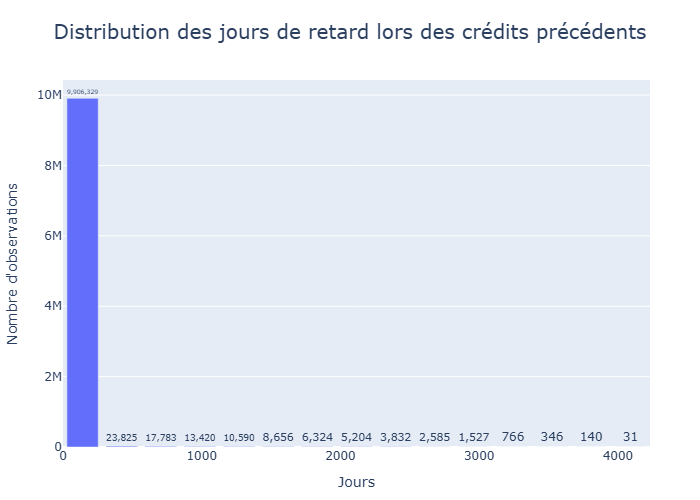

In [608]:
# Visualisation de la distribution pour la variable "SK_DPD".

plot_quantitative_histogram(
    df_pos_cash_balance,
    x='SK_DPD',
    title="Distribution des jours de retard lors des crédits précédents",
    title_layout={"x": 0.5},
    title_font_size=20,
    xaxis_title="Jours",
    yaxis_title="Nombre d'observations",
    width=1000,
    height=600
)

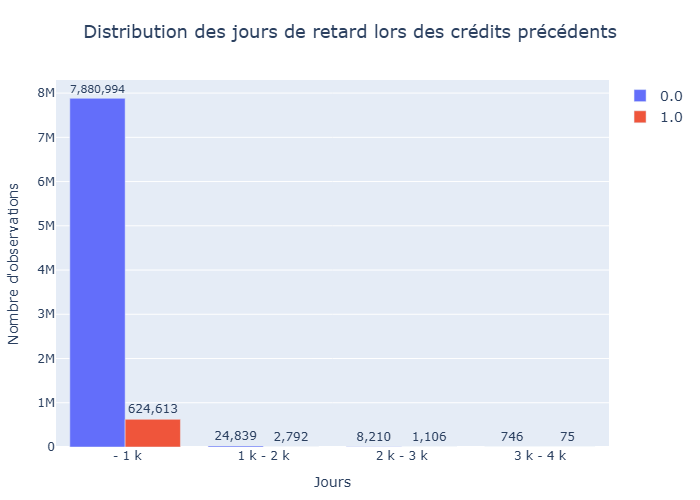

In [609]:
# Visualisation de la répartition pour la variable "SK_DPD" en fonction de la Target.

plot_quantitative_histogram(
    df_pos_cash_balance,
    x='SK_DPD',
    color='TARGET',
    nbins= 4,
    title="Distribution des jours de retard lors des crédits précédents",
    title_layout={"x": 0.5},
    title_font_size=18,
    xaxis_title="Jours",
    yaxis_title="Nombre d'observations",
    bin_as_category=True,
    width=1000,
    height=600
)

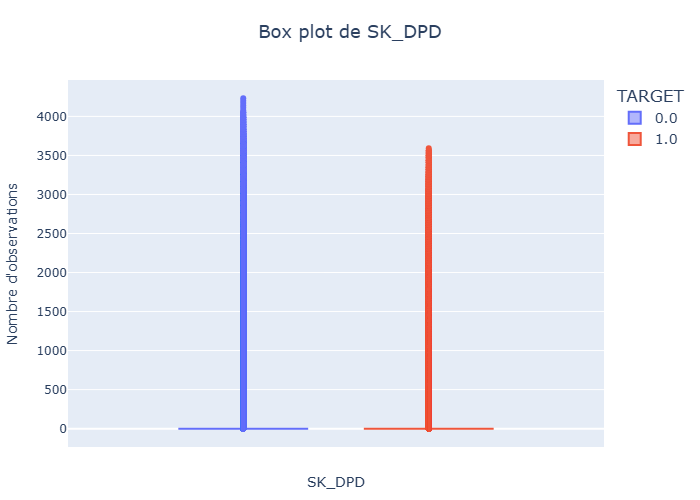

In [610]:
# Visualisation de la répartition pour la variable "SK_DPD"

plot_quantitative_box_violin(df_pos_cash_balance, 
                            x="SK_DPD",
                            plot_type="box",
                            color='TARGET',
                            width=800,
                            height=700,
                            xaxis_title="SK_DPD",
                            yaxis_title="Nombre d'observations",
                            color_map={0: "#636EFA", 1: "#EF553B"}
                            )

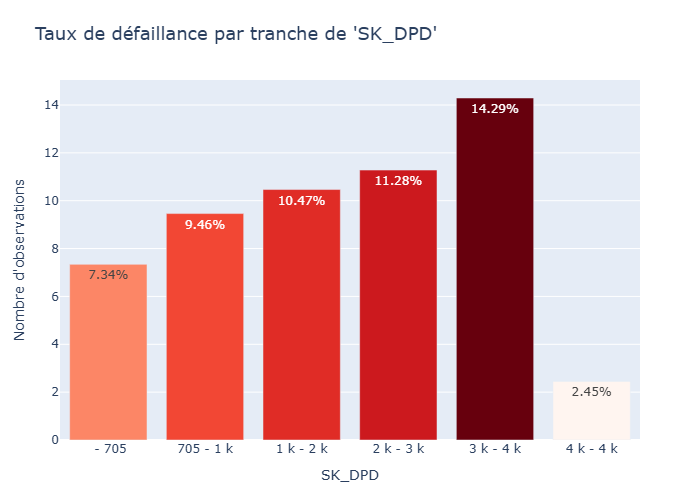

In [611]:
# Visualisation du taux de défaillance pour la variable "SK_DPD".

plot_defaillance_rate_per_quantitative(df_pos_cash_balance, 
                                       "SK_DPD",
                                       target_var="TARGET",
                                       nbins=6,
                                       width=800,
                                       height=700,
                                       xaxis_title="SK_DPD",
                                       yaxis_title="Nombre d'observations")

- Dans la majorité des cas il y a pas ou peu de retards mais lorsque l'on regarde le taux de défaillance à mesure que les jours augmentent, on constate que celui-ci augmente de manière non négligeable sauf pour le dernier interval qui est contradictoire au reste.

In [612]:
df_pos_cash_balance['SK_DPD_DEF'].describe().round(0)

count    10001358.0
mean            1.0
std            33.0
min             0.0
25%             0.0
50%             0.0
75%             0.0
max          3595.0
Name: SK_DPD_DEF, dtype: float64

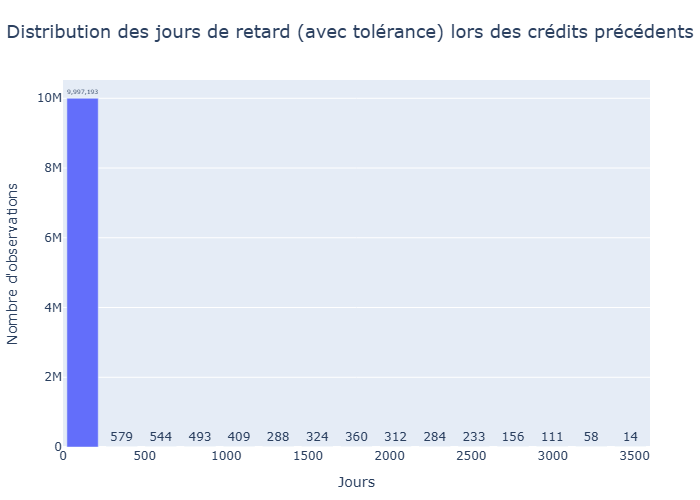

In [613]:
# Visualisation de la distribution pour la variable "SK_DPD_DEF".

plot_quantitative_histogram(
    df_pos_cash_balance,
    x='SK_DPD_DEF',
    title="Distribution des jours de retard (avec tolérance) lors des crédits précédents",
    title_layout={"x": 0.5},
    title_font_size=18,
    xaxis_title="Jours",
    yaxis_title="Nombre d'observations",
    width=1000,
    height=600
)

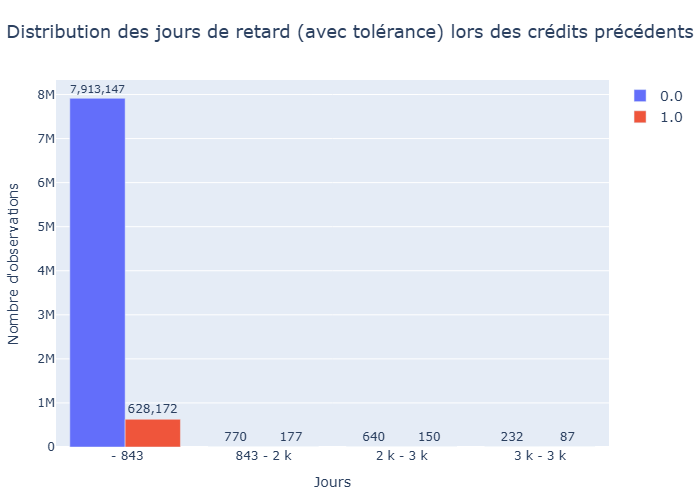

In [614]:
# Visualisation de la répartition pour la variable "SK_DPD_DEF" en fonction de la Target.

plot_quantitative_histogram(
    df_pos_cash_balance,
    x='SK_DPD_DEF',
    color='TARGET',
    nbins= 4,
    title="Distribution des jours de retard (avec tolérance) lors des crédits précédents",
    title_layout={"x": 0.5},
    title_font_size=18,
    xaxis_title="Jours",
    yaxis_title="Nombre d'observations",
    bin_as_category=True,
    width=1000,
    height=600
)

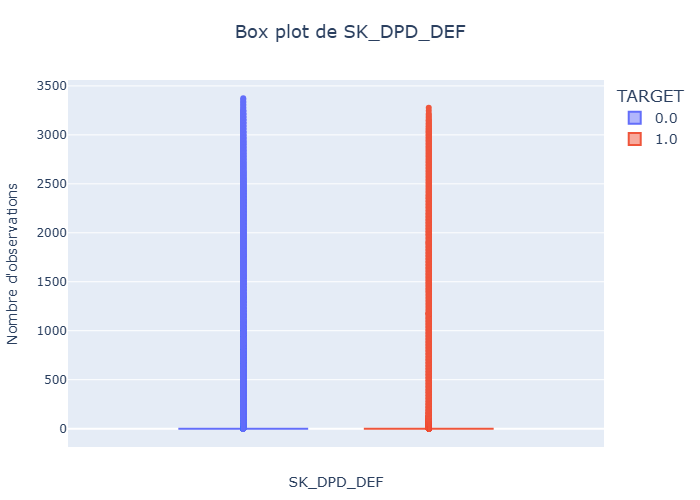

In [615]:
# Visualisation de la répartition pour la variable "SK_DPD_DEF"

plot_quantitative_box_violin(df_pos_cash_balance, 
                            x="SK_DPD_DEF",
                            plot_type="box",
                            color='TARGET',
                            width=800,
                            height=700,
                            xaxis_title="SK_DPD_DEF",
                            yaxis_title="Nombre d'observations",
                            color_map={0: "#636EFA", 1: "#EF553B"}
                            )

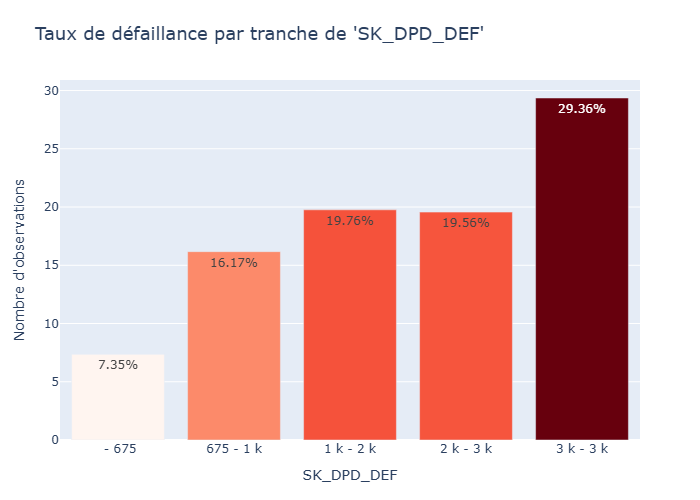

In [616]:
# Visualisation du taux de défaillance pour la variable "SK_DPD_DEF".

plot_defaillance_rate_per_quantitative(df_pos_cash_balance, 
                                       "SK_DPD_DEF",
                                       target_var="TARGET",
                                       nbins=5,
                                       width=800,
                                       height=700,
                                       xaxis_title="SK_DPD_DEF",
                                       yaxis_title="Nombre d'observations")

- Même constat que précédemment.
- On peut maintenant passer à l'analyse multivariée des différentes variables pour visualiser les corrélations entre elles et avec la Target :

In [617]:
# Calcul de la matrice de corrélation
corr_matrix = df_pos_cash_balance.corr()

# Masque pour exclure la diagonale (corrélations de 1)
mask = corr_matrix != 1

# Extraction des paires (en supprimant la diagonale)
corr_pairs = corr_matrix[mask].stack().reset_index()
corr_pairs.columns = ['Variable 1', 'Variable 2', 'Corrélation']

# Créer une paire triée pour éviter les doublons (A / B == B / A)
corr_pairs['Sorted Pair'] = corr_pairs.apply(
    lambda row: ' / '.join(sorted([row['Variable 1'], row['Variable 2']])), axis=1
)

# Supprimer les doublons
corr_pairs = corr_pairs.drop_duplicates(subset='Sorted Pair')

# Ajouter une colonne lisible avec les deux noms de variables
corr_pairs['Variables corrélées'] = corr_pairs['Sorted Pair']

# Garder uniquement les colonnes voulues
corr_df = corr_pairs[['Variables corrélées', 'Corrélation']]

# Trier par valeur absolue de corrélation (facultatif)
corr_df = corr_df.sort_values(by='Corrélation', ascending=False).reset_index(drop=True)

# Affichage stylisé
pd.set_option('display.max_rows', None)

corr_df_styled = corr_df.style.background_gradient(
    subset=['Corrélation'],
    cmap='coolwarm',
    vmin=-1, vmax=1
)

corr_df_styled

,Variables corrélées,Corrélation
0,CNT_INSTALMENT / CNT_INSTALMENT_FUTURE,0.871276
1,CNT_INSTALMENT / MONTHS_BALANCE,0.336163
2,CNT_INSTALMENT_FUTURE / MONTHS_BALANCE,0.271595
3,SK_DPD / SK_DPD_DEF,0.245782
4,CNT_INSTALMENT_FUTURE / TARGET,0.021972
5,MONTHS_BALANCE / TARGET,0.020147
6,CNT_INSTALMENT / TARGET,0.018506
7,SK_DPD / TARGET,0.009866
8,SK_DPD_DEF / TARGET,0.008594
9,SK_DPD_DEF / SK_ID_PREV,0.004848


In [618]:
pd.reset_option('display.max_rows')

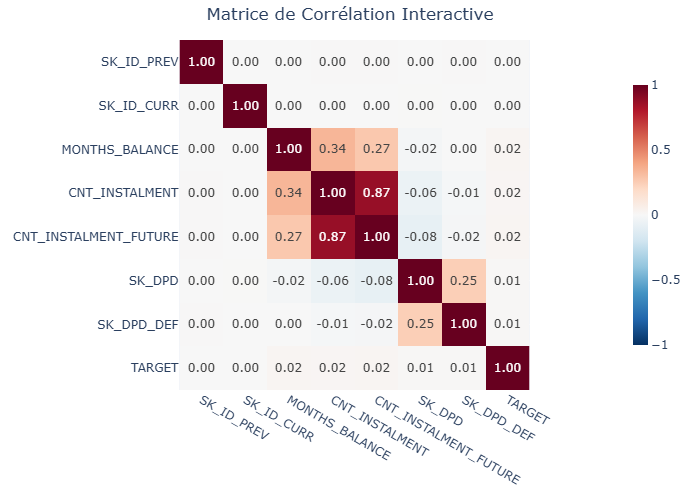

In [619]:
# Visualisation de la matrice de corrélation pour les variables quantitatives.

fig = px.imshow(
    corr_matrix,
    text_auto=".2f",
    color_continuous_scale='RdBu_r',
    zmin=-1,
    zmax=1
)

fig.update_layout(
    title="Matrice de Corrélation Interactive",
    title_x=0.5,
    width=1750,
    height=1750,
    margin=dict(l=20, r=20, t=40, b=20)
)

fig.update_coloraxes(colorbar=dict(thickness=15, x=1.02, len=0.8))
fig.show()

In [620]:
strong_corr_target = df_pos_cash_balance.corr()['TARGET'].drop('TARGET')

corr_matrix_target = strong_corr_target.to_frame(name='Corrélation en fonction de la target').sort_values(by='Corrélation en fonction de la target', ascending=False)
corr_matrix_target

,Corrélation en fonction de la target
CNT_INSTALMENT_FUTURE,0.021972
MONTHS_BALANCE,0.020147
CNT_INSTALMENT,0.018506
SK_DPD,0.009866
SK_DPD_DEF,0.008594
SK_ID_PREV,-0.000056
SK_ID_CURR,-0.002245


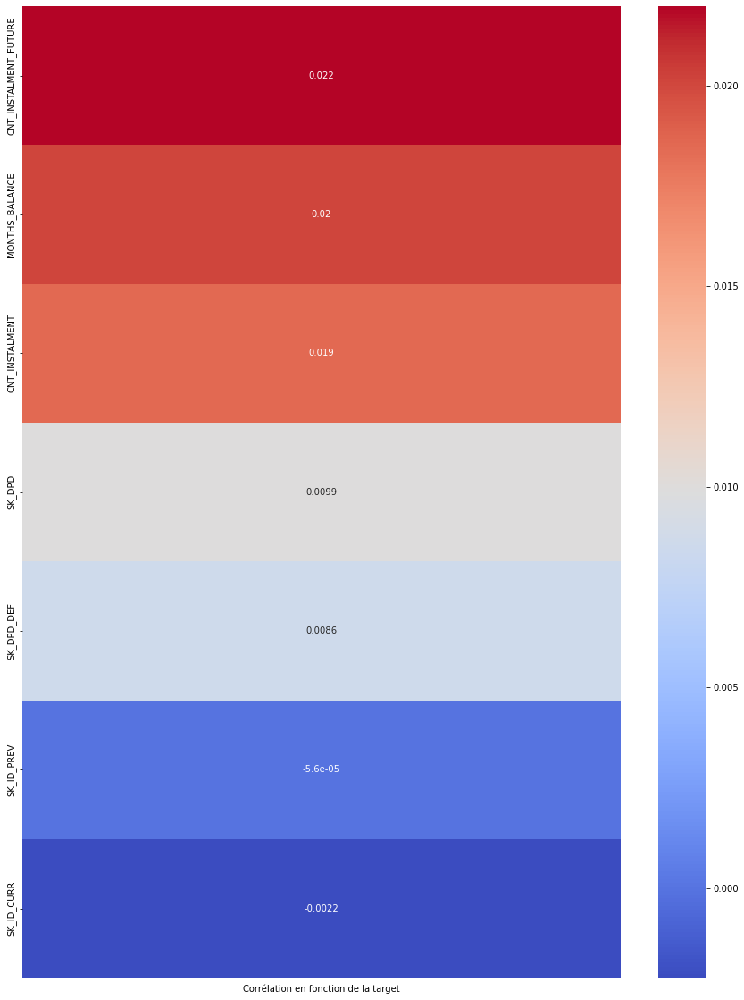

In [621]:
# Visualisation de la matrice de corrélation des variables quantitative par rapport à la Target.

plt.figure(figsize=(15,20))
sns.heatmap(corr_matrix_target, annot=True, cmap='coolwarm')
plt.show()

- Pas de grosses corrélations entre les variables et la Target même si les corrélations positives ne sont pas négligeables (notamment les 3 premières).

In [622]:
# Inclure TARGET dans la matrice
cramer_matrix_previous = cramers_v_matrix(df_pos_cash_balance, include_target=True, target_col='TARGET')

# Extraire la ligne/colonne de TARGET
target_corr = cramer_matrix_previous['TARGET'].drop('TARGET').sort_values(ascending=False)

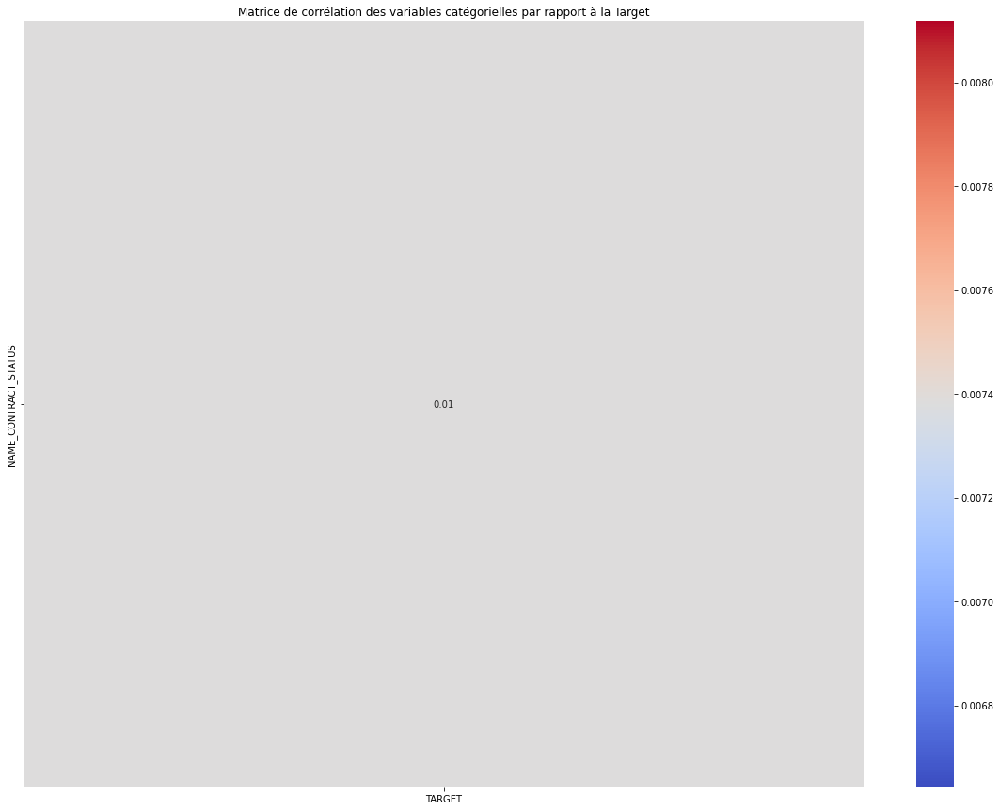

In [623]:
# Visualisation de la matrice de corrélation des variables qualitatives par rapport à la Target.

plt.figure(figsize=(20,15))
sns.heatmap(target_corr.to_frame(), annot=True, fmt=".2f", cmap="coolwarm")
plt.title("Matrice de corrélation des variables catégorielles par rapport à la Target")
plt.show()

- La seule variable catégorielle n'est pas très concluante avec la Target.

#### Dataframe "Installments_payments"

In [624]:
# Importation du fichier qui s'intitule "installments_payments.csv".

df_install_payments = pd.read_csv(r"C:\Users\Caomghin\Desktop\Implementer_un_modele_de_scoring\Donnee_kaggle\installments_payments.csv")

In [625]:
# Forme du dataframe "installments_payments".

df_install_payments.shape

(13605401, 8)

In [626]:
# Visualisation du dataframe.

df_install_payments

,SK_ID_PREV,SK_ID_CURR,NUM_INSTALMENT_VERSION,NUM_INSTALMENT_NUMBER,DAYS_INSTALMENT,DAYS_ENTRY_PAYMENT,AMT_INSTALMENT,AMT_PAYMENT
0,1054186,161674,1.0,6,-1180.0,-1187.0,6948.360,6948.360
1,1330831,151639,0.0,34,-2156.0,-2156.0,1716.525,1716.525
2,2085231,193053,2.0,1,-63.0,-63.0,25425.000,25425.000
3,2452527,199697,1.0,3,-2418.0,-2426.0,24350.130,24350.130
4,2714724,167756,1.0,2,-1383.0,-1366.0,2165.040,2160.585
...,...,...,...,...,...,...,...,...
13605396,2186857,428057,0.0,66,-1624.0,NaN,67.500,NaN
13605397,1310347,414406,0.0,47,-1539.0,NaN,67.500,NaN
13605398,1308766,402199,0.0,43,-7.0,NaN,43737.435,NaN
13605399,1062206,409297,0.0,43,-1986.0,NaN,67.500,NaN


In [627]:
# On visualise le type de chaque variable et la présence potentielle de valeurs nulles.

df_install_payments.info(show_counts=True)

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 13605401 entries, 0 to 13605400
Data columns (total 8 columns):
 #   Column                  Non-Null Count     Dtype  
---  ------                  --------------     -----  
 0   SK_ID_PREV              13605401 non-null  int64  
 1   SK_ID_CURR              13605401 non-null  int64  
 2   NUM_INSTALMENT_VERSION  13605401 non-null  float64
 3   NUM_INSTALMENT_NUMBER   13605401 non-null  int64  
 4   DAYS_INSTALMENT         13605401 non-null  float64
 5   DAYS_ENTRY_PAYMENT      13602496 non-null  float64
 6   AMT_INSTALMENT          13605401 non-null  float64
 7   AMT_PAYMENT             13602496 non-null  float64
dtypes: float64(5), int64(3)
memory usage: 830.4 MB


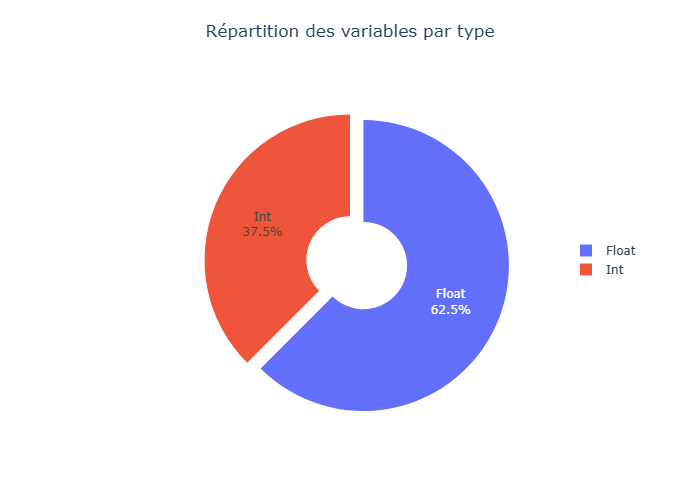

In [628]:
# Représentation graphique des types de variables.

fig = go.Figure(data=[go.Pie(
    labels=["Float", "Int"], 
    values=df_install_payments.dtypes.value_counts(),
    hole=0.3,
    textinfo="label+percent",
    pull=[0.1, 0, 0]
)])

# Titre et affichage
fig.update_layout(
    title={
        'text': "Répartition des variables par type",
        'y': 0.95,  # Position verticale (1 = tout en haut)
        'x': 0.50,   # Centrer le titre
        'xanchor': 'center',
        'yanchor': 'top'
    },
    legend={
        'x': 0.9,  # Ajuste la position de la légende plus proche
        'y': 0.5,
        'xanchor': 'left'
    }
)
fig.show()

In [629]:
# Visualisation des description liées à ce jeu de données.

pd.set_option('display.max_colwidth', None)
df_description.loc[df_description['Table'] == 'installments_payments.csv'][['Row','Description']]

,Row,Description
211,SK_ID_PREV,"ID of previous credit in Home credit related to loan in our sample. (One loan in our sample can have 0,1,2 or more previous loans in Home Credit)"
212,SK_ID_CURR,ID of loan in our sample
213,NUM_INSTALMENT_VERSION,Version of installment calendar (0 is for credit card) of previous credit. Change of installment version from month to month signifies that some parameter of payment calendar has changed
214,NUM_INSTALMENT_NUMBER,On which installment we observe payment
215,DAYS_INSTALMENT,When the installment of previous credit was supposed to be paid (relative to application date of current loan)
216,DAYS_ENTRY_PAYMENT,When was the installments of previous credit paid actually (relative to application date of current loan)
217,AMT_INSTALMENT,What was the prescribed installment amount of previous credit on this installment
218,AMT_PAYMENT,What the client actually paid on previous credit on this installment


In [630]:
pd.reset_option('display.max_colwidth')

In [631]:
# Statistique des données du previous application .

df_install_payments.describe().round(2)

,SK_ID_PREV,SK_ID_CURR,NUM_INSTALMENT_VERSION,NUM_INSTALMENT_NUMBER,DAYS_INSTALMENT,DAYS_ENTRY_PAYMENT,AMT_INSTALMENT,AMT_PAYMENT
count,13605401.00,13605401.00,13605401.00,13605401.00,13605401.00,13602496.00,13605401.00,13602496.00
mean,1903364.97,278444.88,0.86,18.87,-1042.27,-1051.11,17050.91,17238.22
std,536202.91,102718.31,1.04,26.66,800.95,800.59,50570.25,54735.78
min,1000001.00,100001.00,0.00,1.00,-2922.00,-4921.00,0.00,0.00
25%,1434191.00,189639.00,0.00,4.00,-1654.00,-1662.00,4226.08,3398.26
50%,1896520.00,278685.00,1.00,8.00,-818.00,-827.00,8884.08,8125.52
75%,2369094.00,367530.00,1.00,19.00,-361.00,-370.00,16710.21,16108.42
max,2843499.00,456255.00,178.00,277.00,-1.00,-1.00,3771487.84,3771487.84


In [632]:
# Calcul du pourcentage de valeurs nulles par variable pour "installments_payments.csv". 
pd.set_option('display.max_rows', None)
calculate_missing_values(df_install_payments)

,Nbr_valeurs_manquantes,Pct_valeurs_manquantes
DAYS_ENTRY_PAYMENT,2905,0.021352
AMT_PAYMENT,2905,0.021352


In [633]:
pd.reset_option('display.max_rows')

Text(0, 0.5, 'Loans')

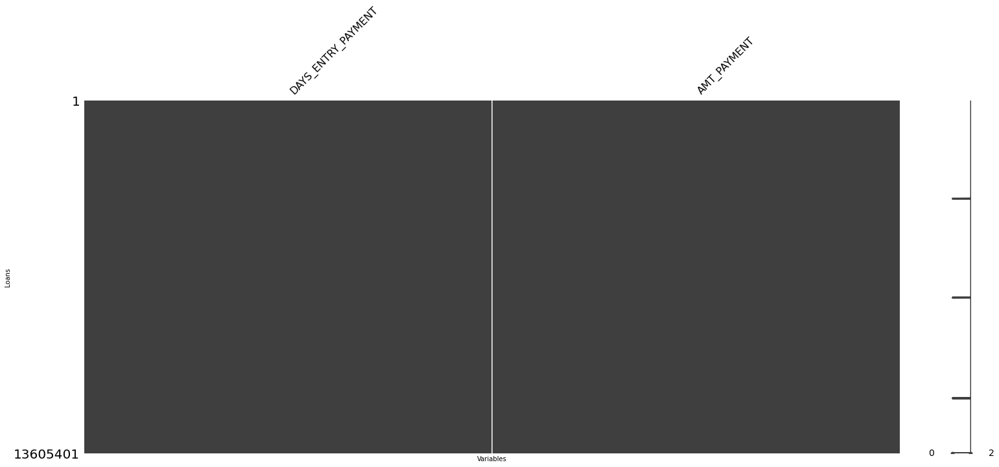

In [634]:
# Utilisation d'un graphique pour avoir une représentation visuelle des valeurs manquantes.

msno.matrix(df_install_payments.loc[:, df_install_payments.isnull().any(axis=0)])

plt.xlabel("Variables")
plt.ylabel("Loans")

- On a 2 variables avec des valeurs manquantes pour ce dernier dataframe mais cela ne représente que 0.02 % de l'effectif total pour ces deux variables, ce qui ne devrait pas poser de problèmes par la suite.

In [635]:
df_install_payments.info(show_counts=True)

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 13605401 entries, 0 to 13605400
Data columns (total 8 columns):
 #   Column                  Non-Null Count     Dtype  
---  ------                  --------------     -----  
 0   SK_ID_PREV              13605401 non-null  int64  
 1   SK_ID_CURR              13605401 non-null  int64  
 2   NUM_INSTALMENT_VERSION  13605401 non-null  float64
 3   NUM_INSTALMENT_NUMBER   13605401 non-null  int64  
 4   DAYS_INSTALMENT         13605401 non-null  float64
 5   DAYS_ENTRY_PAYMENT      13602496 non-null  float64
 6   AMT_INSTALMENT          13605401 non-null  float64
 7   AMT_PAYMENT             13602496 non-null  float64
dtypes: float64(5), int64(3)
memory usage: 830.4 MB


In [636]:
# Recherche de doublons pour la variable ID "SK_ID_PREV"

df_install_payments['SK_ID_PREV'].duplicated().any()

True

In [637]:
# Nombre de lignes présentant au moins un doublon et celles n'en présentant pas.

df_install_payments['SK_ID_PREV'].duplicated(keep=False).value_counts()

True     13577304
False       28097
Name: SK_ID_PREV, dtype: int64

In [638]:
# Recherche de doublons pour la variable ID "SK_ID_CURR"

df_install_payments['SK_ID_CURR'].duplicated().any()

True

In [639]:
# Nombre de lignes présentant au moins un doublon et celles n'en présentant pas.

df_install_payments['SK_ID_CURR'].duplicated(keep=False).value_counts()

True     13604429
False         972
Name: SK_ID_CURR, dtype: int64

- Pour les même raisons que les dataframes précédent, il est normal qu'il y ait des doublons puisque l'on fait référence aux crédits antérieurs à la demande actuelle.

In [640]:
df_install_payments['NUM_INSTALMENT_VERSION'].describe().round(0)

count    13605401.0
mean            1.0
std             1.0
min             0.0
25%             0.0
50%             1.0
75%             1.0
max           178.0
Name: NUM_INSTALMENT_VERSION, dtype: float64

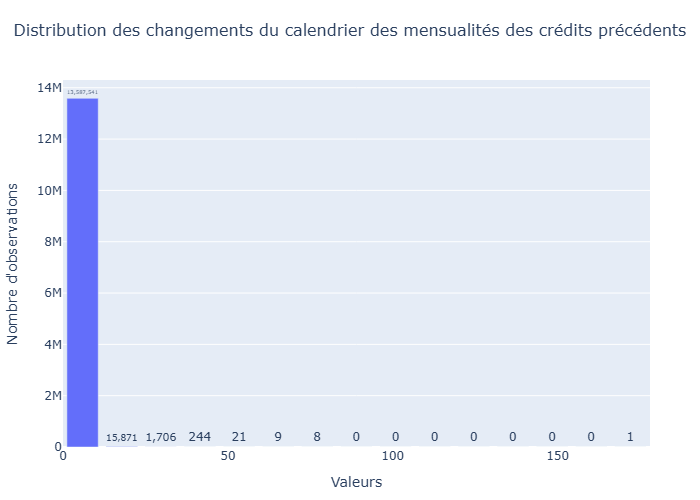

In [641]:
# Visualisation de la distribution pour la variable "NUM_INSTALMENT_VERSION".

plot_quantitative_histogram(
    df_install_payments,
    x='NUM_INSTALMENT_VERSION',
    title="Distribution des changements du calendrier des mensualités des crédits précédents",
    title_layout={"x": 0.5},
    title_font_size=16,
    xaxis_title="Valeurs",
    yaxis_title="Nombre d'observations",
    width=1000,
    height=600
)

In [642]:
# Ajout de la variable 'TARGET' au dataframe df_install_payments

df_install_payments['TARGET'] = df_install_payments['SK_ID_CURR'].map(df_appli_train.set_index('SK_ID_CURR')['TARGET'])

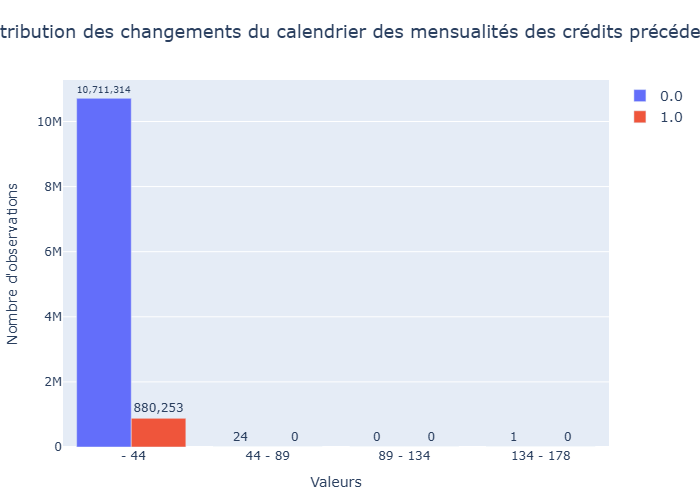

In [643]:
# Visualisation de la répartition pour la variable "NUM_INSTALMENT_VERSION" en fonction de la Target.

plot_quantitative_histogram(
    df_install_payments,
    x='NUM_INSTALMENT_VERSION',
    color='TARGET',
    nbins= 4,
    title="Distribution des changements du calendrier des mensualités des crédits précédents",
    title_layout={"x": 0.5},
    title_font_size=18,
    xaxis_title="Valeurs",
    yaxis_title="Nombre d'observations",
    bin_as_category=True,
    width=1000,
    height=600
)

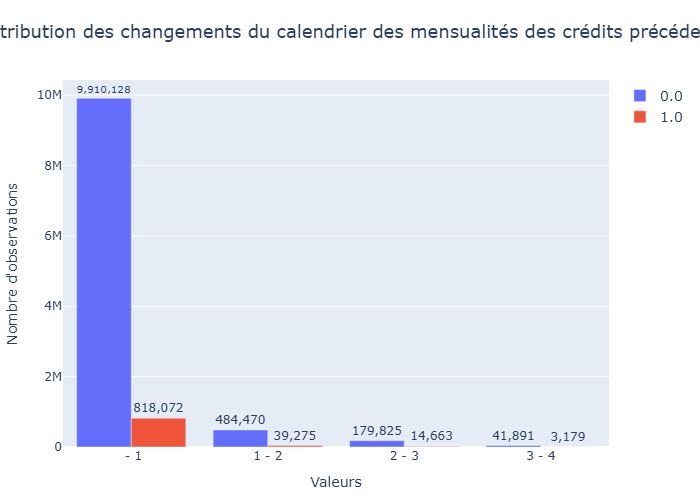

In [645]:
# Visualisation de la répartition pour la variable "NUM_INSTALMENT_VERSION" en fonction de la Target.

plot_quantitative_histogram(
    df_install_payments,
    x='NUM_INSTALMENT_VERSION',
    color='TARGET',
    nbins= 4,
    title="Distribution des changements du calendrier des mensualités des crédits précédents",
    title_layout={"x": 0.5},
    title_font_size=18,
    xaxis_title="Valeurs",
    yaxis_title="Nombre d'observations",
    bin_as_category=True,
    max_quantile=0.99,
    width=1000,
    height=600
)

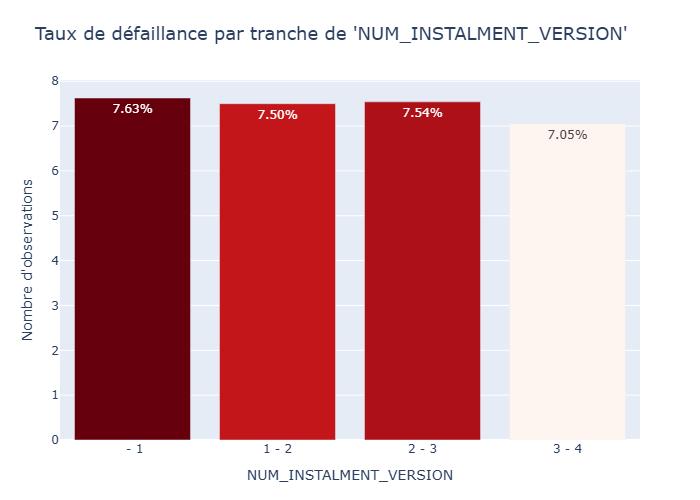

In [646]:
# Visualisation du taux de défaillance pour la variable "NUM_INSTALMENT_VERSION".

plot_defaillance_rate_per_quantitative(df_install_payments, 
                                       "NUM_INSTALMENT_VERSION",
                                       target_var="TARGET",
                                       nbins=4,
                                       width=800,
                                       height=700,
                                       max_quantile=0.99,
                                       xaxis_title="NUM_INSTALMENT_VERSION",
                                       yaxis_title="Nombre d'observations")

- Il y a très peu de changements dans le calendrier des échéances de paiements et cette variable ne semble pas impacter la Target.

In [647]:
df_install_payments['NUM_INSTALMENT_NUMBER'].describe().round(0)

count    13605401.0
mean           19.0
std            27.0
min             1.0
25%             4.0
50%             8.0
75%            19.0
max           277.0
Name: NUM_INSTALMENT_NUMBER, dtype: float64

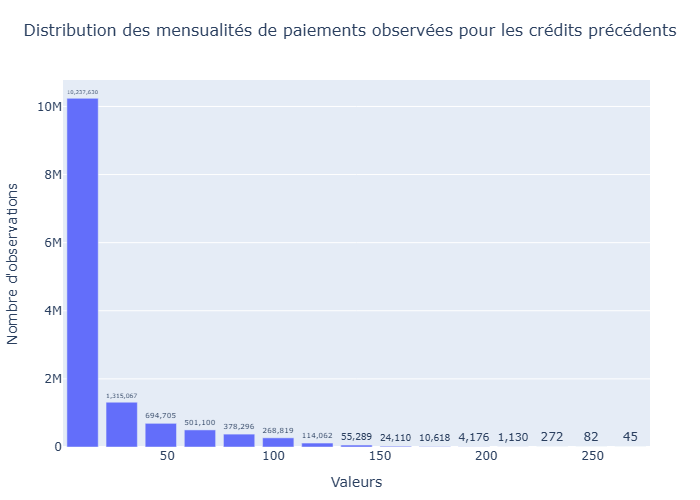

In [648]:
# Visualisation de la distribution pour la variable "NUM_INSTALMENT_NUMBER".

plot_quantitative_histogram(
    df_install_payments,
    x='NUM_INSTALMENT_NUMBER',
    title="Distribution des mensualités de paiements observées pour les crédits précédents",
    title_layout={"x": 0.5},
    title_font_size=16,
    xaxis_title="Valeurs",
    yaxis_title="Nombre d'observations",
    width=1000,
    height=600
)

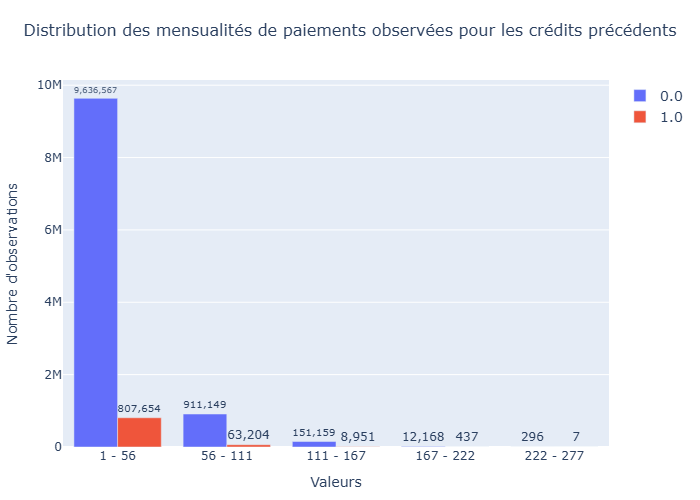

In [649]:
# Visualisation de la répartition pour la variable "NUM_INSTALMENT_NUMBER" en fonction de la Target.

plot_quantitative_histogram(
    df_install_payments,
    x='NUM_INSTALMENT_NUMBER',
    color='TARGET',
    nbins= 5,
    title="Distribution des mensualités de paiements observées pour les crédits précédents",
    title_layout={"x": 0.5},
    title_font_size=16,
    xaxis_title="Valeurs",
    yaxis_title="Nombre d'observations",
    bin_as_category=True,
    width=1000,
    height=600
)

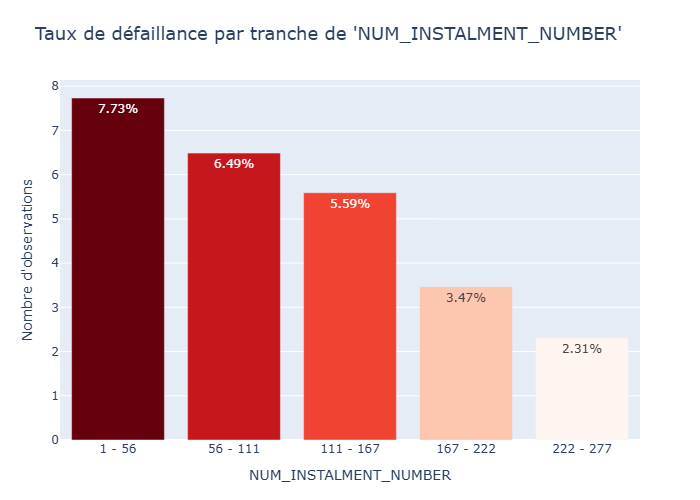

In [650]:
# Visualisation du taux de défaillance pour la variable "NUM_INSTALMENT_NUMBER".

plot_defaillance_rate_per_quantitative(df_install_payments, 
                                       "NUM_INSTALMENT_NUMBER",
                                       target_var="TARGET",
                                       nbins=5,
                                       width=800,
                                       height=700,
                                       xaxis_title="NUM_INSTALMENT_NUMBER",
                                       yaxis_title="Nombre d'observations")

- Pour cette variable plus la mensualité est récente plus il y aun taux de défaillance important donc il peut y avoir un lien intéressant à prendre en compte ici.

In [651]:
df_install_payments['DAYS_INSTALMENT'].describe().round(0)

count    13605401.0
mean        -1042.0
std           801.0
min         -2922.0
25%         -1654.0
50%          -818.0
75%          -361.0
max            -1.0
Name: DAYS_INSTALMENT, dtype: float64

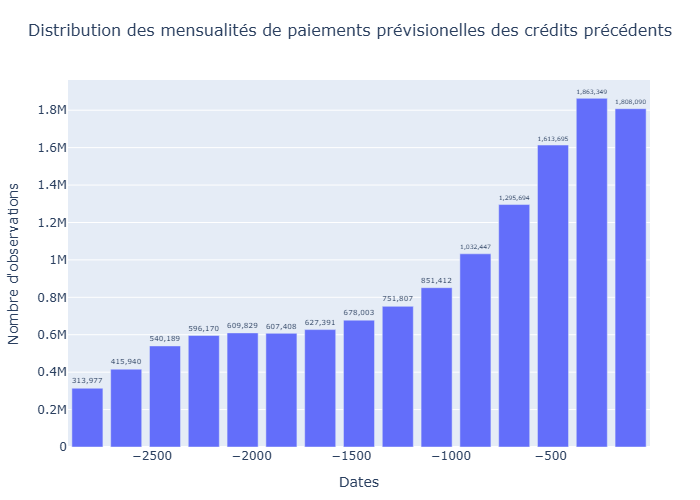

In [653]:
# Visualisation de la distribution pour la variable "DAYS_INSTALMENT".

plot_quantitative_histogram(
    df_install_payments,
    x='DAYS_INSTALMENT',
    title="Distribution des mensualités de paiements prévisionelles des crédits précédents",
    title_layout={"x": 0.5},
    title_font_size=16,
    xaxis_title="Dates",
    yaxis_title="Nombre d'observations",
    width=1000,
    height=600
)

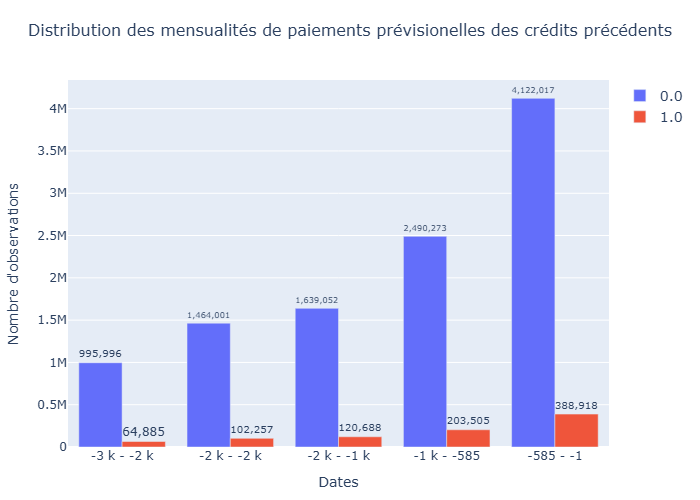

In [652]:
# Visualisation de la répartition pour la variable "DAYS_INSTALMENT" en fonction de la Target.

plot_quantitative_histogram(
    df_install_payments,
    x='DAYS_INSTALMENT',
    color='TARGET',
    nbins= 5,
    title="Distribution des mensualités de paiements prévisionelles des crédits précédents",
    title_layout={"x": 0.5},
    title_font_size=16,
    xaxis_title="Dates",
    yaxis_title="Nombre d'observations",
    bin_as_category=True,
    width=1000,
    height=600
)

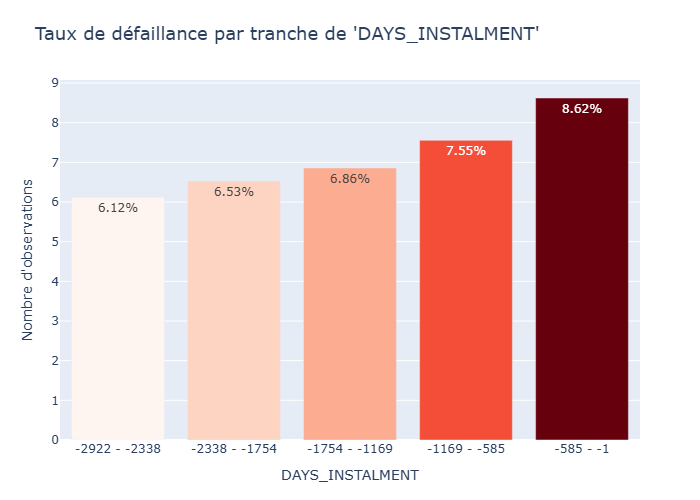

In [654]:
# Visualisation du taux de défaillance pour la variable "DAYS_INSTALMENT".

plot_defaillance_rate_per_quantitative(df_install_payments, 
                                       "DAYS_INSTALMENT",
                                       target_var="TARGET",
                                       nbins=5,
                                       width=800,
                                       height=700,
                                       xaxis_title="DAYS_INSTALMENT",
                                       yaxis_title="Nombre d'observations")

- Même constat que la variable précédente.

In [655]:
df_install_payments['DAYS_ENTRY_PAYMENT'].describe().round(0)

count    13602496.0
mean        -1051.0
std           801.0
min         -4921.0
25%         -1662.0
50%          -827.0
75%          -370.0
max            -1.0
Name: DAYS_ENTRY_PAYMENT, dtype: float64

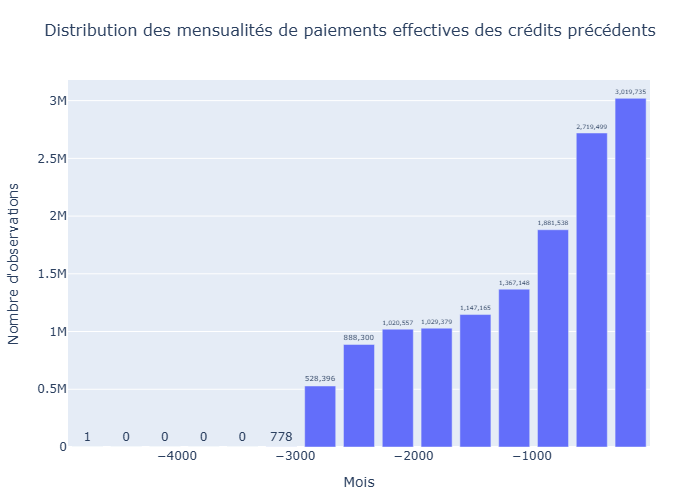

In [656]:
# Visualisation de la distribution pour la variable "DAYS_ENTRY_PAYMENT".

plot_quantitative_histogram(
    df_install_payments,
    x='DAYS_ENTRY_PAYMENT',
    title="Distribution des mensualités de paiements effectives des crédits précédents",
    title_layout={"x": 0.5},
    title_font_size=16,
    xaxis_title="Mois",
    yaxis_title="Nombre d'observations",
    width=1000,
    height=600
)

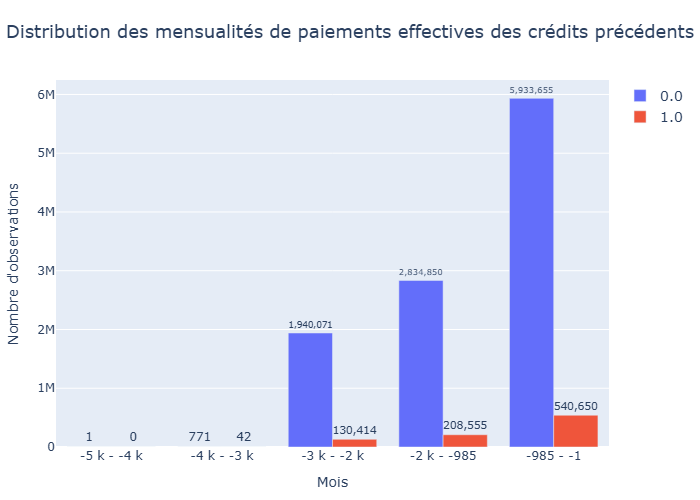

In [657]:
# Visualisation de la répartition pour la variable "DAYS_ENTRY_PAYMENT" en fonction de la Target.

plot_quantitative_histogram(
    df_install_payments,
    x='DAYS_ENTRY_PAYMENT',
    color='TARGET',
    nbins= 5,
    title="Distribution des mensualités de paiements effectives des crédits précédents",
    title_layout={"x": 0.5},
    title_font_size=18,
    xaxis_title="Mois",
    yaxis_title="Nombre d'observations",
    bin_as_category=True,
    width=1000,
    height=600
)

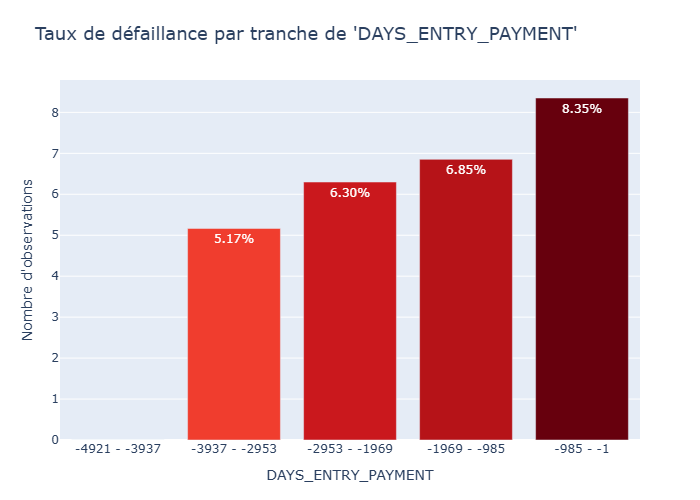

In [658]:
# Visualisation du taux de défaillance pour la variable "DAYS_ENTRY_PAYMENT".

plot_defaillance_rate_per_quantitative(df_install_payments, 
                                       "DAYS_ENTRY_PAYMENT",
                                       target_var="TARGET",
                                       nbins=5,
                                       width=800,
                                       height=700,
                                       xaxis_title="DAYS_ENTRY_PAYMENT",
                                       yaxis_title="Nombre d'observations")

- On retrouve le même schéma que la variable prévisionelle.

In [659]:
df_install_payments['AMT_INSTALMENT'].describe().round(0)

count    13605401.0
mean        17051.0
std         50570.0
min             0.0
25%          4226.0
50%          8884.0
75%         16710.0
max       3771488.0
Name: AMT_INSTALMENT, dtype: float64

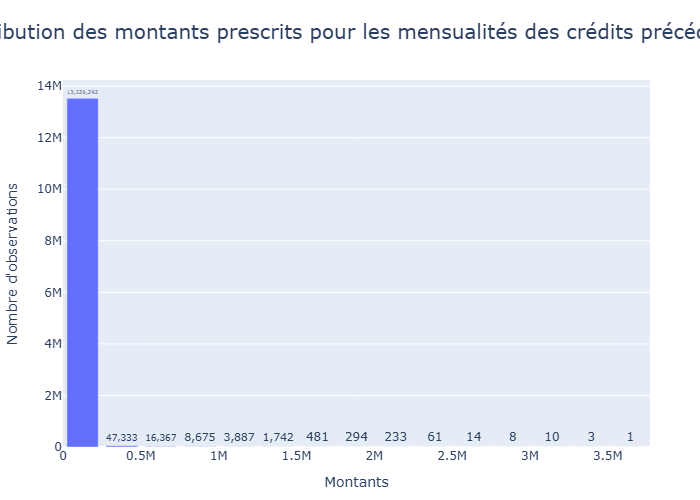

In [ ]:
# Visualisation de la distribution pour la variable "AMT_INSTALMENT".

plot_quantitative_histogram(
    df_install_payments,
    x='AMT_INSTALMENT',
    title="Distribution des montants prévisionels pour les mensualités des crédits précédents",
    title_layout={"x": 0.5},
    title_font_size=16,
    xaxis_title="Montants",
    yaxis_title="Nombre d'observations",
    width=1000,
    height=600
)

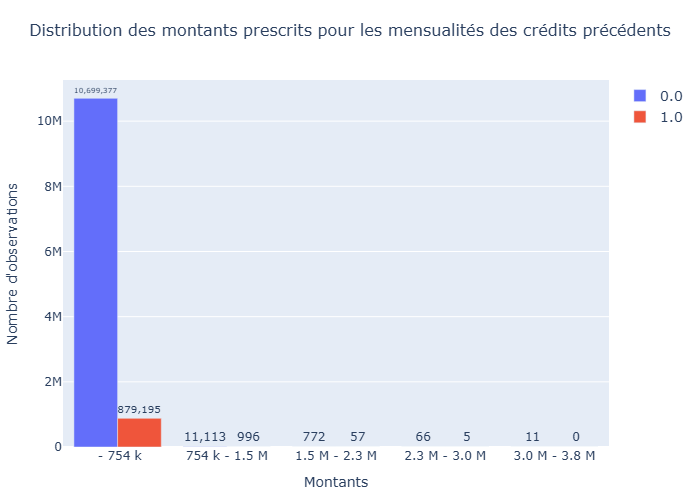

In [ ]:
# Visualisation de la répartition pour la variable "AMT_INSTALMENT" en fonction de la Target.

plot_quantitative_histogram(
    df_install_payments,
    x='AMT_INSTALMENT',
    color='TARGET',
    nbins= 5,
    title="Distribution des montants prévisionels pour les mensualités des crédits précédents",
    title_layout={"x": 0.5},
    title_font_size=16,
    xaxis_title="Montants",
    yaxis_title="Nombre d'observations",
    bin_as_category=True,
    width=1000,
    height=600
)

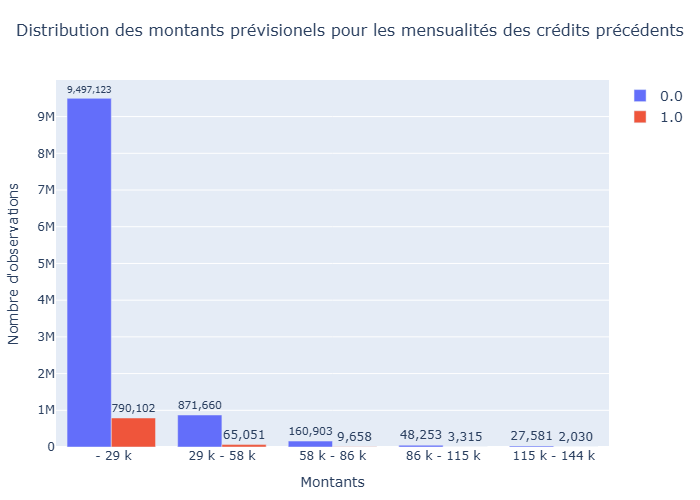

In [668]:
# Visualisation de la répartition pour la variable "AMT_INSTALMENT" en fonction de la Target.

plot_quantitative_histogram(
    df_install_payments,
    x='AMT_INSTALMENT',
    color='TARGET',
    nbins= 5,
    title="Distribution des montants prévisionels pour les mensualités des crédits précédents",
    title_layout={"x": 0.5},
    title_font_size=16,
    xaxis_title="Montants",
    yaxis_title="Nombre d'observations",
    bin_as_category=True,
    max_quantile=0.99,
    width=1000,
    height=600
)

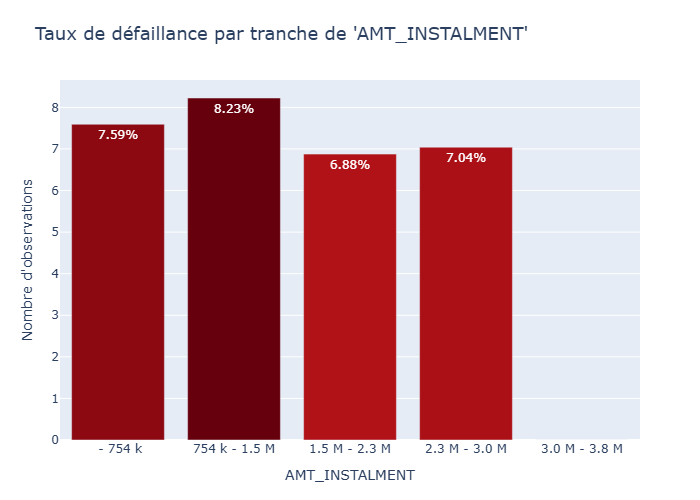

In [663]:
# Visualisation du taux de défaillance pour la variable "AMT_INSTALMENT".

plot_defaillance_rate_per_quantitative(df_install_payments, 
                                       "AMT_INSTALMENT",
                                       target_var="TARGET",
                                       nbins=5,
                                       width=800,
                                       height=700,
                                       xaxis_title="AMT_INSTALMENT",
                                       yaxis_title="Nombre d'observations")

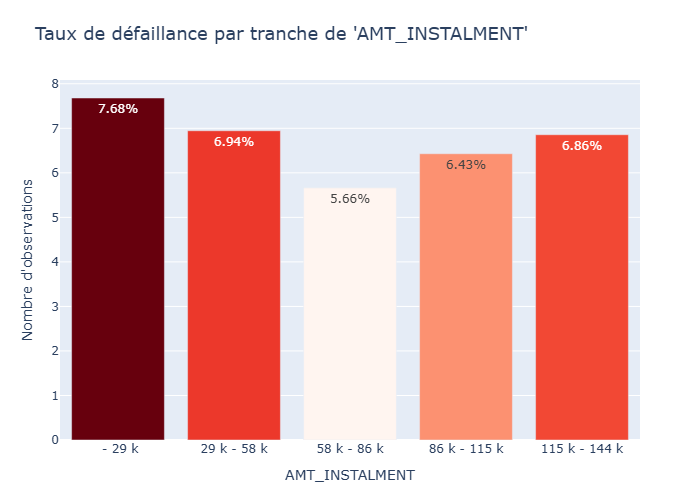

In [666]:
# Visualisation du taux de défaillance pour la variable "AMT_INSTALMENT".

plot_defaillance_rate_per_quantitative(df_install_payments, 
                                       "AMT_INSTALMENT",
                                       target_var="TARGET",
                                       nbins=5,
                                       width=800,
                                       height=700,
                                       max_quantile=0.99,
                                       xaxis_title="AMT_INSTALMENT",
                                       yaxis_title="Nombre d'observations")

- Pas de lien apparent avec la Target pour cette variable.

In [669]:
df_install_payments['AMT_PAYMENT'].describe().round(0)

count    13602496.0
mean        17238.0
std         54736.0
min             0.0
25%          3398.0
50%          8126.0
75%         16108.0
max       3771488.0
Name: AMT_PAYMENT, dtype: float64

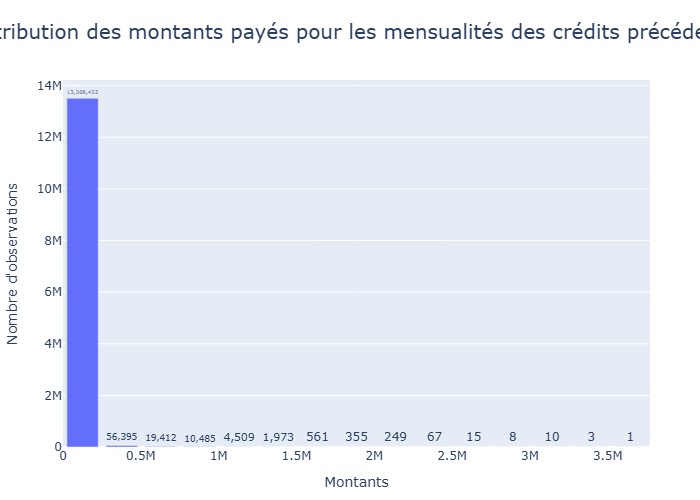

In [670]:
# Visualisation de la distribution pour la variable "AMT_PAYMENT".

plot_quantitative_histogram(
    df_install_payments,
    x='AMT_PAYMENT',
    title="Distribution des montants payés pour les mensualités des crédits précédents",
    title_layout={"x": 0.5},
    title_font_size=20,
    xaxis_title="Montants",
    yaxis_title="Nombre d'observations",
    width=1000,
    height=600
)

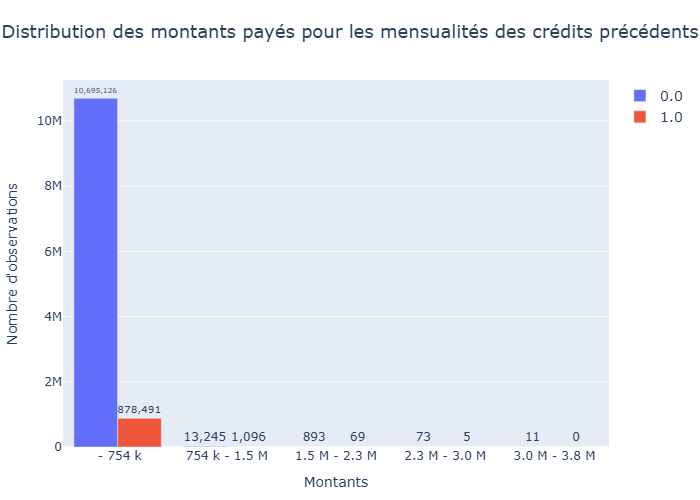

In [671]:
# Visualisation de la répartition pour la variable "AMT_PAYMENT" en fonction de la Target.

plot_quantitative_histogram(
    df_install_payments,
    x='AMT_PAYMENT',
    color='TARGET',
    nbins= 5,
    title="Distribution des montants payés pour les mensualités des crédits précédents",
    title_layout={"x": 0.5},
    title_font_size=18,
    xaxis_title="Montants",
    yaxis_title="Nombre d'observations",
    bin_as_category=True,
    width=1000,
    height=600
)

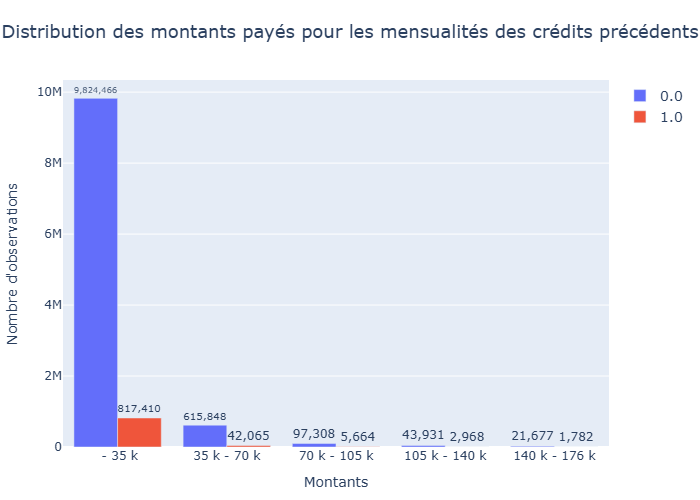

In [672]:
# Visualisation de la répartition pour la variable "AMT_PAYMENT" en fonction de la Target.

plot_quantitative_histogram(
    df_install_payments,
    x='AMT_PAYMENT',
    color='TARGET',
    nbins= 5,
    title="Distribution des montants payés pour les mensualités des crédits précédents",
    title_layout={"x": 0.5},
    title_font_size=18,
    xaxis_title="Montants",
    yaxis_title="Nombre d'observations",
    bin_as_category=True,
    max_quantile=0.99,
    width=1000,
    height=600
)

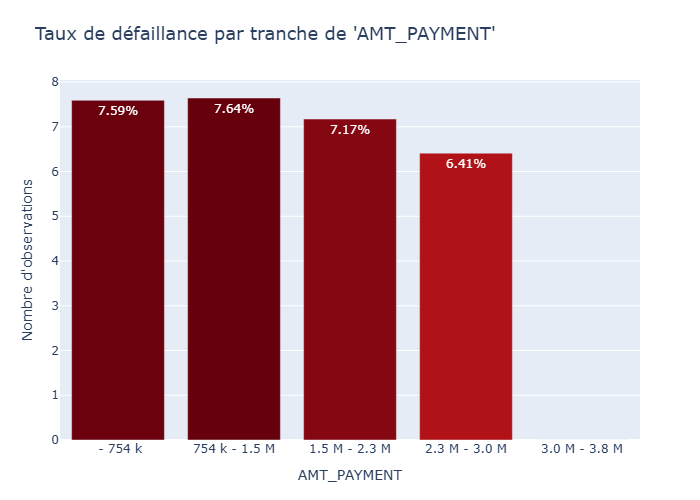

In [673]:
# Visualisation du taux de défaillance pour la variable "AMT_PAYMENT".

plot_defaillance_rate_per_quantitative(df_install_payments, 
                                       "AMT_PAYMENT",
                                       target_var="TARGET",
                                       nbins=5,
                                       width=800,
                                       height=700,
                                       xaxis_title="AMT_PAYMENT",
                                       yaxis_title="Nombre d'observations")

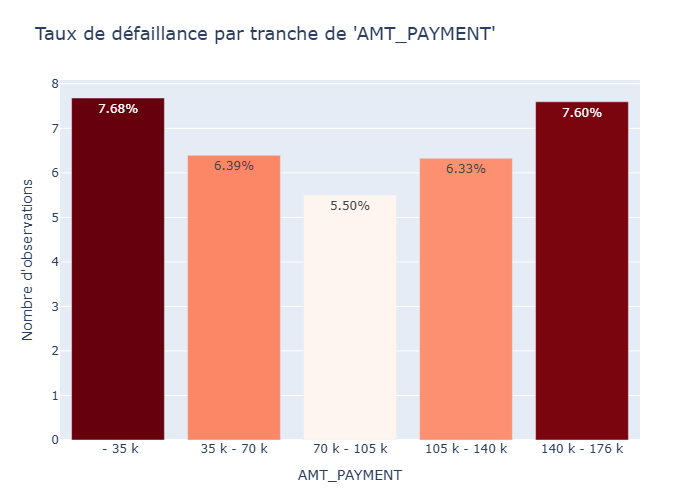

In [674]:
# Visualisation du taux de défaillance pour la variable "AMT_PAYMENT".

plot_defaillance_rate_per_quantitative(df_install_payments, 
                                       "AMT_PAYMENT",
                                       target_var="TARGET",
                                       nbins=5,
                                       width=800,
                                       height=700,
                                       max_quantile=0.99,
                                       xaxis_title="AMT_PAYMENT",
                                       yaxis_title="Nombre d'observations")

- Sur la totalité des crédits, il semble y avoir une baisse du taux de défaillance à mesure que les montants augmentent mais sans les outliers cela ne se vérifie plus.

In [675]:
# Calcul de la matrice de corrélation
corr_matrix = df_install_payments.corr()

# Masque pour exclure la diagonale (corrélations de 1)
mask = corr_matrix != 1

# Extraction des paires (en supprimant la diagonale)
corr_pairs = corr_matrix[mask].stack().reset_index()
corr_pairs.columns = ['Variable 1', 'Variable 2', 'Corrélation']

# Créer une paire triée pour éviter les doublons (A / B == B / A)
corr_pairs['Sorted Pair'] = corr_pairs.apply(
    lambda row: ' / '.join(sorted([row['Variable 1'], row['Variable 2']])), axis=1
)

# Supprimer les doublons
corr_pairs = corr_pairs.drop_duplicates(subset='Sorted Pair')

# Ajouter une colonne lisible avec les deux noms de variables
corr_pairs['Variables corrélées'] = corr_pairs['Sorted Pair']

# Garder uniquement les colonnes voulues
corr_df = corr_pairs[['Variables corrélées', 'Corrélation']]

# Trier par valeur absolue de corrélation (facultatif)
corr_df = corr_df.sort_values(by='Corrélation', ascending=False).reset_index(drop=True)

# Affichage stylisé
pd.set_option('display.max_rows', None)

corr_df_styled = corr_df.style.background_gradient(
    subset=['Corrélation'],
    cmap='coolwarm',
    vmin=-1, vmax=1
)

corr_df_styled

,Variables corrélées,Corrélation
0,DAYS_ENTRY_PAYMENT / DAYS_INSTALMENT,0.999491
1,AMT_INSTALMENT / AMT_PAYMENT,0.937191
2,AMT_PAYMENT / NUM_INSTALMENT_VERSION,0.177176
3,AMT_INSTALMENT / NUM_INSTALMENT_VERSION,0.168109
4,DAYS_INSTALMENT / NUM_INSTALMENT_VERSION,0.130244
5,DAYS_ENTRY_PAYMENT / NUM_INSTALMENT_VERSION,0.128124
6,AMT_PAYMENT / DAYS_INSTALMENT,0.127018
7,AMT_PAYMENT / DAYS_ENTRY_PAYMENT,0.126602
8,AMT_INSTALMENT / DAYS_INSTALMENT,0.125985
9,AMT_INSTALMENT / DAYS_ENTRY_PAYMENT,0.125555


In [676]:
pd.reset_option('display.max_rows')

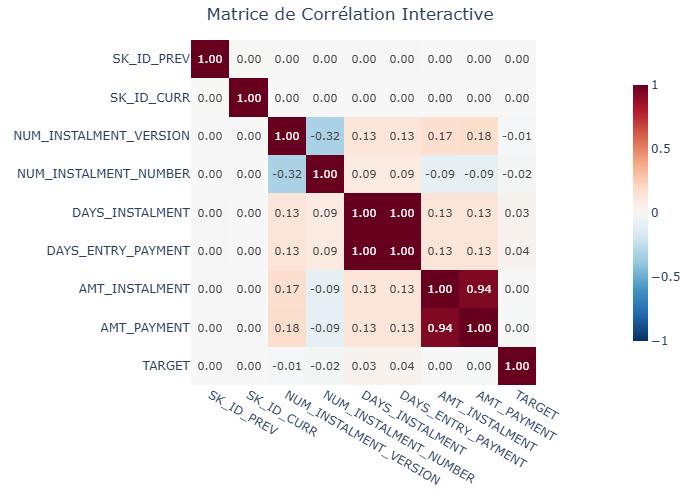

In [677]:
# Visualisation de la matrice de corrélation pour les variables quantitatives.

fig = px.imshow(
    corr_matrix,
    text_auto=".2f",
    color_continuous_scale='RdBu_r',
    zmin=-1,
    zmax=1
)

fig.update_layout(
    title="Matrice de Corrélation Interactive",
    title_x=0.5,
    width=1750,
    height=1750,
    margin=dict(l=20, r=20, t=40, b=20)
)

fig.update_coloraxes(colorbar=dict(thickness=15, x=1.02, len=0.8))
fig.show()

In [678]:
strong_corr_target = df_install_payments.corr()['TARGET'].drop('TARGET')

corr_matrix_target = strong_corr_target.to_frame(name='Corrélation en fonction de la target').sort_values(by='Corrélation en fonction de la target', ascending=False)
corr_matrix_target

,Corrélation en fonction de la target
DAYS_ENTRY_PAYMENT,0.035122
DAYS_INSTALMENT,0.034974
SK_ID_PREV,-0.000212
AMT_INSTALMENT,-0.001498
SK_ID_CURR,-0.002540
AMT_PAYMENT,-0.003623
NUM_INSTALMENT_VERSION,-0.009896
NUM_INSTALMENT_NUMBER,-0.016190


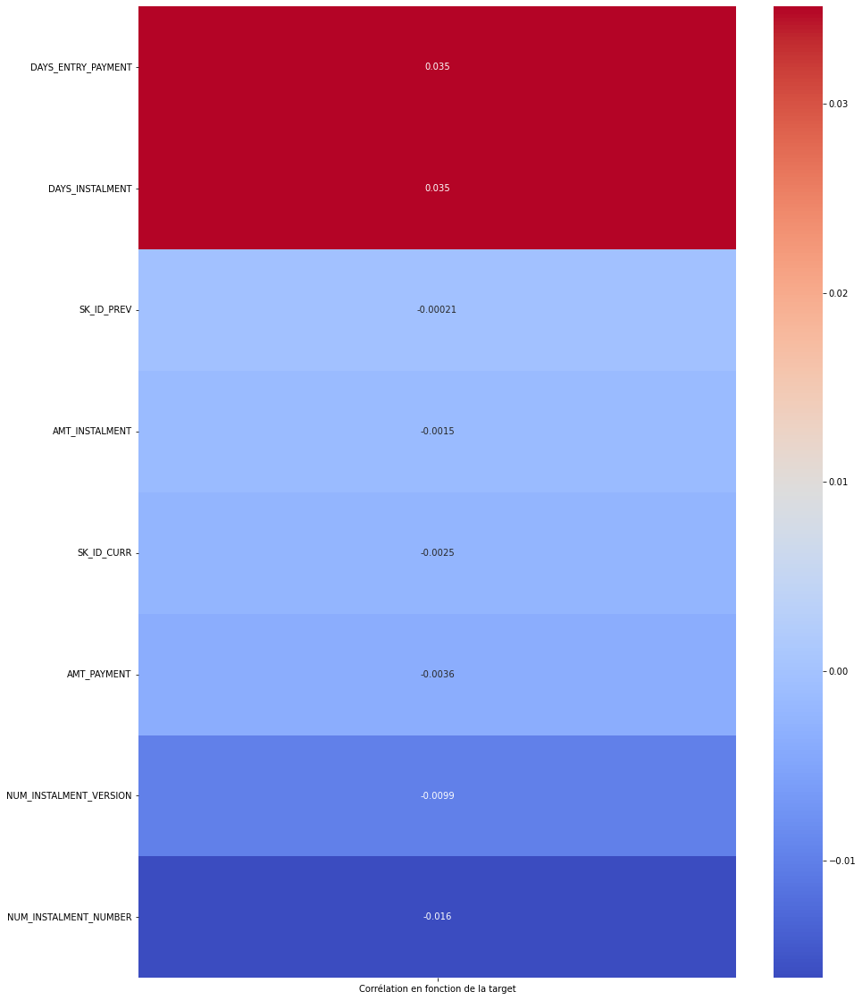

In [680]:
# Visualisation de la matrice de corrélation des variables quantitative par rapport à la Target.

plt.figure(figsize=(15,20))
sns.heatmap(corr_matrix_target, annot=True, cmap='coolwarm')
plt.show()

- Mise à part les deux premières variables, les variables ne sont pas très corrélées à notre Target néanmoins pour ces deux variables seulement 1 pourra être pris en compte pour éviter la colinéarité.

- Pour conclure, l'ensemble des jeux données représente une quantité de données conséquente avec laquelle travailler ce qui est une bonne chose pour affiner au mieux un modèle qui répondra aux objectifs fixés. 
- Toutefois comme on a pu le voir, il faut réaliser un travail de nettoyage puisque il y a plusieurs variables présentant des valeurs manquantes ou aberrantes.
- Ensuite il y a aussi beaucoup de variables non nécessaires car elles n'apportent pas d'informations pertinentes ou au contraire qui donnent des informations intéressantes mais très similaire entres elles donc pour éviter un problème de colinéarité (ce qui amène de la redondance dans les données) et de dimensionnalité (plus de 200 variables actuellement).
- Enfin il y a le problème de déséquilibre à prendre en compte pour la Target qui recense moins de 10 % de clients défaillants dans le fichier principal, il faut donc trouver des solutions pour régler ce problème.
- Dans un autre notebook, on réalisera donc ce travail de nettoyage, séléction des varaibles, feature engineering avant de passer à la modélisation.